In [1]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

In [2]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = '../data/shonal/train'
valid_path = '../data/shonal/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 1406 images belonging to 2 classes.
Found 352 images belonging to 2 classes.


In [3]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_1 (MaxPooling2D)  (None, None, None,   0          ['conv3_block3_out[0][0]']       
                                512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_1[0][0]',        
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

176/176 [==============================] - 5s 30ms/step - loss: 0.0602 - accuracy: 0.9801 - precision: 0.9453 - recall: 0.9453 - val_loss: 0.0640 - val_accuracy: 0.9858 - val_precision: 0.9403 - val_recall: 0.9844
Epoch 4/20
176/176 [==============================] - 5s 30ms/step - loss: 0.0813 - accuracy: 0.9737 - precision: 0.9294 - recall: 0.9258 - val_loss: 0.0803 - val_accuracy: 0.9801 - val_precision: 0.9254 - val_recall: 0.9688
Epoch 5/20
176/176 [==============================] - 5s 30ms/step - loss: 0.0500 - accuracy: 0.9844 - precision: 0.9570 - recall: 0.9570 - val_loss: 0.0611 - val_accuracy: 0.9773 - val_precision: 0.9000 - val_recall: 0.9844
Epoch 6/20
176/176 [==============================] - 5s 30ms/step - loss: 0.0545 - accuracy: 0.9815 - precision: 0.9457 - recall: 0.9531 - val_loss: 0.0547 - val_accuracy: 0.9886 - val_precision: 0.9545 - val_recall: 0.9844
Epoch 7/20
176/176 [==============================] - 5s 29ms/step - loss: 0.0519 - accuracy: 0.9801 - precisio

In [4]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

44/44 [==============================] - 1s 23ms/step - loss: 0.0577 - accuracy: 0.9886 - precision: 0.9545 - recall: 0.9844
train accuracy: 98.29303026199341 %
test accuracy: 98.86363744735718 %


In [5]:
unlabeled_path = "../data/shonal_unlabeled/unlabeled"

----------------------------------------------------------------------7 is a predicted river
----------------------------------------------------------------------12 is a predicted river
----------------------------------------------------------------------13 is a predicted river
----------------------------------------------------------------------16 is a predicted river
----------------------------------------------------------------------54 is a predicted river
----------------------------------------------------------------------58 is a predicted river
----------------------------------------------------------------------71 is a predicted river
----------------------------------------------------------------------89 is a predicted river
----------------------------------------------------------------------99 is a predicted river
----------------------------------------------------------------------107 is a predicted river
------------------------------------------------------------

----------------------------------------------------------------------1137 is a predicted river
----------------------------------------------------------------------1142 is a predicted river
----------------------------------------------------------------------1145 is a predicted river
----------------------------------------------------------------------1150 is a predicted river
----------------------------------------------------------------------1174 is a predicted river
----------------------------------------------------------------------1180 is a predicted river
----------------------------------------------------------------------1194 is a predicted river
----------------------------------------------------------------------1196 is a predicted river
----------------------------------------------------------------------1198 is a predicted river
----------------------------------------------------------------------1208 is a predicted river
----------------------------------------

----------------------------------------------------------------------2131 is a predicted river
----------------------------------------------------------------------2151 is a predicted river
----------------------------------------------------------------------2153 is a predicted river
----------------------------------------------------------------------2163 is a predicted river
----------------------------------------------------------------------2171 is a predicted river
----------------------------------------------------------------------2184 is a predicted river
----------------------------------------------------------------------2190 is a predicted river
----------------------------------------------------------------------2191 is a predicted river
----------------------------------------------------------------------2208 is a predicted river
----------------------------------------------------------------------2211 is a predicted river
----------------------------------------

----------------------------------------------------------------------3577 is a predicted river
----------------------------------------------------------------------3580 is a predicted river
----------------------------------------------------------------------3636 is a predicted river
----------------------------------------------------------------------3637 is a predicted river
----------------------------------------------------------------------3638 is a predicted river
----------------------------------------------------------------------3639 is a predicted river
----------------------------------------------------------------------3641 is a predicted river
----------------------------------------------------------------------3648 is a predicted river
----------------------------------------------------------------------3656 is a predicted river
----------------------------------------------------------------------3704 is a predicted river
----------------------------------------

----------------------------------------------------------------------4544 is a predicted river
----------------------------------------------------------------------4556 is a predicted river
----------------------------------------------------------------------4557 is a predicted river
----------------------------------------------------------------------4563 is a predicted river
----------------------------------------------------------------------4569 is a predicted river
----------------------------------------------------------------------4572 is a predicted river
----------------------------------------------------------------------4584 is a predicted river
----------------------------------------------------------------------4599 is a predicted river
----------------------------------------------------------------------4607 is a predicted river
----------------------------------------------------------------------4624 is a predicted river
----------------------------------------

----------------------------------------------------------------------5798 is a predicted river
----------------------------------------------------------------------5803 is a predicted river
----------------------------------------------------------------------5824 is a predicted river
----------------------------------------------------------------------5848 is a predicted river
----------------------------------------------------------------------5863 is a predicted river
----------------------------------------------------------------------5930 is a predicted river
----------------------------------------------------------------------5941 is a predicted river
----------------------------------------------------------------------5944 is a predicted river
----------------------------------------------------------------------5946 is a predicted river
----------------------------------------------------------------------5961 is a predicted river
----------------------------------------

----------------------------------------------------------------------6653 is a predicted river
----------------------------------------------------------------------6677 is a predicted river
----------------------------------------------------------------------6683 is a predicted river
----------------------------------------------------------------------6691 is a predicted river
----------------------------------------------------------------------6700 is a predicted river
----------------------------------------------------------------------6703 is a predicted river
----------------------------------------------------------------------6704 is a predicted river
----------------------------------------------------------------------6710 is a predicted river
----------------------------------------------------------------------6715 is a predicted river
----------------------------------------------------------------------6723 is a predicted river
----------------------------------------

----------------------------------------------------------------------7933 is a predicted river
----------------------------------------------------------------------7949 is a predicted river
----------------------------------------------------------------------7955 is a predicted river
----------------------------------------------------------------------7970 is a predicted river
----------------------------------------------------------------------7972 is a predicted river
----------------------------------------------------------------------7976 is a predicted river
----------------------------------------------------------------------7982 is a predicted river
----------------------------------------------------------------------7997 is a predicted river
----------------------------------------------------------------------8003 is a predicted river
----------------------------------------------------------------------8015 is a predicted river
----------------------------------------

----------------------------------------------------------------------8764 is a predicted river
----------------------------------------------------------------------8784 is a predicted river
----------------------------------------------------------------------8785 is a predicted river
----------------------------------------------------------------------8789 is a predicted river
----------------------------------------------------------------------8796 is a predicted river
----------------------------------------------------------------------8808 is a predicted river
----------------------------------------------------------------------8818 is a predicted river
----------------------------------------------------------------------8826 is a predicted river
----------------------------------------------------------------------8834 is a predicted river
----------------------------------------------------------------------8841 is a predicted river
----------------------------------------

----------------------------------------------------------------------9531 is a predicted river
----------------------------------------------------------------------9536 is a predicted river
----------------------------------------------------------------------9567 is a predicted river
----------------------------------------------------------------------9577 is a predicted river
----------------------------------------------------------------------9582 is a predicted river
----------------------------------------------------------------------9586 is a predicted river
----------------------------------------------------------------------9590 is a predicted river
----------------------------------------------------------------------9605 is a predicted river
----------------------------------------------------------------------9611 is a predicted river
----------------------------------------------------------------------9613 is a predicted river
----------------------------------------

----------------------------------------------------------------------10657 is a predicted river
----------------------------------------------------------------------10678 is a predicted river
----------------------------------------------------------------------10680 is a predicted river
----------------------------------------------------------------------10684 is a predicted river
----------------------------------------------------------------------10716 is a predicted river
----------------------------------------------------------------------10723 is a predicted river
----------------------------------------------------------------------10724 is a predicted river
----------------------------------------------------------------------10726 is a predicted river
----------------------------------------------------------------------10732 is a predicted river
----------------------------------------------------------------------10741 is a predicted river
------------------------------

----------------------------------------------------------------------11637 is a predicted river
----------------------------------------------------------------------11638 is a predicted river
----------------------------------------------------------------------11675 is a predicted river
----------------------------------------------------------------------11715 is a predicted river
----------------------------------------------------------------------11737 is a predicted river
----------------------------------------------------------------------11741 is a predicted river
----------------------------------------------------------------------11743 is a predicted river
----------------------------------------------------------------------11744 is a predicted river
----------------------------------------------------------------------11752 is a predicted river
----------------------------------------------------------------------11753 is a predicted river
------------------------------

----------------------------------------------------------------------12427 is a predicted river
----------------------------------------------------------------------12449 is a predicted river
----------------------------------------------------------------------12465 is a predicted river
----------------------------------------------------------------------12477 is a predicted river
----------------------------------------------------------------------12481 is a predicted river
----------------------------------------------------------------------12493 is a predicted river
----------------------------------------------------------------------12500 is a predicted river
----------------------------------------------------------------------12504 is a predicted river
----------------------------------------------------------------------12512 is a predicted river
----------------------------------------------------------------------12519 is a predicted river
------------------------------

----------------------------------------------------------------------13251 is a predicted river
----------------------------------------------------------------------13255 is a predicted river
----------------------------------------------------------------------13274 is a predicted river
----------------------------------------------------------------------13294 is a predicted river
----------------------------------------------------------------------13305 is a predicted river
----------------------------------------------------------------------13308 is a predicted river
----------------------------------------------------------------------13313 is a predicted river
----------------------------------------------------------------------13317 is a predicted river
----------------------------------------------------------------------13334 is a predicted river
----------------------------------------------------------------------13348 is a predicted river
------------------------------

----------------------------------------------------------------------14120 is a predicted river
----------------------------------------------------------------------14142 is a predicted river
----------------------------------------------------------------------14145 is a predicted river
----------------------------------------------------------------------14146 is a predicted river
----------------------------------------------------------------------14147 is a predicted river
----------------------------------------------------------------------14152 is a predicted river
----------------------------------------------------------------------14159 is a predicted river
----------------------------------------------------------------------14170 is a predicted river
----------------------------------------------------------------------14172 is a predicted river
----------------------------------------------------------------------14176 is a predicted river
------------------------------

----------------------------------------------------------------------14734 is a predicted river
----------------------------------------------------------------------14742 is a predicted river
----------------------------------------------------------------------14752 is a predicted river
----------------------------------------------------------------------14755 is a predicted river
----------------------------------------------------------------------14761 is a predicted river
----------------------------------------------------------------------14765 is a predicted river
----------------------------------------------------------------------14777 is a predicted river
----------------------------------------------------------------------14782 is a predicted river
----------------------------------------------------------------------14790 is a predicted river
----------------------------------------------------------------------14793 is a predicted river
------------------------------

----------------------------------------------------------------------15077 is a predicted river
----------------------------------------------------------------------15081 is a predicted river
----------------------------------------------------------------------15086 is a predicted river
----------------------------------------------------------------------15087 is a predicted river
----------------------------------------------------------------------15090 is a predicted river
----------------------------------------------------------------------15092 is a predicted river
----------------------------------------------------------------------15096 is a predicted river
----------------------------------------------------------------------15104 is a predicted river
----------------------------------------------------------------------15106 is a predicted river
----------------------------------------------------------------------15108 is a predicted river
------------------------------

----------------------------------------------------------------------15543 is a predicted river
----------------------------------------------------------------------15550 is a predicted river
----------------------------------------------------------------------15551 is a predicted river
----------------------------------------------------------------------15571 is a predicted river
----------------------------------------------------------------------15579 is a predicted river
----------------------------------------------------------------------15591 is a predicted river
----------------------------------------------------------------------15608 is a predicted river
----------------------------------------------------------------------15610 is a predicted river
----------------------------------------------------------------------15617 is a predicted river
----------------------------------------------------------------------15619 is a predicted river
------------------------------

----------------------------------------------------------------------15980 is a predicted river
----------------------------------------------------------------------15984 is a predicted river
----------------------------------------------------------------------15986 is a predicted river
----------------------------------------------------------------------15990 is a predicted river
----------------------------------------------------------------------15996 is a predicted river
----------------------------------------------------------------------15997 is a predicted river
----------------------------------------------------------------------16001 is a predicted river
----------------------------------------------------------------------16017 is a predicted river
----------------------------------------------------------------------16034 is a predicted river
----------------------------------------------------------------------16038 is a predicted river
------------------------------

----------------------------------------------------------------------16574 is a predicted river
----------------------------------------------------------------------16577 is a predicted river
----------------------------------------------------------------------16590 is a predicted river
----------------------------------------------------------------------16593 is a predicted river
----------------------------------------------------------------------16597 is a predicted river
----------------------------------------------------------------------16604 is a predicted river
----------------------------------------------------------------------16611 is a predicted river
----------------------------------------------------------------------16613 is a predicted river
----------------------------------------------------------------------16636 is a predicted river
----------------------------------------------------------------------16637 is a predicted river
------------------------------

----------------------------------------------------------------------17104 is a predicted river
----------------------------------------------------------------------17110 is a predicted river
----------------------------------------------------------------------17118 is a predicted river
----------------------------------------------------------------------17119 is a predicted river
----------------------------------------------------------------------17120 is a predicted river
----------------------------------------------------------------------17125 is a predicted river
----------------------------------------------------------------------17127 is a predicted river
----------------------------------------------------------------------17139 is a predicted river
----------------------------------------------------------------------17159 is a predicted river
----------------------------------------------------------------------17161 is a predicted river
------------------------------

----------------------------------------------------------------------17525 is a predicted river
----------------------------------------------------------------------17531 is a predicted river
----------------------------------------------------------------------17536 is a predicted river
----------------------------------------------------------------------17537 is a predicted river
----------------------------------------------------------------------17538 is a predicted river
----------------------------------------------------------------------17544 is a predicted river
----------------------------------------------------------------------17545 is a predicted river
----------------------------------------------------------------------17551 is a predicted river
----------------------------------------------------------------------17558 is a predicted river
----------------------------------------------------------------------17562 is a predicted river
------------------------------

----------------------------------------------------------------------17997 is a predicted river
----------------------------------------------------------------------18006 is a predicted river
----------------------------------------------------------------------18009 is a predicted river
----------------------------------------------------------------------18010 is a predicted river
----------------------------------------------------------------------18012 is a predicted river
----------------------------------------------------------------------18015 is a predicted river
----------------------------------------------------------------------18029 is a predicted river
----------------------------------------------------------------------18035 is a predicted river
----------------------------------------------------------------------18051 is a predicted river
----------------------------------------------------------------------18052 is a predicted river
------------------------------

----------------------------------------------------------------------18598 is a predicted river
----------------------------------------------------------------------18605 is a predicted river
----------------------------------------------------------------------18617 is a predicted river
----------------------------------------------------------------------18621 is a predicted river
----------------------------------------------------------------------18626 is a predicted river
----------------------------------------------------------------------18633 is a predicted river
----------------------------------------------------------------------18635 is a predicted river
----------------------------------------------------------------------18641 is a predicted river
----------------------------------------------------------------------18647 is a predicted river
----------------------------------------------------------------------18673 is a predicted river
------------------------------

----------------------------------------------------------------------19091 is a predicted river
----------------------------------------------------------------------19093 is a predicted river
----------------------------------------------------------------------19099 is a predicted river
----------------------------------------------------------------------19108 is a predicted river
----------------------------------------------------------------------19111 is a predicted river
----------------------------------------------------------------------19140 is a predicted river
----------------------------------------------------------------------19151 is a predicted river
----------------------------------------------------------------------19159 is a predicted river
----------------------------------------------------------------------19168 is a predicted river
----------------------------------------------------------------------19183 is a predicted river
------------------------------

----------------------------------------------------------------------19719 is a predicted river
----------------------------------------------------------------------19723 is a predicted river
----------------------------------------------------------------------19726 is a predicted river
----------------------------------------------------------------------19734 is a predicted river
----------------------------------------------------------------------19747 is a predicted river
----------------------------------------------------------------------19756 is a predicted river
----------------------------------------------------------------------19758 is a predicted river
----------------------------------------------------------------------19766 is a predicted river
----------------------------------------------------------------------19775 is a predicted river
----------------------------------------------------------------------19777 is a predicted river
------------------------------

----------------------------------------------------------------------20409 is a predicted river
----------------------------------------------------------------------20415 is a predicted river
----------------------------------------------------------------------20428 is a predicted river
----------------------------------------------------------------------20446 is a predicted river
----------------------------------------------------------------------20452 is a predicted river
----------------------------------------------------------------------20466 is a predicted river
----------------------------------------------------------------------20476 is a predicted river
----------------------------------------------------------------------20480 is a predicted river
----------------------------------------------------------------------20482 is a predicted river
----------------------------------------------------------------------20524 is a predicted river
------------------------------

----------------------------------------------------------------------20878 is a predicted river
----------------------------------------------------------------------20882 is a predicted river
----------------------------------------------------------------------20887 is a predicted river
----------------------------------------------------------------------20891 is a predicted river
----------------------------------------------------------------------20892 is a predicted river
----------------------------------------------------------------------20898 is a predicted river
----------------------------------------------------------------------20901 is a predicted river
----------------------------------------------------------------------20904 is a predicted river
----------------------------------------------------------------------20914 is a predicted river
----------------------------------------------------------------------20916 is a predicted river
------------------------------

----------------------------------------------------------------------21332 is a predicted river
----------------------------------------------------------------------21333 is a predicted river
----------------------------------------------------------------------21337 is a predicted river
----------------------------------------------------------------------21353 is a predicted river
----------------------------------------------------------------------21359 is a predicted river
----------------------------------------------------------------------21377 is a predicted river
----------------------------------------------------------------------21388 is a predicted river
----------------------------------------------------------------------21411 is a predicted river
----------------------------------------------------------------------21416 is a predicted river
----------------------------------------------------------------------21423 is a predicted river
------------------------------

----------------------------------------------------------------------21909 is a predicted river
----------------------------------------------------------------------21915 is a predicted river
----------------------------------------------------------------------21916 is a predicted river
----------------------------------------------------------------------21919 is a predicted river
----------------------------------------------------------------------21926 is a predicted river
----------------------------------------------------------------------21927 is a predicted river
----------------------------------------------------------------------21930 is a predicted river
----------------------------------------------------------------------21932 is a predicted river
----------------------------------------------------------------------21937 is a predicted river
----------------------------------------------------------------------21940 is a predicted river
------------------------------

----------------------------------------------------------------------22443 is a predicted river
----------------------------------------------------------------------22446 is a predicted river
----------------------------------------------------------------------22449 is a predicted river
----------------------------------------------------------------------22473 is a predicted river
----------------------------------------------------------------------22476 is a predicted river
----------------------------------------------------------------------22478 is a predicted river
----------------------------------------------------------------------22488 is a predicted river
----------------------------------------------------------------------22489 is a predicted river
----------------------------------------------------------------------22503 is a predicted river
----------------------------------------------------------------------22517 is a predicted river
------------------------------

----------------------------------------------------------------------23040 is a predicted river
----------------------------------------------------------------------23044 is a predicted river
----------------------------------------------------------------------23045 is a predicted river
----------------------------------------------------------------------23049 is a predicted river
----------------------------------------------------------------------23058 is a predicted river
----------------------------------------------------------------------23064 is a predicted river
----------------------------------------------------------------------23069 is a predicted river
----------------------------------------------------------------------23077 is a predicted river
----------------------------------------------------------------------23078 is a predicted river
----------------------------------------------------------------------23086 is a predicted river
------------------------------

----------------------------------------------------------------------23513 is a predicted river
----------------------------------------------------------------------23517 is a predicted river
----------------------------------------------------------------------23519 is a predicted river
----------------------------------------------------------------------23521 is a predicted river
----------------------------------------------------------------------23525 is a predicted river
----------------------------------------------------------------------23531 is a predicted river
----------------------------------------------------------------------23553 is a predicted river
----------------------------------------------------------------------23556 is a predicted river
----------------------------------------------------------------------23559 is a predicted river
----------------------------------------------------------------------23565 is a predicted river
------------------------------

----------------------------------------------------------------------23926 is a predicted river
----------------------------------------------------------------------23932 is a predicted river
----------------------------------------------------------------------23944 is a predicted river
----------------------------------------------------------------------23945 is a predicted river
----------------------------------------------------------------------23947 is a predicted river
----------------------------------------------------------------------23950 is a predicted river
----------------------------------------------------------------------23954 is a predicted river
----------------------------------------------------------------------23961 is a predicted river
----------------------------------------------------------------------23966 is a predicted river
----------------------------------------------------------------------23967 is a predicted river
------------------------------

----------------------------------------------------------------------24335 is a predicted river
----------------------------------------------------------------------24340 is a predicted river
----------------------------------------------------------------------24348 is a predicted river
----------------------------------------------------------------------24350 is a predicted river
----------------------------------------------------------------------24357 is a predicted river
----------------------------------------------------------------------24361 is a predicted river
----------------------------------------------------------------------24364 is a predicted river
----------------------------------------------------------------------24390 is a predicted river
----------------------------------------------------------------------24406 is a predicted river
----------------------------------------------------------------------24407 is a predicted river
------------------------------

----------------------------------------------------------------------24827 is a predicted river
----------------------------------------------------------------------24828 is a predicted river
----------------------------------------------------------------------24829 is a predicted river
----------------------------------------------------------------------24830 is a predicted river
----------------------------------------------------------------------24840 is a predicted river
----------------------------------------------------------------------24847 is a predicted river
----------------------------------------------------------------------24850 is a predicted river
----------------------------------------------------------------------24864 is a predicted river
----------------------------------------------------------------------24865 is a predicted river
----------------------------------------------------------------------24870 is a predicted river
------------------------------

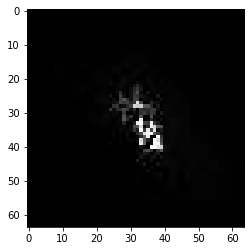

FileNotFoundError: [Errno 2] No such file or directory: '../data/resnet50v2_predicted_threshold80.0/river/7-87.jpeg'

In [6]:
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

results = []
rivers = []
other = []
threshold = 0.80
model = resnet50v2model

for i in range(25000):
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i)+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    # print(model.predict(x))
    results.append(model.predict(x,verbose=0))
    if (model.predict(x,verbose=0) > threshold):
        print("----------------------------------------------------------------------"+str(i)+" is a predicted river")
        
for i in range(len(results)):
    if (results[i][0] >= threshold):
        rivers.append([i,results[i][0]])
    else:
        other.append([i,results[i][0]])
        
print("number of rivers:",len(rivers))
print("number of other:",len(other))



confidence for 7 is 0.87780297


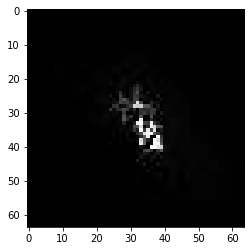

confidence for 12 is 0.90593666


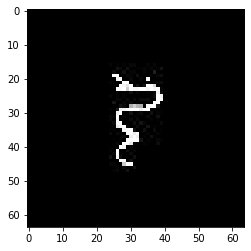

confidence for 13 is 0.87056714


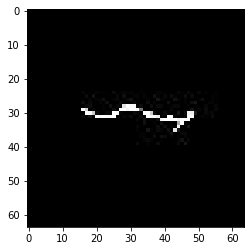

confidence for 16 is 0.96477306


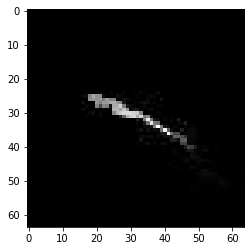

confidence for 54 is 0.99997914


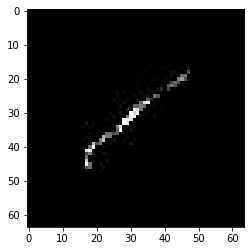

confidence for 58 is 0.9479224


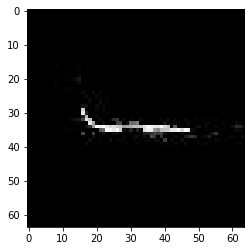

confidence for 71 is 0.8835994


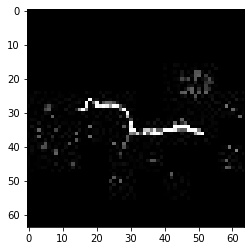

confidence for 89 is 1.0


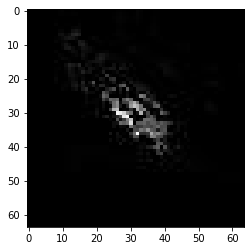

confidence for 99 is 0.9871267


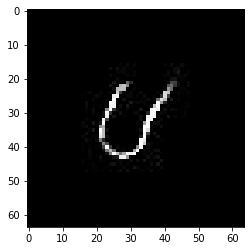

confidence for 107 is 0.886924


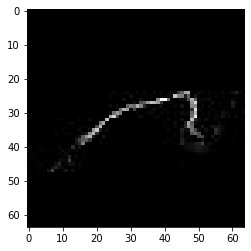

confidence for 114 is 0.99901897


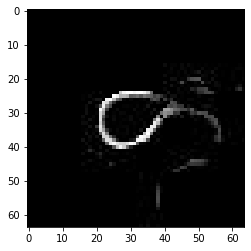

confidence for 140 is 0.9999985


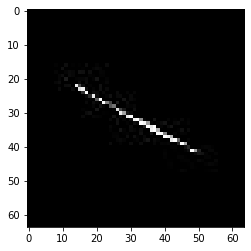

confidence for 153 is 0.8480848


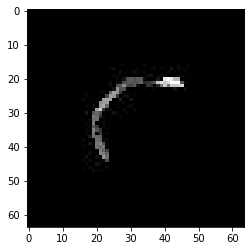

confidence for 175 is 0.9991806


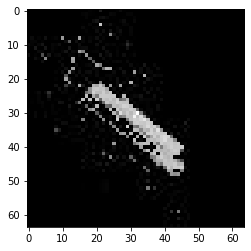

confidence for 178 is 0.89927965


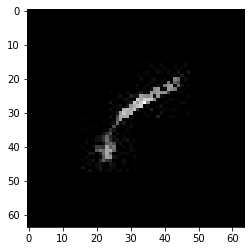

confidence for 207 is 0.8327663


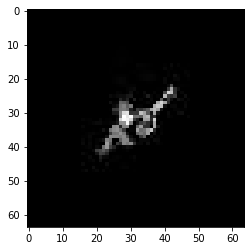

confidence for 209 is 0.98470134


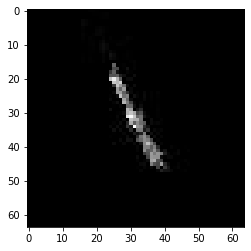

confidence for 211 is 0.87703925


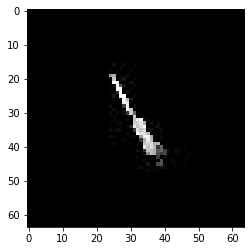

confidence for 219 is 0.9991029


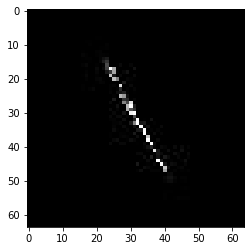

confidence for 232 is 0.97123337


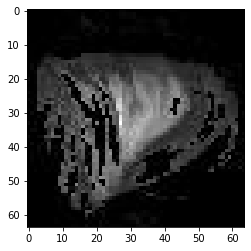

confidence for 259 is 0.86693144


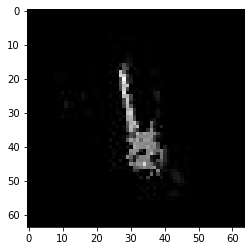

confidence for 296 is 0.99993044


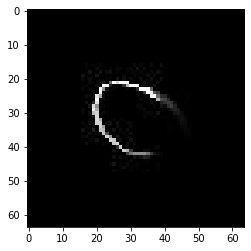

confidence for 334 is 0.99957865


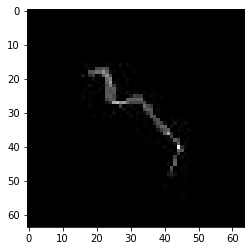

confidence for 336 is 0.9988126


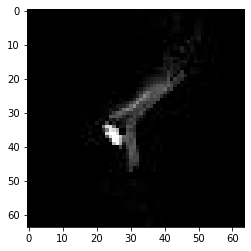

confidence for 343 is 0.9976767


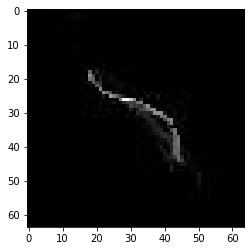

confidence for 357 is 0.94783515


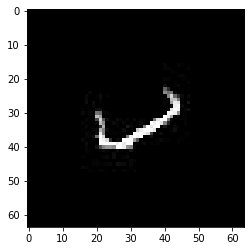

confidence for 368 is 0.9913781


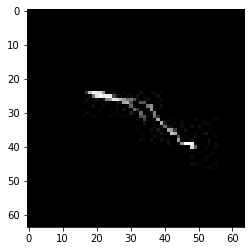

confidence for 379 is 0.9993011


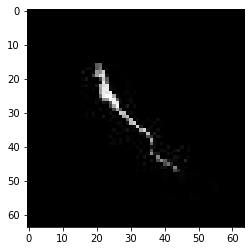

confidence for 449 is 0.9979276


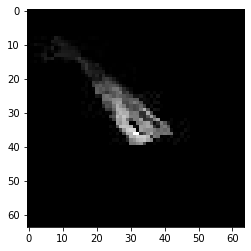

confidence for 467 is 0.8275145


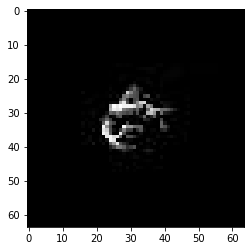

confidence for 484 is 0.98622566


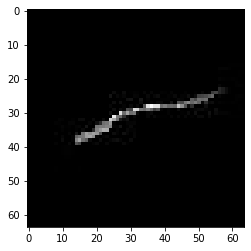

confidence for 509 is 0.82422125


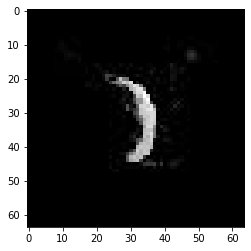

confidence for 542 is 0.88493407


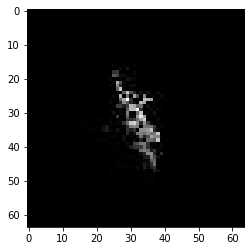

confidence for 583 is 0.95814604


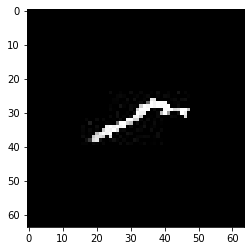

confidence for 594 is 0.99233055


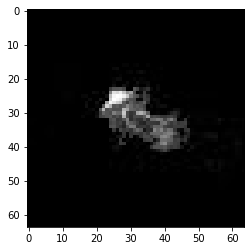

confidence for 618 is 0.95550084


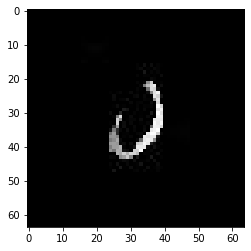

confidence for 621 is 0.9944486


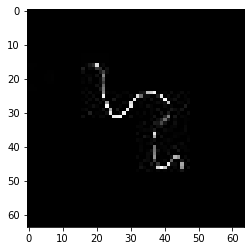

confidence for 639 is 0.9985265


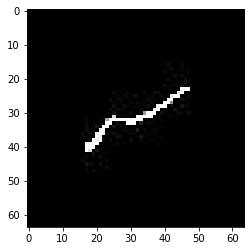

confidence for 644 is 0.96756774


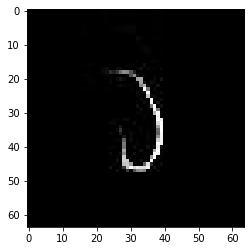

confidence for 648 is 0.9980822


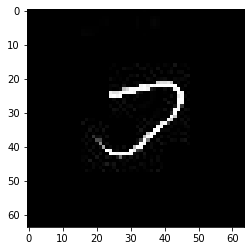

confidence for 658 is 0.96309406


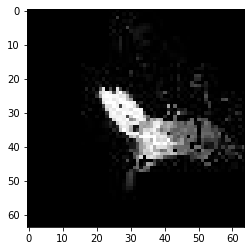

confidence for 662 is 0.9718611


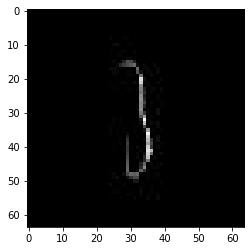

confidence for 676 is 0.8695952


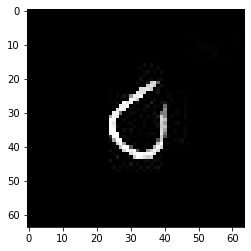

confidence for 688 is 0.9311225


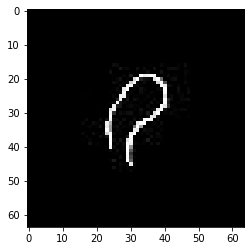

confidence for 702 is 0.9570413


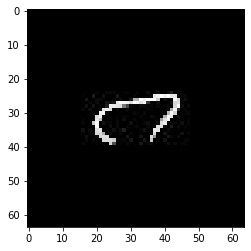

confidence for 707 is 0.97691596


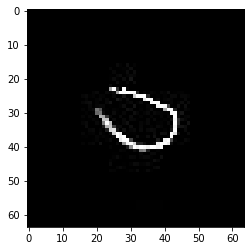

confidence for 741 is 0.9859558


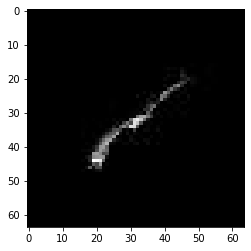

confidence for 746 is 0.95892894


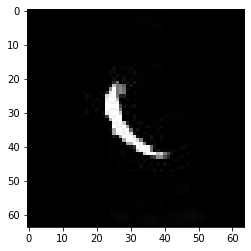

confidence for 750 is 0.89058024


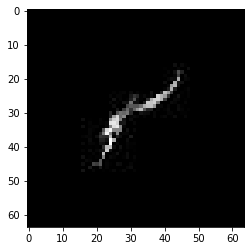

confidence for 770 is 0.9849123


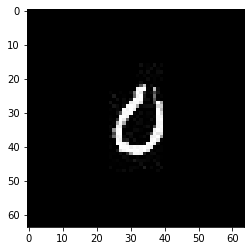

confidence for 780 is 0.97817045


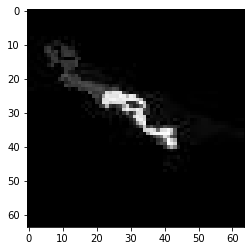

confidence for 797 is 0.9874719


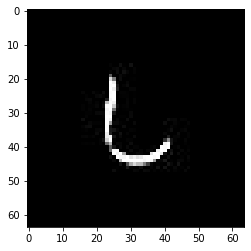

confidence for 798 is 0.92995733


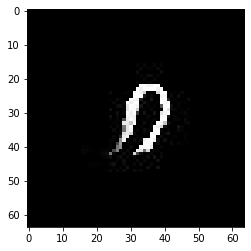

confidence for 816 is 0.96140623


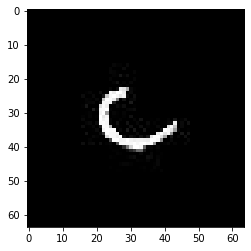

confidence for 818 is 0.95055026


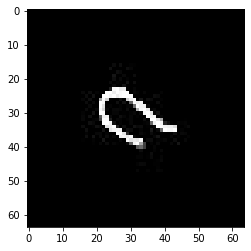

confidence for 827 is 0.8824021


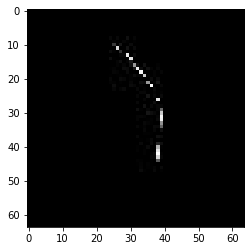

confidence for 841 is 0.9919614


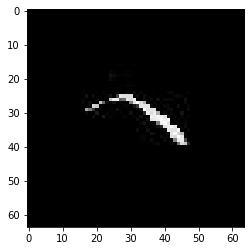

confidence for 850 is 0.8887082


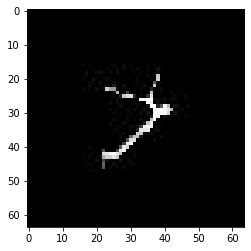

confidence for 860 is 0.95797765


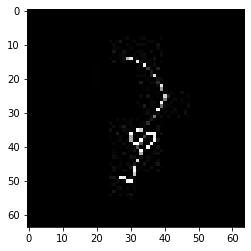

confidence for 873 is 0.9872939


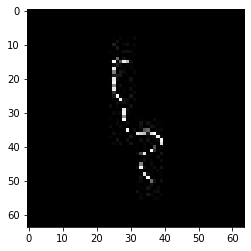

confidence for 876 is 0.9978356


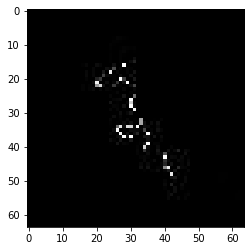

confidence for 879 is 0.99999774


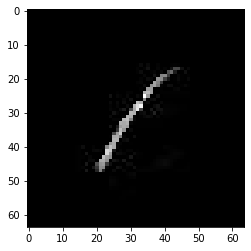

confidence for 884 is 0.8462969


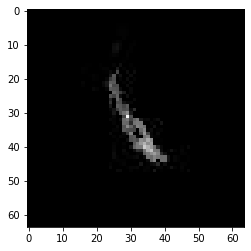

confidence for 892 is 0.99746424


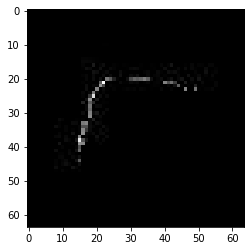

confidence for 894 is 0.99999887


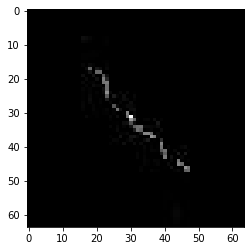

confidence for 904 is 0.8887521


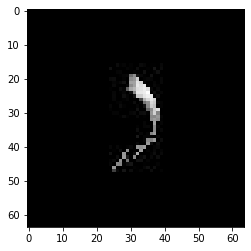

confidence for 910 is 0.9222503


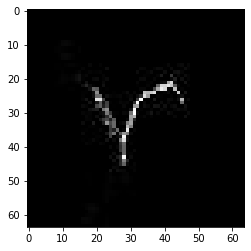

confidence for 918 is 0.9640152


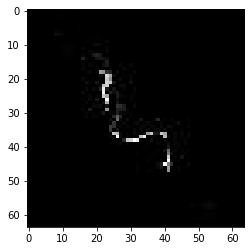

confidence for 919 is 0.9254308


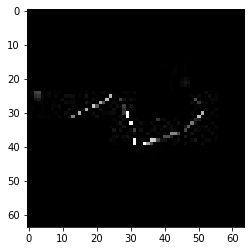

confidence for 926 is 0.8744915


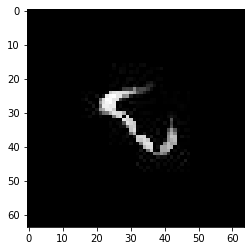

confidence for 944 is 0.95915073


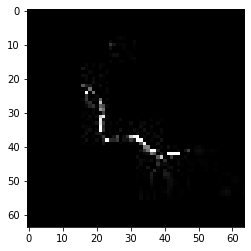

confidence for 946 is 0.9999799


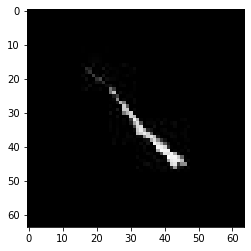

confidence for 947 is 0.9883985


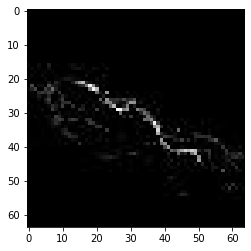

confidence for 969 is 0.8700651


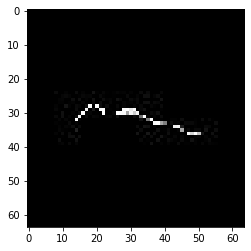

confidence for 972 is 0.9918375


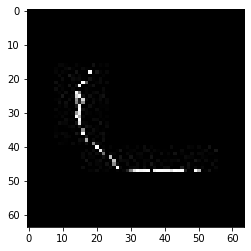

confidence for 976 is 0.96513665


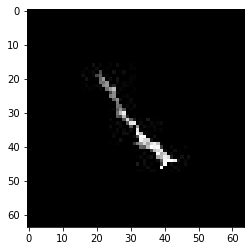

confidence for 982 is 0.9404865


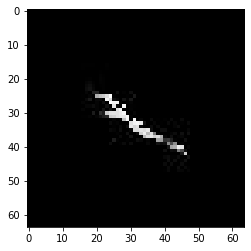

confidence for 994 is 0.998753


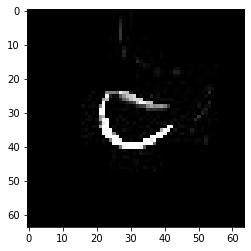

confidence for 995 is 0.99999976


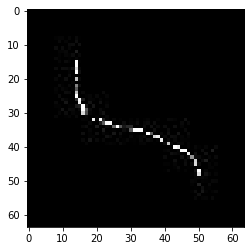

confidence for 1017 is 0.9831866


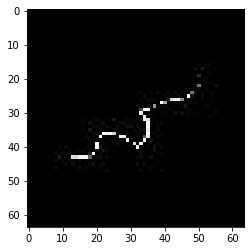

confidence for 1021 is 0.9834052


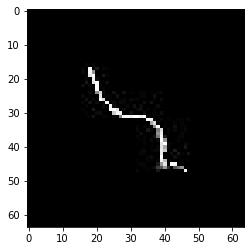

confidence for 1026 is 0.8265148


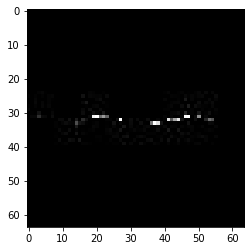

confidence for 1043 is 0.9990217


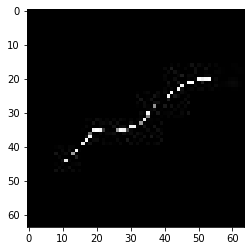

confidence for 1048 is 0.91829216


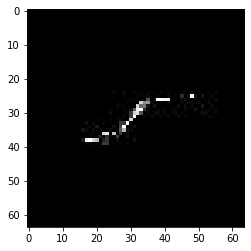

confidence for 1051 is 0.9869601


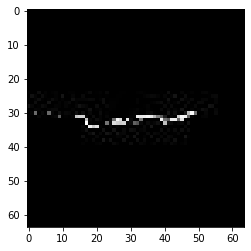

confidence for 1055 is 0.9791314


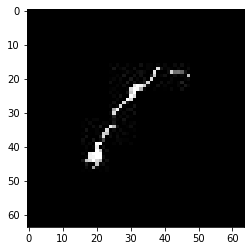

confidence for 1074 is 0.98037684


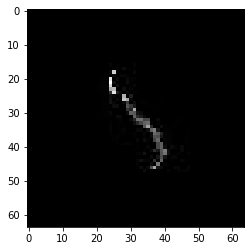

confidence for 1137 is 0.9378526


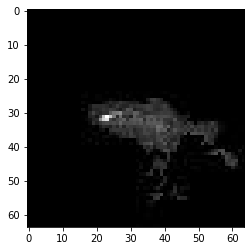

confidence for 1142 is 0.8396639


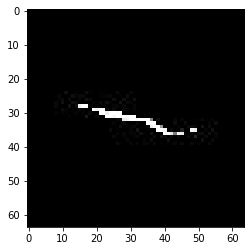

confidence for 1145 is 0.9693644


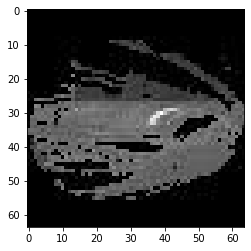

confidence for 1150 is 0.9999995


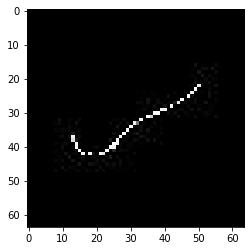

confidence for 1174 is 0.9549579


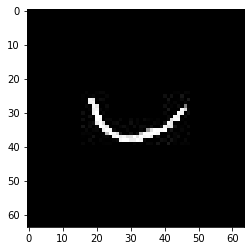

confidence for 1180 is 0.9999613


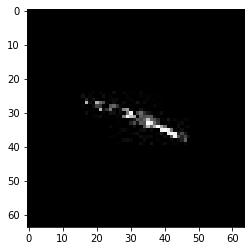

confidence for 1194 is 0.9379933


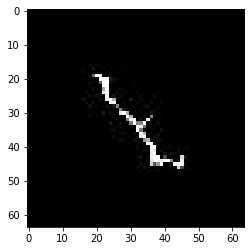

confidence for 1196 is 0.8254476


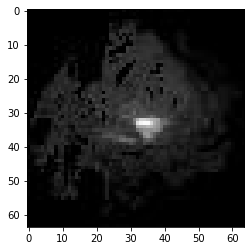

confidence for 1198 is 0.99921125


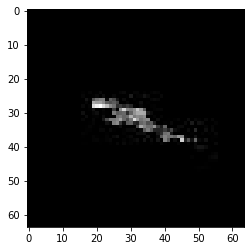

confidence for 1208 is 0.9999615


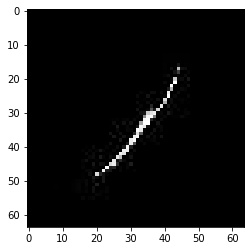

confidence for 1209 is 0.91087395


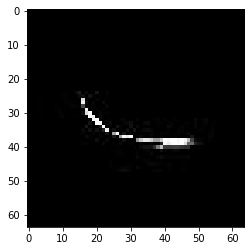

confidence for 1216 is 0.97137845


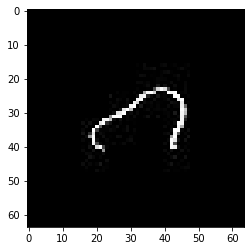

confidence for 1217 is 0.99999595


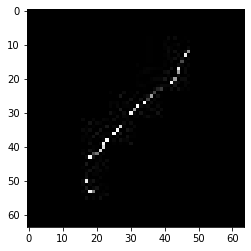

confidence for 1228 is 0.8890638


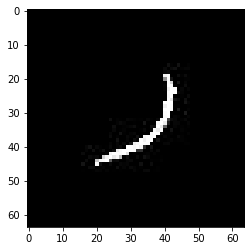

confidence for 1242 is 0.9440599


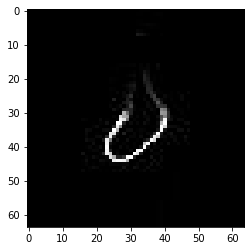

confidence for 1255 is 0.99736774


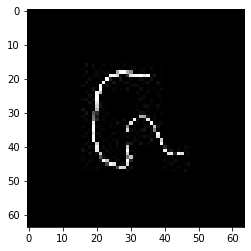

confidence for 1262 is 0.9999686


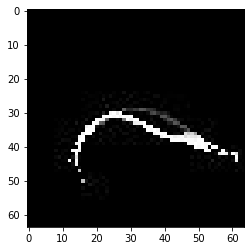

confidence for 1264 is 0.82583886


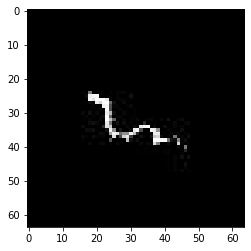

confidence for 1267 is 0.80292386


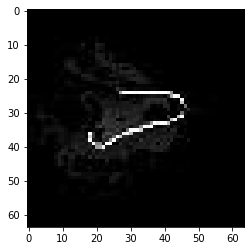

confidence for 1273 is 0.9511379


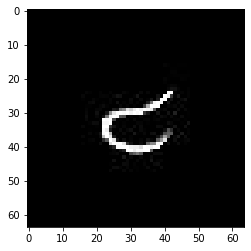

confidence for 1274 is 0.99794376


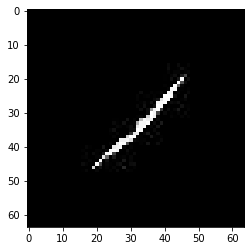

confidence for 1277 is 0.98942816


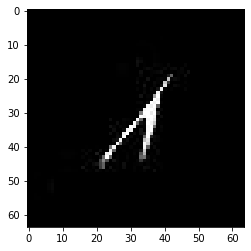

confidence for 1283 is 0.99814504


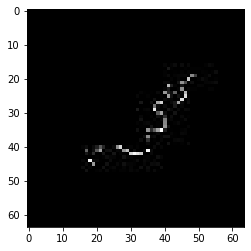

confidence for 1299 is 0.8168377


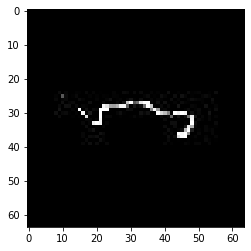

confidence for 1319 is 0.9991294


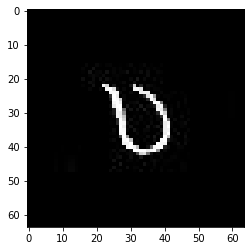

confidence for 1334 is 0.99589795


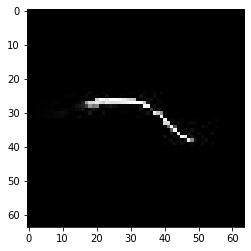

confidence for 1338 is 0.9016117


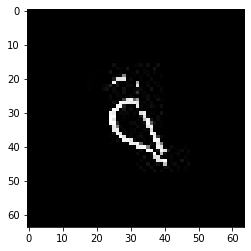

confidence for 1345 is 0.9364426


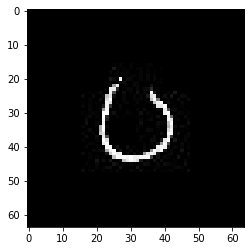

confidence for 1355 is 0.9732442


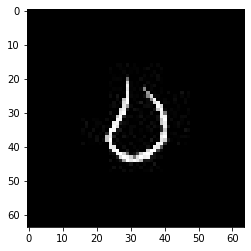

confidence for 1367 is 0.9996376


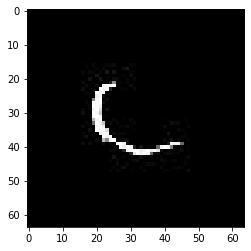

confidence for 1376 is 0.9790123


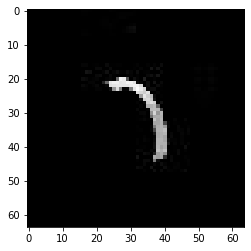

confidence for 1401 is 0.99999917


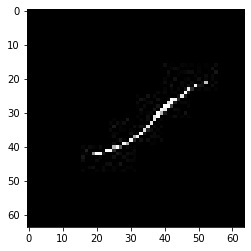

confidence for 1405 is 0.99592495


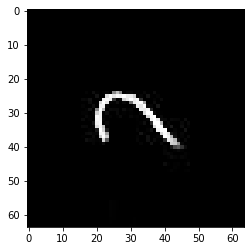

confidence for 1408 is 0.99436873


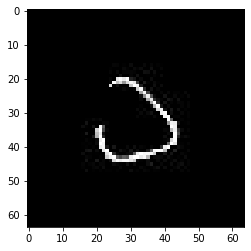

confidence for 1412 is 0.8864358


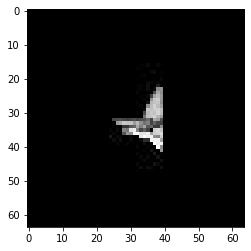

confidence for 1419 is 0.9985451


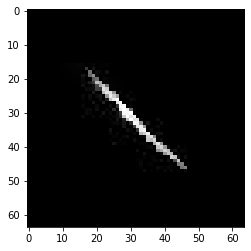

confidence for 1420 is 0.9818005


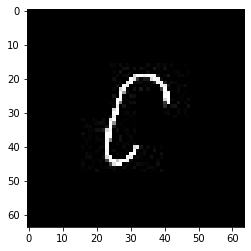

confidence for 1455 is 0.98989844


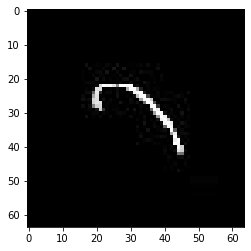

confidence for 1479 is 0.99510044


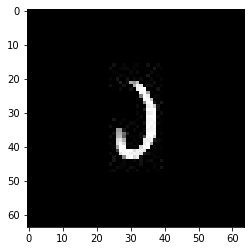

confidence for 1483 is 0.92858493


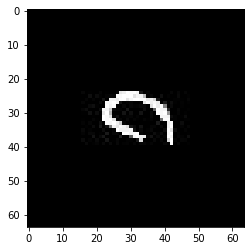

confidence for 1495 is 0.96862775


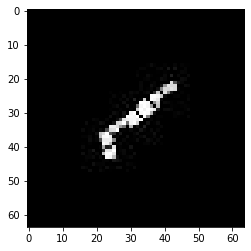

confidence for 1522 is 0.9463476


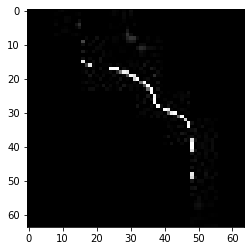

confidence for 1531 is 0.9504501


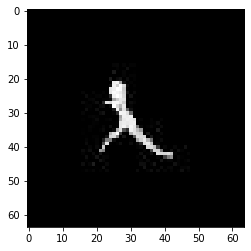

confidence for 1536 is 0.9893671


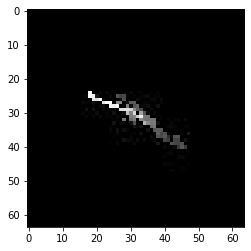

confidence for 1586 is 0.99896944


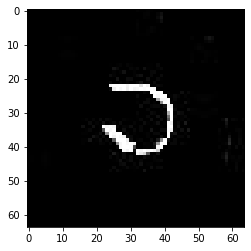

confidence for 1598 is 0.9999995


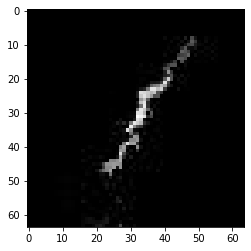

confidence for 1601 is 0.96152794


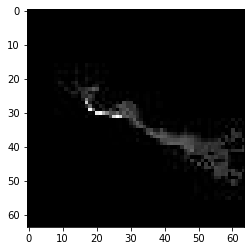

confidence for 1602 is 0.9753867


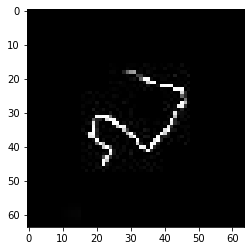

confidence for 1605 is 0.96456915


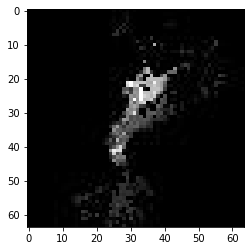

confidence for 1608 is 0.9982457


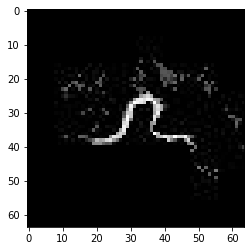

confidence for 1659 is 0.999199


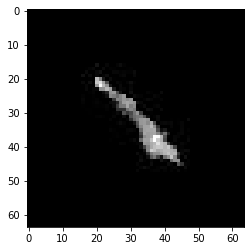

confidence for 1685 is 0.96728754


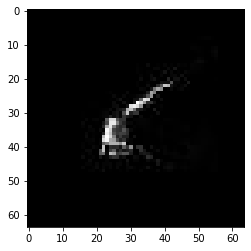

confidence for 1686 is 0.84958446


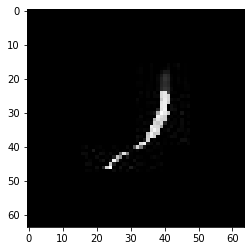

confidence for 1697 is 0.9993733


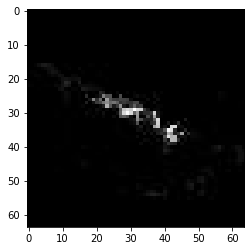

confidence for 1700 is 0.99998134


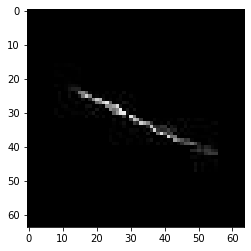

confidence for 1713 is 0.9645849


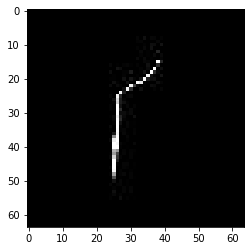

confidence for 1748 is 0.81915116


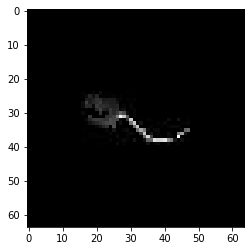

confidence for 1751 is 0.9990664


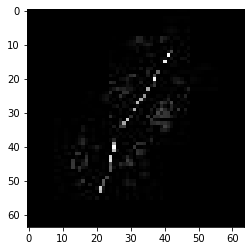

confidence for 1758 is 0.98864186


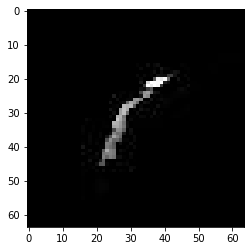

confidence for 1768 is 0.9379796


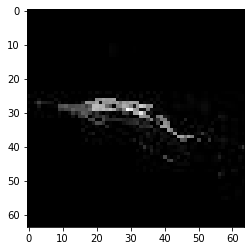

confidence for 1770 is 0.988737


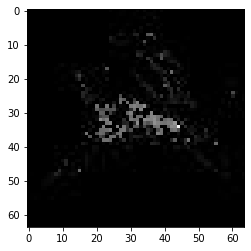

confidence for 1776 is 0.9086448


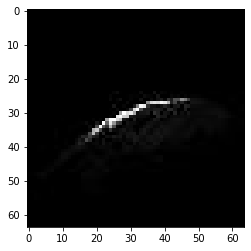

confidence for 1777 is 0.97574466


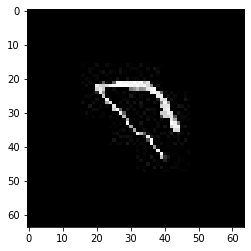

confidence for 1779 is 0.9879919


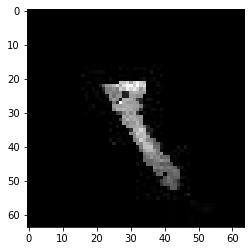

confidence for 1789 is 0.8730706


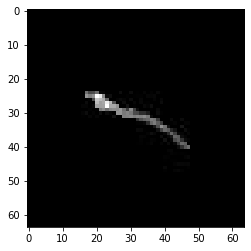

confidence for 1794 is 0.93250847


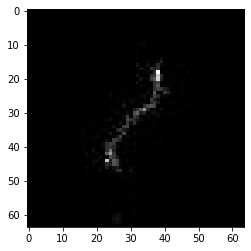

confidence for 1835 is 0.9812064


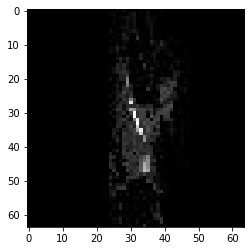

confidence for 1837 is 0.9999851


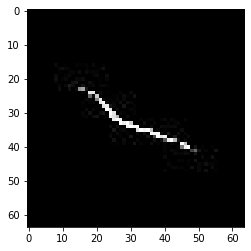

confidence for 1844 is 0.86007524


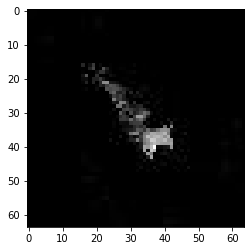

confidence for 1848 is 0.9635015


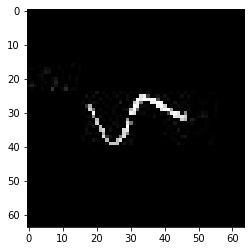

confidence for 1850 is 0.99367434


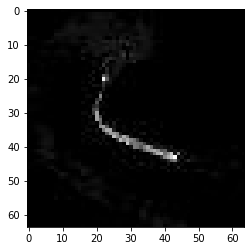

confidence for 1901 is 0.9567106


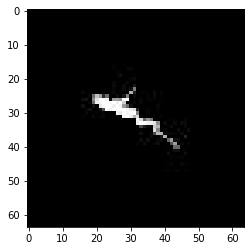

confidence for 1957 is 0.8078809


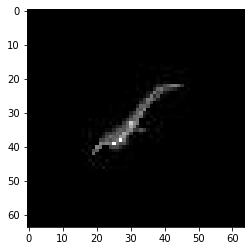

confidence for 1965 is 0.99671173


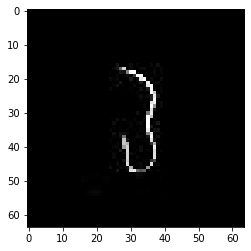

confidence for 1971 is 0.9970425


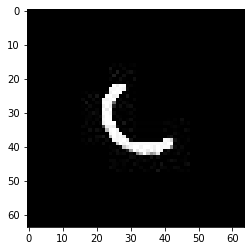

confidence for 1973 is 0.9630826


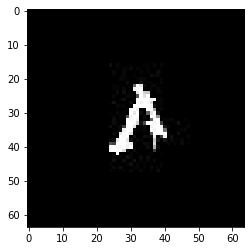

confidence for 1979 is 0.99905396


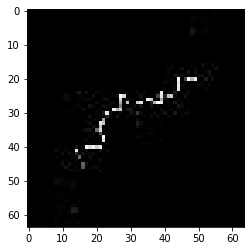

confidence for 1983 is 0.97793055


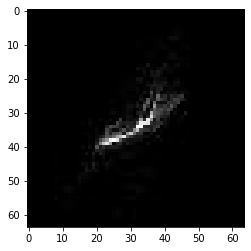

confidence for 1999 is 0.8299883


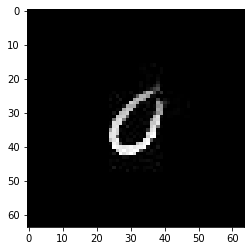

confidence for 2003 is 0.89580286


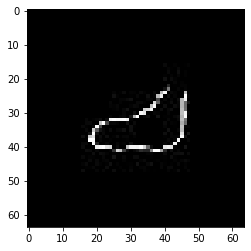

confidence for 2035 is 0.91907954


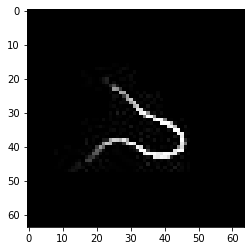

confidence for 2037 is 0.9631159


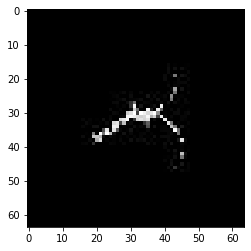

confidence for 2043 is 0.9856583


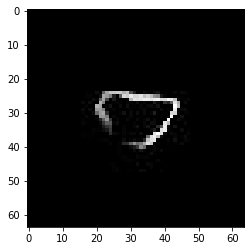

confidence for 2054 is 0.981345


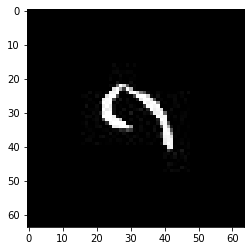

confidence for 2061 is 0.8487166


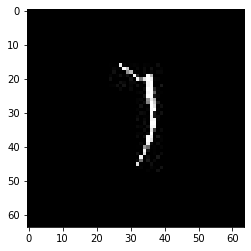

confidence for 2109 is 0.98616743


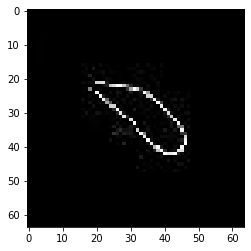

confidence for 2111 is 0.9953588


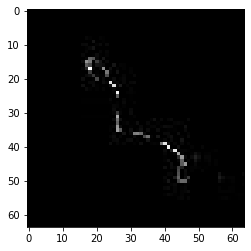

confidence for 2131 is 0.9983204


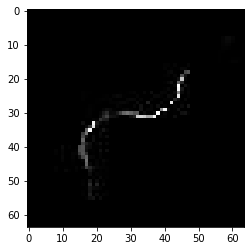

confidence for 2151 is 0.9999744


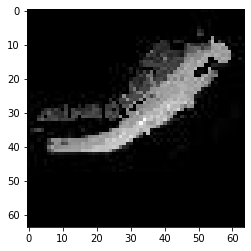

confidence for 2153 is 0.91321856


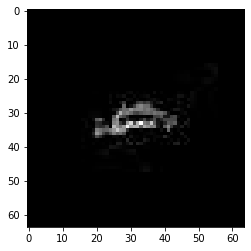

confidence for 2163 is 0.9898977


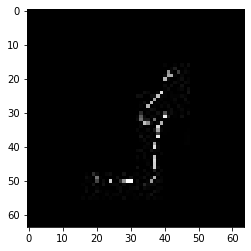

confidence for 2171 is 0.9969497


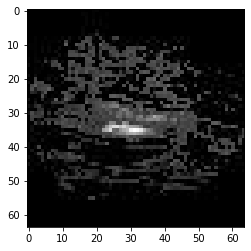

confidence for 2184 is 0.89316213


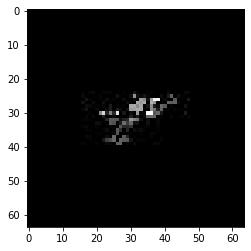

confidence for 2190 is 0.9720865


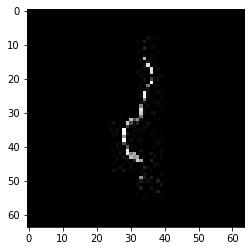

confidence for 2191 is 0.9996661


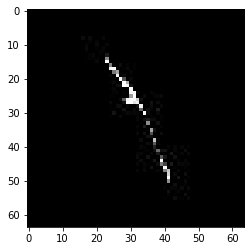

confidence for 2208 is 0.99526054


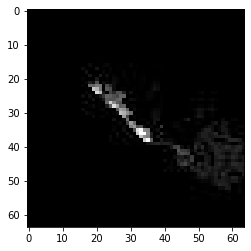

confidence for 2211 is 0.99553907


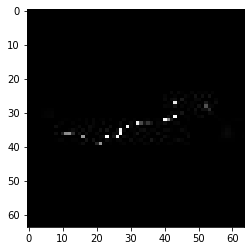

confidence for 2242 is 0.9681958


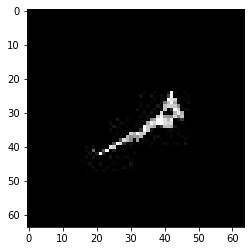

confidence for 2278 is 0.97352237


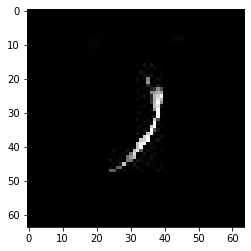

confidence for 2283 is 0.99953157


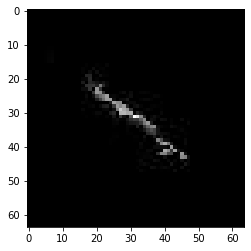

confidence for 2284 is 0.85976094


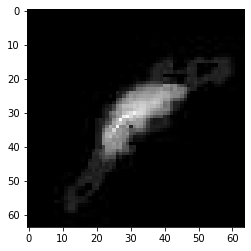

confidence for 2295 is 0.96864957


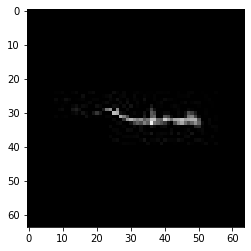

confidence for 2301 is 0.9952999


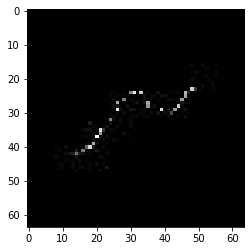

confidence for 2302 is 0.99808943


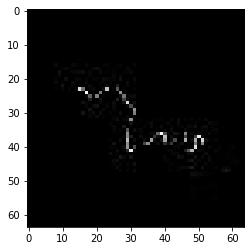

confidence for 2325 is 0.8917144


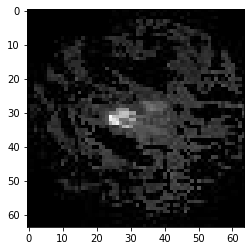

confidence for 2329 is 0.99979025


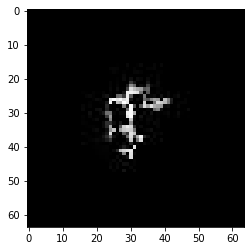

confidence for 2344 is 0.9919273


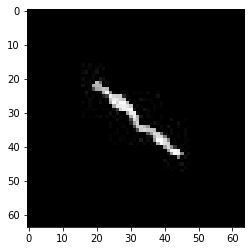

confidence for 2387 is 0.97024786


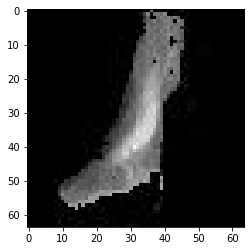

confidence for 2406 is 0.9903693


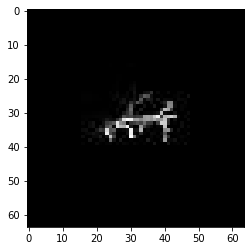

confidence for 2409 is 0.9993058


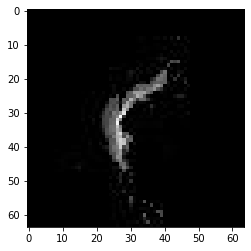

confidence for 2438 is 0.91129434


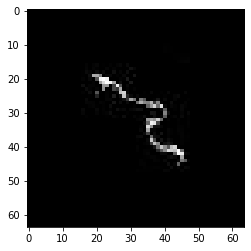

confidence for 2452 is 0.99586517


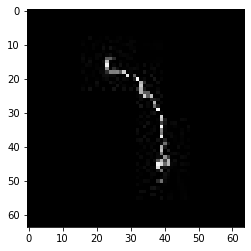

confidence for 2483 is 0.9705547


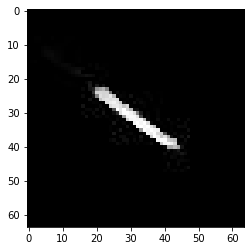

confidence for 2486 is 0.99998003


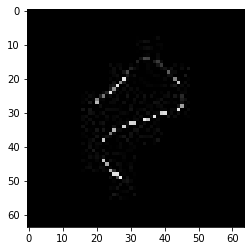

confidence for 2490 is 1.0


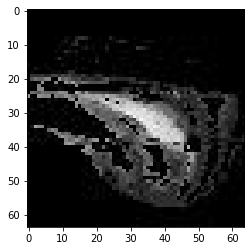

confidence for 2528 is 0.8656799


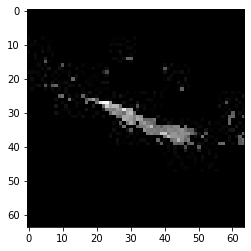

confidence for 2544 is 0.98985064


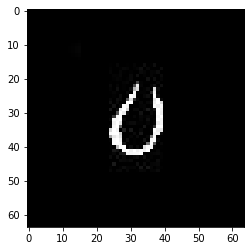

confidence for 2559 is 0.9907295


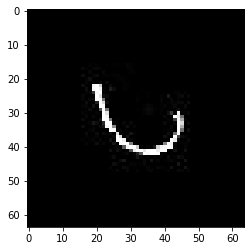

confidence for 2616 is 0.9797015


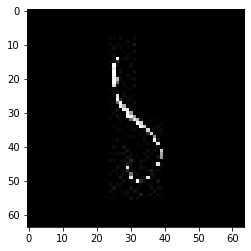

confidence for 2644 is 0.99870795


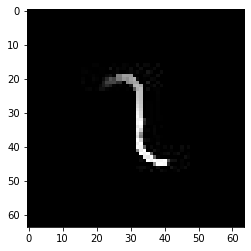

confidence for 2672 is 0.9996612


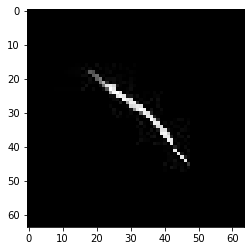

confidence for 2680 is 0.9972436


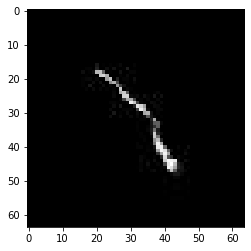

confidence for 2682 is 0.97808635


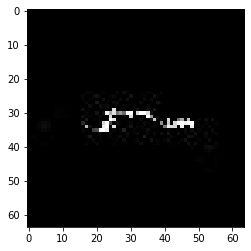

confidence for 2689 is 0.8919662


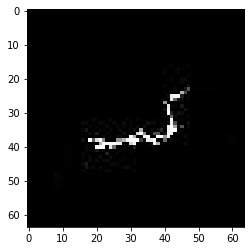

confidence for 2698 is 0.9945247


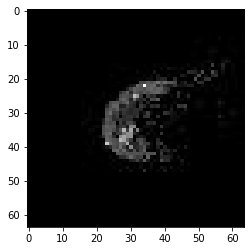

confidence for 2706 is 0.9928094


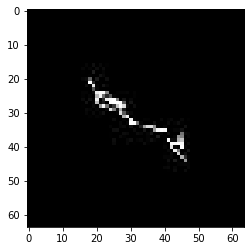

confidence for 2712 is 0.9690541


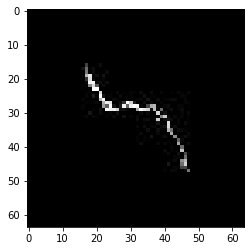

confidence for 2744 is 0.99276763


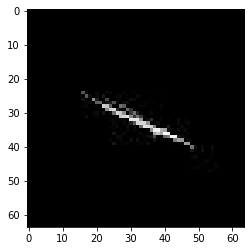

confidence for 2753 is 0.9983744


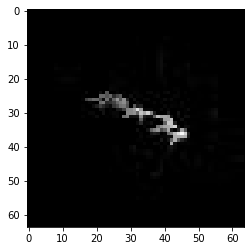

confidence for 2754 is 0.9541101


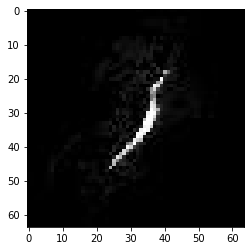

confidence for 2772 is 0.96536714


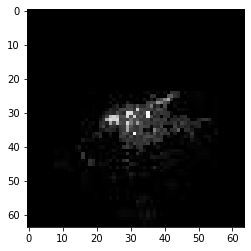

confidence for 2779 is 0.97342175


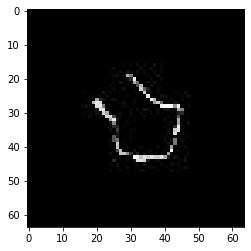

confidence for 2799 is 0.9998114


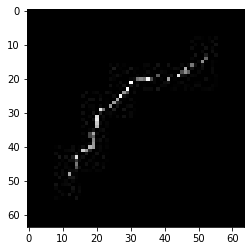

confidence for 2823 is 0.97877127


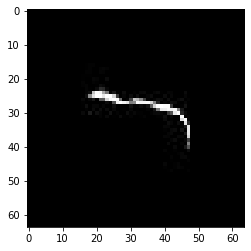

confidence for 2824 is 0.99888587


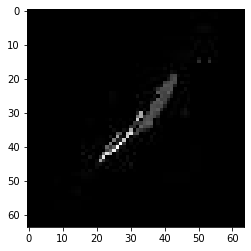

confidence for 2834 is 0.98633593


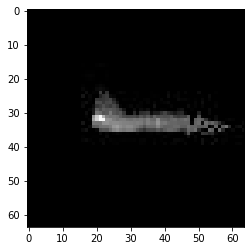

confidence for 2841 is 0.96735764


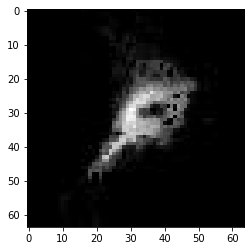

confidence for 2842 is 0.8296516


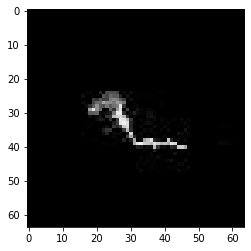

confidence for 2857 is 0.8001593


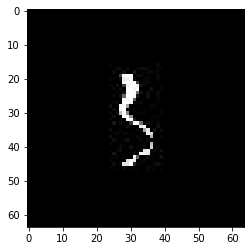

confidence for 2862 is 0.99482554


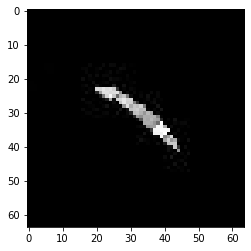

confidence for 2890 is 0.858722


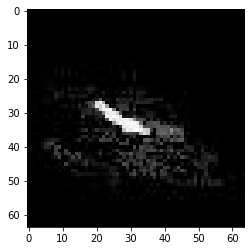

confidence for 2928 is 0.99973446


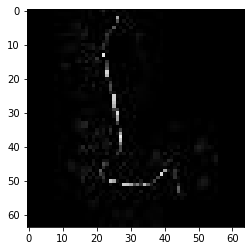

confidence for 2979 is 0.9450759


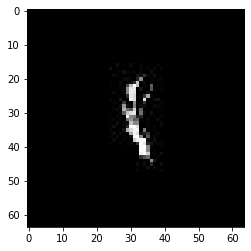

confidence for 3020 is 0.8104037


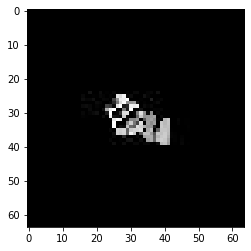

confidence for 3044 is 0.8558262


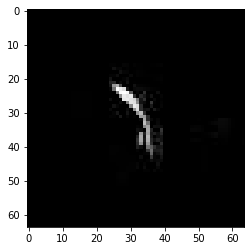

confidence for 3063 is 0.9984326


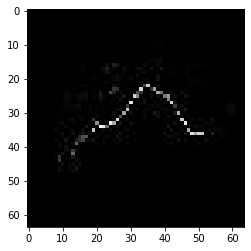

confidence for 3066 is 0.97323734


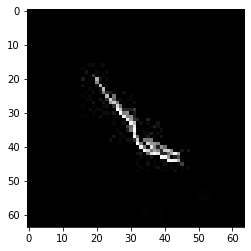

confidence for 3074 is 0.9971495


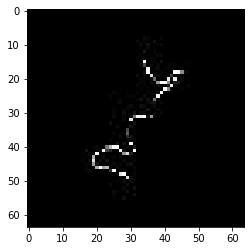

confidence for 3075 is 0.9705011


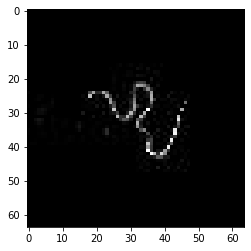

confidence for 3080 is 0.93887657


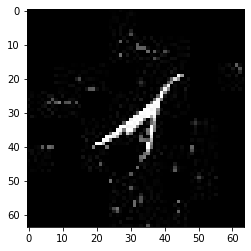

confidence for 3090 is 0.99631405


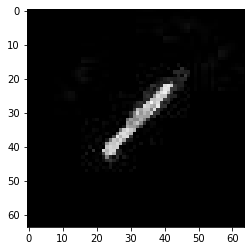

confidence for 3095 is 0.9992855


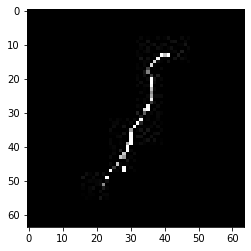

confidence for 3126 is 0.9943735


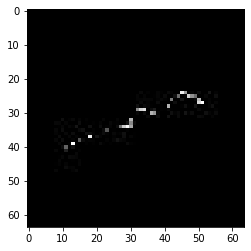

confidence for 3136 is 0.99285513


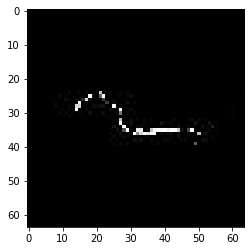

confidence for 3168 is 0.87747955


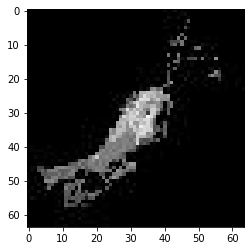

confidence for 3188 is 0.8293154


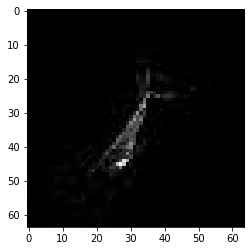

confidence for 3211 is 0.9971759


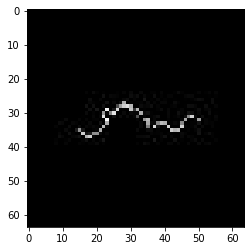

confidence for 3259 is 0.97371584


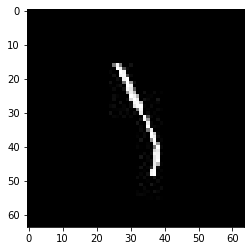

confidence for 3268 is 0.9792112


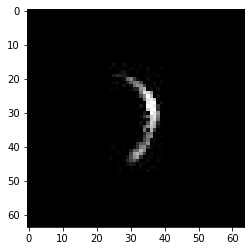

confidence for 3271 is 0.9997835


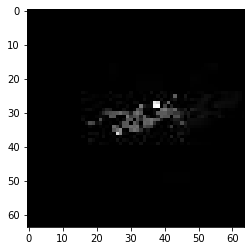

confidence for 3299 is 0.8198452


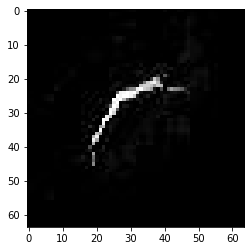

confidence for 3306 is 0.99992293


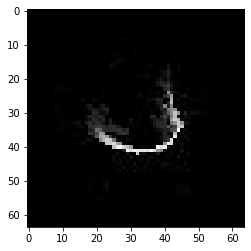

confidence for 3344 is 0.99912447


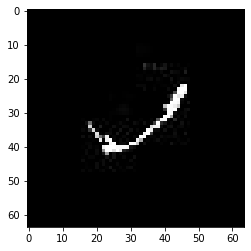

confidence for 3353 is 0.9958169


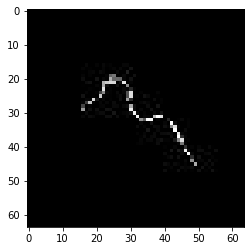

confidence for 3373 is 0.95879436


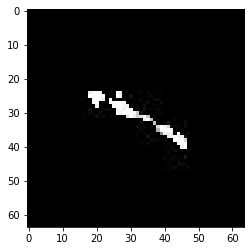

confidence for 3381 is 0.9979529


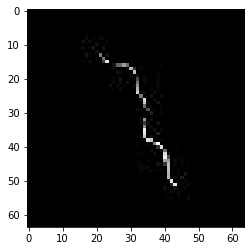

confidence for 3394 is 0.9023281


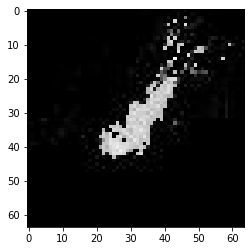

confidence for 3414 is 0.862851


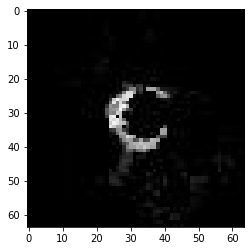

confidence for 3415 is 0.8193227


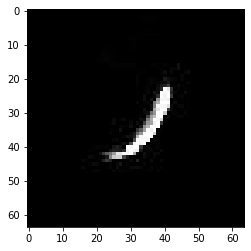

confidence for 3444 is 0.9700955


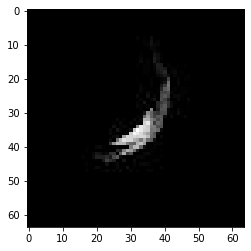

confidence for 3470 is 0.95208967


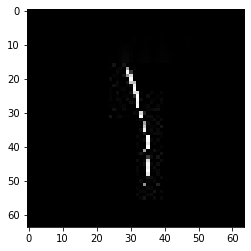

confidence for 3526 is 0.99999875


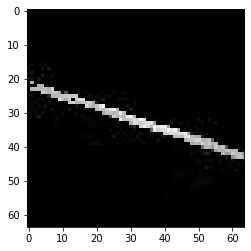

confidence for 3540 is 0.97105503


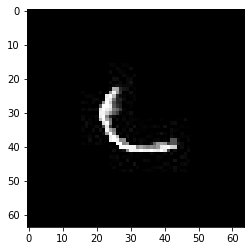

confidence for 3577 is 0.98493546


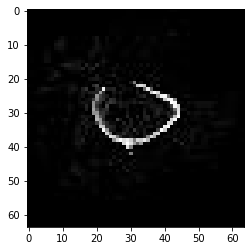

confidence for 3580 is 0.9975047


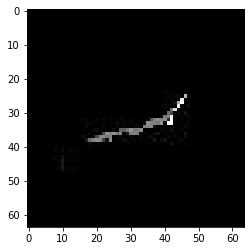

confidence for 3636 is 0.9807725


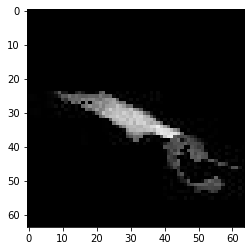

confidence for 3637 is 0.9876776


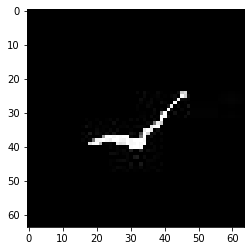

confidence for 3638 is 0.9999677


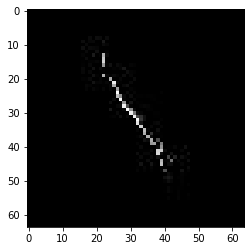

confidence for 3639 is 0.9602553


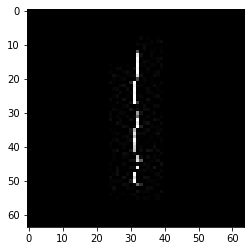

confidence for 3641 is 0.92614514


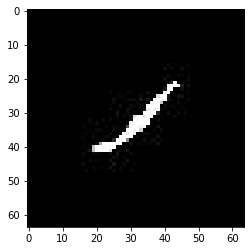

confidence for 3648 is 0.9766136


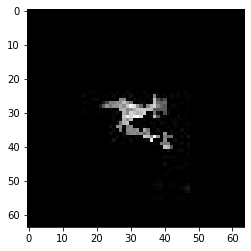

confidence for 3656 is 0.99814886


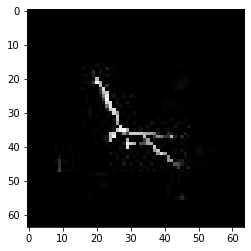

confidence for 3704 is 0.99941367


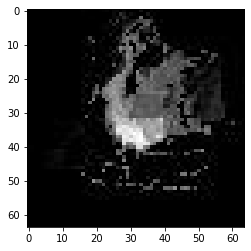

confidence for 3709 is 0.9585766


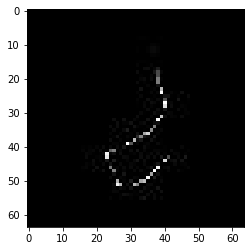

confidence for 3710 is 0.9870163


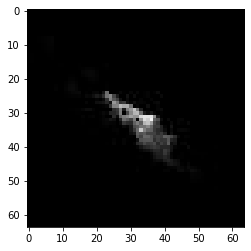

confidence for 3722 is 0.9973028


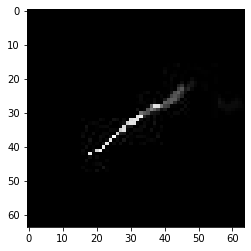

confidence for 3724 is 0.98603594


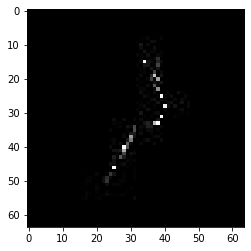

confidence for 3731 is 0.9999933


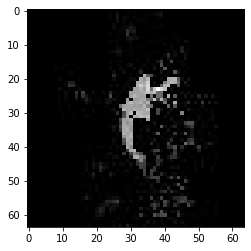

confidence for 3734 is 0.89269376


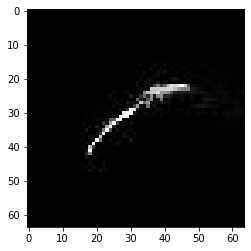

confidence for 3794 is 0.9475748


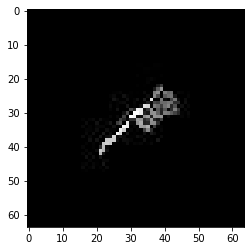

confidence for 3803 is 0.9467267


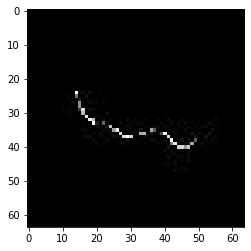

confidence for 3806 is 0.99953777


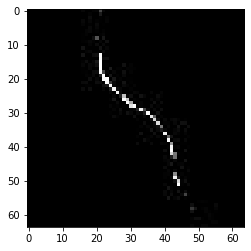

confidence for 3813 is 0.93742263


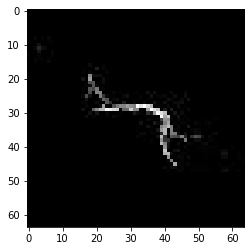

confidence for 3826 is 0.982566


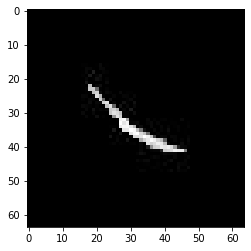

confidence for 3844 is 0.92614716


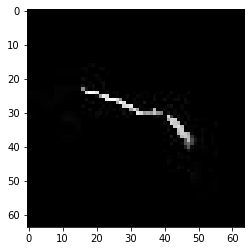

confidence for 3845 is 0.8401285


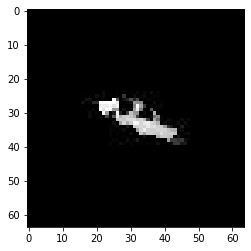

confidence for 3850 is 0.9864091


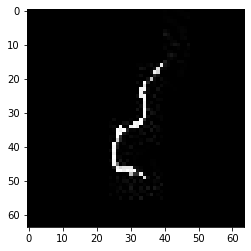

confidence for 3866 is 0.80382216


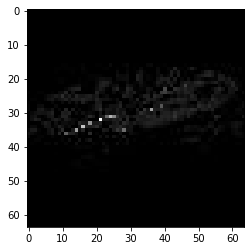

confidence for 3876 is 0.9950965


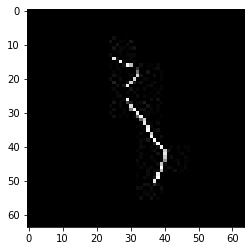

confidence for 3890 is 0.81265175


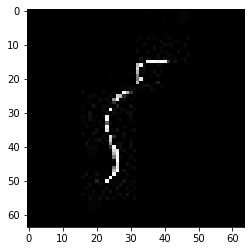

confidence for 3892 is 0.99722666


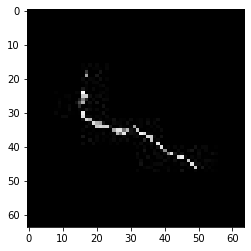

confidence for 3900 is 0.9923037


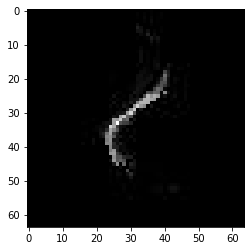

confidence for 3916 is 0.9996223


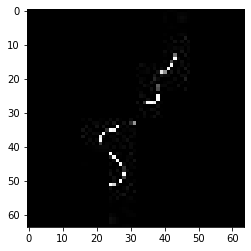

confidence for 3918 is 0.9999962


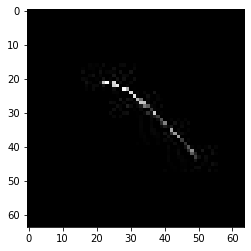

confidence for 3926 is 0.99971956


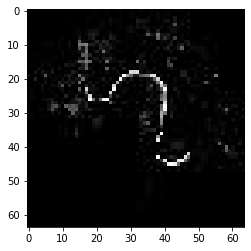

confidence for 3936 is 0.832485


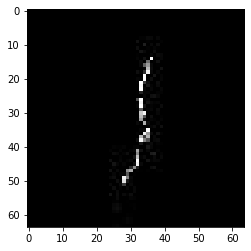

confidence for 3953 is 0.99967045


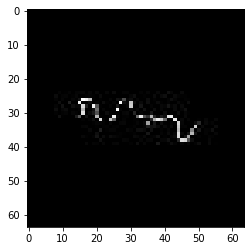

confidence for 3961 is 0.99999994


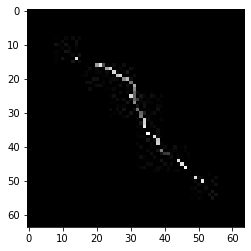

confidence for 3973 is 0.9999832


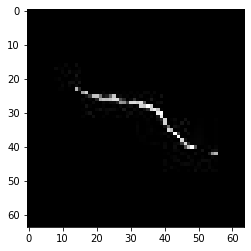

confidence for 3997 is 0.86582553


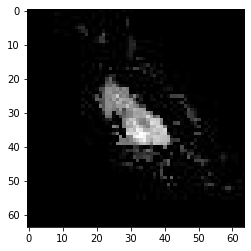

confidence for 4005 is 0.99910206


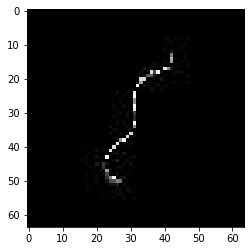

confidence for 4007 is 0.92843956


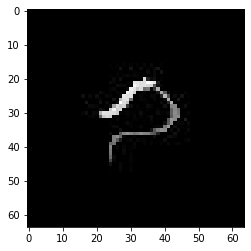

confidence for 4011 is 0.9999004


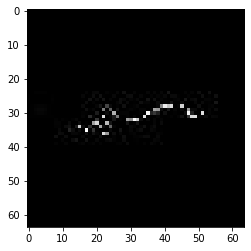

confidence for 4012 is 0.9828292


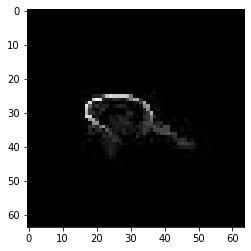

confidence for 4014 is 0.8608433


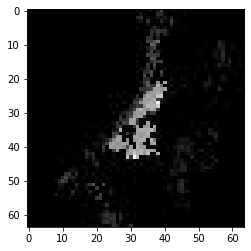

confidence for 4018 is 0.88129044


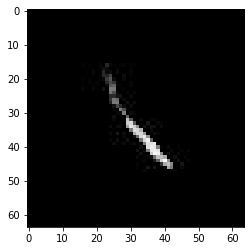

confidence for 4027 is 0.98742837


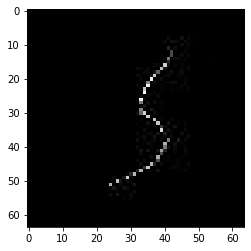

confidence for 4028 is 0.9984857


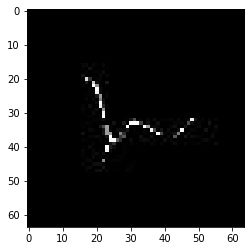

confidence for 4034 is 0.9488465


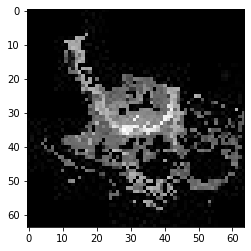

confidence for 4050 is 0.98792243


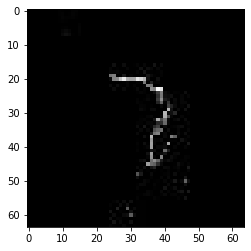

confidence for 4055 is 0.95790863


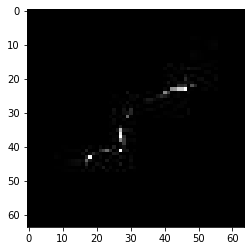

confidence for 4056 is 0.90204597


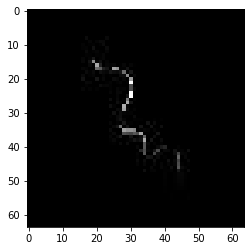

confidence for 4058 is 0.99921894


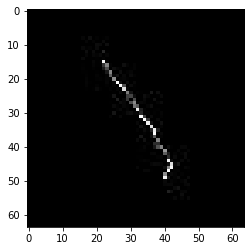

confidence for 4074 is 0.99990666


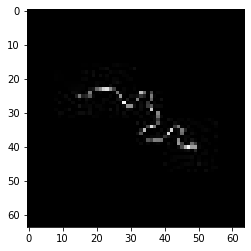

confidence for 4084 is 0.9995963


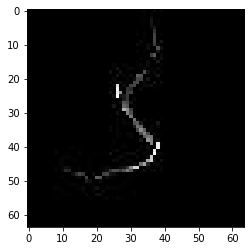

confidence for 4089 is 0.90510786


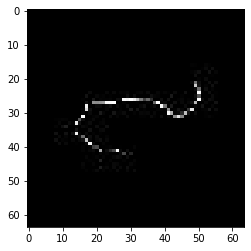

confidence for 4090 is 0.98103255


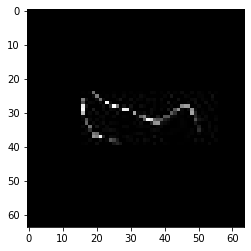

confidence for 4151 is 0.9999994


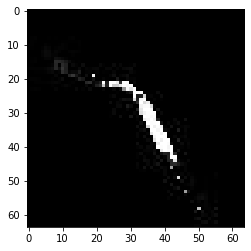

confidence for 4161 is 0.99810916


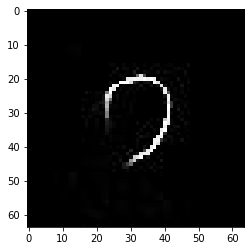

confidence for 4175 is 0.87537223


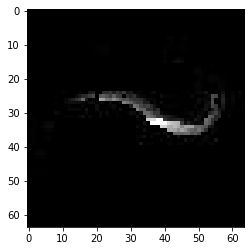

confidence for 4190 is 0.99731314


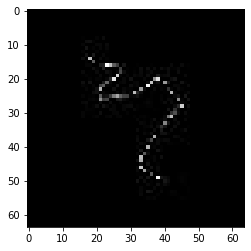

confidence for 4203 is 0.9098856


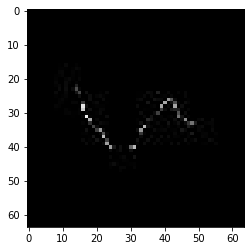

confidence for 4226 is 0.8321357


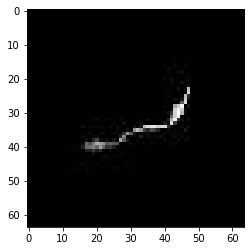

confidence for 4232 is 0.91849744


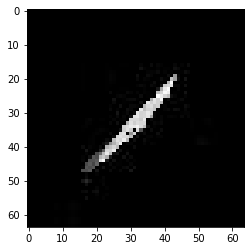

confidence for 4240 is 0.99999565


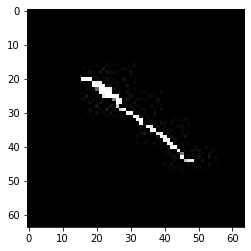

confidence for 4249 is 0.99859303


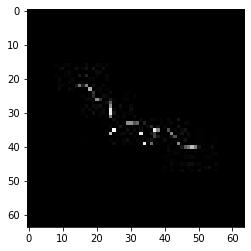

confidence for 4297 is 0.8145359


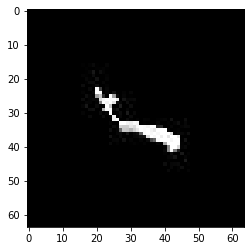

confidence for 4302 is 0.9999996


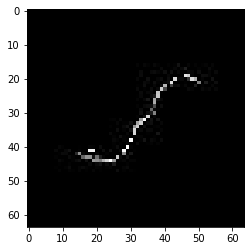

confidence for 4314 is 0.9851864


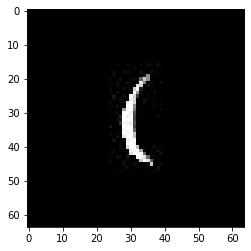

confidence for 4352 is 0.9502481


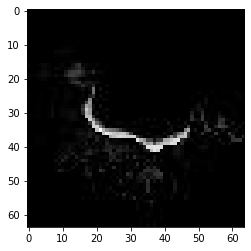

confidence for 4362 is 0.8543859


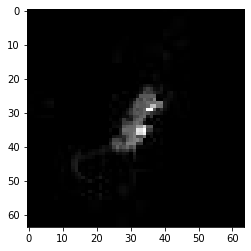

confidence for 4370 is 0.9926504


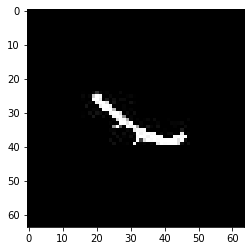

confidence for 4374 is 0.9999285


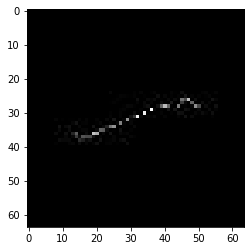

confidence for 4380 is 0.91983867


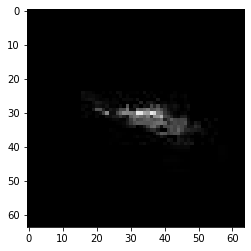

confidence for 4381 is 0.98648983


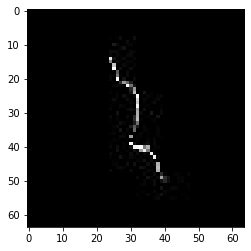

confidence for 4382 is 0.99991566


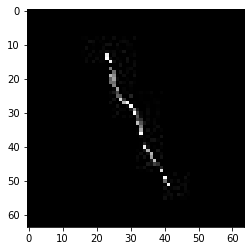

confidence for 4383 is 0.93433994


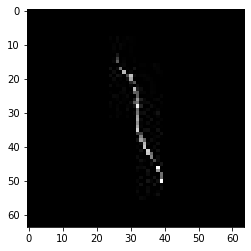

confidence for 4397 is 0.9281136


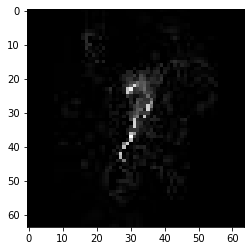

confidence for 4413 is 0.84897965


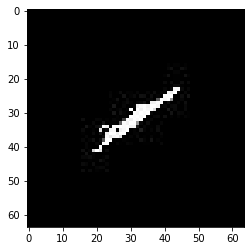

confidence for 4424 is 0.85994476


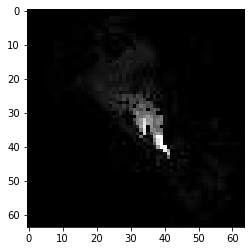

confidence for 4425 is 0.9999362


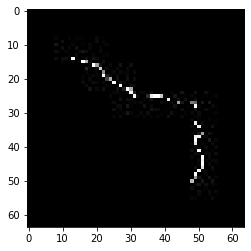

confidence for 4438 is 0.9028249


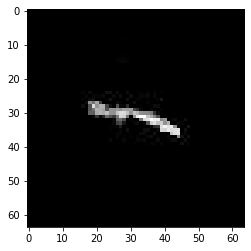

confidence for 4493 is 0.9946078


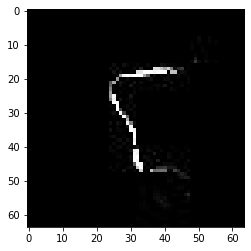

confidence for 4508 is 0.96770525


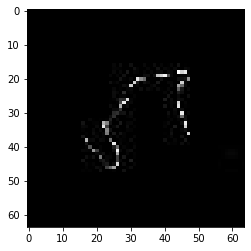

confidence for 4518 is 0.98403966


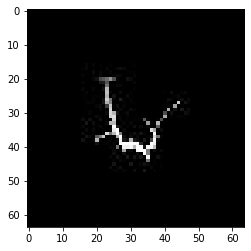

confidence for 4520 is 0.93834525


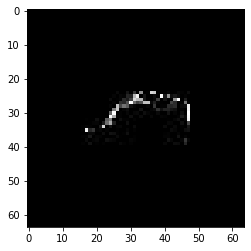

confidence for 4527 is 0.8361377


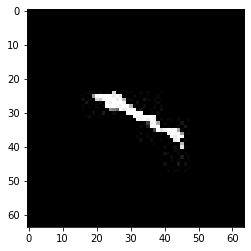

confidence for 4531 is 0.96728075


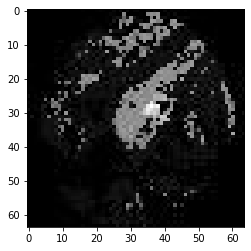

confidence for 4538 is 0.9647067


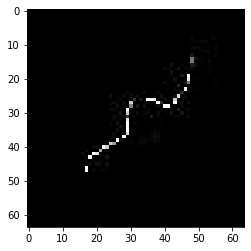

confidence for 4544 is 0.96228915


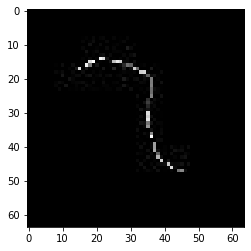

confidence for 4556 is 0.999875


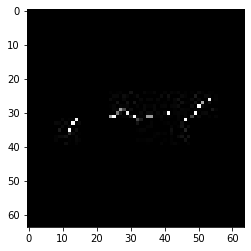

confidence for 4557 is 0.8685211


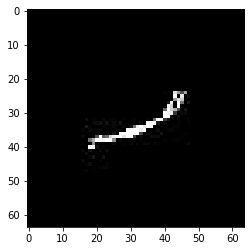

confidence for 4563 is 0.997603


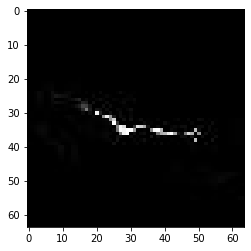

confidence for 4569 is 0.9175558


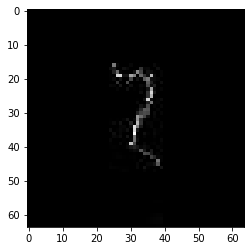

confidence for 4572 is 0.9787463


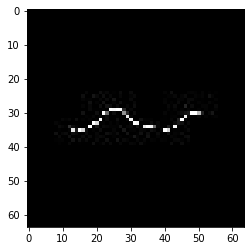

confidence for 4584 is 0.99999917


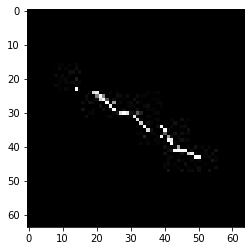

confidence for 4599 is 0.99944985


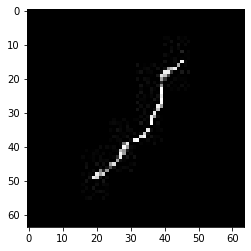

confidence for 4607 is 0.9963968


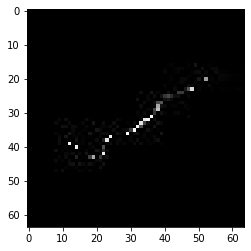

confidence for 4624 is 0.96440774


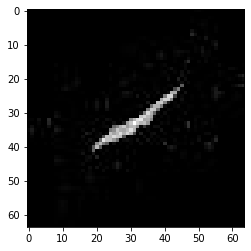

confidence for 4625 is 0.94642687


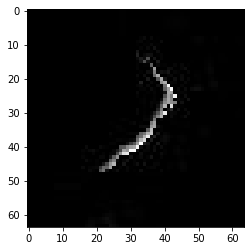

confidence for 4634 is 0.99999976


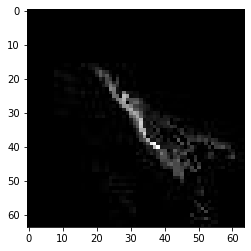

confidence for 4643 is 0.9995765


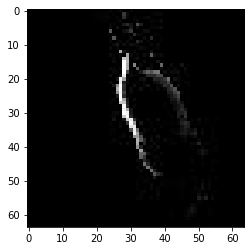

confidence for 4646 is 0.95274585


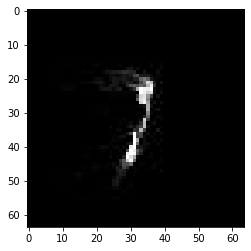

confidence for 4658 is 0.9898765


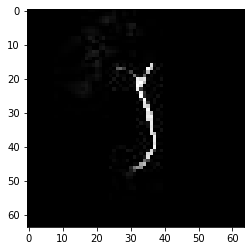

confidence for 4677 is 0.95883995


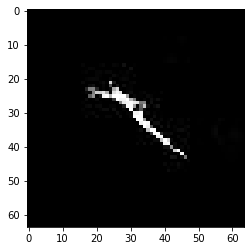

confidence for 4713 is 0.97500044


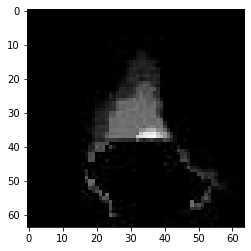

confidence for 4746 is 0.996426


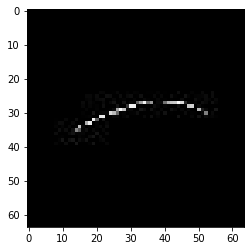

confidence for 4757 is 0.9972566


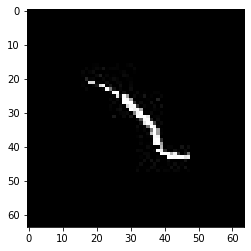

confidence for 4763 is 0.99993426


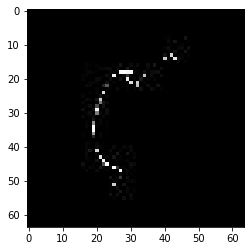

confidence for 4772 is 0.89027387


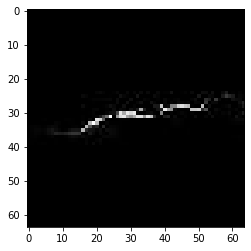

confidence for 4780 is 0.939475


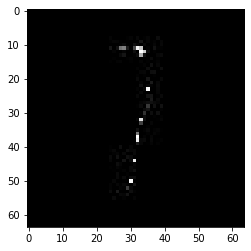

confidence for 4782 is 0.9745199


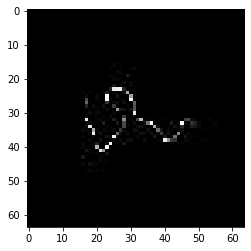

confidence for 4784 is 0.9774741


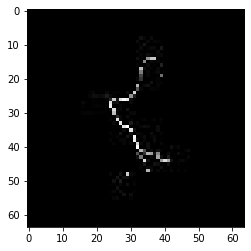

confidence for 4791 is 0.9999249


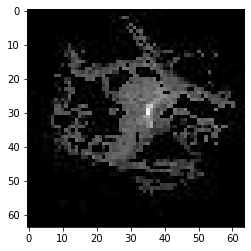

confidence for 4811 is 0.92411786


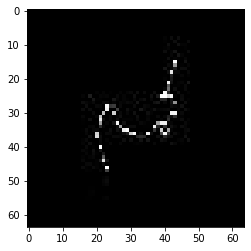

confidence for 4821 is 0.9213042


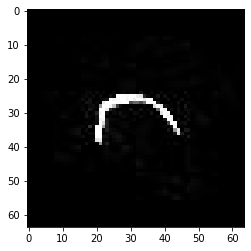

confidence for 4823 is 0.9991185


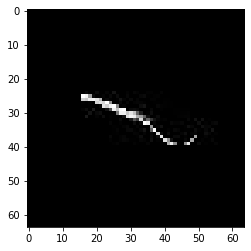

confidence for 4826 is 0.9935603


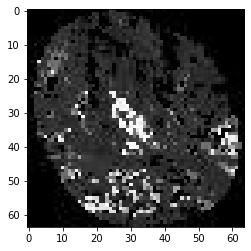

confidence for 4832 is 0.99354273


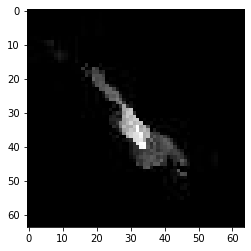

confidence for 4839 is 0.9998941


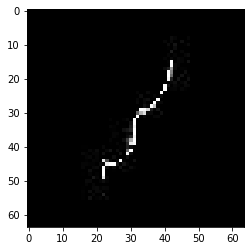

confidence for 4856 is 0.9816805


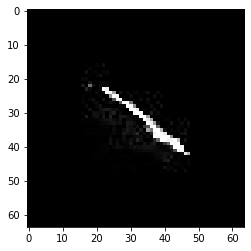

confidence for 4858 is 0.91767776


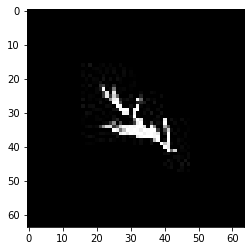

confidence for 4860 is 0.9836398


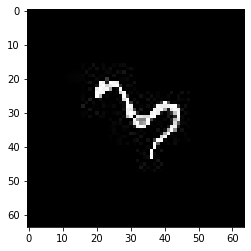

confidence for 4863 is 0.87385404


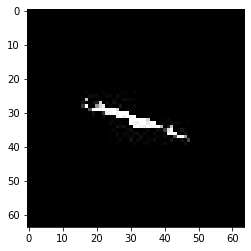

confidence for 4865 is 0.99474174


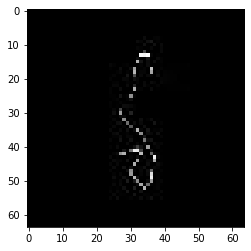

confidence for 4880 is 0.8686316


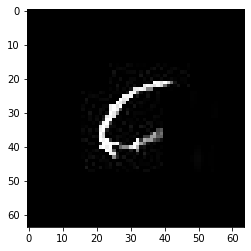

confidence for 4906 is 0.8494971


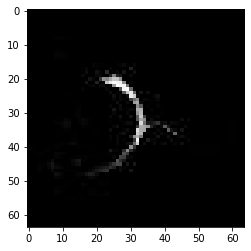

confidence for 4923 is 0.97775704


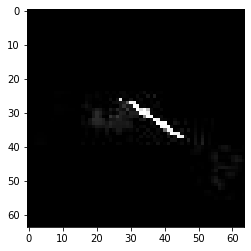

confidence for 4933 is 0.9988968


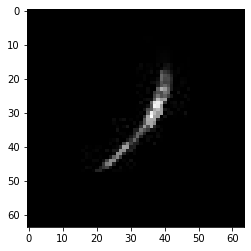

confidence for 4972 is 0.95115405


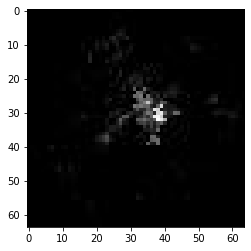

confidence for 5018 is 0.9997971


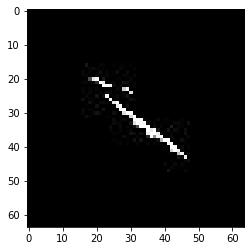

confidence for 5026 is 0.97781795


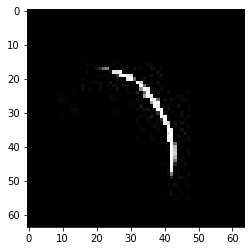

confidence for 5051 is 0.90485734


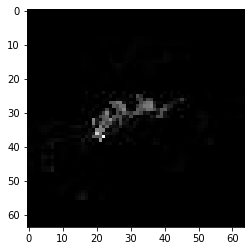

confidence for 5082 is 0.9852215


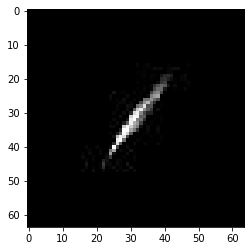

confidence for 5121 is 0.98795843


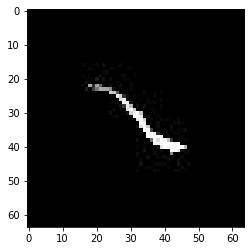

confidence for 5124 is 0.9859504


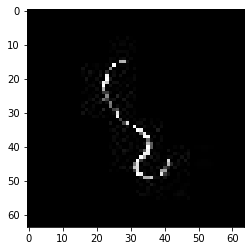

confidence for 5127 is 0.999715


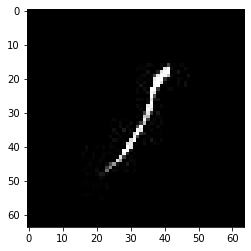

confidence for 5147 is 0.98388404


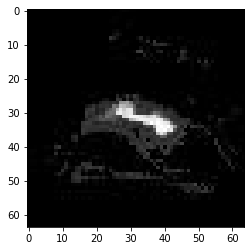

confidence for 5178 is 0.96277845


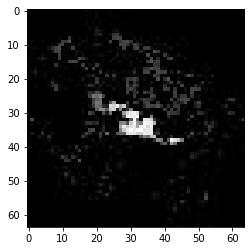

confidence for 5241 is 0.8867949


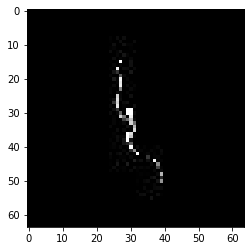

confidence for 5262 is 0.9995441


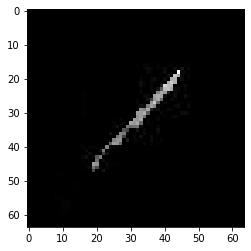

confidence for 5269 is 0.97816247


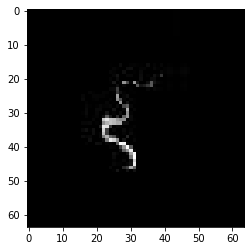

confidence for 5287 is 0.9161262


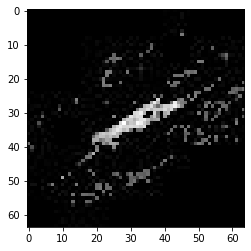

confidence for 5297 is 0.85654175


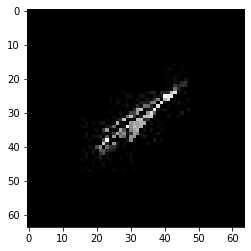

confidence for 5346 is 0.99972326


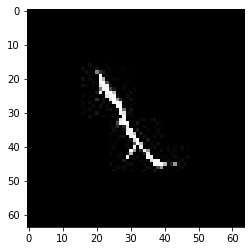

confidence for 5365 is 0.9983305


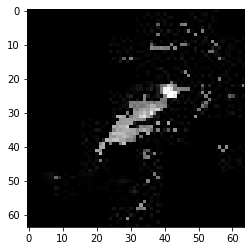

confidence for 5383 is 0.854359


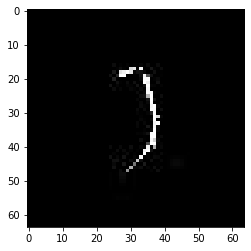

confidence for 5413 is 0.89888227


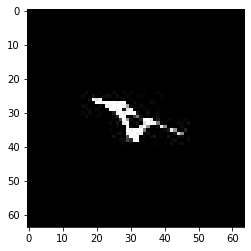

confidence for 5446 is 0.97284925


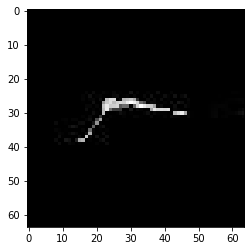

confidence for 5455 is 0.89438784


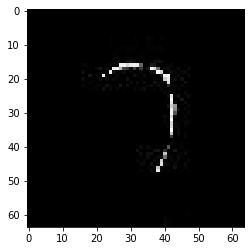

confidence for 5456 is 0.9976235


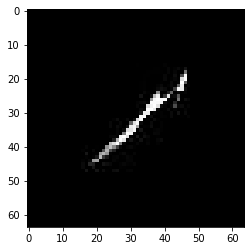

confidence for 5460 is 0.95589894


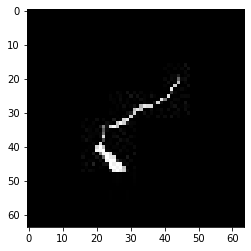

confidence for 5462 is 0.916989


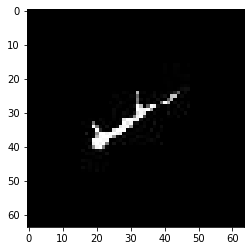

confidence for 5475 is 0.98533857


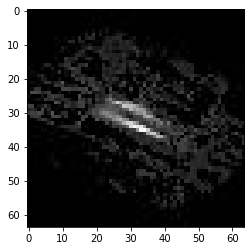

confidence for 5515 is 0.9611149


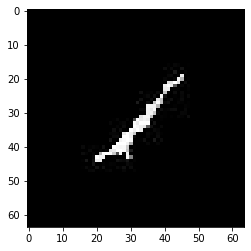

confidence for 5517 is 0.9954342


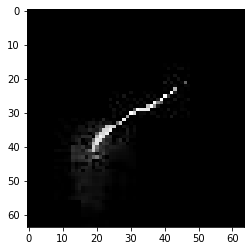

confidence for 5542 is 0.8488268


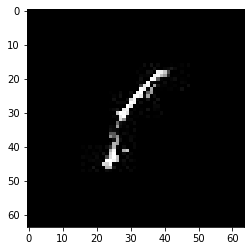

confidence for 5560 is 0.8029472


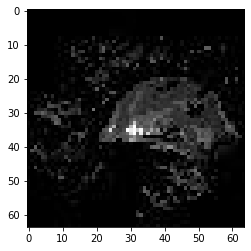

confidence for 5591 is 0.99566513


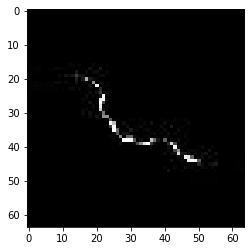

confidence for 5631 is 0.9775282


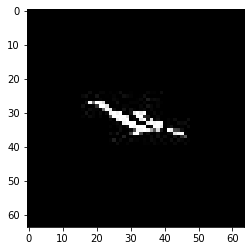

confidence for 5634 is 0.80119085


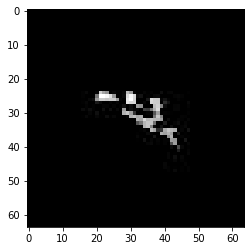

confidence for 5652 is 0.80825317


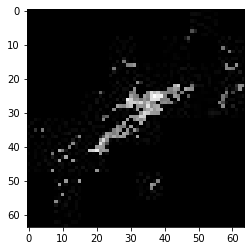

confidence for 5654 is 0.9999964


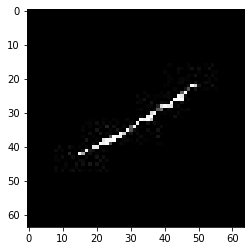

confidence for 5679 is 0.99973494


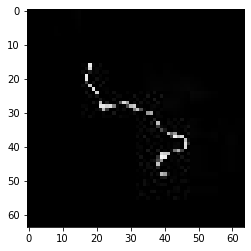

confidence for 5689 is 0.9708987


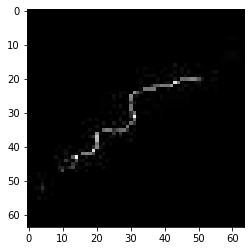

confidence for 5696 is 0.9734868


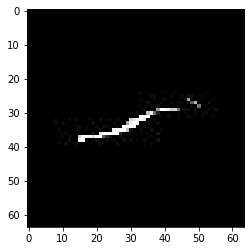

confidence for 5712 is 0.9977529


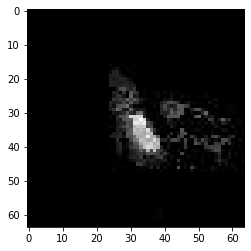

confidence for 5729 is 0.9999962


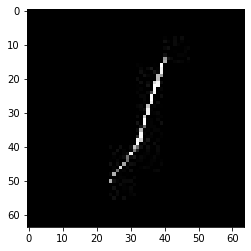

confidence for 5745 is 0.9999907


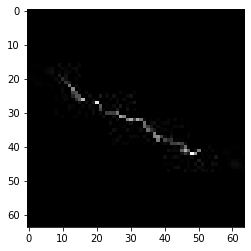

confidence for 5751 is 0.9892742


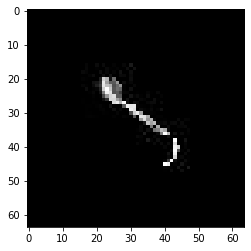

confidence for 5753 is 0.88406515


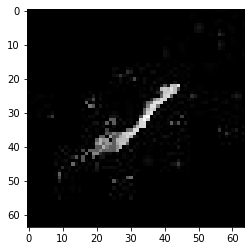

confidence for 5755 is 0.89999104


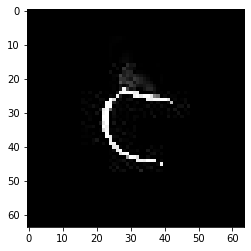

confidence for 5772 is 0.9533668


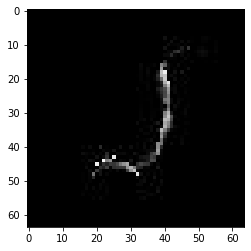

confidence for 5776 is 0.95488584


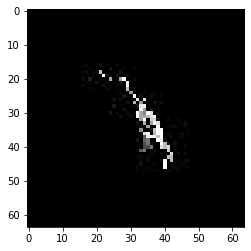

confidence for 5793 is 0.9926658


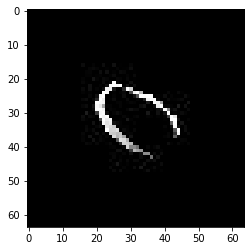

confidence for 5798 is 0.9001318


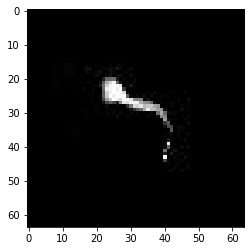

confidence for 5803 is 0.99599856


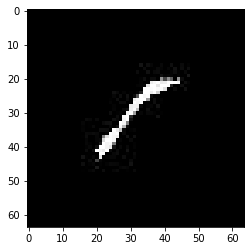

confidence for 5824 is 0.98803425


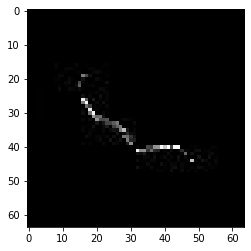

confidence for 5848 is 0.9603293


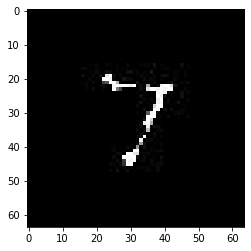

confidence for 5863 is 0.99098134


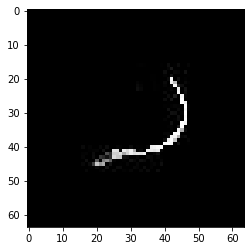

confidence for 5930 is 0.99490166


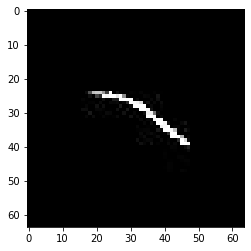

confidence for 5941 is 0.9745719


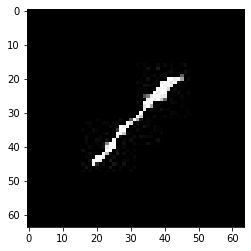

confidence for 5944 is 0.967319


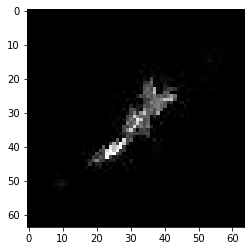

confidence for 5946 is 0.99999547


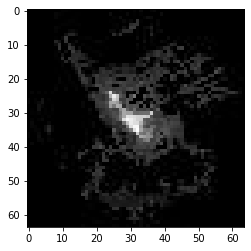

confidence for 5961 is 0.9998225


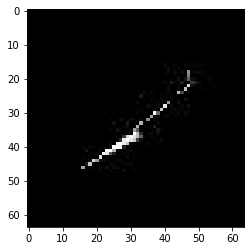

confidence for 5962 is 0.82559586


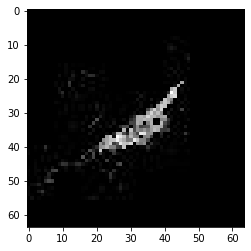

confidence for 5992 is 0.8788006


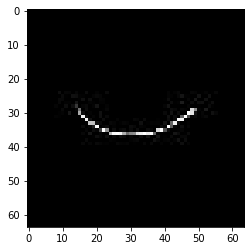

confidence for 5994 is 0.852001


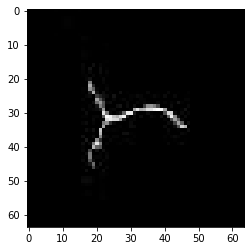

confidence for 6002 is 0.9922736


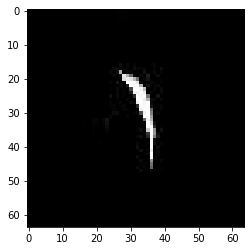

confidence for 6013 is 0.9701641


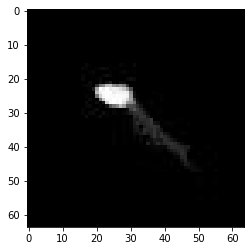

confidence for 6015 is 0.9999631


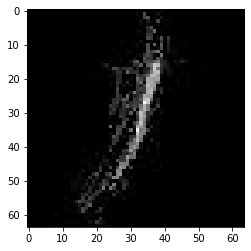

confidence for 6024 is 0.9576032


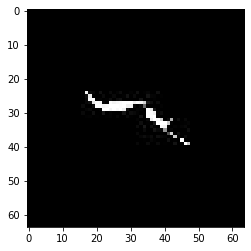

confidence for 6027 is 0.9983059


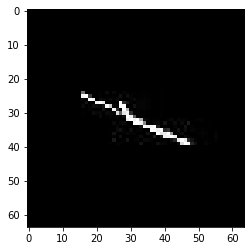

confidence for 6034 is 0.9991352


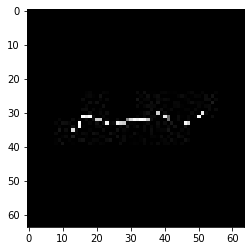

confidence for 6035 is 0.9345508


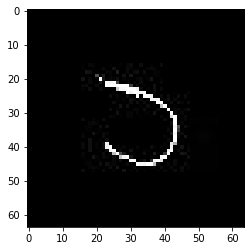

confidence for 6036 is 0.9987719


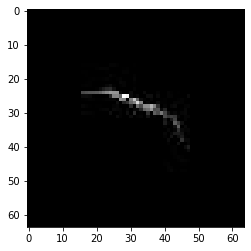

confidence for 6038 is 0.9945888


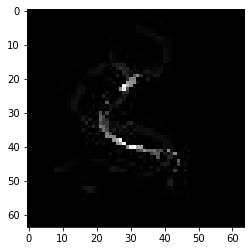

confidence for 6041 is 0.9747962


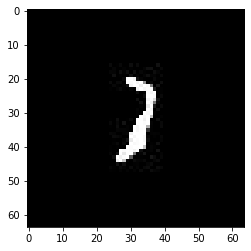

confidence for 6043 is 0.9999976


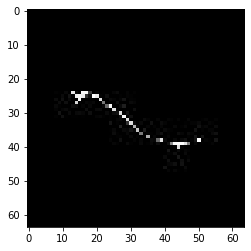

confidence for 6047 is 0.93944025


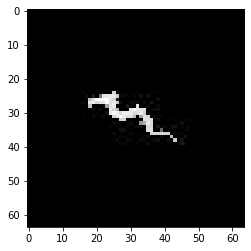

confidence for 6056 is 0.99225754


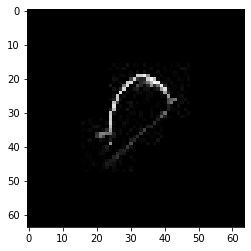

confidence for 6059 is 0.9969299


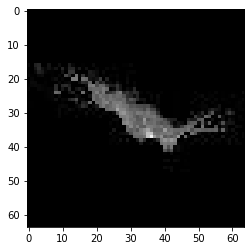

confidence for 6068 is 0.8686939


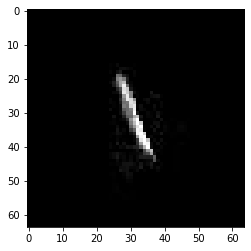

confidence for 6071 is 0.9775583


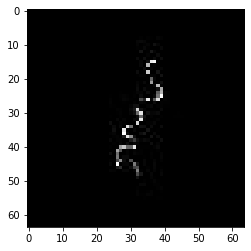

confidence for 6073 is 0.9678722


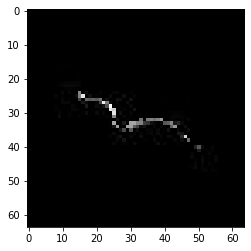

confidence for 6079 is 0.9963652


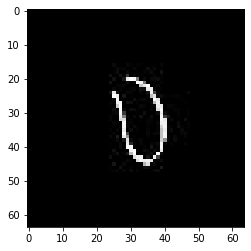

confidence for 6084 is 0.999846


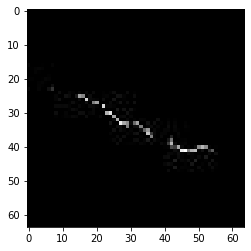

confidence for 6085 is 0.99478495


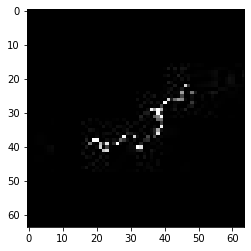

confidence for 6107 is 0.9556023


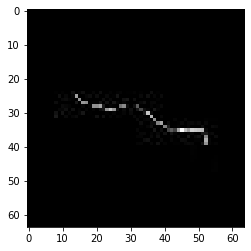

confidence for 6120 is 0.8220826


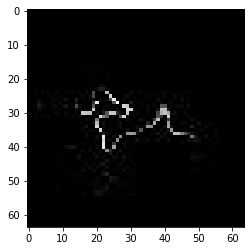

confidence for 6124 is 0.9991517


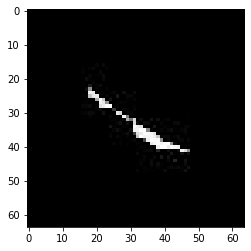

confidence for 6126 is 0.9184007


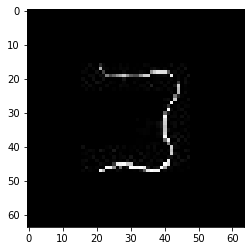

confidence for 6129 is 0.81031346


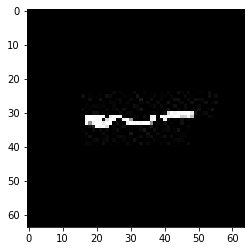

confidence for 6167 is 0.99999666


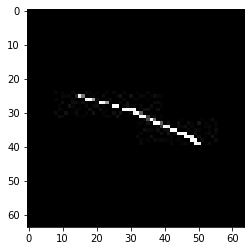

confidence for 6173 is 0.99730194


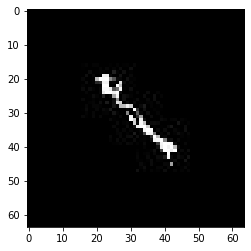

confidence for 6175 is 0.9998772


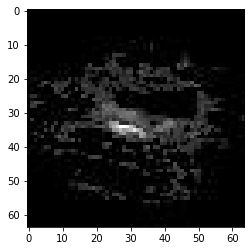

confidence for 6179 is 0.96445864


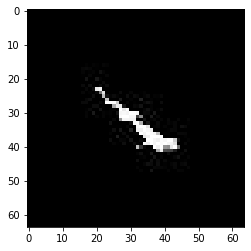

confidence for 6180 is 0.9989251


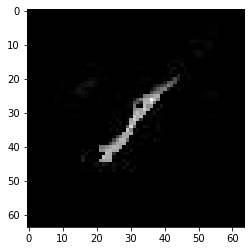

confidence for 6189 is 0.99662805


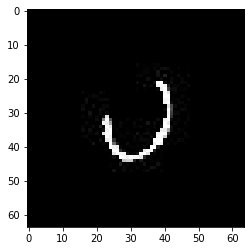

confidence for 6237 is 0.9593596


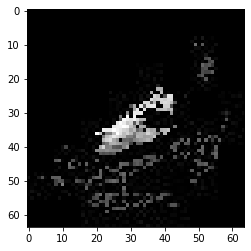

confidence for 6251 is 0.92230546


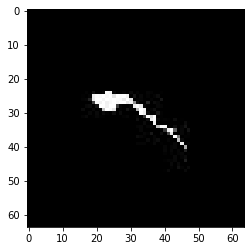

confidence for 6255 is 0.9898868


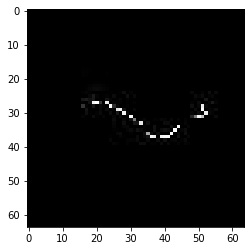

confidence for 6258 is 0.9923843


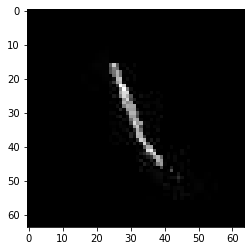

confidence for 6260 is 0.85586905


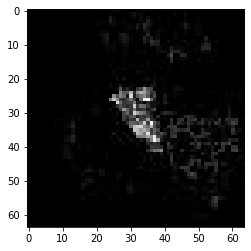

confidence for 6288 is 0.82204276


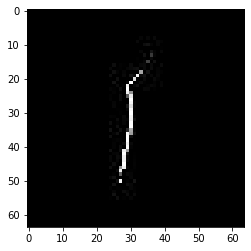

confidence for 6293 is 0.8276696


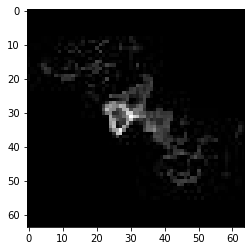

confidence for 6294 is 0.9996427


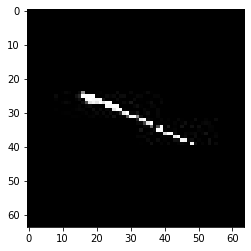

confidence for 6304 is 0.9618482


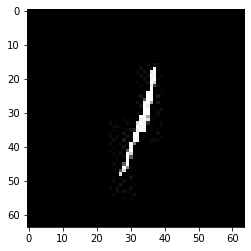

confidence for 6324 is 0.94008046


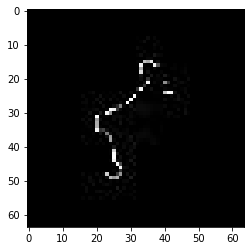

confidence for 6344 is 0.9569638


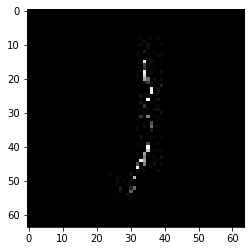

confidence for 6349 is 0.98514193


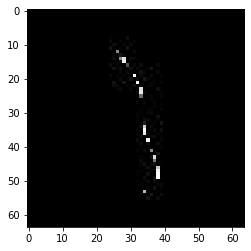

confidence for 6378 is 0.99708015


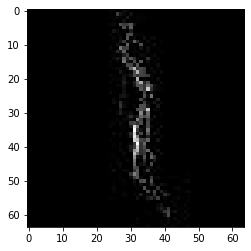

confidence for 6380 is 0.9508453


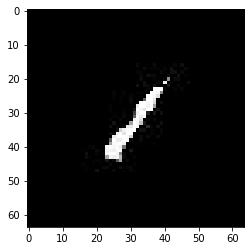

confidence for 6384 is 0.8387014


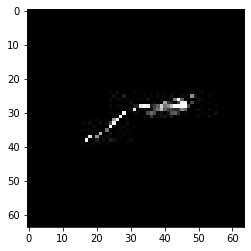

confidence for 6395 is 0.8698383


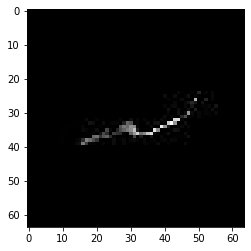

confidence for 6401 is 0.9480525


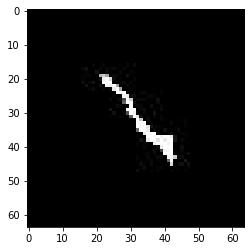

confidence for 6408 is 0.94143885


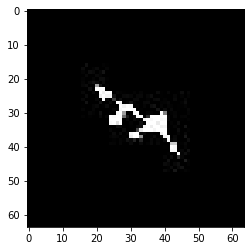

confidence for 6409 is 0.8316049


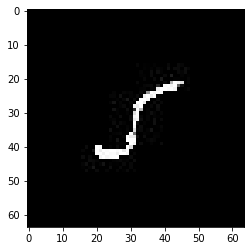

confidence for 6417 is 0.978045


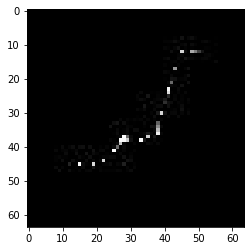

confidence for 6448 is 0.99900657


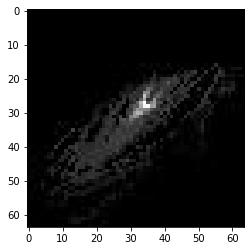

confidence for 6454 is 0.99965674


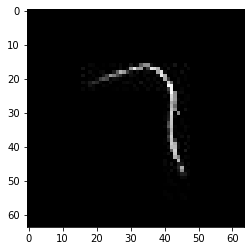

confidence for 6474 is 0.9855219


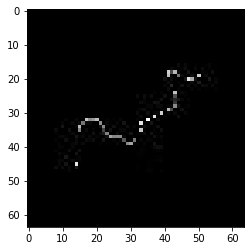

confidence for 6479 is 0.8309642


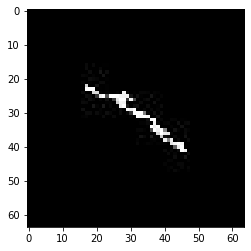

confidence for 6497 is 0.9997436


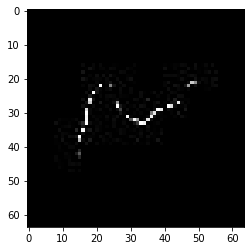

confidence for 6504 is 0.99524873


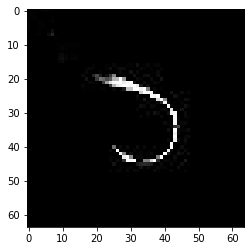

confidence for 6523 is 0.9999997


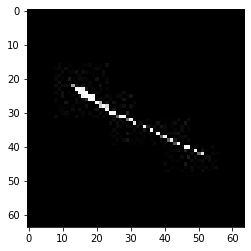

confidence for 6526 is 0.8691127


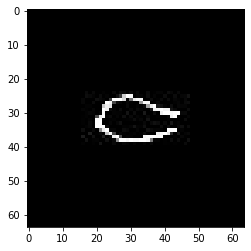

confidence for 6529 is 0.9921784


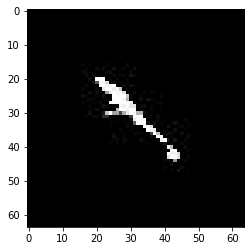

confidence for 6541 is 0.81947535


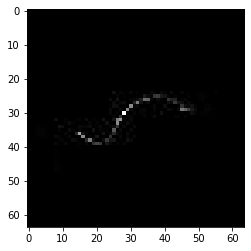

confidence for 6562 is 0.9993978


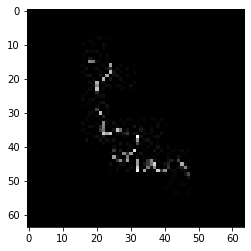

confidence for 6564 is 0.9942092


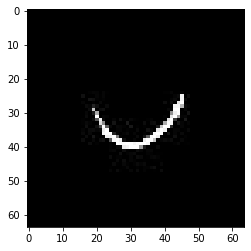

confidence for 6568 is 0.96049756


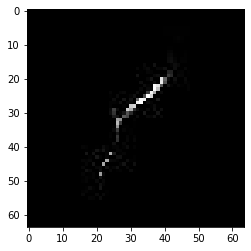

confidence for 6584 is 0.80855525


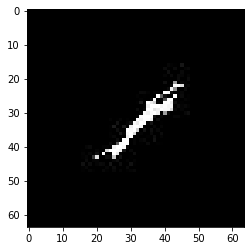

confidence for 6602 is 0.99947935


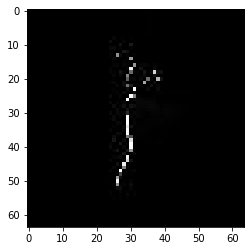

confidence for 6606 is 0.9921079


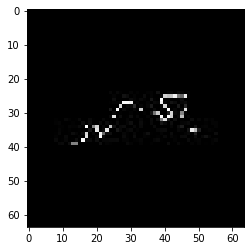

confidence for 6613 is 0.9800257


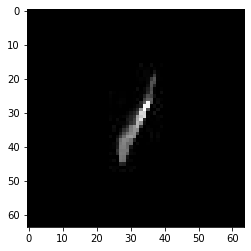

confidence for 6615 is 0.9725914


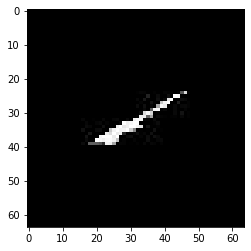

confidence for 6635 is 0.8102606


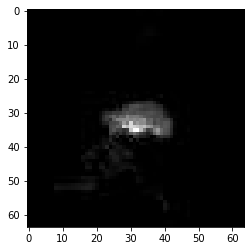

confidence for 6639 is 0.85139817


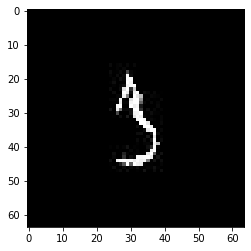

confidence for 6642 is 0.9994477


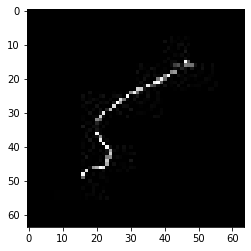

confidence for 6648 is 0.9143561


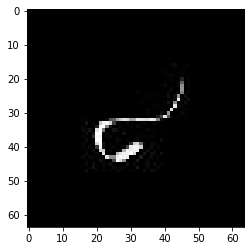

confidence for 6653 is 0.99935204


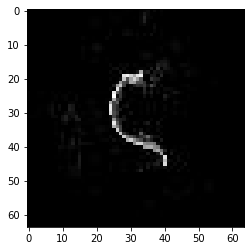

confidence for 6677 is 0.9998452


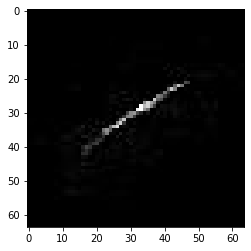

confidence for 6683 is 0.95937485


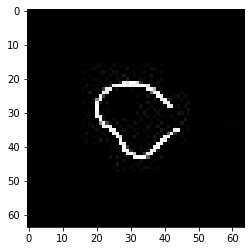

confidence for 6691 is 0.9968985


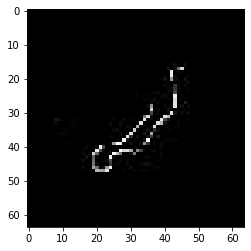

confidence for 6700 is 0.9941412


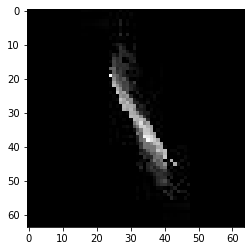

confidence for 6703 is 0.9980768


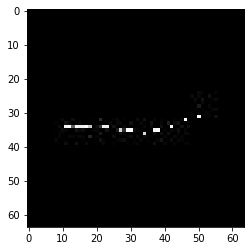

confidence for 6704 is 0.8021352


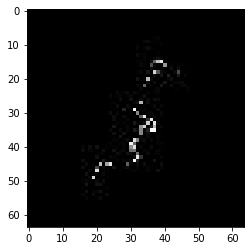

confidence for 6710 is 0.99992406


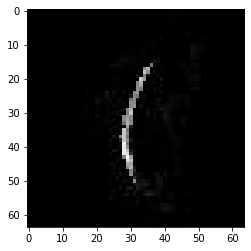

confidence for 6715 is 0.99997497


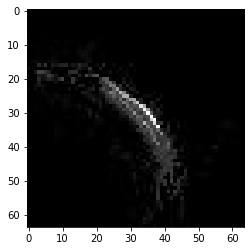

confidence for 6723 is 0.92073107


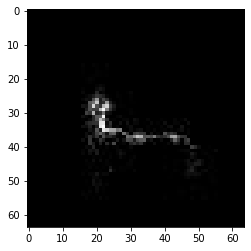

confidence for 6741 is 0.9189588


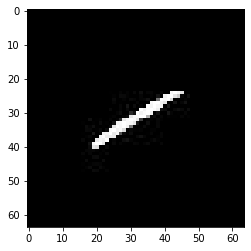

confidence for 6750 is 0.995733


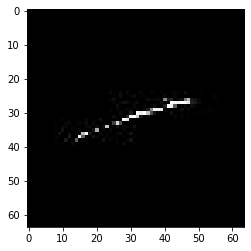

confidence for 6756 is 0.9999993


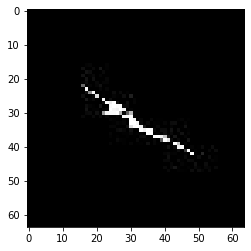

confidence for 6758 is 0.98001593


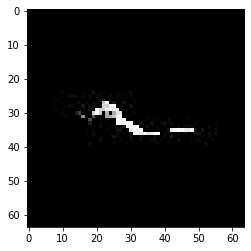

confidence for 6767 is 0.88804865


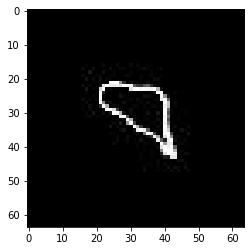

confidence for 6781 is 0.93603516


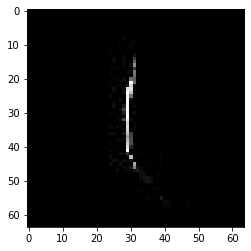

confidence for 6796 is 0.9999998


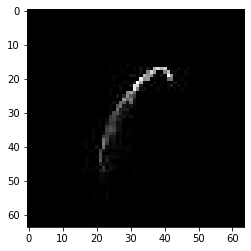

confidence for 6799 is 0.99998456


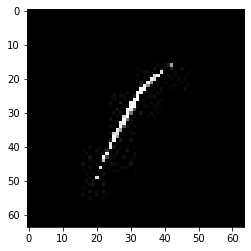

confidence for 6803 is 0.8293118


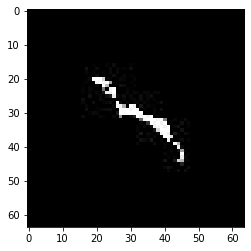

confidence for 6806 is 0.98793566


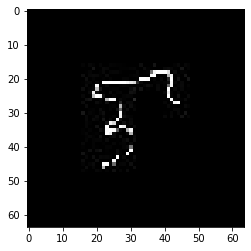

confidence for 6807 is 0.9688805


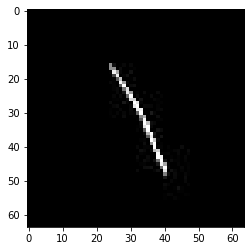

confidence for 6825 is 0.95017546


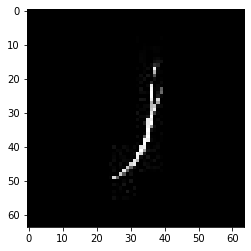

confidence for 6827 is 0.9999811


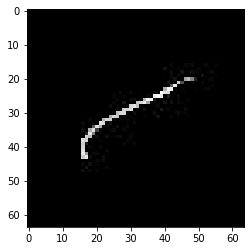

confidence for 6832 is 0.9999454


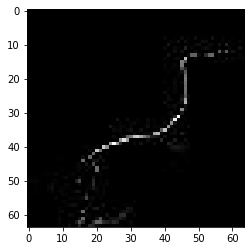

confidence for 6834 is 0.92589086


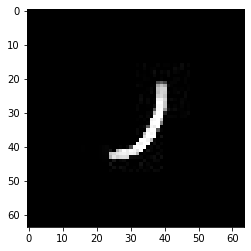

confidence for 6838 is 0.9874996


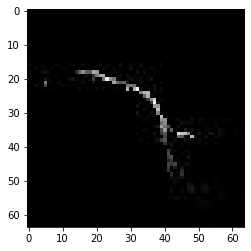

confidence for 6870 is 0.9999868


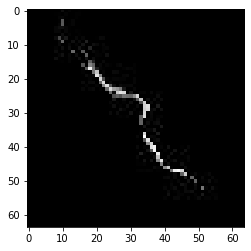

confidence for 6894 is 0.9998668


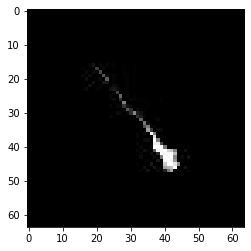

confidence for 6902 is 0.8625514


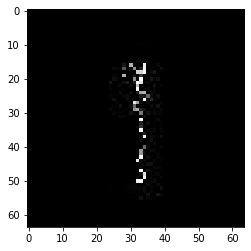

confidence for 6903 is 0.9969465


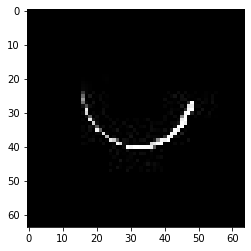

confidence for 6939 is 0.99929184


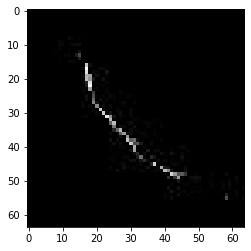

confidence for 6945 is 0.9952928


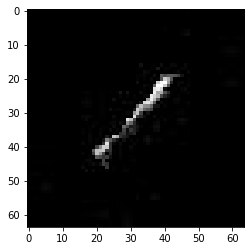

confidence for 6946 is 0.98762625


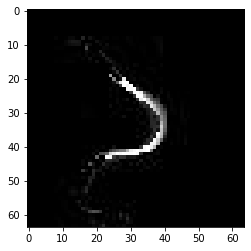

confidence for 6962 is 0.9963124


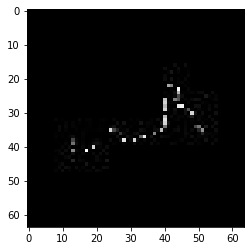

confidence for 6966 is 0.9271267


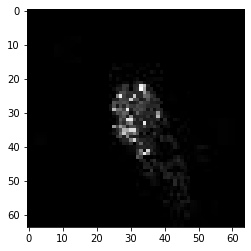

confidence for 7043 is 0.999945


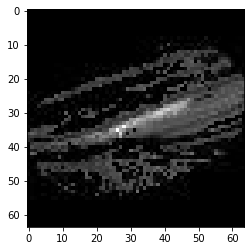

confidence for 7060 is 0.9996784


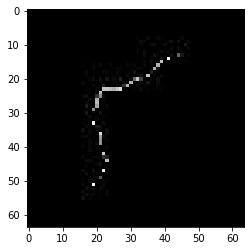

confidence for 7100 is 0.92116266


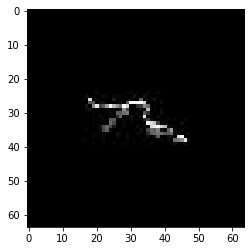

confidence for 7118 is 0.9968679


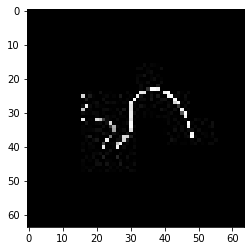

confidence for 7122 is 0.9853233


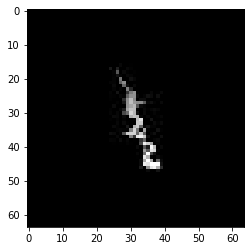

confidence for 7133 is 0.8044735


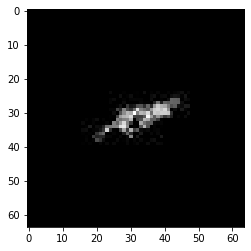

confidence for 7150 is 0.97882247


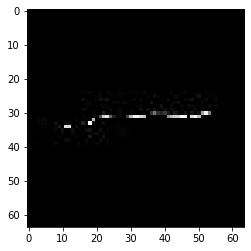

confidence for 7152 is 0.98556894


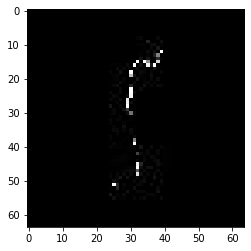

confidence for 7181 is 0.8159886


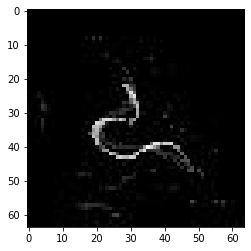

confidence for 7212 is 0.96338415


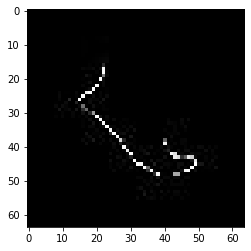

confidence for 7220 is 0.83814514


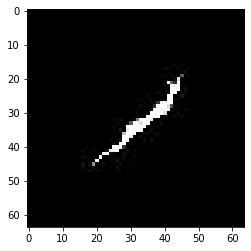

confidence for 7235 is 0.9927075


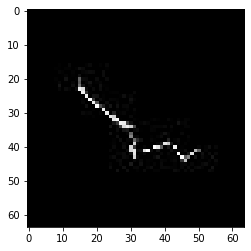

confidence for 7238 is 0.97888803


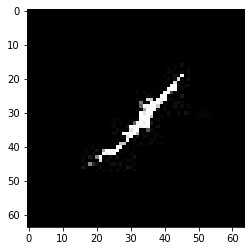

confidence for 7271 is 0.8776624


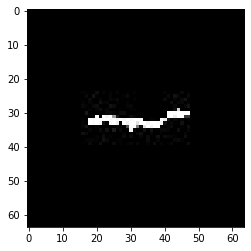

confidence for 7280 is 0.98828506


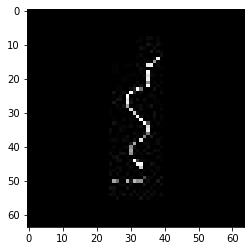

confidence for 7282 is 0.963779


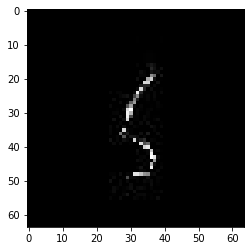

confidence for 7311 is 0.9875987


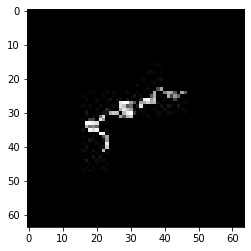

confidence for 7362 is 0.89801365


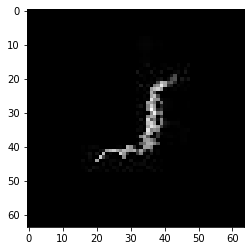

confidence for 7377 is 0.9718666


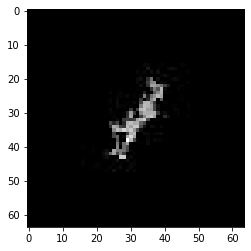

confidence for 7378 is 0.9905299


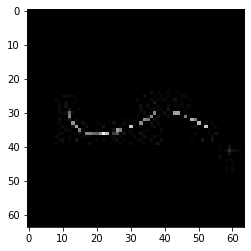

confidence for 7415 is 0.9999999


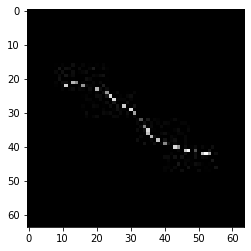

confidence for 7424 is 0.8954762


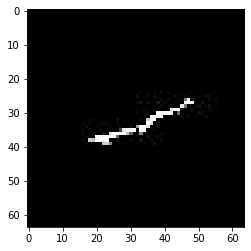

confidence for 7427 is 0.9914107


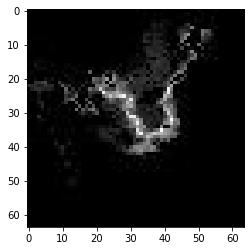

confidence for 7431 is 0.9998198


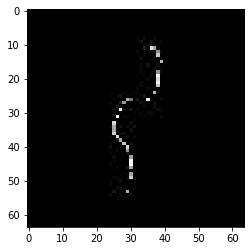

confidence for 7437 is 0.9969929


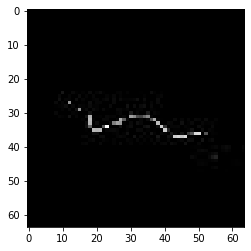

confidence for 7448 is 0.9958387


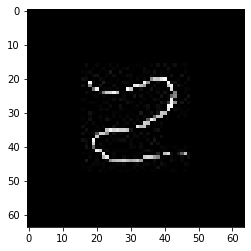

confidence for 7460 is 0.8723824


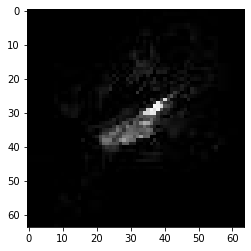

confidence for 7461 is 0.9991744


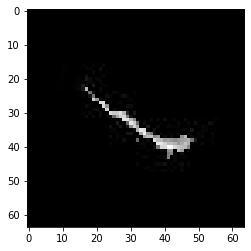

confidence for 7503 is 0.9776356


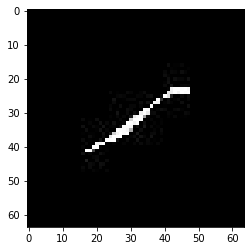

confidence for 7516 is 0.8650493


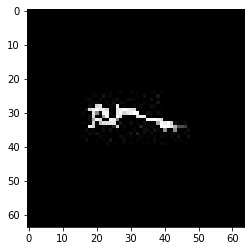

confidence for 7518 is 0.9801658


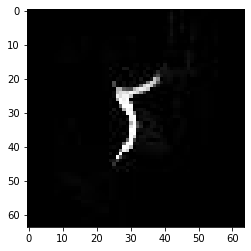

confidence for 7527 is 0.9929885


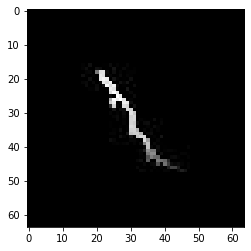

confidence for 7531 is 0.9999783


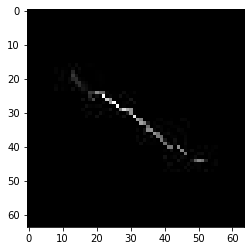

confidence for 7589 is 0.9979211


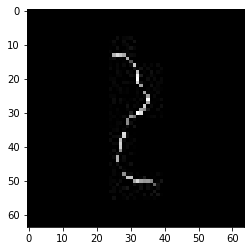

confidence for 7605 is 0.9996279


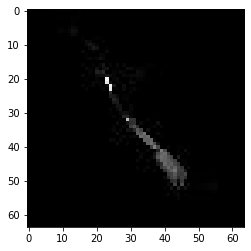

confidence for 7610 is 0.9998014


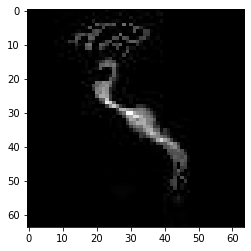

confidence for 7615 is 0.99447966


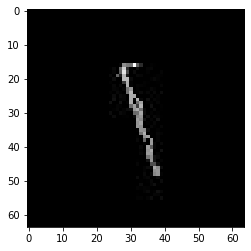

confidence for 7640 is 0.9995328


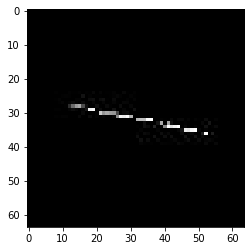

confidence for 7646 is 0.99690914


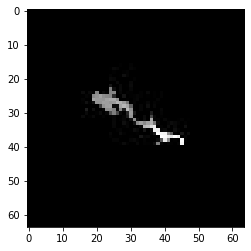

confidence for 7648 is 0.9320083


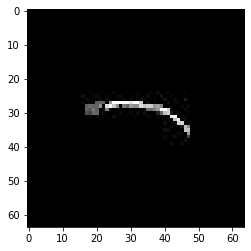

confidence for 7724 is 0.99921644


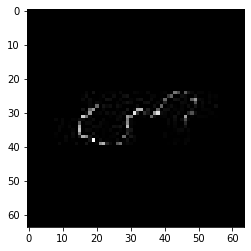

confidence for 7744 is 0.992808


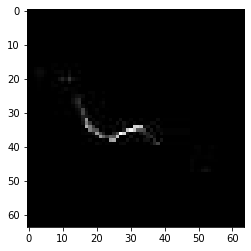

confidence for 7752 is 0.9968173


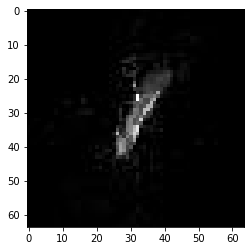

confidence for 7778 is 0.9917602


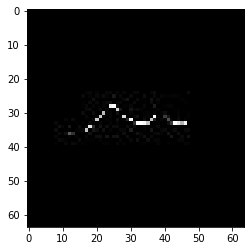

confidence for 7787 is 0.8401433


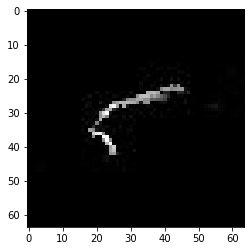

confidence for 7789 is 0.96893895


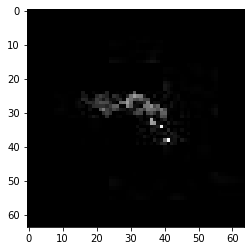

confidence for 7807 is 0.99999714


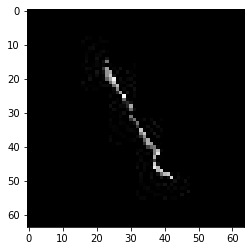

confidence for 7821 is 0.9089698


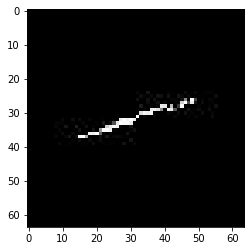

confidence for 7833 is 0.9896844


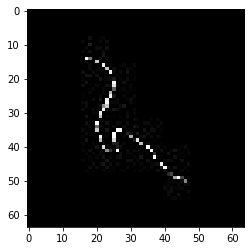

confidence for 7865 is 0.99995124


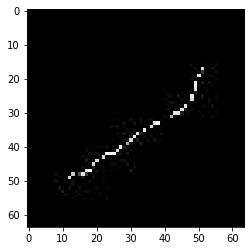

confidence for 7872 is 0.9070213


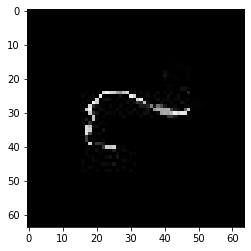

confidence for 7933 is 0.97414654


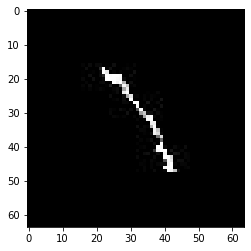

confidence for 7949 is 0.9441212


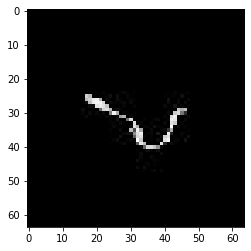

confidence for 7955 is 0.99200594


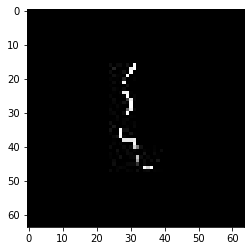

confidence for 7970 is 0.9993827


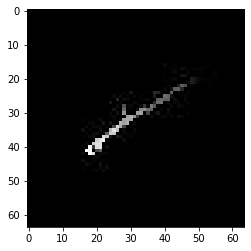

confidence for 7972 is 0.94256455


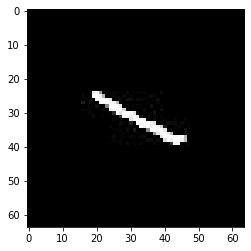

confidence for 7976 is 0.8369763


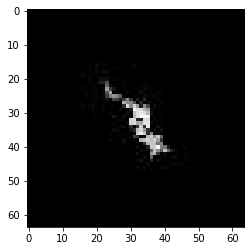

confidence for 7982 is 0.8462862


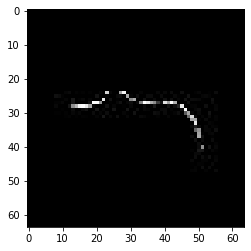

confidence for 7997 is 0.99694335


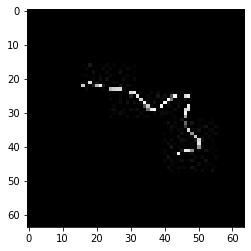

confidence for 8003 is 0.9935198


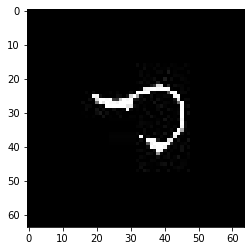

confidence for 8015 is 0.99895227


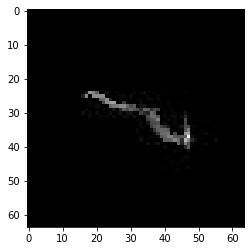

confidence for 8028 is 0.9982858


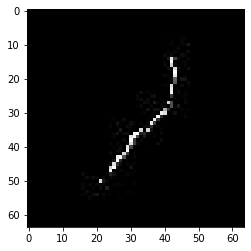

confidence for 8033 is 0.8938055


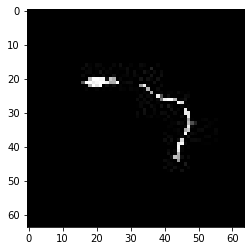

confidence for 8037 is 0.9166735


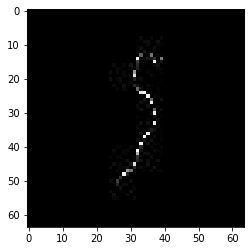

confidence for 8044 is 0.9999952


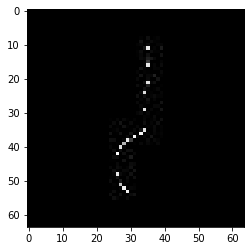

confidence for 8065 is 0.9999994


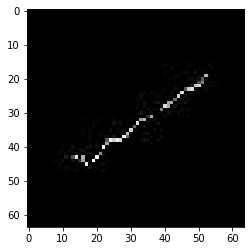

confidence for 8070 is 0.8943854


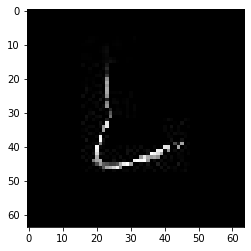

confidence for 8071 is 0.9999999


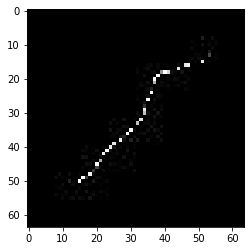

confidence for 8074 is 0.9968578


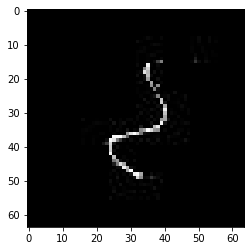

confidence for 8077 is 0.99075675


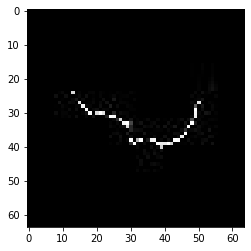

confidence for 8088 is 0.9999982


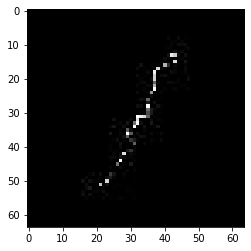

confidence for 8099 is 0.8550258


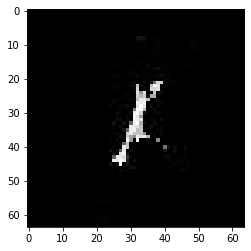

confidence for 8105 is 0.96042573


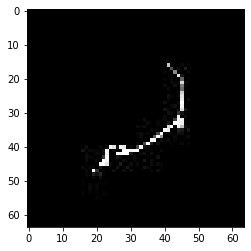

confidence for 8128 is 0.935223


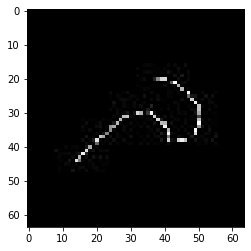

confidence for 8134 is 0.9276717


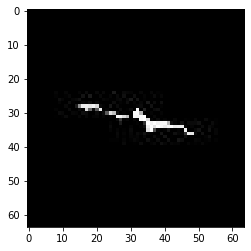

confidence for 8140 is 0.98995155


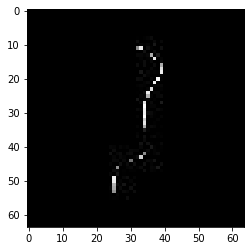

confidence for 8141 is 0.99376225


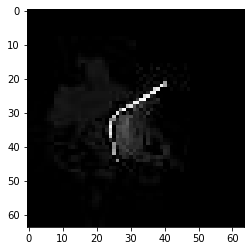

confidence for 8154 is 0.9860714


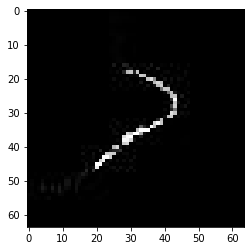

confidence for 8162 is 0.99701303


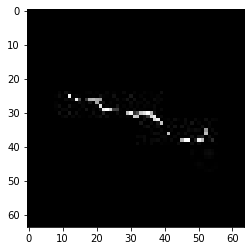

confidence for 8170 is 0.93986523


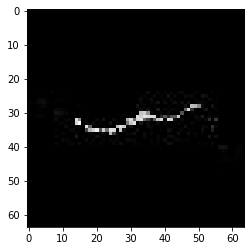

confidence for 8181 is 0.9998918


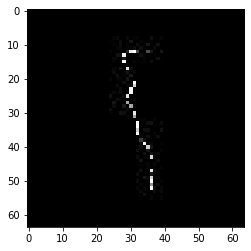

confidence for 8185 is 0.9978171


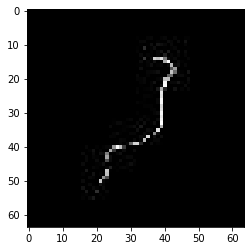

confidence for 8194 is 0.98508924


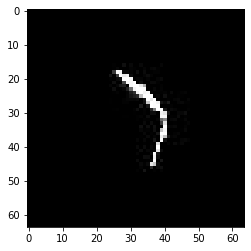

confidence for 8216 is 0.99563575


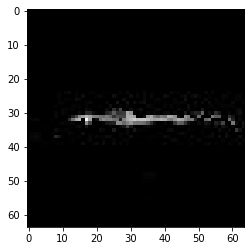

confidence for 8223 is 0.962271


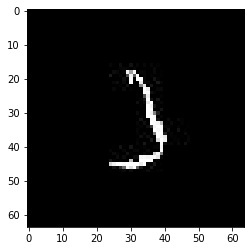

confidence for 8224 is 0.95509505


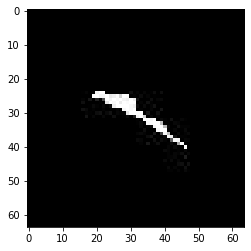

confidence for 8228 is 0.908447


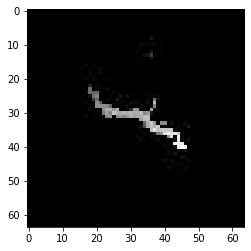

confidence for 8235 is 0.99999905


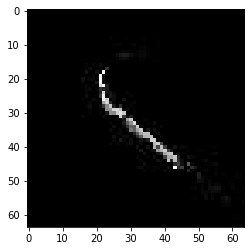

confidence for 8250 is 0.9485184


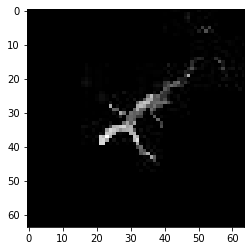

confidence for 8251 is 0.86623555


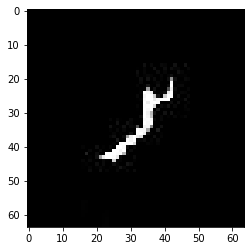

confidence for 8265 is 0.9134034


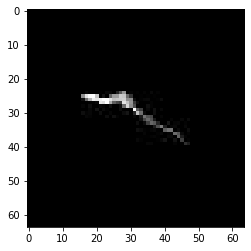

confidence for 8266 is 0.9176764


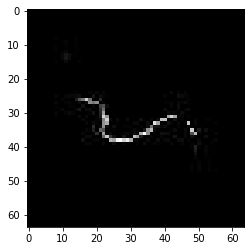

confidence for 8295 is 0.9150434


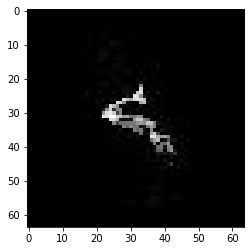

confidence for 8297 is 0.99998325


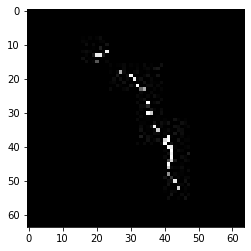

confidence for 8312 is 0.99106103


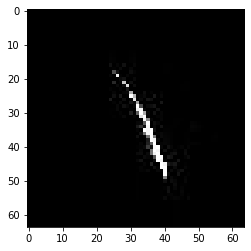

confidence for 8317 is 0.9783283


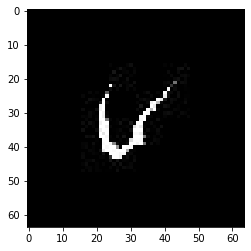

confidence for 8333 is 0.942124


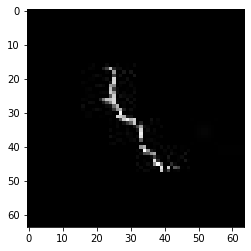

confidence for 8334 is 0.9305481


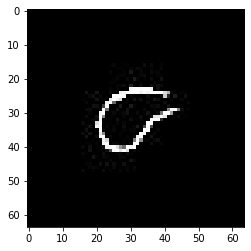

confidence for 8336 is 0.99998325


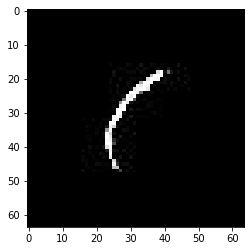

confidence for 8349 is 0.97173446


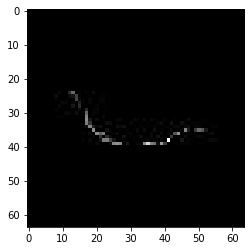

confidence for 8379 is 0.9946477


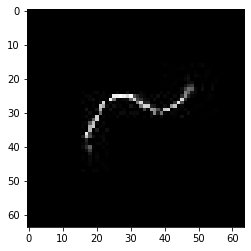

confidence for 8399 is 0.8610009


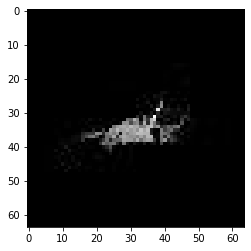

confidence for 8421 is 0.9917642


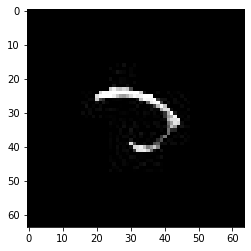

confidence for 8429 is 0.9943267


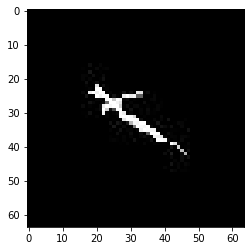

confidence for 8438 is 0.97512734


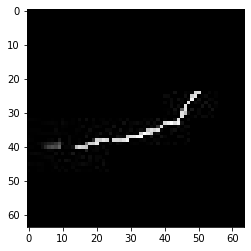

confidence for 8444 is 0.99773055


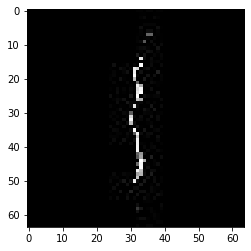

confidence for 8447 is 0.9178962


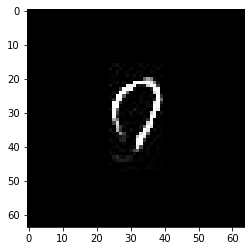

confidence for 8457 is 0.99653935


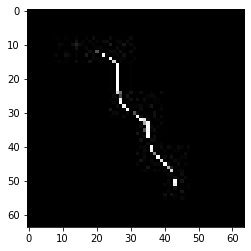

confidence for 8459 is 0.88072544


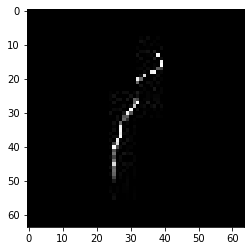

confidence for 8488 is 0.90951645


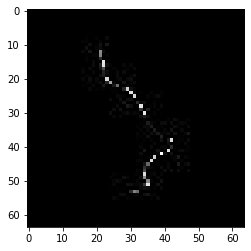

confidence for 8509 is 0.9710711


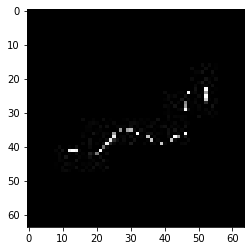

confidence for 8522 is 0.93617743


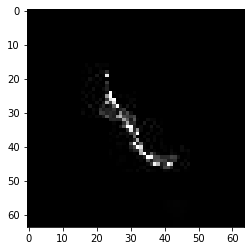

confidence for 8535 is 0.99237376


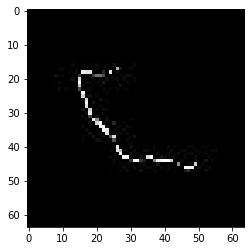

confidence for 8537 is 0.99999887


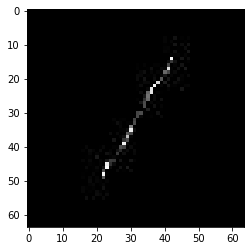

confidence for 8546 is 0.9862309


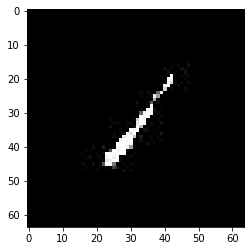

confidence for 8574 is 0.9996738


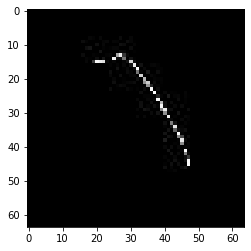

confidence for 8577 is 0.9999975


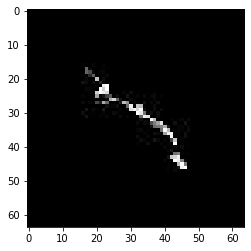

confidence for 8580 is 0.9990963


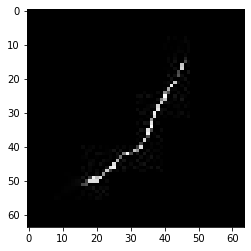

confidence for 8581 is 0.99929875


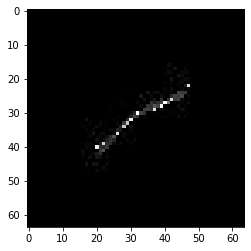

confidence for 8584 is 0.96980906


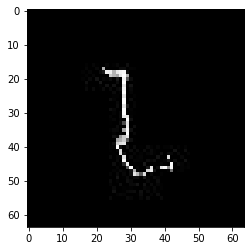

confidence for 8585 is 0.9996469


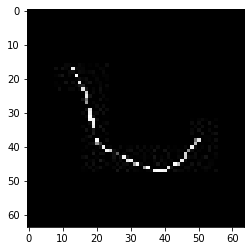

confidence for 8601 is 0.9999116


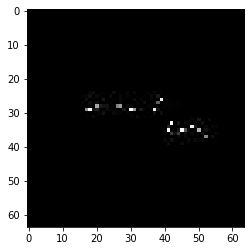

confidence for 8602 is 0.9998004


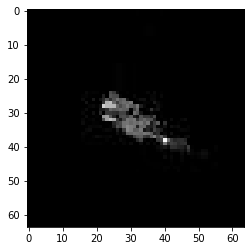

confidence for 8608 is 0.99796283


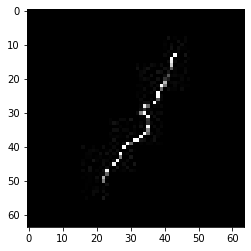

confidence for 8610 is 0.9984902


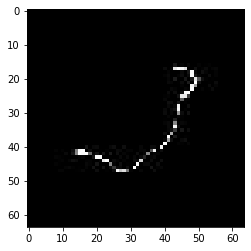

confidence for 8613 is 0.99722874


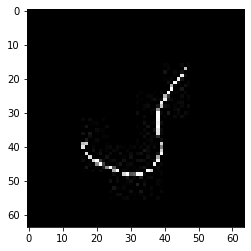

confidence for 8660 is 0.9992672


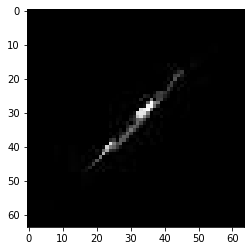

confidence for 8674 is 0.9837538


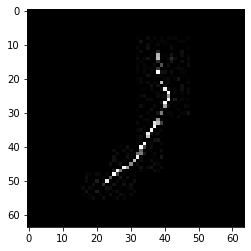

confidence for 8682 is 0.9999994


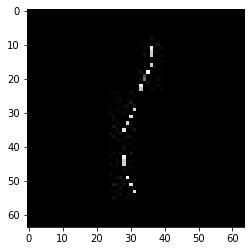

confidence for 8684 is 0.89623666


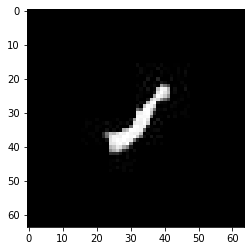

confidence for 8712 is 0.99902934


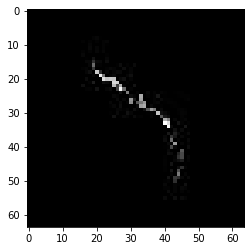

confidence for 8722 is 0.9999795


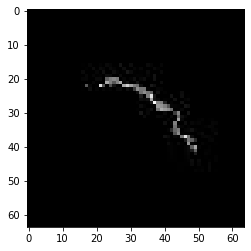

confidence for 8723 is 0.9906185


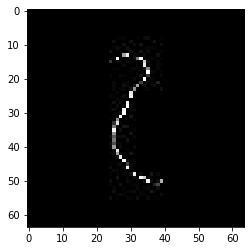

confidence for 8732 is 0.9651501


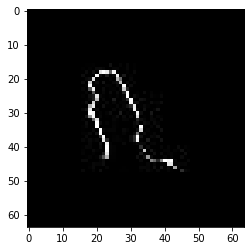

confidence for 8733 is 0.99979436


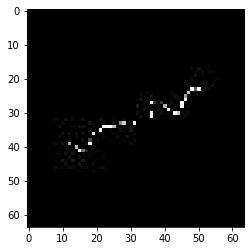

confidence for 8735 is 0.99706596


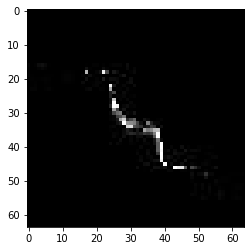

confidence for 8750 is 0.8205342


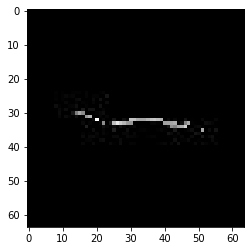

confidence for 8764 is 0.958579


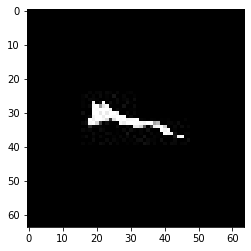

confidence for 8784 is 0.9999775


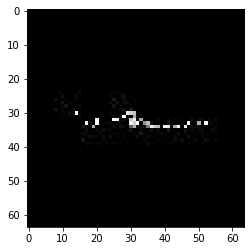

confidence for 8785 is 0.87222695


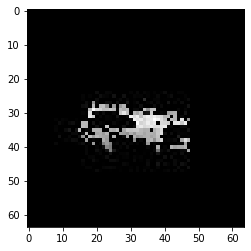

confidence for 8789 is 0.9995066


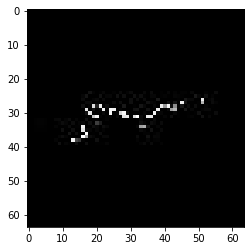

confidence for 8796 is 0.8674627


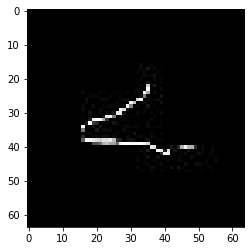

confidence for 8808 is 0.9818645


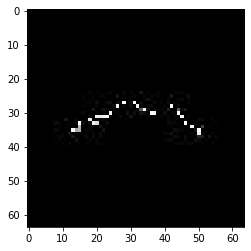

confidence for 8818 is 0.99976265


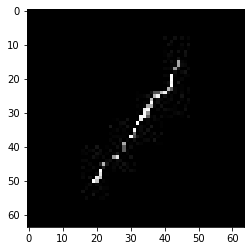

confidence for 8826 is 0.9815034


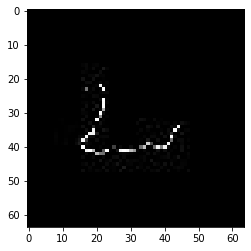

confidence for 8834 is 0.9925662


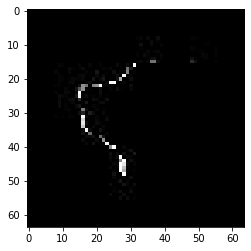

confidence for 8841 is 0.9999953


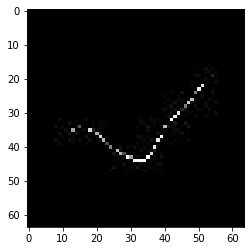

confidence for 8850 is 0.99014294


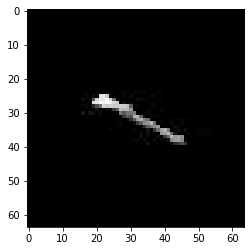

confidence for 8856 is 0.87568265


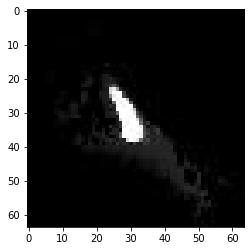

confidence for 8863 is 0.9995628


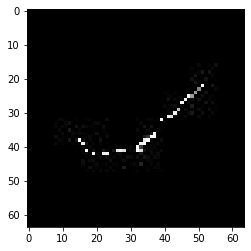

confidence for 8864 is 0.8214564


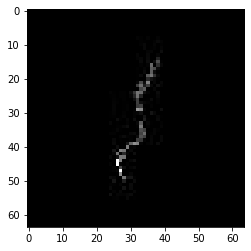

confidence for 8877 is 0.99996847


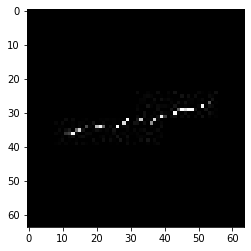

confidence for 8900 is 0.99998873


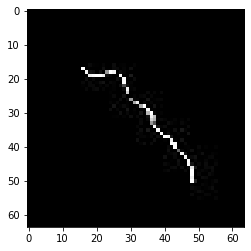

confidence for 8933 is 0.818365


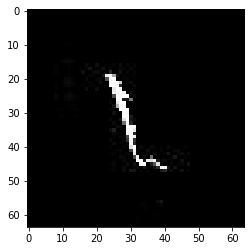

confidence for 8935 is 0.99572086


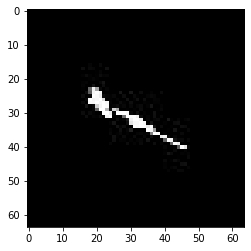

confidence for 8937 is 0.992953


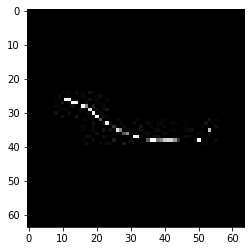

confidence for 8939 is 0.97826326


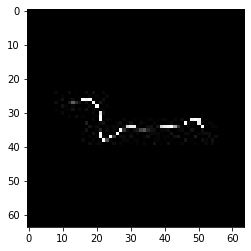

confidence for 8946 is 0.89575696


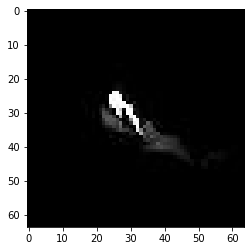

confidence for 8962 is 0.98929745


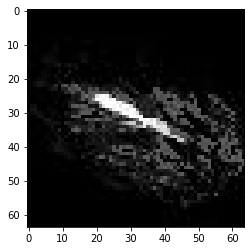

confidence for 8970 is 0.89159745


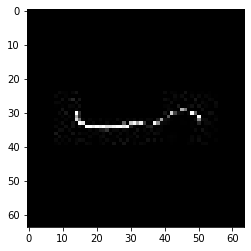

confidence for 8995 is 0.838747


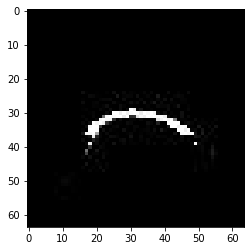

confidence for 8996 is 0.944631


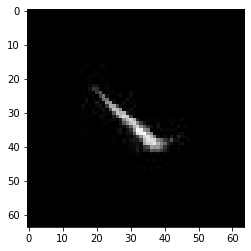

confidence for 9002 is 0.99087894


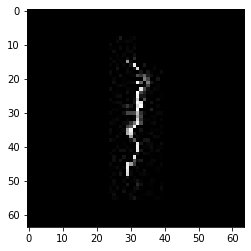

confidence for 9003 is 0.9999975


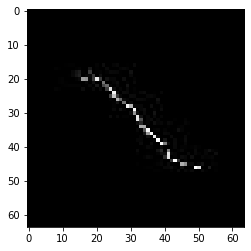

confidence for 9008 is 0.9994956


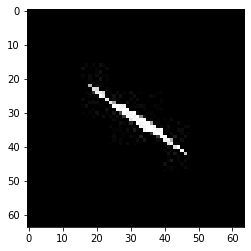

confidence for 9013 is 0.9797344


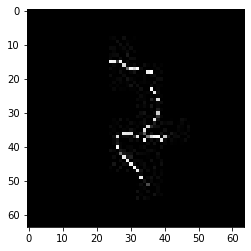

confidence for 9018 is 0.99999964


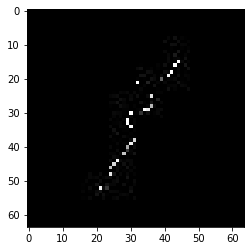

confidence for 9021 is 0.96037894


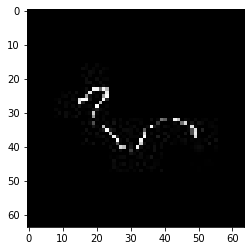

confidence for 9030 is 0.90787786


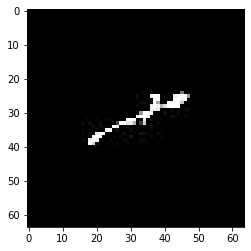

confidence for 9038 is 0.87425226


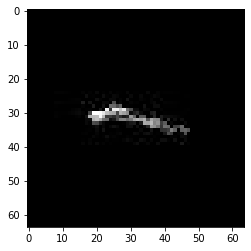

confidence for 9043 is 0.90573204


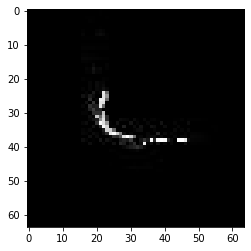

confidence for 9045 is 0.998746


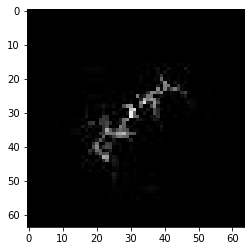

confidence for 9050 is 0.99976444


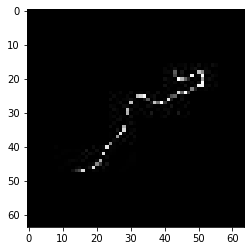

confidence for 9060 is 0.981673


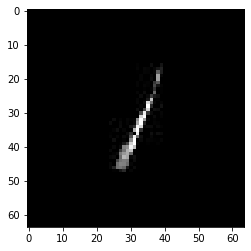

confidence for 9062 is 0.9447628


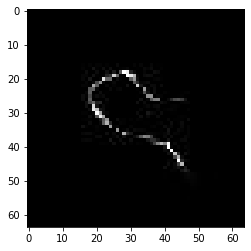

confidence for 9073 is 0.9392697


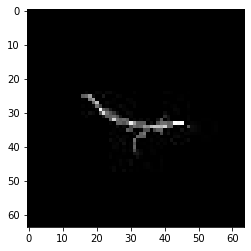

confidence for 9075 is 0.9964156


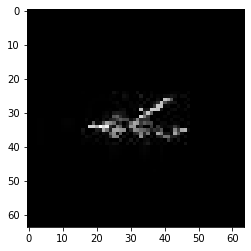

confidence for 9081 is 0.9999794


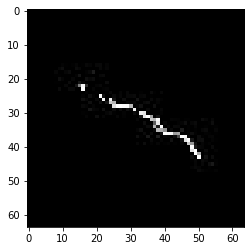

confidence for 9087 is 0.99999976


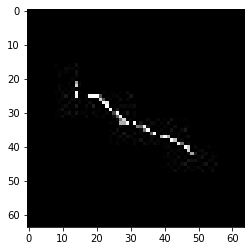

confidence for 9090 is 0.97473603


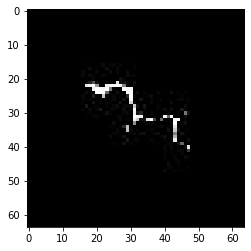

confidence for 9106 is 0.9874198


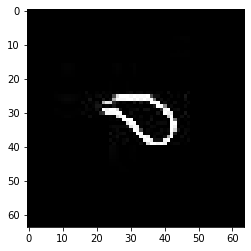

confidence for 9114 is 0.9999974


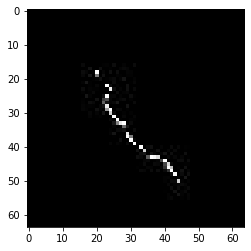

confidence for 9139 is 0.9981578


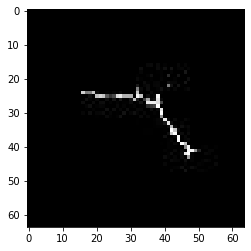

confidence for 9142 is 0.9217524


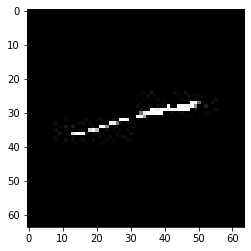

confidence for 9162 is 0.9999661


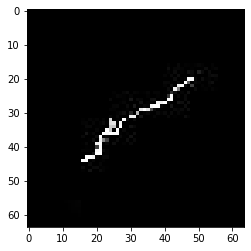

confidence for 9165 is 0.978148


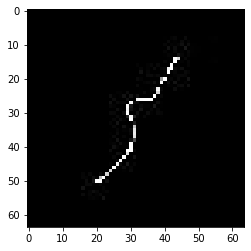

confidence for 9185 is 0.98497623


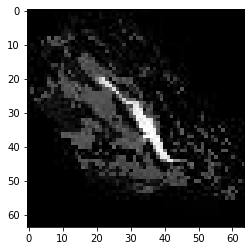

confidence for 9189 is 0.9788458


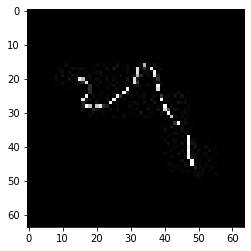

confidence for 9208 is 0.9982738


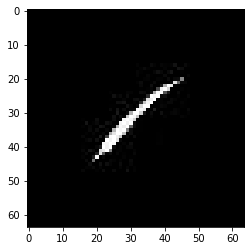

confidence for 9217 is 0.99654084


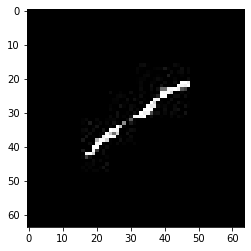

confidence for 9226 is 0.98728645


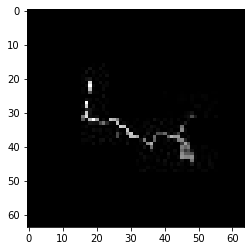

confidence for 9232 is 0.99989665


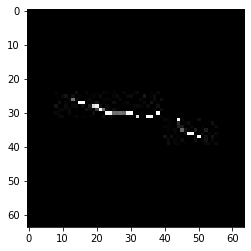

confidence for 9233 is 0.9969978


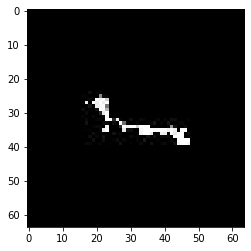

confidence for 9242 is 0.9303965


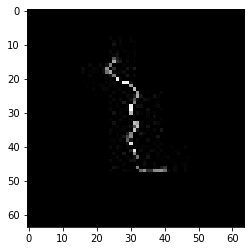

confidence for 9249 is 0.92484915


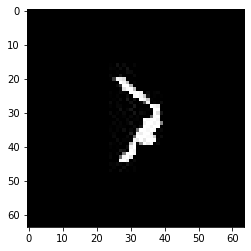

confidence for 9255 is 0.89191407


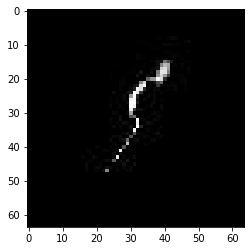

confidence for 9266 is 0.9992536


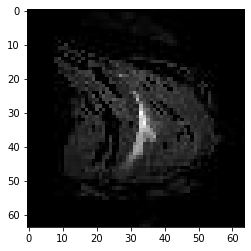

confidence for 9280 is 0.91931295


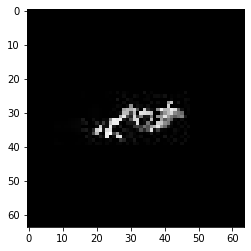

confidence for 9294 is 0.8625595


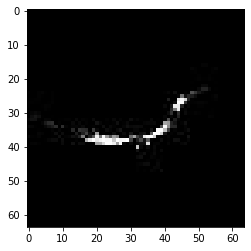

confidence for 9313 is 0.98104817


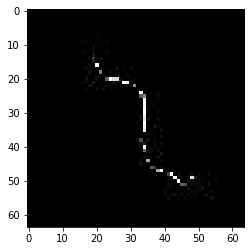

confidence for 9318 is 0.8965538


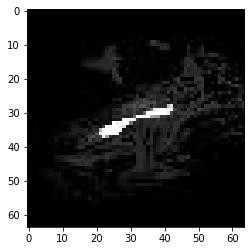

confidence for 9324 is 0.9889664


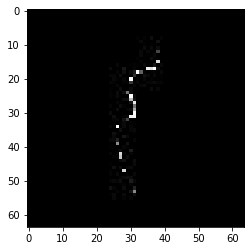

confidence for 9329 is 0.89283144


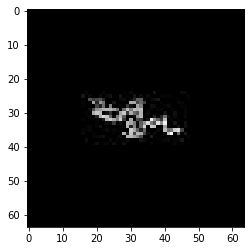

confidence for 9331 is 0.9193607


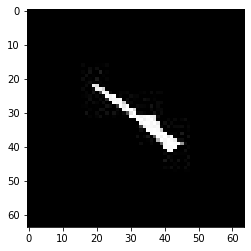

confidence for 9338 is 0.97008646


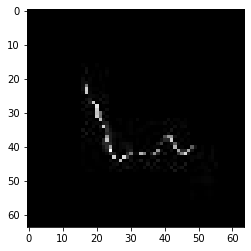

confidence for 9358 is 0.9742833


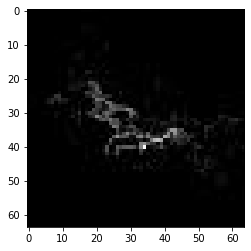

confidence for 9372 is 0.99079794


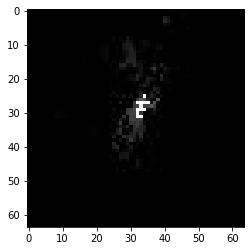

confidence for 9379 is 0.98439234


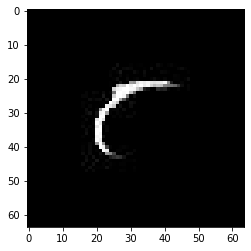

confidence for 9380 is 0.9999553


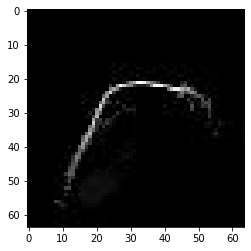

confidence for 9426 is 0.9950366


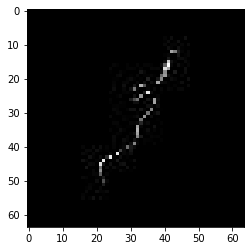

confidence for 9430 is 1.0


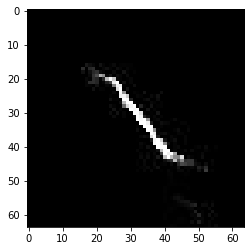

confidence for 9438 is 0.99512964


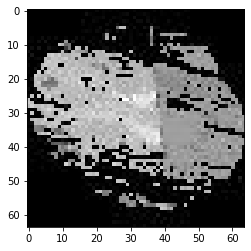

confidence for 9446 is 0.99999994


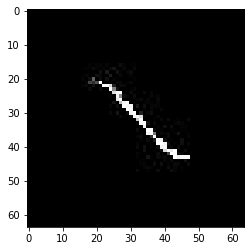

confidence for 9448 is 0.88402754


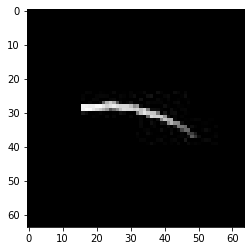

confidence for 9465 is 1.0


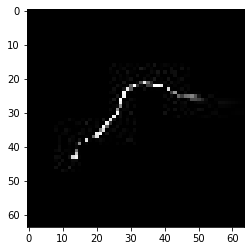

confidence for 9466 is 0.9993313


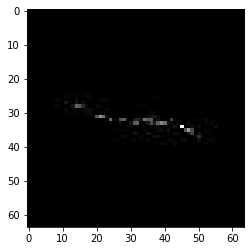

confidence for 9482 is 0.9997994


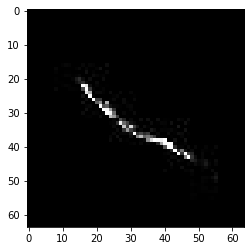

confidence for 9484 is 0.97346574


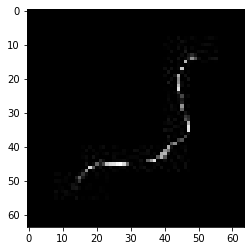

confidence for 9491 is 0.96404654


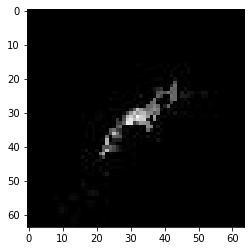

confidence for 9493 is 0.9968891


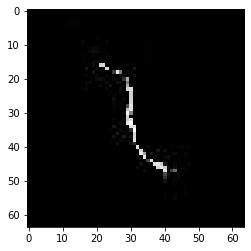

confidence for 9494 is 1.0


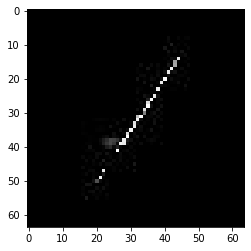

confidence for 9500 is 0.99772364


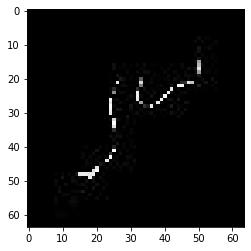

confidence for 9520 is 0.82761174


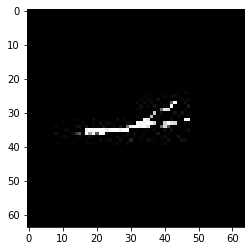

confidence for 9522 is 0.99026257


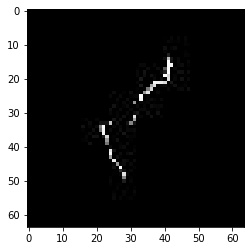

confidence for 9531 is 0.9705722


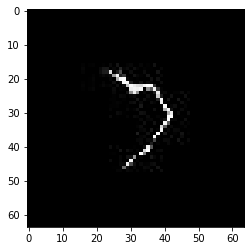

confidence for 9536 is 0.9036629


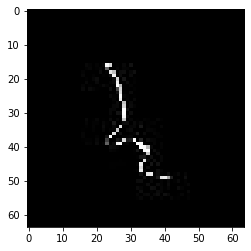

confidence for 9567 is 0.85890526


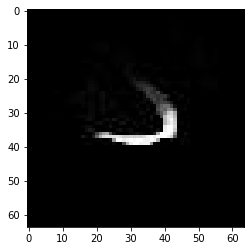

confidence for 9577 is 0.99938494


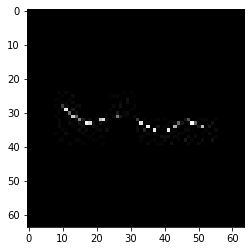

confidence for 9582 is 0.99918187


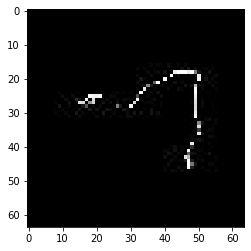

confidence for 9586 is 0.8209428


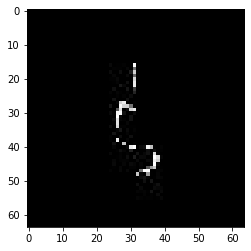

confidence for 9590 is 0.99990654


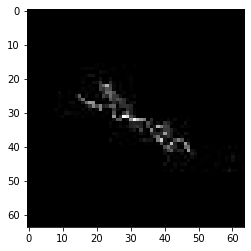

confidence for 9605 is 0.9999887


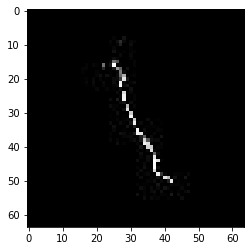

confidence for 9611 is 0.91370094


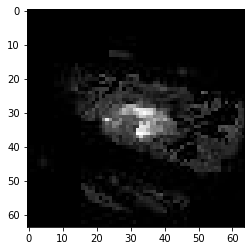

confidence for 9613 is 0.9885932


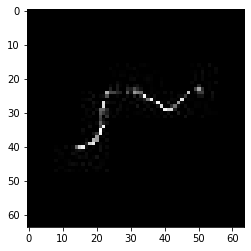

confidence for 9633 is 0.87880915


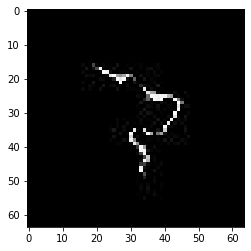

confidence for 9635 is 0.8734601


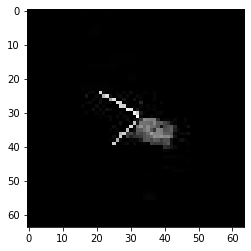

confidence for 9648 is 0.8686333


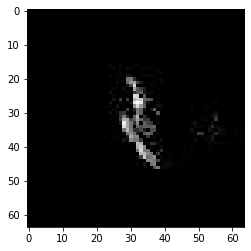

confidence for 9661 is 0.9927704


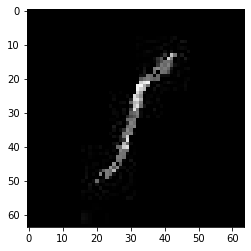

confidence for 9683 is 0.9292614


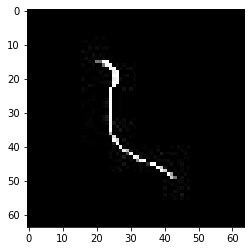

confidence for 9690 is 0.9994532


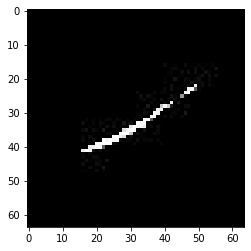

confidence for 9698 is 0.9994146


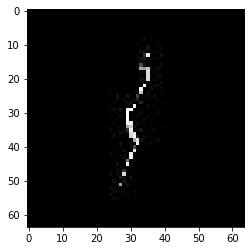

confidence for 9718 is 0.98562586


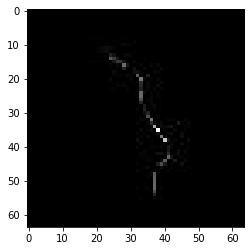

confidence for 9748 is 0.8890789


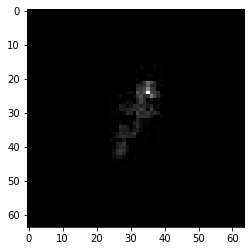

confidence for 9768 is 0.9756273


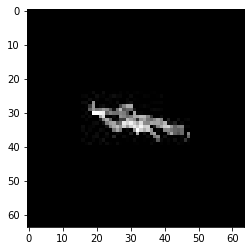

confidence for 9785 is 0.93174523


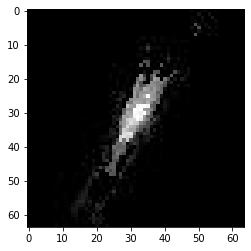

confidence for 9798 is 0.9259277


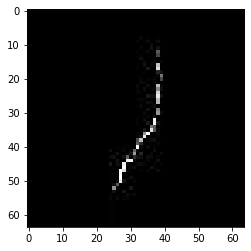

confidence for 9801 is 0.9999994


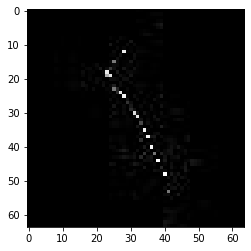

confidence for 9804 is 0.987379


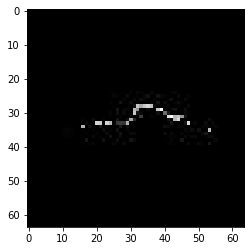

confidence for 9806 is 0.9611232


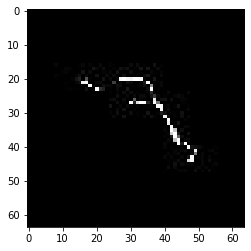

confidence for 9833 is 0.93436825


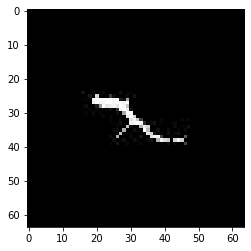

confidence for 9847 is 0.96136606


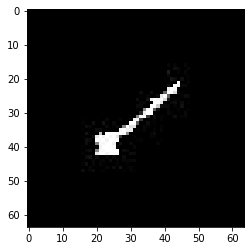

confidence for 9855 is 0.997673


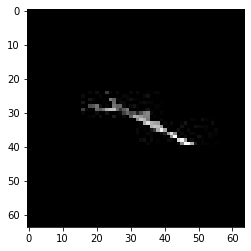

confidence for 9868 is 0.93038225


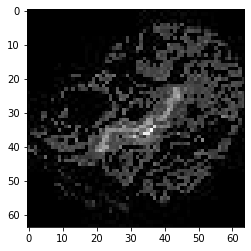

confidence for 9917 is 0.9818808


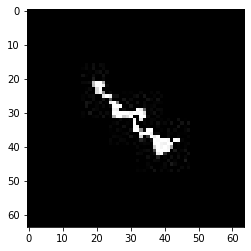

confidence for 9924 is 0.9346282


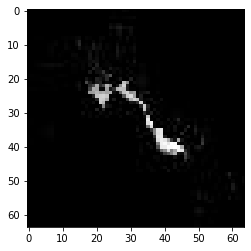

confidence for 9932 is 0.98692465


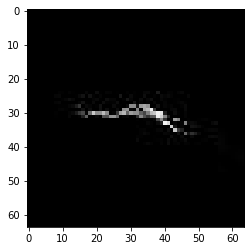

confidence for 9956 is 0.9546805


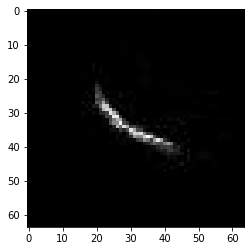

confidence for 9973 is 0.90096515


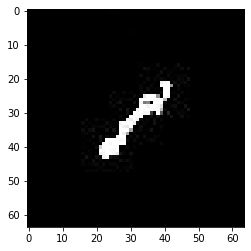

confidence for 9981 is 0.99808866


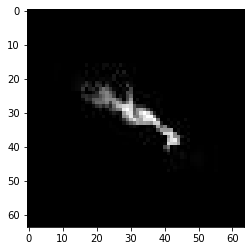

confidence for 9986 is 0.98438394


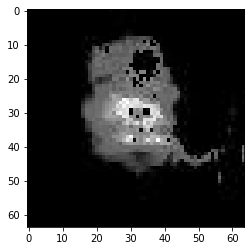

confidence for 10018 is 0.9969601


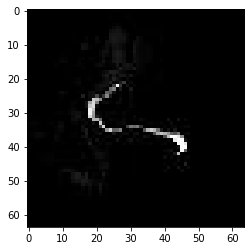

confidence for 10024 is 0.9593687


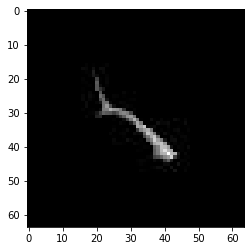

confidence for 10045 is 0.9792841


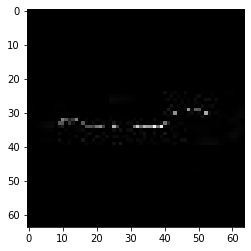

confidence for 10058 is 0.9731729


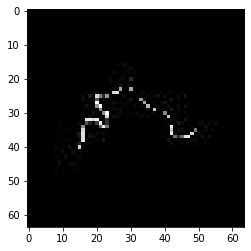

confidence for 10059 is 0.93765074


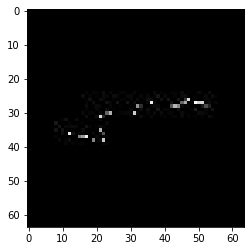

confidence for 10061 is 0.9980386


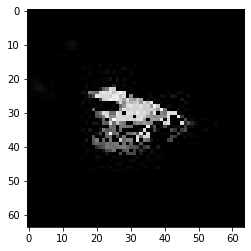

confidence for 10067 is 0.99154514


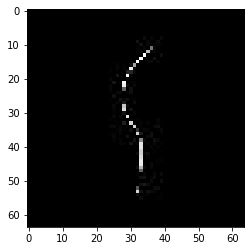

confidence for 10074 is 0.9994453


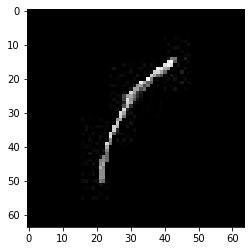

confidence for 10080 is 0.99943227


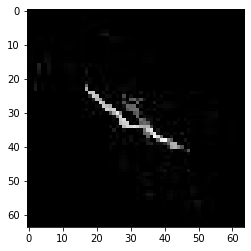

confidence for 10082 is 0.9557404


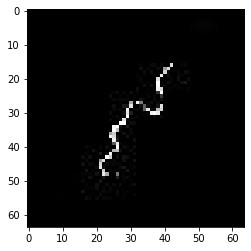

confidence for 10103 is 0.90499216


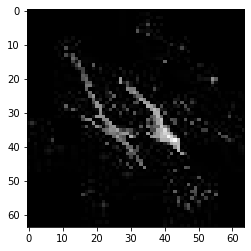

confidence for 10106 is 0.9995232


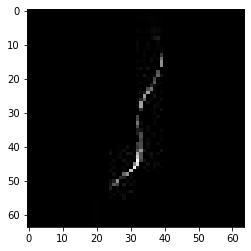

confidence for 10116 is 0.95469034


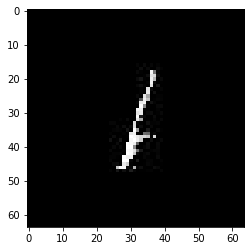

confidence for 10124 is 0.997679


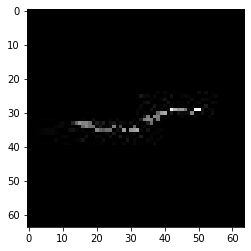

confidence for 10135 is 0.99659324


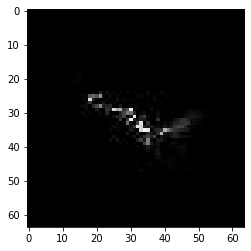

confidence for 10137 is 0.91686004


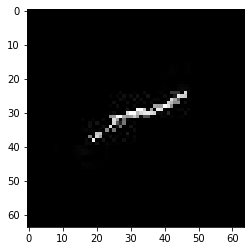

confidence for 10152 is 0.9678307


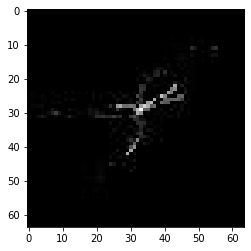

confidence for 10160 is 0.93002677


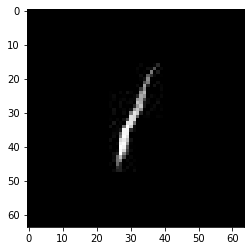

confidence for 10161 is 0.9179788


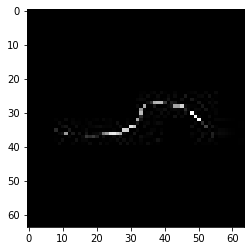

confidence for 10166 is 0.9447616


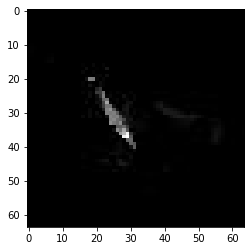

confidence for 10179 is 0.89005655


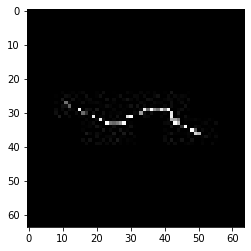

confidence for 10181 is 0.9996166


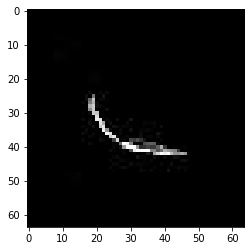

confidence for 10196 is 0.98997974


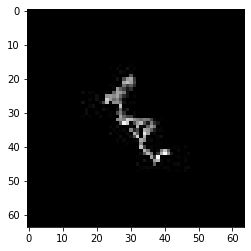

confidence for 10221 is 0.9406289


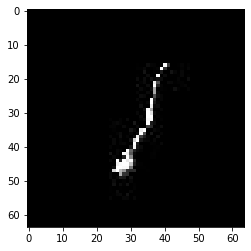

confidence for 10251 is 0.99974126


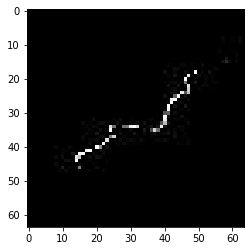

confidence for 10267 is 0.92875063


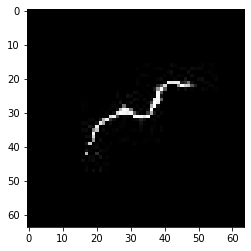

confidence for 10299 is 0.9972971


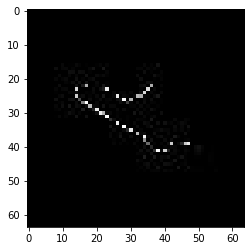

confidence for 10336 is 0.99769044


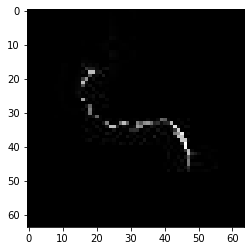

confidence for 10353 is 0.9871915


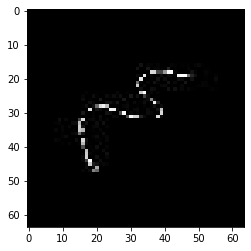

confidence for 10371 is 0.99958897


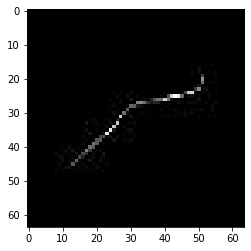

confidence for 10384 is 0.8859321


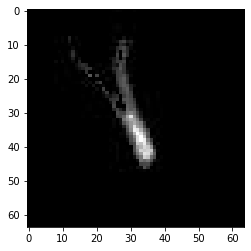

confidence for 10420 is 0.99982435


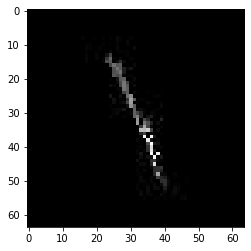

confidence for 10425 is 1.0


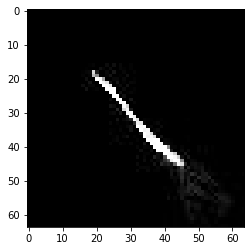

confidence for 10430 is 0.99981123


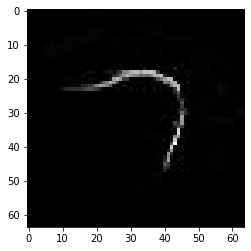

confidence for 10441 is 0.9987651


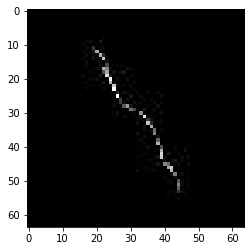

confidence for 10462 is 0.9966434


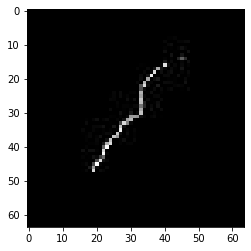

confidence for 10490 is 0.9998478


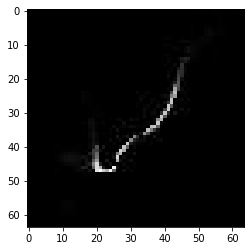

confidence for 10520 is 0.9810328


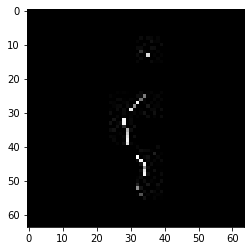

confidence for 10522 is 0.94223255


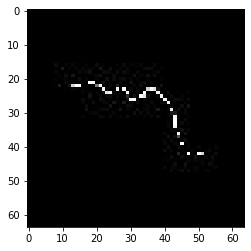

confidence for 10524 is 0.83484906


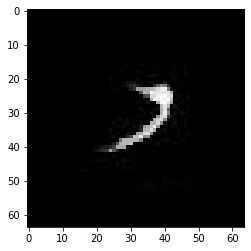

confidence for 10533 is 0.8749115


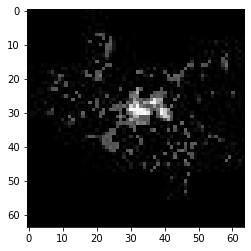

confidence for 10535 is 0.99570537


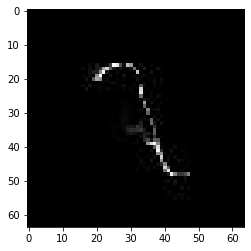

confidence for 10545 is 0.9997966


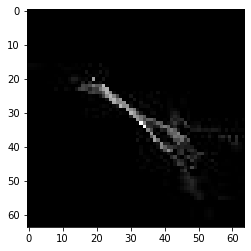

confidence for 10552 is 0.9816633


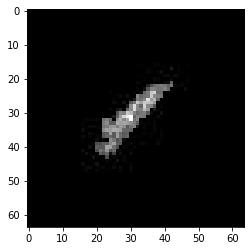

confidence for 10554 is 0.98653275


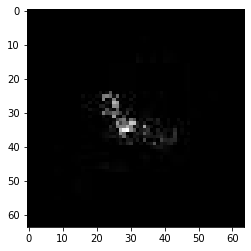

confidence for 10573 is 0.94777536


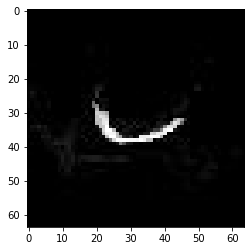

confidence for 10594 is 0.99553657


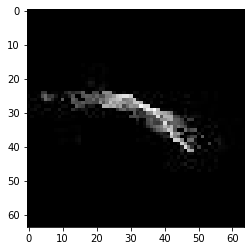

confidence for 10642 is 0.9999991


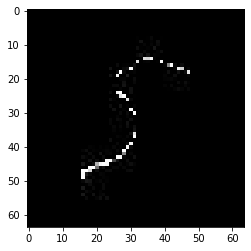

confidence for 10649 is 0.9999722


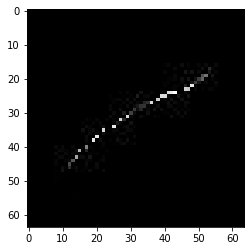

confidence for 10657 is 0.91030276


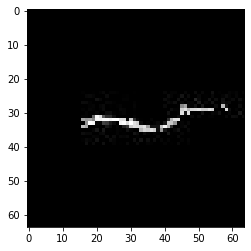

confidence for 10678 is 0.9759907


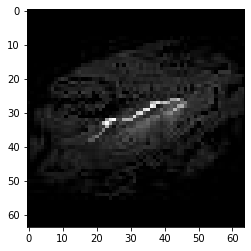

confidence for 10680 is 0.9998853


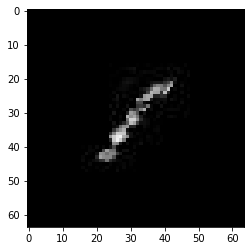

confidence for 10684 is 0.9736568


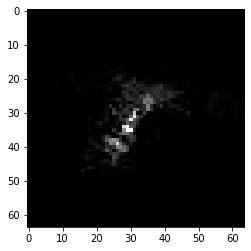

confidence for 10716 is 0.99992794


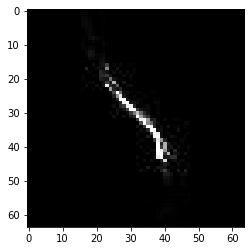

confidence for 10723 is 0.9477611


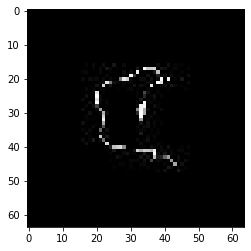

confidence for 10724 is 0.99943954


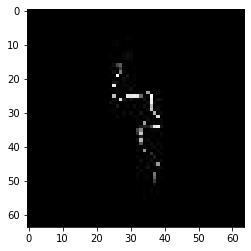

confidence for 10726 is 0.93911237


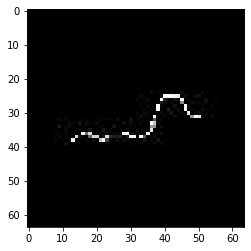

confidence for 10732 is 0.96845514


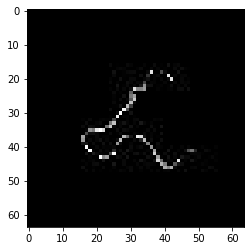

confidence for 10741 is 0.85604155


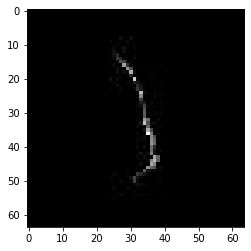

confidence for 10742 is 0.99930954


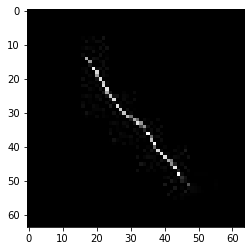

confidence for 10765 is 0.91763467


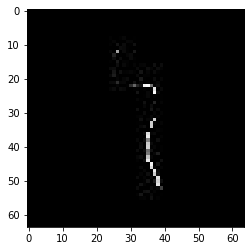

confidence for 10777 is 0.9964063


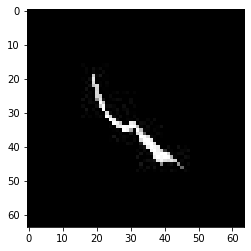

confidence for 10780 is 0.9863036


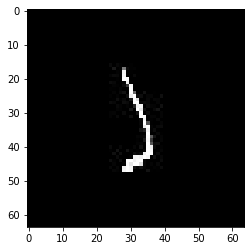

confidence for 10782 is 0.9996685


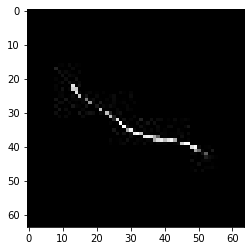

confidence for 10789 is 0.93645996


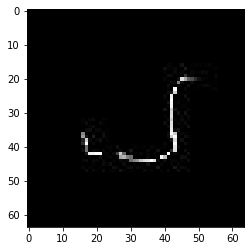

confidence for 10794 is 0.9503355


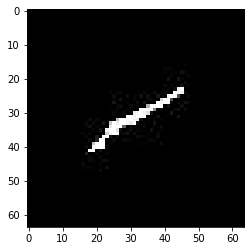

confidence for 10811 is 0.99999726


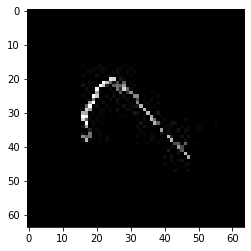

confidence for 10817 is 0.93260473


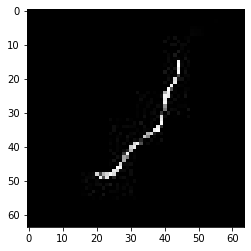

confidence for 10820 is 0.99500936


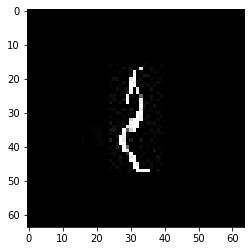

confidence for 10823 is 0.97921735


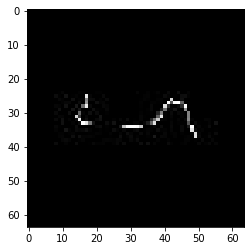

confidence for 10827 is 0.9998575


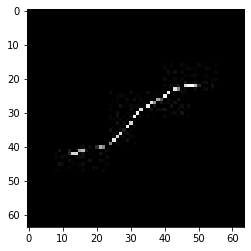

confidence for 10832 is 0.9625459


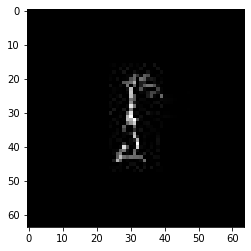

confidence for 10840 is 1.0


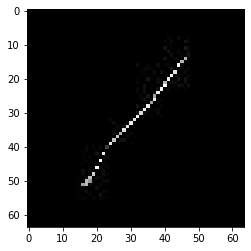

confidence for 10846 is 0.9653903


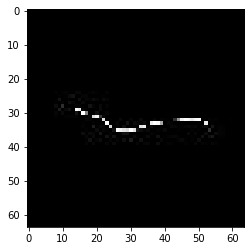

confidence for 10849 is 0.8647879


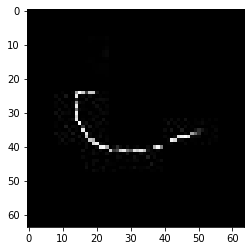

confidence for 10867 is 0.98556674


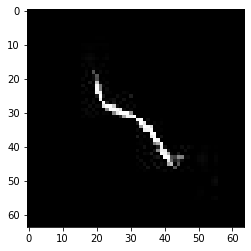

confidence for 10886 is 0.9931806


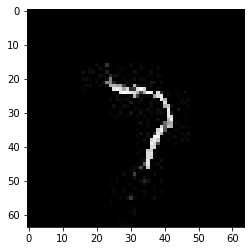

confidence for 10898 is 1.0


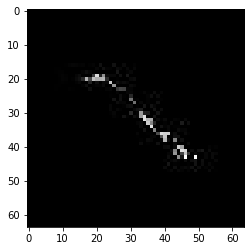

confidence for 10907 is 0.99847764


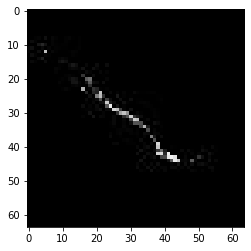

confidence for 10914 is 0.8033793


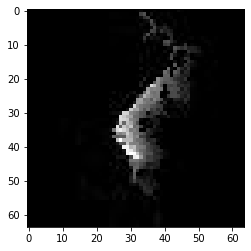

confidence for 10929 is 0.8414136


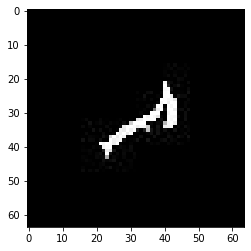

confidence for 10943 is 0.9618771


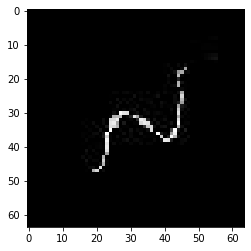

confidence for 10945 is 0.860203


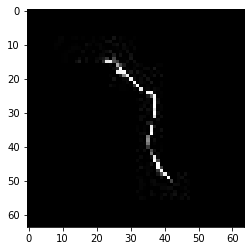

confidence for 10964 is 0.89387006


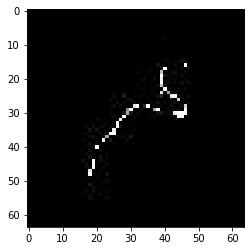

confidence for 10966 is 0.9999204


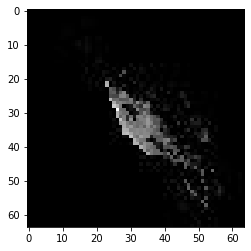

confidence for 10992 is 0.99596953


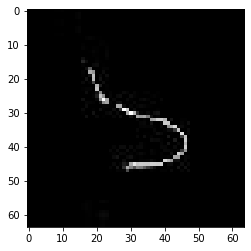

confidence for 11013 is 0.999998


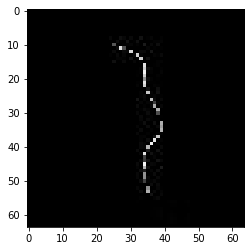

confidence for 11041 is 0.97796863


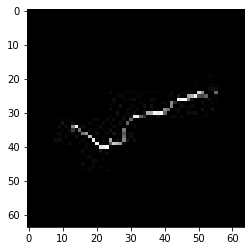

confidence for 11048 is 0.9863158


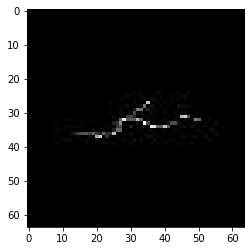

confidence for 11050 is 0.81341064


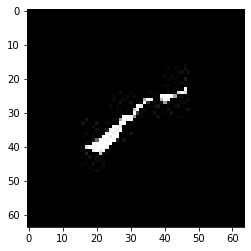

confidence for 11065 is 0.9999996


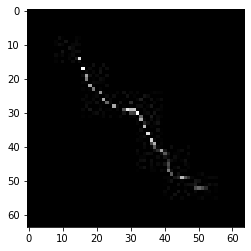

confidence for 11074 is 0.9994389


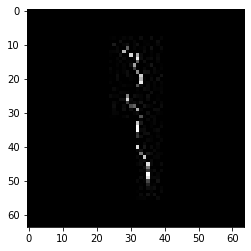

confidence for 11096 is 0.99702525


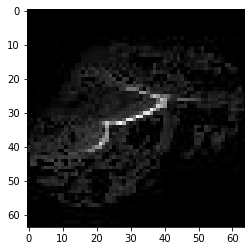

confidence for 11103 is 0.99999756


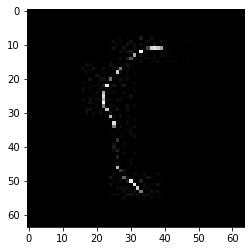

confidence for 11108 is 0.855408


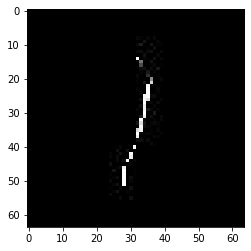

confidence for 11112 is 0.960243


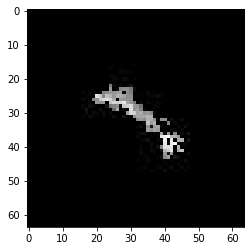

confidence for 11142 is 0.97989774


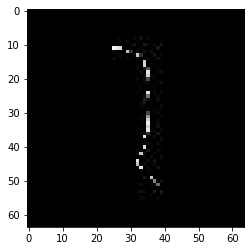

confidence for 11150 is 0.9751835


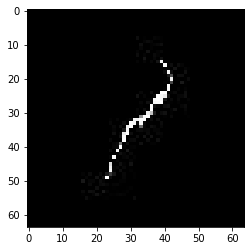

confidence for 11159 is 0.98370796


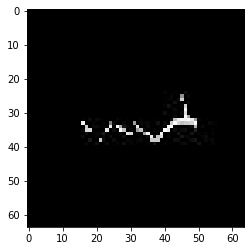

confidence for 11169 is 0.9999999


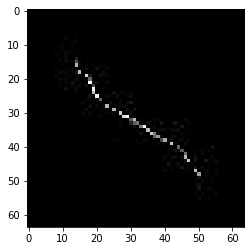

confidence for 11173 is 0.95689356


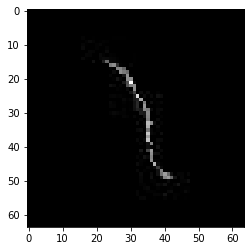

confidence for 11192 is 0.99993765


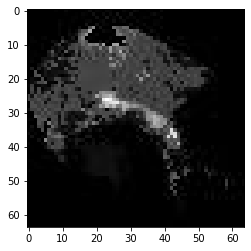

confidence for 11208 is 0.87128747


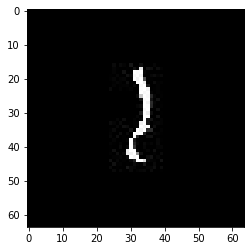

confidence for 11222 is 0.9109769


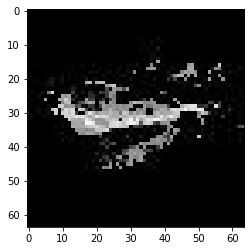

confidence for 11232 is 0.9195043


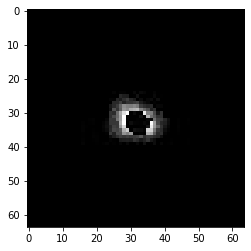

confidence for 11276 is 0.86413616


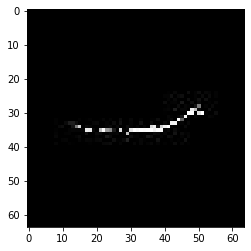

confidence for 11287 is 0.98543465


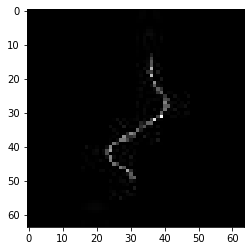

confidence for 11288 is 0.99925363


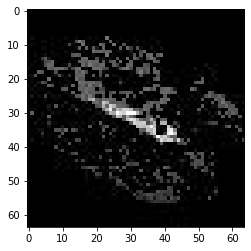

confidence for 11289 is 0.994791


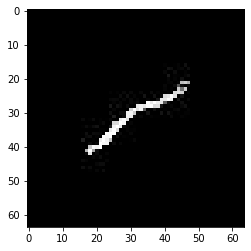

confidence for 11297 is 0.9996425


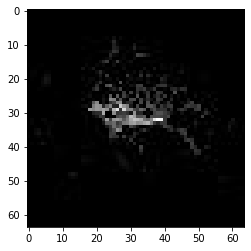

confidence for 11316 is 0.8023866


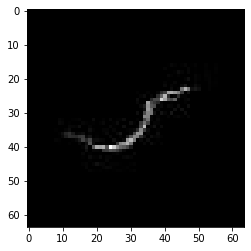

confidence for 11320 is 0.9966128


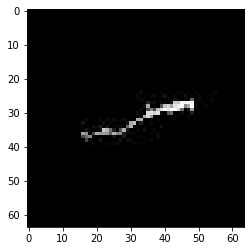

confidence for 11339 is 1.0


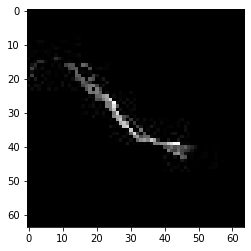

confidence for 11352 is 0.99635196


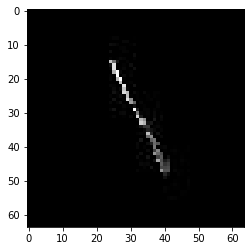

confidence for 11356 is 0.8604503


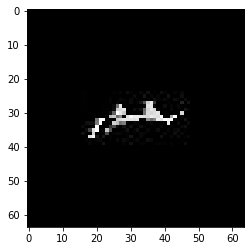

confidence for 11369 is 0.8100608


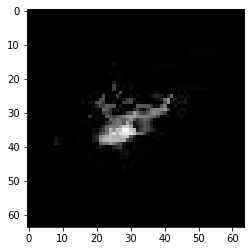

confidence for 11374 is 0.9998118


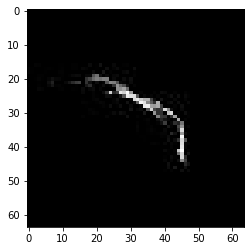

confidence for 11395 is 0.9584423


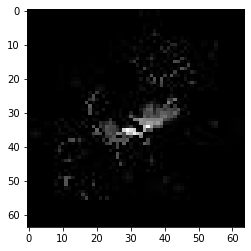

confidence for 11415 is 0.9503999


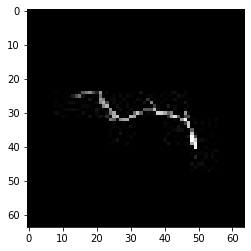

confidence for 11454 is 0.98874813


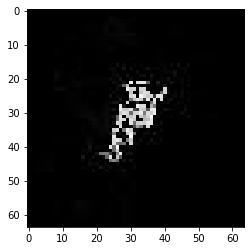

confidence for 11467 is 0.99649847


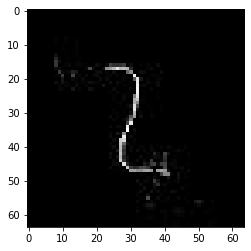

confidence for 11490 is 0.8803465


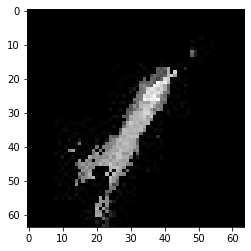

confidence for 11507 is 0.8717679


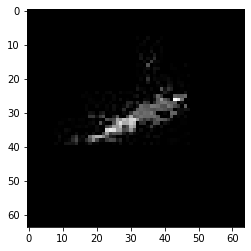

confidence for 11522 is 1.0


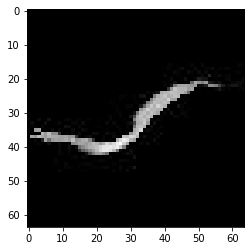

confidence for 11535 is 0.9380613


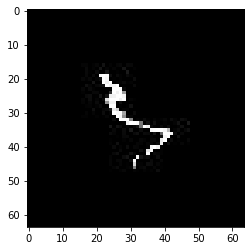

confidence for 11541 is 0.9999804


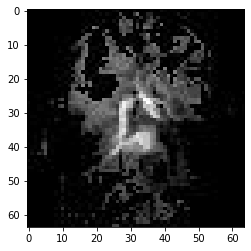

confidence for 11542 is 0.9999954


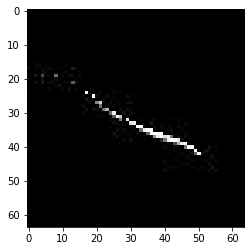

confidence for 11547 is 0.9706619


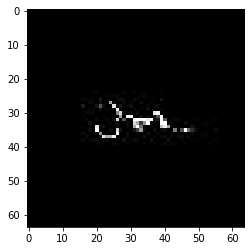

confidence for 11559 is 0.9665762


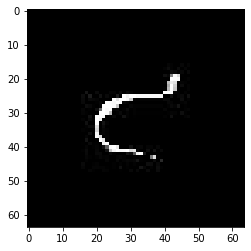

confidence for 11575 is 0.981446


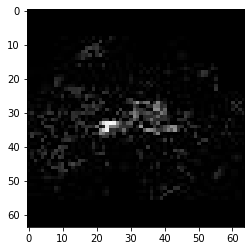

confidence for 11599 is 0.9999986


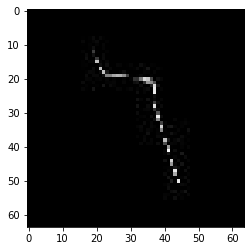

confidence for 11602 is 0.91831744


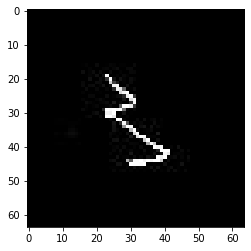

confidence for 11617 is 0.9841445


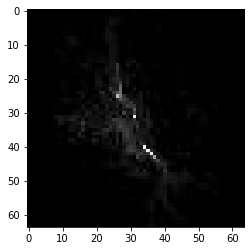

confidence for 11625 is 0.999436


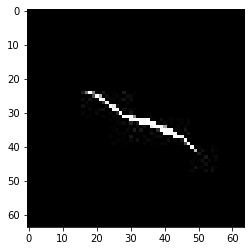

confidence for 11637 is 0.9995546


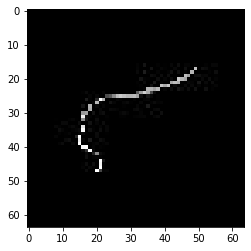

confidence for 11638 is 0.90842736


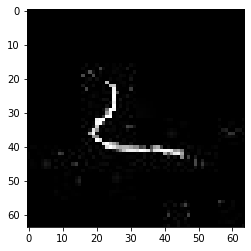

confidence for 11675 is 0.9970917


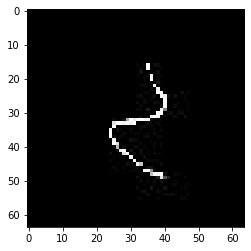

confidence for 11715 is 0.999988


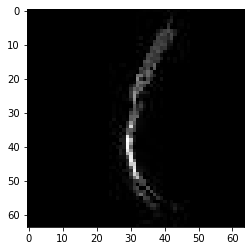

confidence for 11737 is 0.9765801


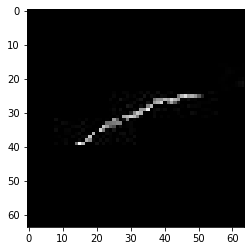

confidence for 11741 is 0.9730229


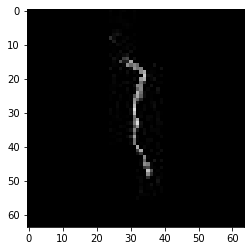

confidence for 11743 is 0.8635543


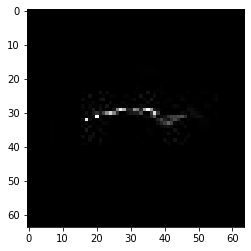

confidence for 11744 is 0.9974734


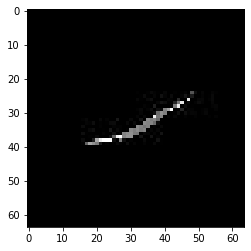

confidence for 11752 is 0.99999994


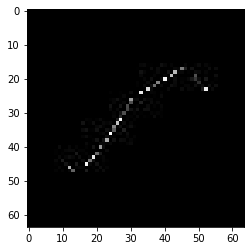

confidence for 11753 is 0.97073257


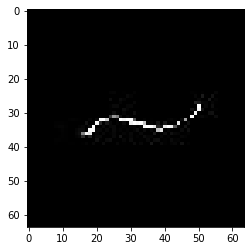

confidence for 11774 is 0.9994811


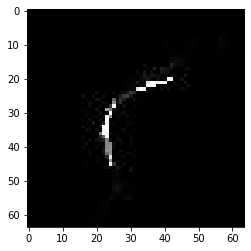

confidence for 11792 is 0.88970745


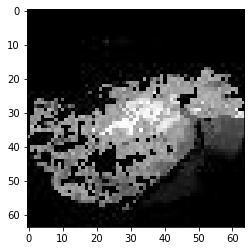

confidence for 11798 is 0.9339631


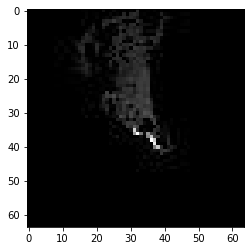

confidence for 11799 is 0.99933076


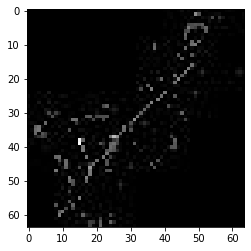

confidence for 11809 is 0.9686288


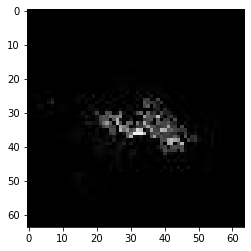

confidence for 11814 is 0.9820163


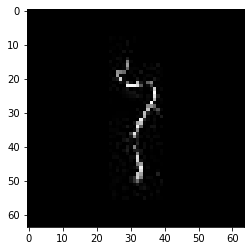

confidence for 11823 is 0.99998385


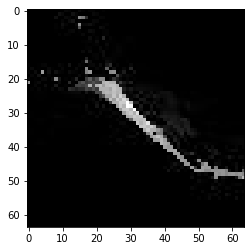

confidence for 11836 is 0.959126


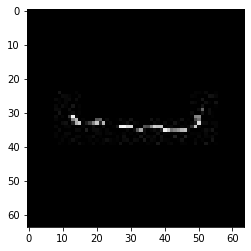

confidence for 11846 is 0.9328143


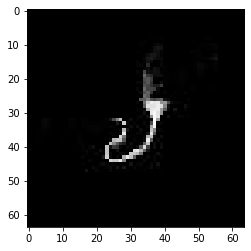

confidence for 11856 is 0.9983855


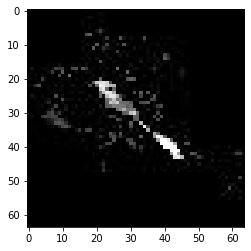

confidence for 11868 is 0.83172154


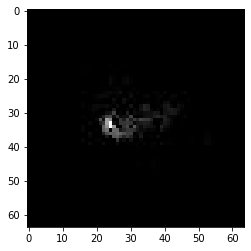

confidence for 11904 is 0.8568951


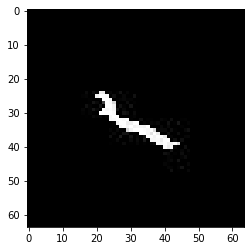

confidence for 11911 is 0.9997754


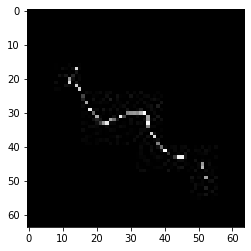

confidence for 11928 is 0.9040181


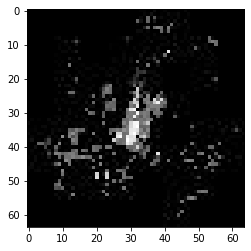

confidence for 11932 is 0.8451998


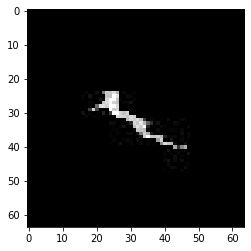

confidence for 11943 is 0.9653776


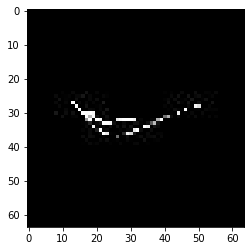

confidence for 11948 is 1.0


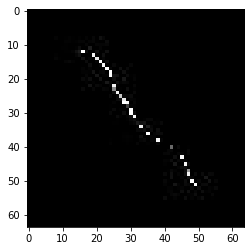

confidence for 11950 is 0.9779656


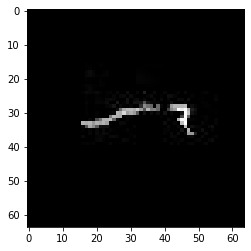

confidence for 11956 is 0.8013698


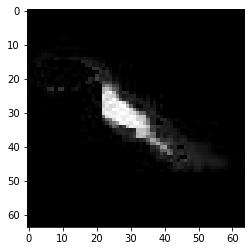

confidence for 11974 is 0.87427443


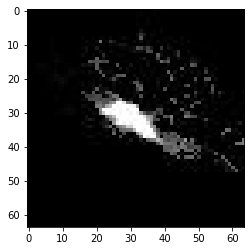

confidence for 11975 is 0.999796


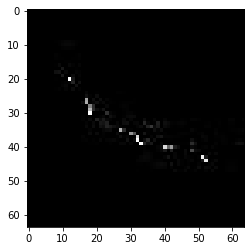

confidence for 11980 is 0.99150777


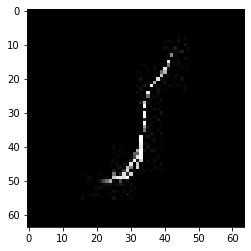

confidence for 11988 is 0.9993806


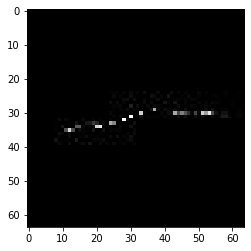

confidence for 11998 is 0.95738316


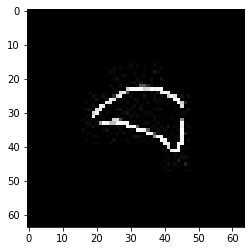

confidence for 12009 is 0.94771266


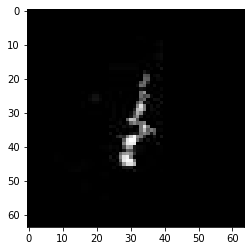

confidence for 12021 is 0.9980309


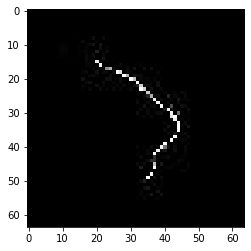

confidence for 12026 is 0.8032713


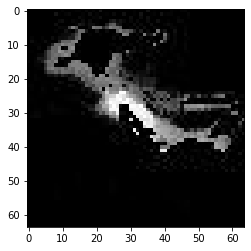

confidence for 12032 is 0.8911112


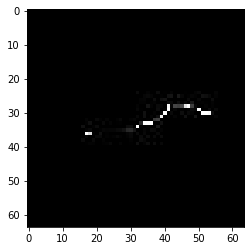

confidence for 12036 is 0.9990296


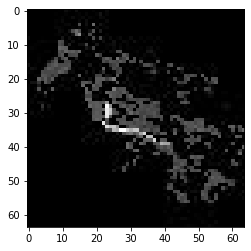

confidence for 12041 is 0.9999054


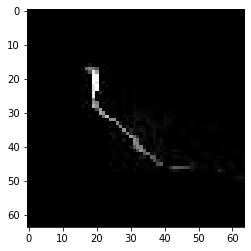

confidence for 12053 is 0.99999183


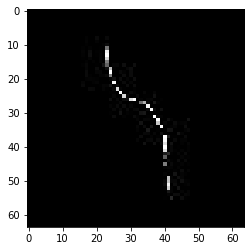

confidence for 12057 is 0.99734753


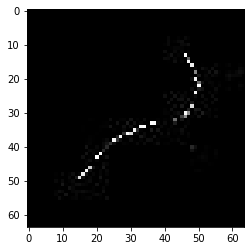

confidence for 12059 is 0.914151


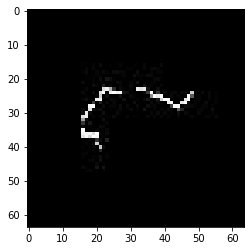

confidence for 12068 is 0.99942607


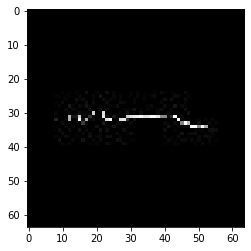

confidence for 12082 is 0.9037501


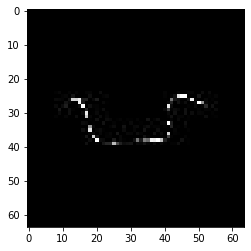

confidence for 12091 is 0.9266753


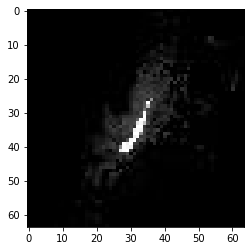

confidence for 12092 is 0.99999964


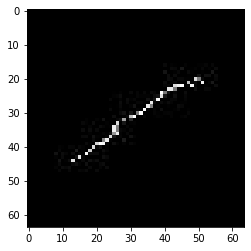

confidence for 12095 is 0.9655922


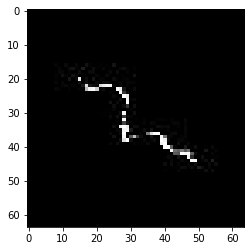

confidence for 12101 is 1.0


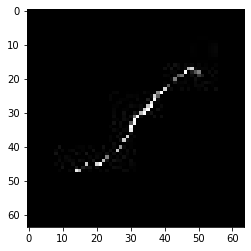

confidence for 12116 is 0.9730328


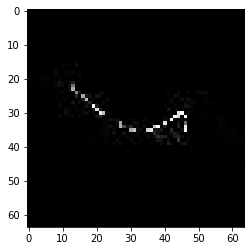

confidence for 12117 is 0.999653


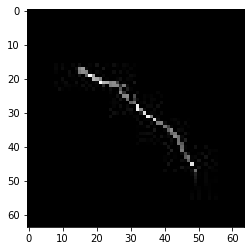

confidence for 12120 is 0.99064785


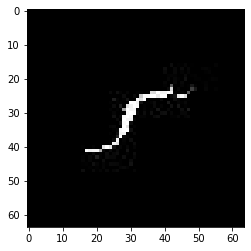

confidence for 12123 is 0.99963427


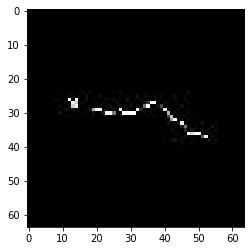

confidence for 12130 is 0.99999255


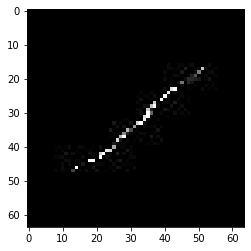

confidence for 12133 is 0.9997708


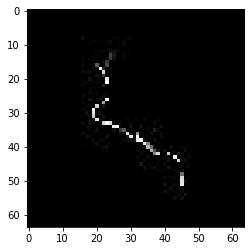

confidence for 12165 is 0.9999996


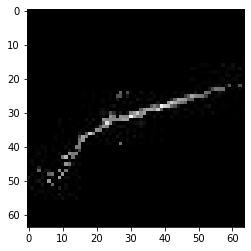

confidence for 12169 is 0.837197


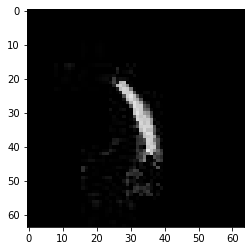

confidence for 12194 is 0.9998864


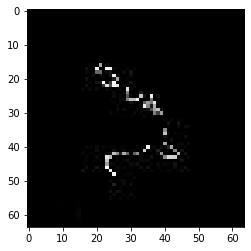

confidence for 12204 is 0.99999964


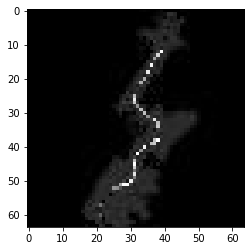

confidence for 12207 is 0.99744934


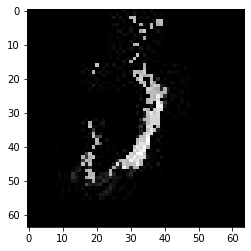

confidence for 12229 is 0.86702484


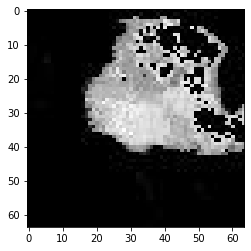

confidence for 12234 is 0.99967074


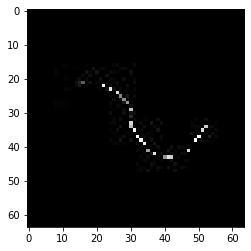

confidence for 12237 is 0.9998177


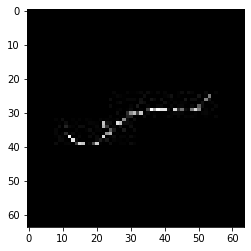

confidence for 12245 is 0.96535194


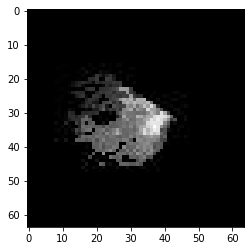

confidence for 12249 is 0.82955176


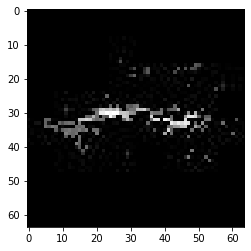

confidence for 12256 is 0.98516107


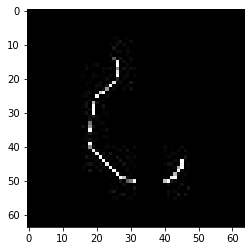

confidence for 12257 is 0.8518787


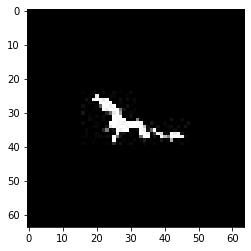

confidence for 12258 is 0.9948386


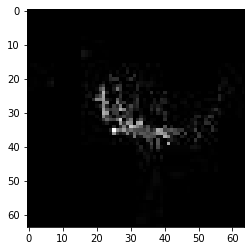

confidence for 12261 is 0.86412835


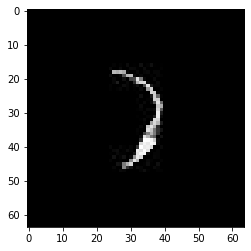

confidence for 12273 is 0.99191153


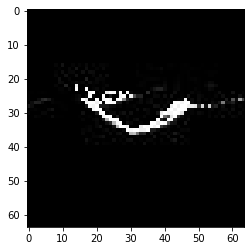

confidence for 12278 is 0.9999995


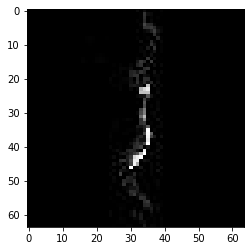

confidence for 12295 is 0.99999934


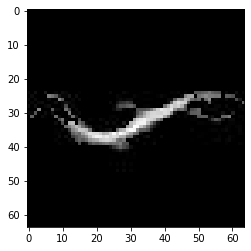

confidence for 12310 is 0.9999474


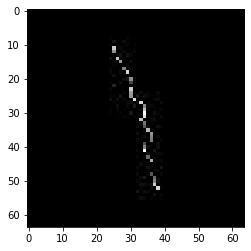

confidence for 12322 is 0.99282825


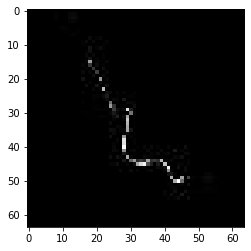

confidence for 12332 is 0.9963751


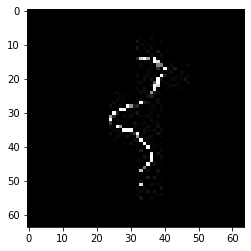

confidence for 12340 is 0.93452954


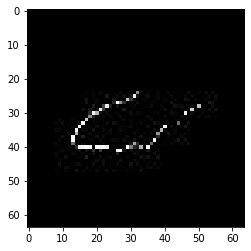

confidence for 12343 is 0.9797349


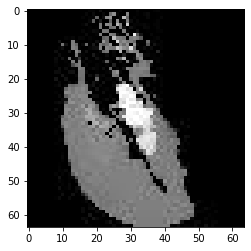

confidence for 12344 is 0.96007437


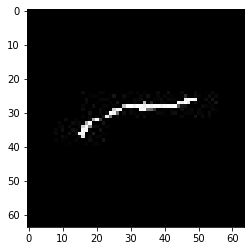

confidence for 12346 is 0.99994004


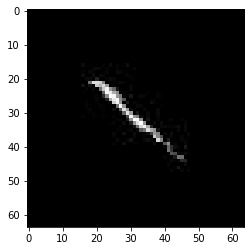

confidence for 12363 is 0.8396704


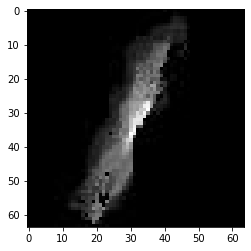

confidence for 12367 is 0.8115385


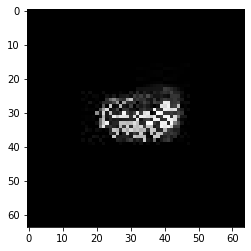

confidence for 12410 is 0.91125023


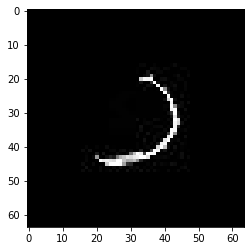

confidence for 12418 is 0.9844181


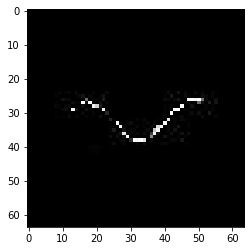

confidence for 12422 is 0.99888855


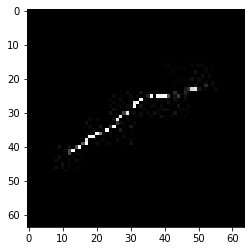

confidence for 12424 is 0.99998146


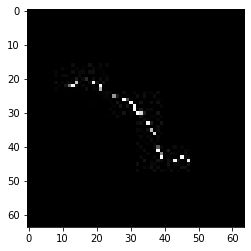

confidence for 12427 is 0.9989696


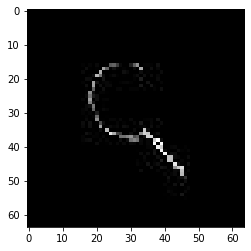

confidence for 12449 is 0.9997872


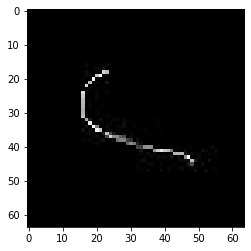

confidence for 12465 is 0.9998036


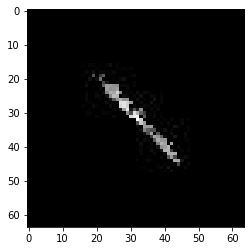

confidence for 12477 is 0.9965063


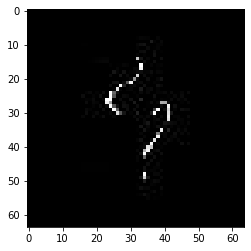

confidence for 12481 is 0.99676555


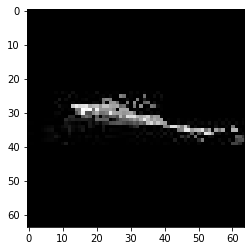

confidence for 12493 is 0.969638


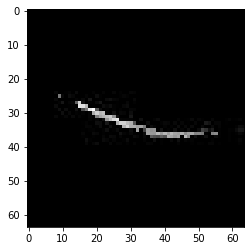

confidence for 12500 is 0.8392865


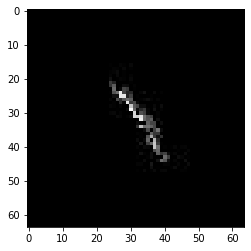

confidence for 12504 is 0.99171865


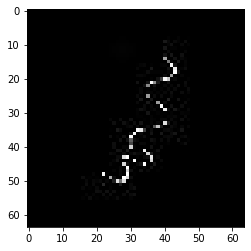

confidence for 12512 is 0.897977


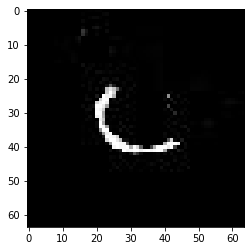

confidence for 12519 is 1.0


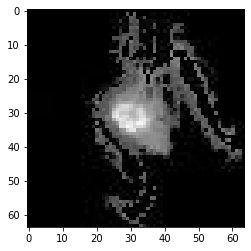

confidence for 12522 is 0.9493538


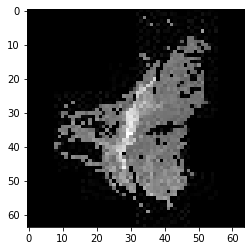

confidence for 12551 is 0.992025


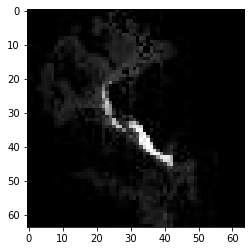

confidence for 12580 is 0.91035026


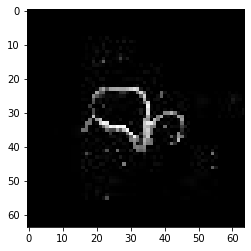

confidence for 12594 is 0.99790853


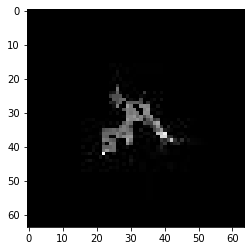

confidence for 12595 is 1.0


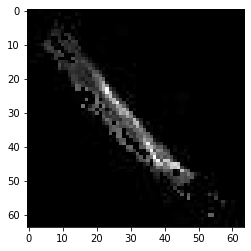

confidence for 12603 is 0.8297237


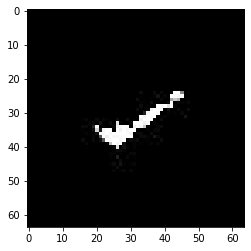

confidence for 12620 is 0.8407231


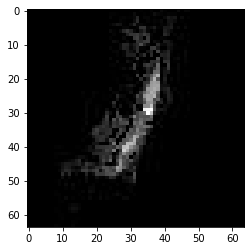

confidence for 12623 is 0.903246


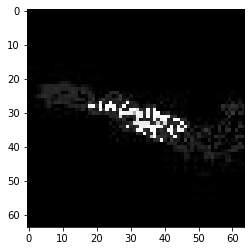

confidence for 12658 is 0.83219427


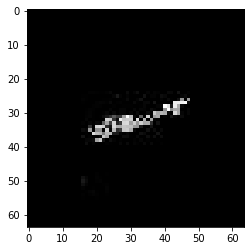

confidence for 12673 is 0.9942627


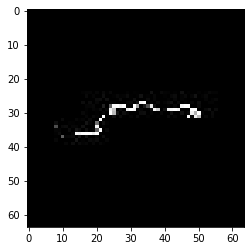

confidence for 12678 is 0.8803843


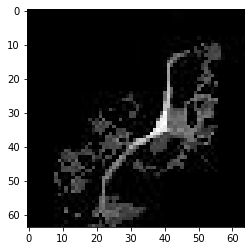

confidence for 12745 is 0.8159368


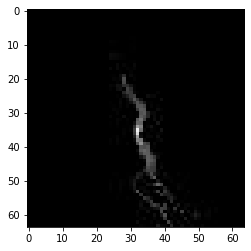

confidence for 12763 is 0.8825448


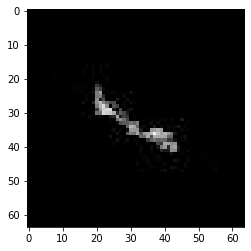

confidence for 12772 is 0.9997903


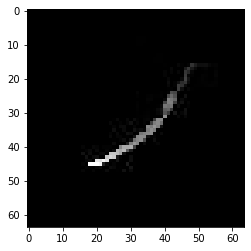

confidence for 12788 is 0.9373573


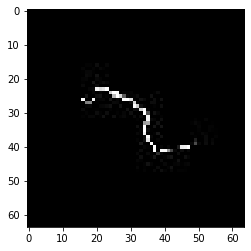

confidence for 12789 is 0.98568803


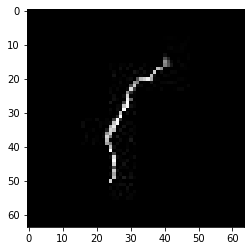

confidence for 12797 is 0.998572


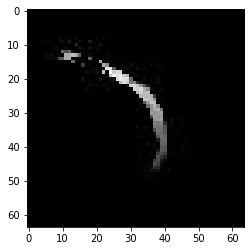

confidence for 12812 is 0.9961406


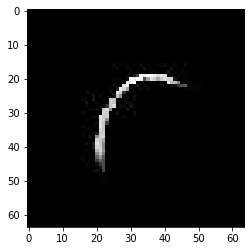

confidence for 12813 is 0.8028356


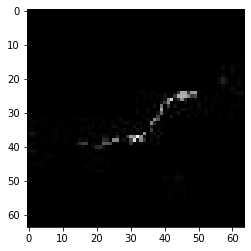

confidence for 12815 is 0.99929285


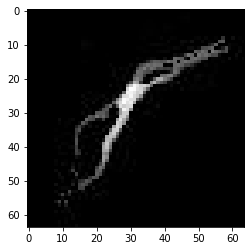

confidence for 12850 is 0.82153225


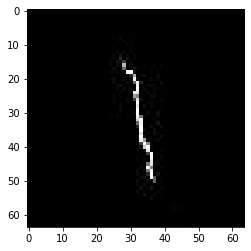

confidence for 12852 is 0.99861026


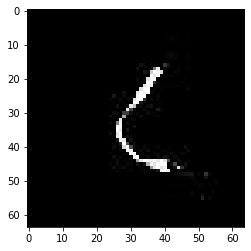

confidence for 12858 is 0.9959084


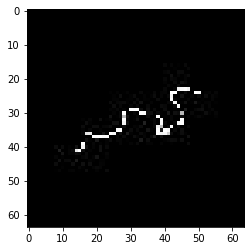

confidence for 12859 is 0.99260914


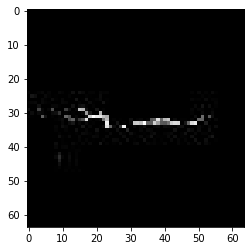

confidence for 12865 is 0.86569816


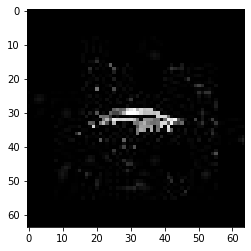

confidence for 12870 is 0.9958345


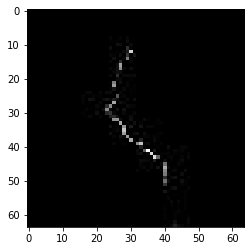

confidence for 12879 is 0.9995528


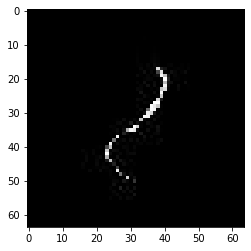

confidence for 12881 is 0.9999107


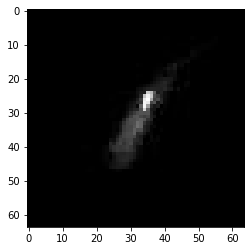

confidence for 12895 is 0.9893488


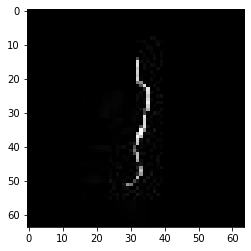

confidence for 12898 is 0.9884397


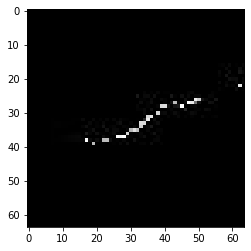

confidence for 12900 is 0.9987588


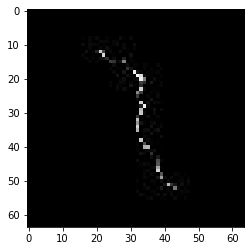

confidence for 12905 is 0.9996361


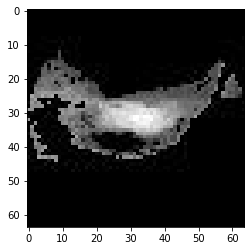

confidence for 12909 is 0.96987545


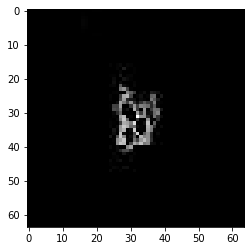

confidence for 12910 is 0.90928096


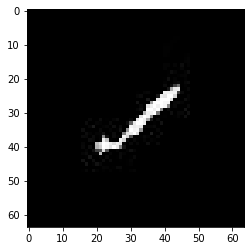

confidence for 12928 is 0.99943435


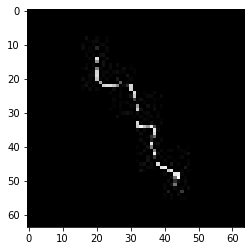

confidence for 12938 is 0.99978894


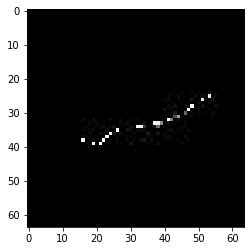

confidence for 12940 is 0.95422196


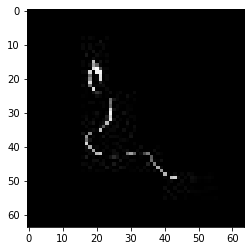

confidence for 12974 is 0.99973583


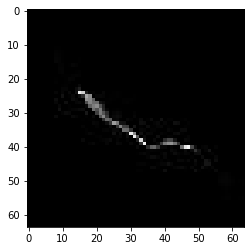

confidence for 12975 is 0.91994035


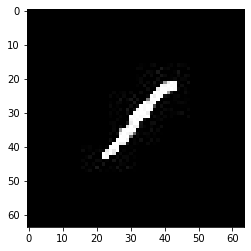

confidence for 12994 is 0.99999964


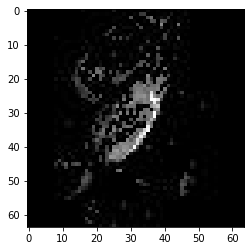

confidence for 13000 is 0.9095536


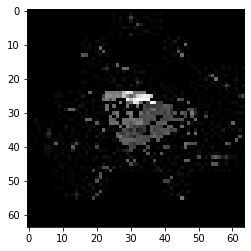

confidence for 13006 is 0.9997748


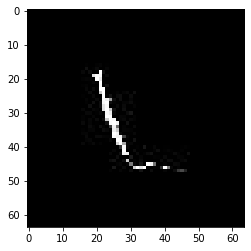

confidence for 13008 is 0.99928164


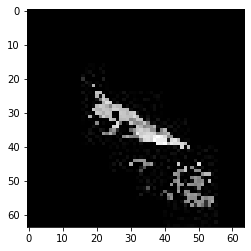

confidence for 13020 is 0.8687717


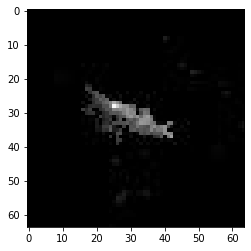

confidence for 13025 is 0.9997635


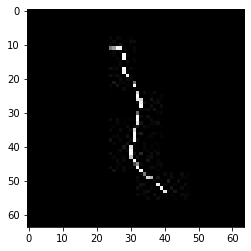

confidence for 13028 is 0.9490471


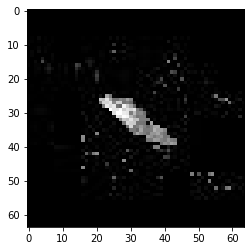

confidence for 13036 is 0.99847907


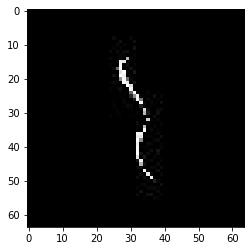

confidence for 13046 is 0.96008515


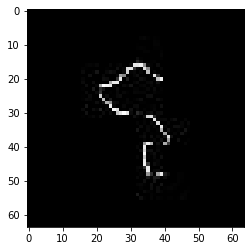

confidence for 13050 is 0.9999711


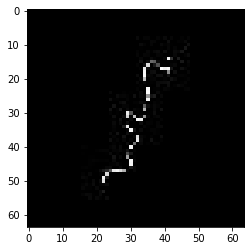

confidence for 13058 is 0.999782


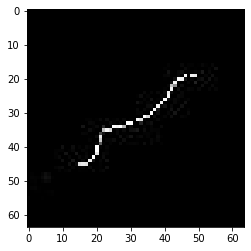

confidence for 13060 is 0.972299


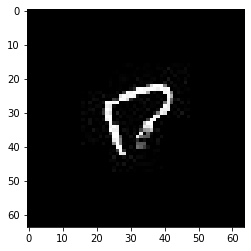

confidence for 13063 is 0.9881414


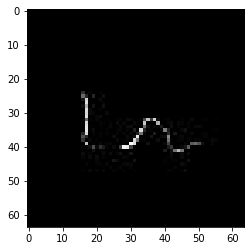

confidence for 13064 is 0.9895768


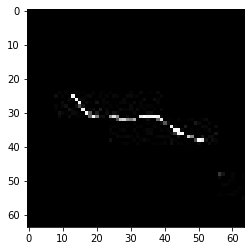

confidence for 13085 is 0.99310035


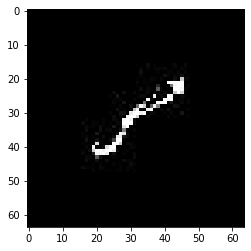

confidence for 13100 is 0.99958825


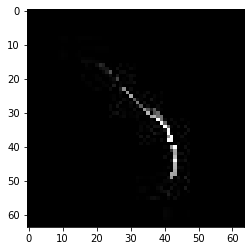

confidence for 13124 is 0.98715204


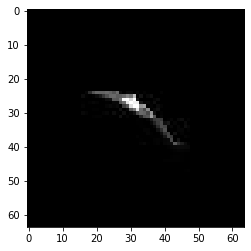

confidence for 13127 is 0.99538255


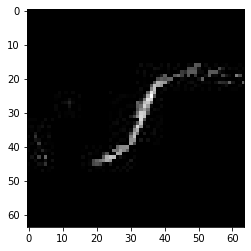

confidence for 13129 is 0.9745043


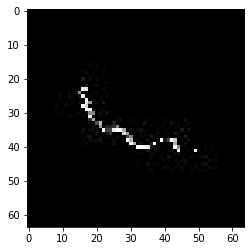

confidence for 13133 is 0.98251283


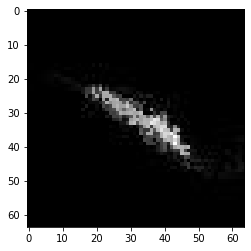

confidence for 13136 is 0.8792976


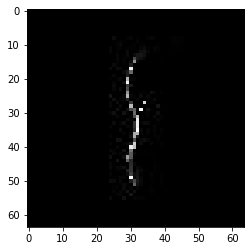

confidence for 13153 is 0.9980647


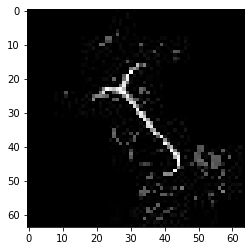

confidence for 13166 is 0.93892884


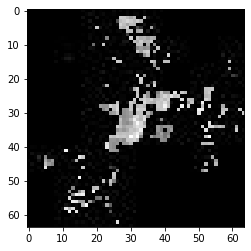

confidence for 13205 is 0.99188673


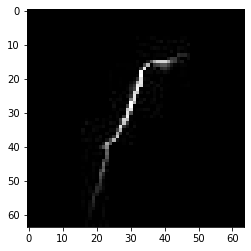

confidence for 13207 is 0.9993515


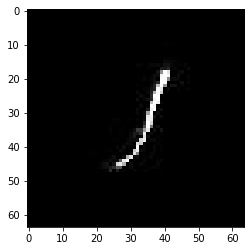

confidence for 13211 is 1.0


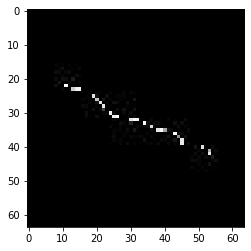

confidence for 13214 is 0.938184


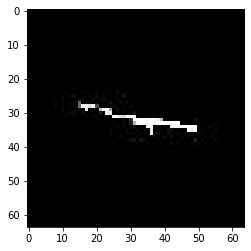

confidence for 13218 is 0.9795028


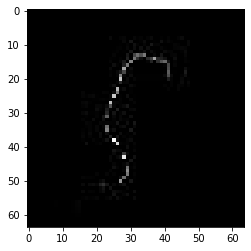

confidence for 13220 is 0.99613327


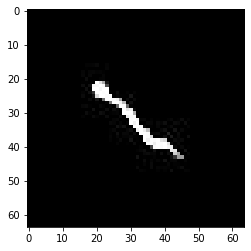

confidence for 13221 is 0.99529284


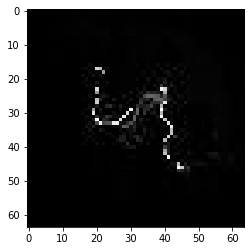

confidence for 13228 is 0.9999144


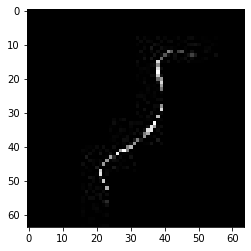

confidence for 13229 is 0.94599074


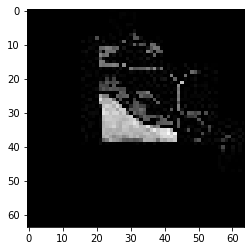

confidence for 13237 is 0.9773962


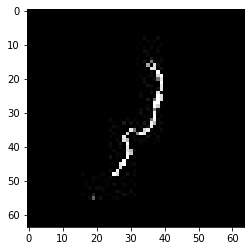

confidence for 13240 is 0.9805947


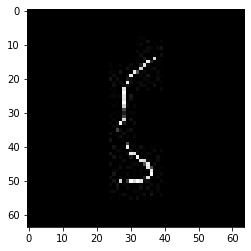

confidence for 13244 is 0.96787024


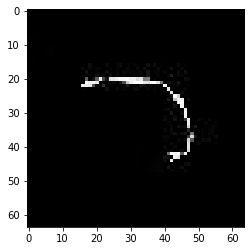

confidence for 13247 is 0.9998843


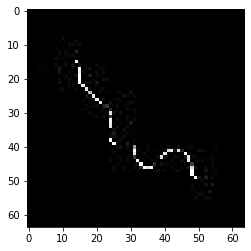

confidence for 13251 is 0.94200593


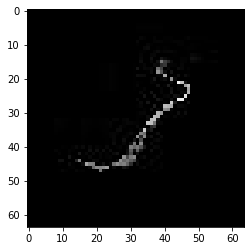

confidence for 13255 is 0.99990016


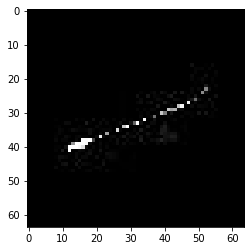

confidence for 13274 is 0.99490166


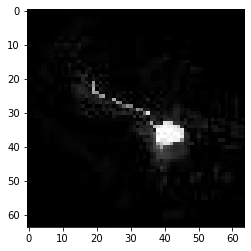

confidence for 13294 is 0.99871093


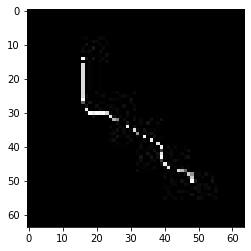

confidence for 13305 is 0.8098179


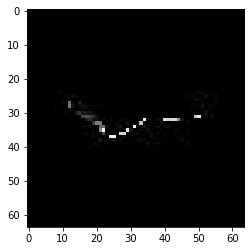

confidence for 13308 is 0.95641905


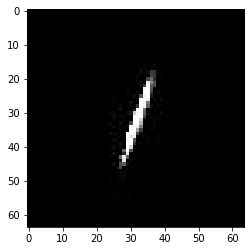

confidence for 13313 is 0.99750537


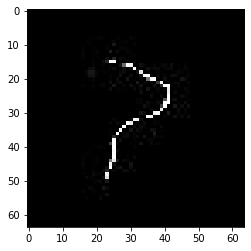

confidence for 13317 is 0.8862134


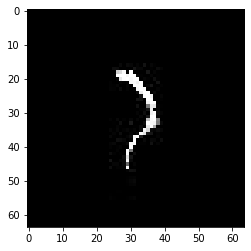

confidence for 13334 is 0.99824667


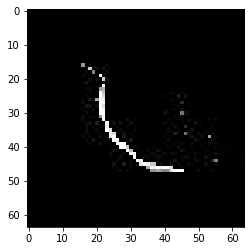

confidence for 13348 is 0.911658


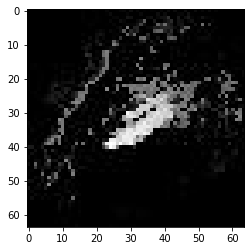

confidence for 13370 is 0.88598996


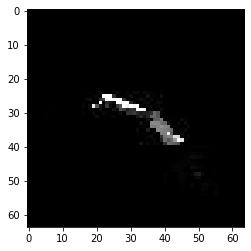

confidence for 13374 is 0.9700524


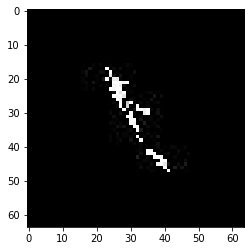

confidence for 13380 is 0.9999619


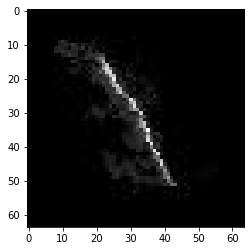

confidence for 13384 is 0.9999999


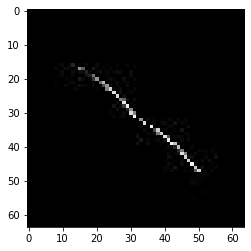

confidence for 13394 is 0.99382854


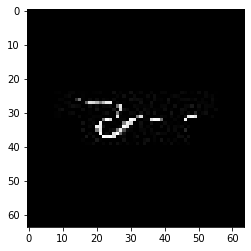

confidence for 13398 is 0.9643464


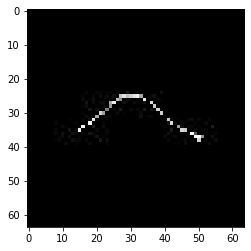

confidence for 13416 is 0.99922824


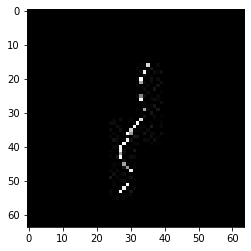

confidence for 13420 is 0.999753


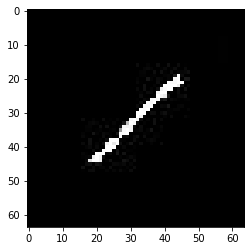

confidence for 13433 is 0.9999997


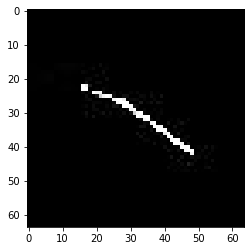

confidence for 13440 is 0.8653939


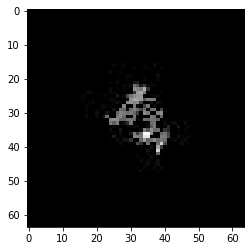

confidence for 13446 is 0.9999802


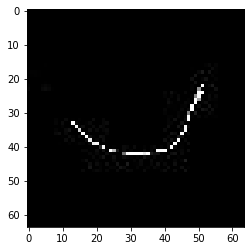

confidence for 13449 is 0.81036186


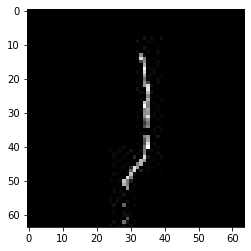

confidence for 13456 is 0.95752585


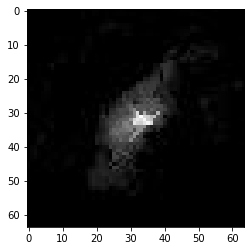

confidence for 13465 is 0.944855


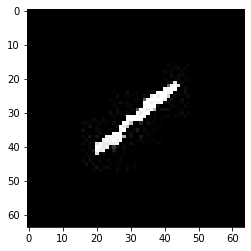

confidence for 13467 is 0.9991035


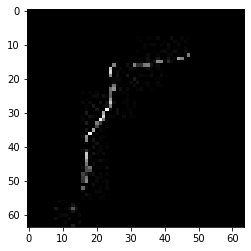

confidence for 13474 is 0.8343038


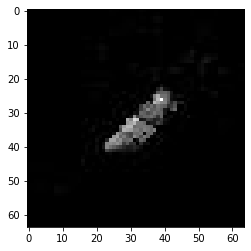

confidence for 13491 is 0.80014616


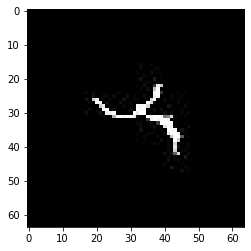

confidence for 13502 is 0.8118782


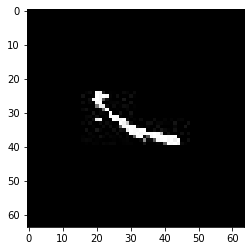

confidence for 13503 is 0.99289894


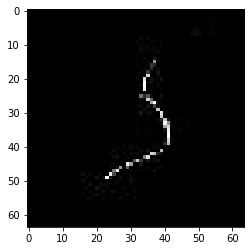

confidence for 13513 is 0.9779187


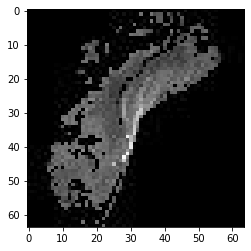

confidence for 13530 is 0.9991063


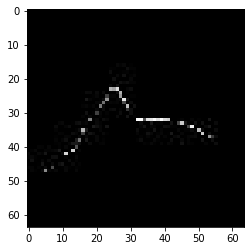

confidence for 13545 is 0.98833895


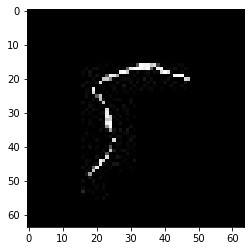

confidence for 13554 is 0.9999801


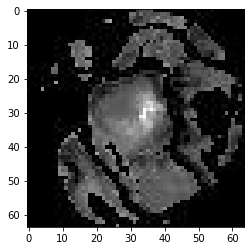

confidence for 13556 is 0.98614514


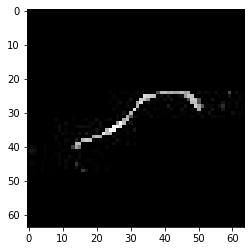

confidence for 13563 is 0.9708278


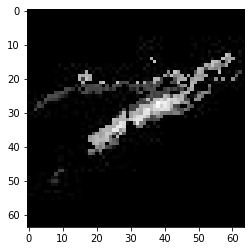

confidence for 13580 is 0.9164895


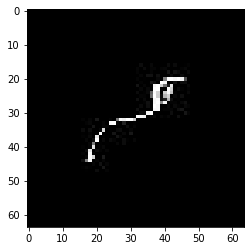

confidence for 13601 is 0.9819931


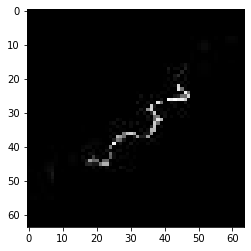

confidence for 13627 is 0.9999888


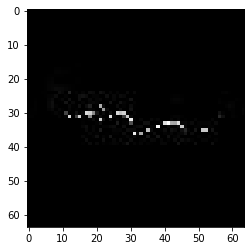

confidence for 13642 is 0.9999887


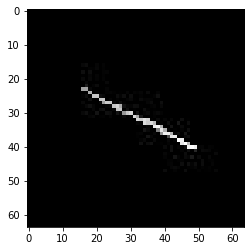

confidence for 13676 is 0.9975201


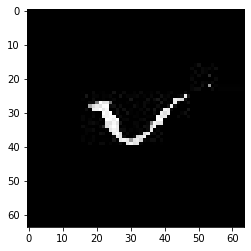

confidence for 13685 is 0.9995907


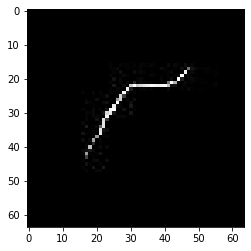

confidence for 13691 is 0.9280168


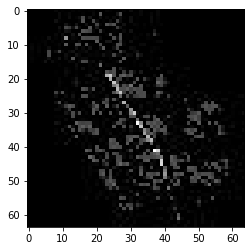

confidence for 13694 is 0.94978803


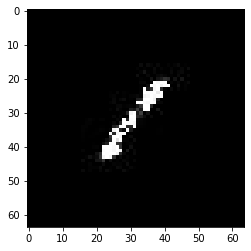

confidence for 13695 is 0.9904908


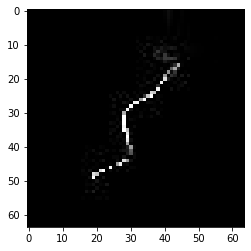

confidence for 13735 is 0.95544827


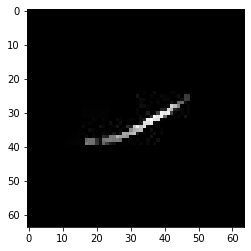

confidence for 13743 is 0.9998371


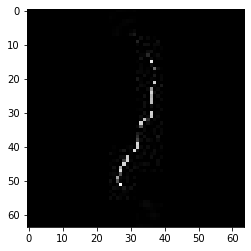

confidence for 13749 is 0.90787965


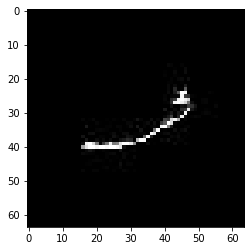

confidence for 13753 is 0.96778184


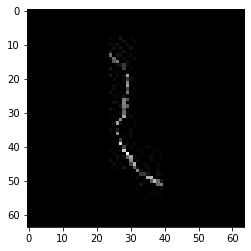

confidence for 13754 is 0.999904


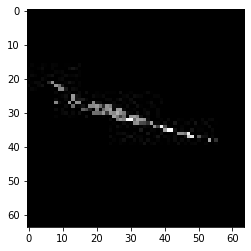

confidence for 13772 is 0.9970621


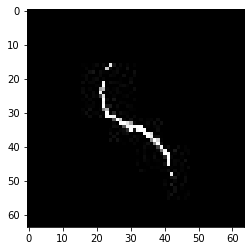

confidence for 13773 is 0.9991007


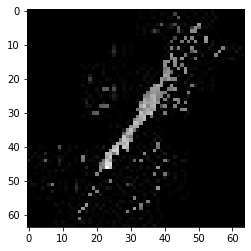

confidence for 13781 is 0.99743915


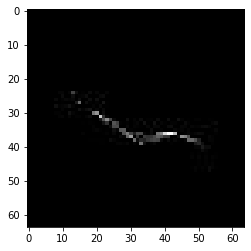

confidence for 13801 is 0.8923093


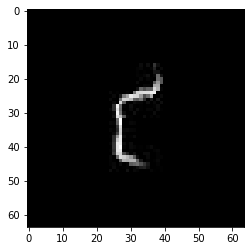

confidence for 13804 is 0.9999876


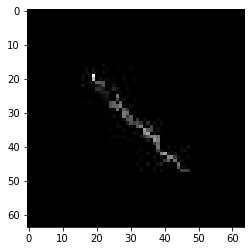

confidence for 13809 is 0.9046814


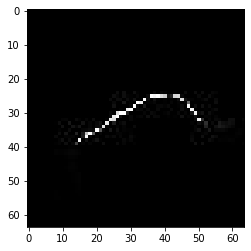

confidence for 13810 is 0.98822206


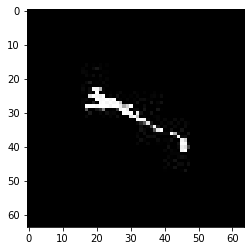

confidence for 13836 is 0.9461885


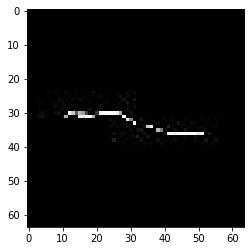

confidence for 13837 is 0.9972881


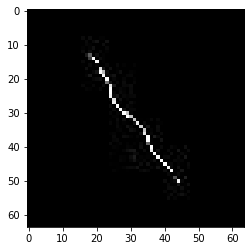

confidence for 13838 is 0.99803644


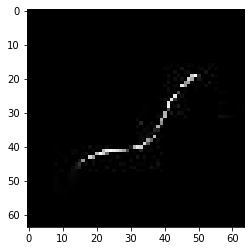

confidence for 13847 is 0.9841668


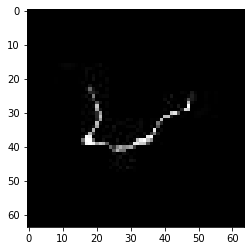

confidence for 13848 is 0.8428046


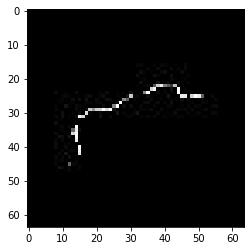

confidence for 13851 is 0.8881326


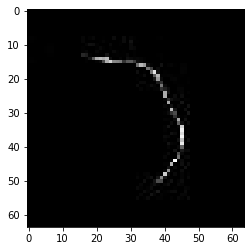

confidence for 13855 is 0.9801763


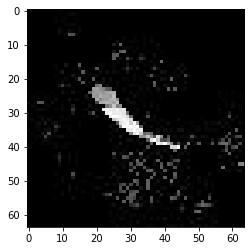

confidence for 13861 is 0.9807563


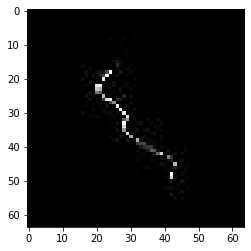

confidence for 13874 is 0.99561316


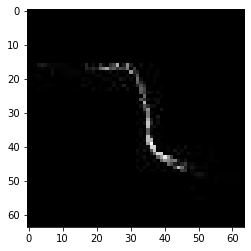

confidence for 13883 is 0.9927118


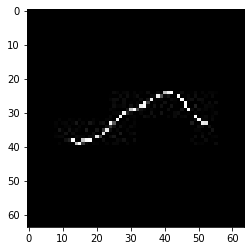

confidence for 13895 is 0.99996454


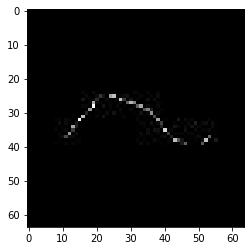

confidence for 13916 is 0.9118114


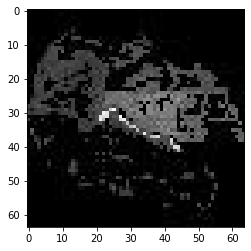

confidence for 13920 is 0.96983254


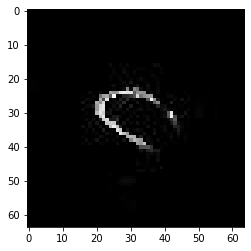

confidence for 13957 is 1.0


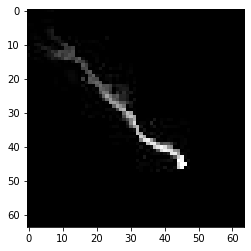

confidence for 13960 is 0.9599266


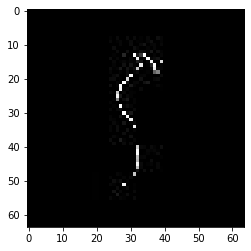

confidence for 13970 is 0.9992748


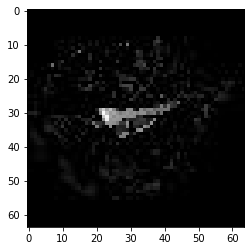

confidence for 13985 is 0.99850965


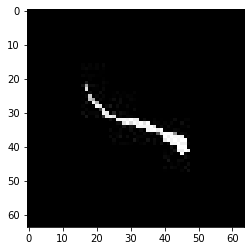

confidence for 14027 is 0.9281955


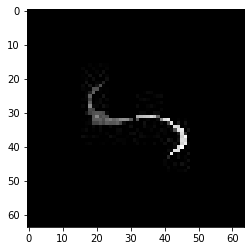

confidence for 14029 is 0.9817526


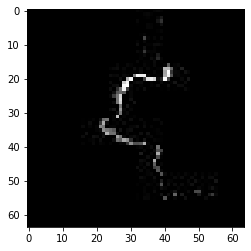

confidence for 14032 is 0.974513


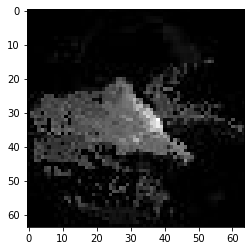

confidence for 14042 is 0.99994326


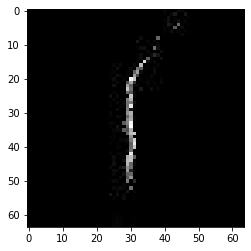

confidence for 14046 is 0.9999986


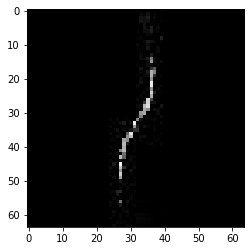

confidence for 14068 is 0.8118449


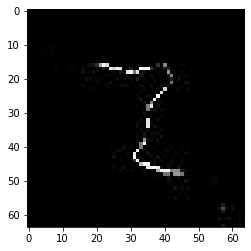

confidence for 14074 is 0.98679847


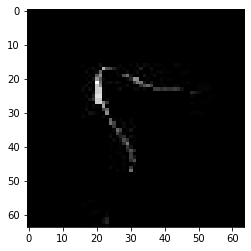

confidence for 14091 is 0.9773869


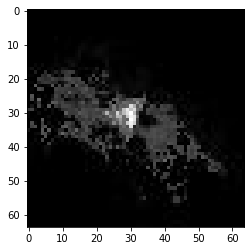

confidence for 14092 is 0.9576095


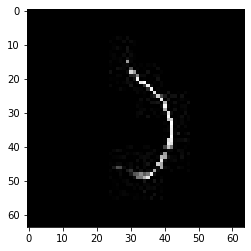

confidence for 14110 is 0.80189073


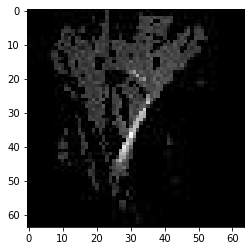

confidence for 14111 is 0.8657534


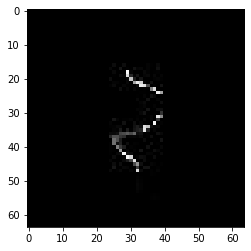

confidence for 14118 is 0.9524998


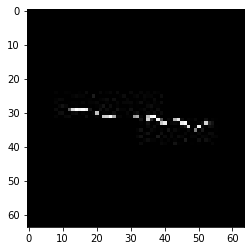

confidence for 14120 is 0.92048943


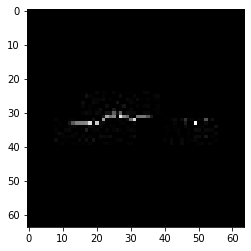

confidence for 14142 is 0.9979942


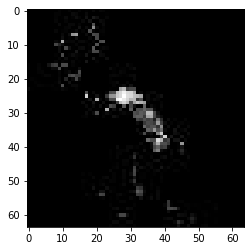

confidence for 14145 is 0.9939201


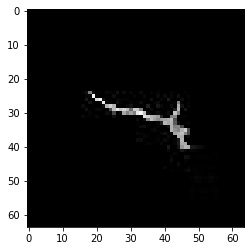

confidence for 14146 is 0.8517965


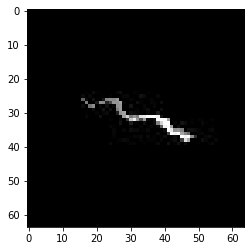

confidence for 14147 is 0.91993046


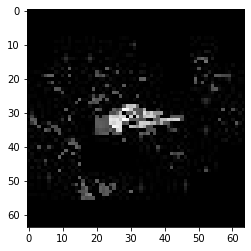

confidence for 14152 is 0.89475566


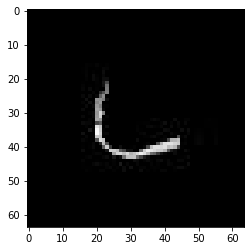

confidence for 14159 is 0.89481515


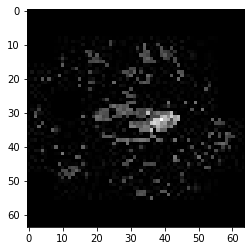

confidence for 14170 is 0.9203915


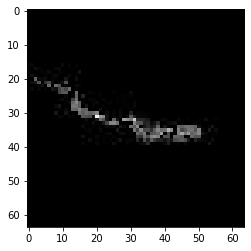

confidence for 14172 is 0.9999892


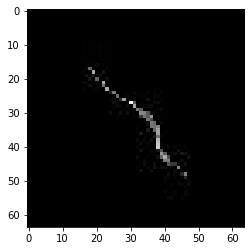

confidence for 14176 is 0.93481517


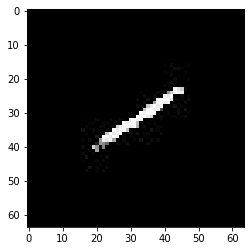

confidence for 14201 is 0.99994785


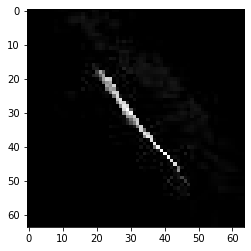

confidence for 14207 is 0.9998349


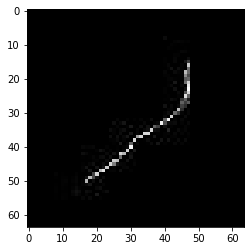

confidence for 14237 is 0.9999415


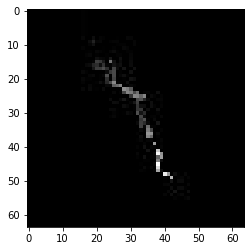

confidence for 14280 is 0.99968845


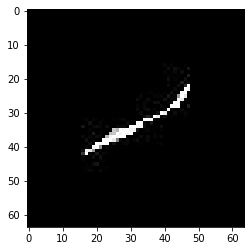

confidence for 14290 is 0.9835673


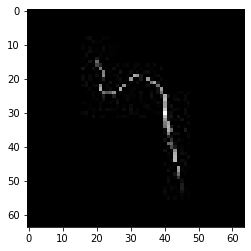

confidence for 14295 is 0.83733124


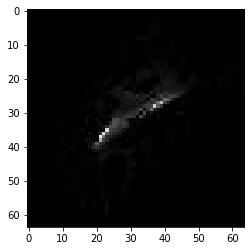

confidence for 14296 is 0.9752863


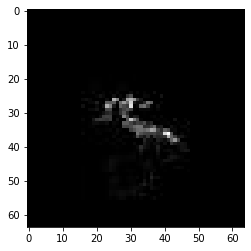

confidence for 14300 is 0.9881784


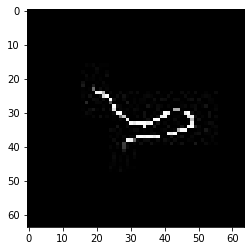

confidence for 14303 is 0.99997896


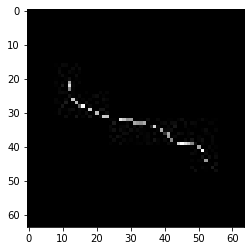

confidence for 14304 is 0.8525283


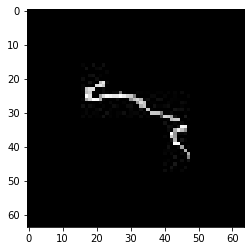

confidence for 14312 is 0.99999833


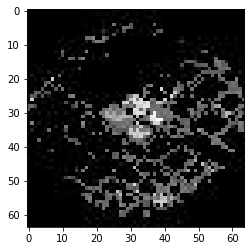

confidence for 14326 is 0.9211847


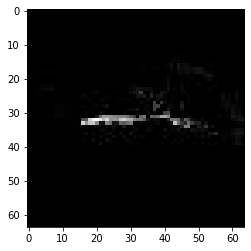

confidence for 14329 is 0.99786425


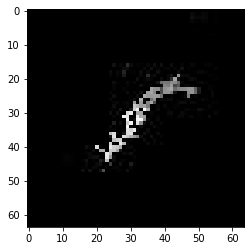

confidence for 14333 is 0.9327204


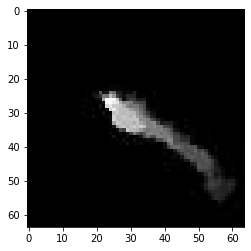

confidence for 14335 is 0.80182284


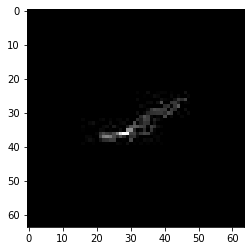

confidence for 14337 is 0.99728


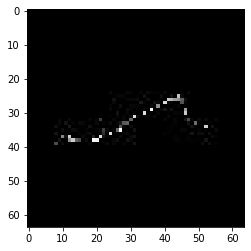

confidence for 14338 is 0.93532676


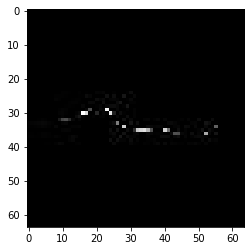

confidence for 14343 is 0.8487292


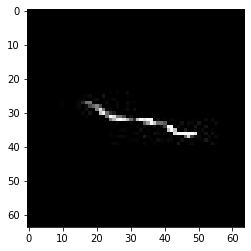

confidence for 14344 is 0.82295895


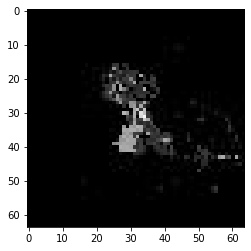

confidence for 14358 is 0.9764079


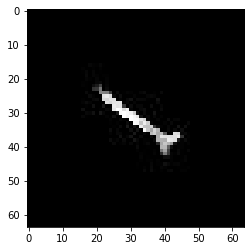

confidence for 14370 is 0.9978242


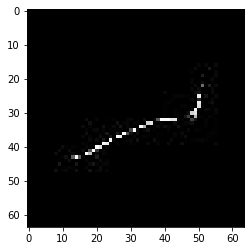

confidence for 14376 is 0.97547764


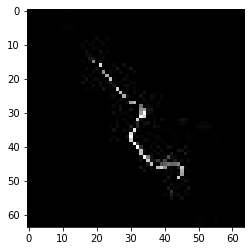

confidence for 14385 is 0.9889719


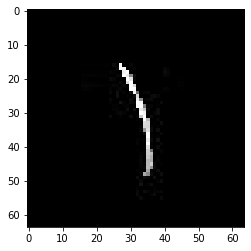

confidence for 14399 is 0.91843647


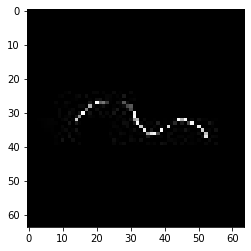

confidence for 14404 is 0.9837026


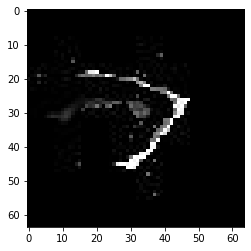

confidence for 14406 is 0.8140924


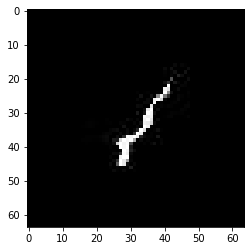

confidence for 14410 is 0.9961145


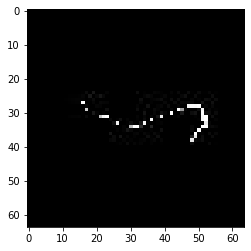

confidence for 14413 is 0.9403523


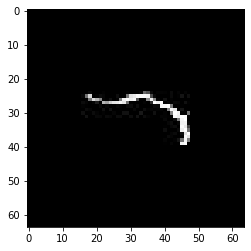

confidence for 14418 is 0.951029


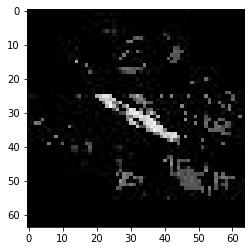

confidence for 14426 is 0.9930561


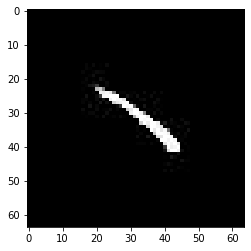

confidence for 14439 is 0.9999813


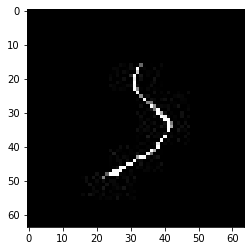

confidence for 14442 is 0.99968517


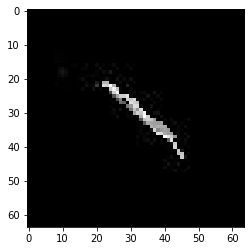

confidence for 14460 is 0.99998486


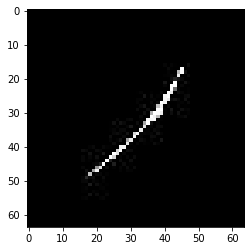

confidence for 14470 is 0.99998486


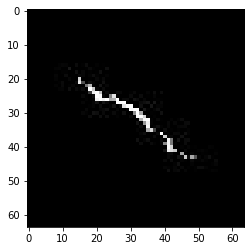

confidence for 14476 is 0.99241316


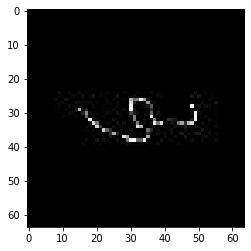

confidence for 14486 is 0.9541395


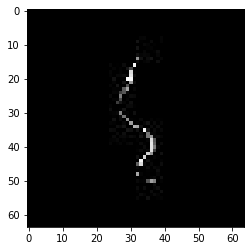

confidence for 14492 is 0.9936509


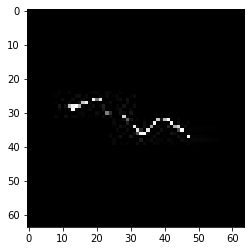

confidence for 14495 is 0.97786844


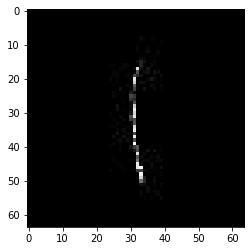

confidence for 14500 is 0.9999674


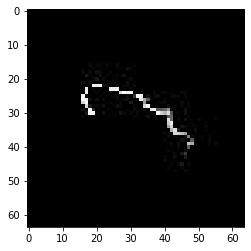

confidence for 14513 is 0.96548265


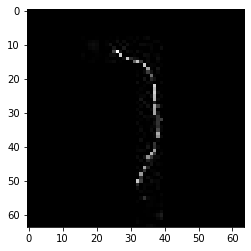

confidence for 14517 is 0.999591


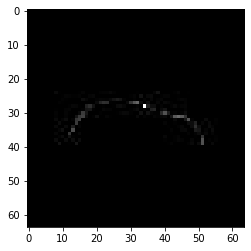

confidence for 14519 is 0.9241833


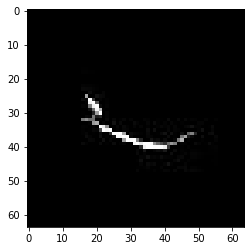

confidence for 14523 is 0.99846387


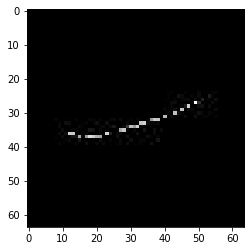

confidence for 14528 is 0.96523213


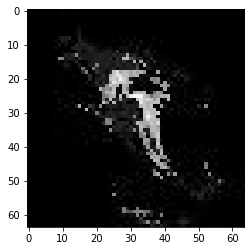

confidence for 14538 is 0.86177015


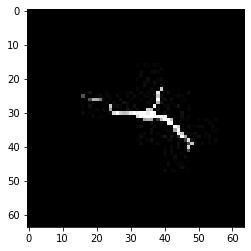

confidence for 14542 is 0.99673975


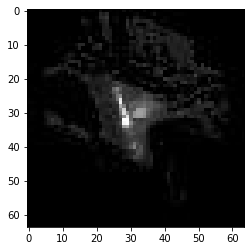

confidence for 14545 is 0.9663163


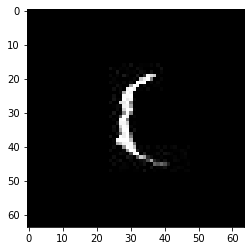

confidence for 14551 is 0.99934185


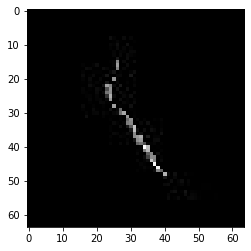

confidence for 14557 is 0.87658983


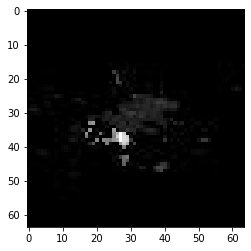

confidence for 14567 is 0.90374434


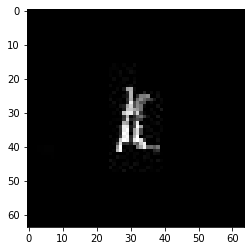

confidence for 14579 is 0.99997586


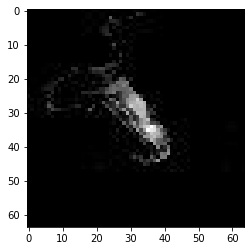

confidence for 14586 is 0.99498904


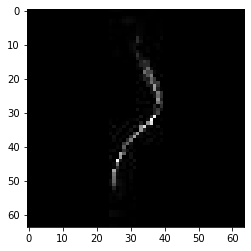

confidence for 14588 is 0.95980877


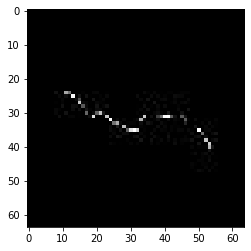

confidence for 14591 is 0.84742826


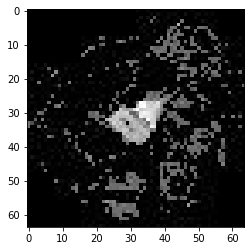

confidence for 14601 is 0.99957466


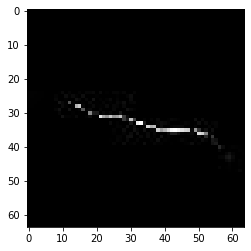

confidence for 14607 is 0.99978703


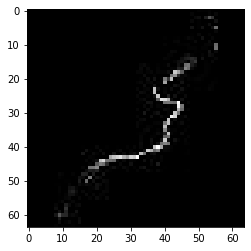

confidence for 14620 is 0.992747


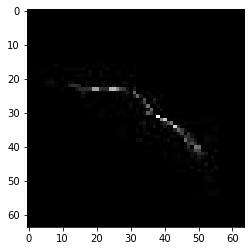

confidence for 14622 is 0.88817286


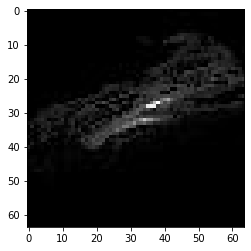

confidence for 14624 is 0.8611926


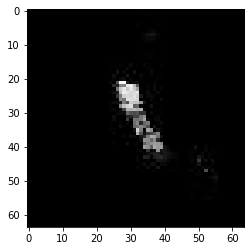

confidence for 14626 is 0.80676866


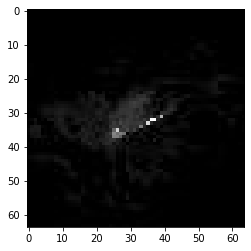

confidence for 14628 is 0.8607398


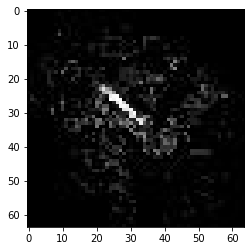

confidence for 14639 is 0.93408203


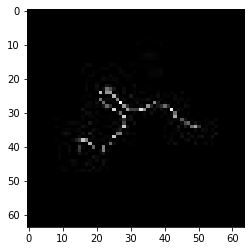

confidence for 14649 is 0.99996704


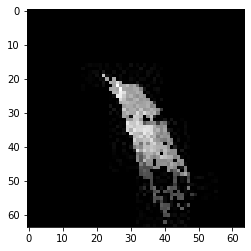

confidence for 14653 is 0.9946753


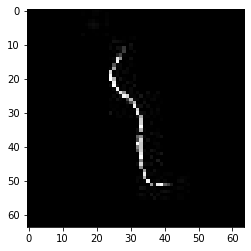

confidence for 14654 is 0.9804047


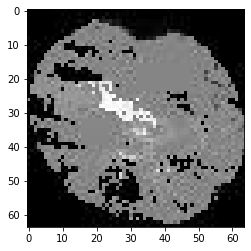

confidence for 14656 is 0.9978948


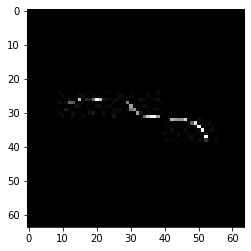

confidence for 14661 is 0.949327


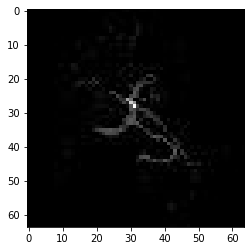

confidence for 14670 is 0.97617245


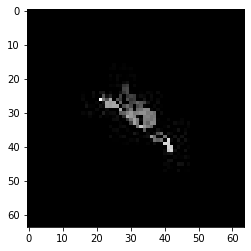

confidence for 14674 is 0.99292344


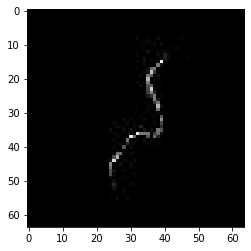

confidence for 14680 is 0.9992461


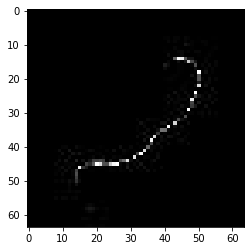

confidence for 14681 is 0.928453


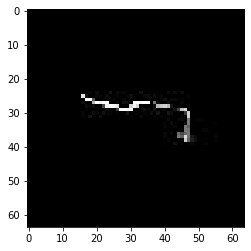

confidence for 14709 is 0.9999948


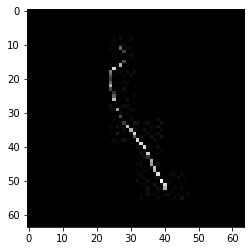

confidence for 14721 is 0.99107534


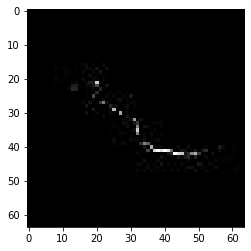

confidence for 14728 is 0.99563056


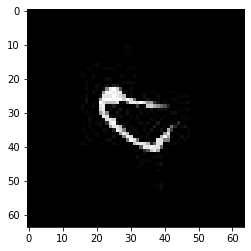

confidence for 14732 is 0.9997178


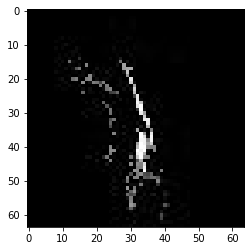

confidence for 14734 is 0.99901956


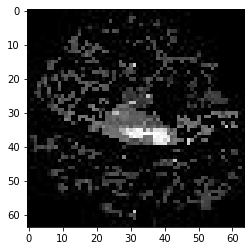

confidence for 14742 is 0.9239283


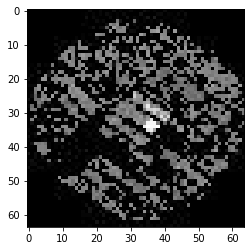

confidence for 14752 is 0.9050319


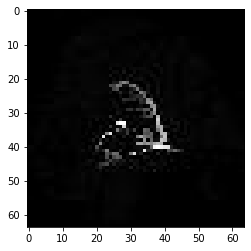

confidence for 14755 is 0.9992098


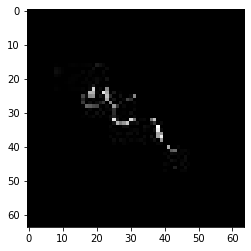

confidence for 14761 is 0.9461839


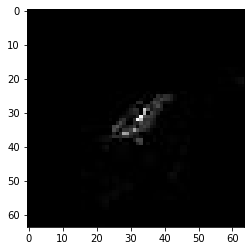

confidence for 14765 is 0.9895118


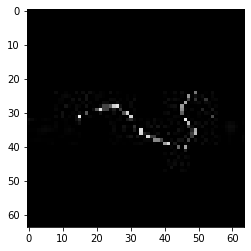

confidence for 14777 is 0.9927057


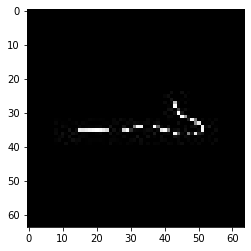

confidence for 14782 is 0.99993837


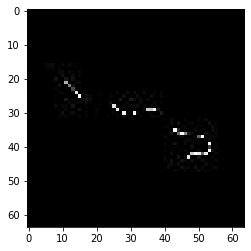

confidence for 14790 is 0.9999226


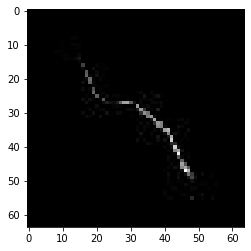

confidence for 14793 is 0.998662


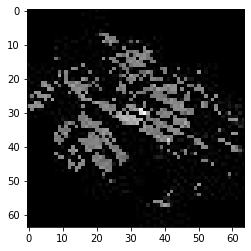

confidence for 14794 is 0.9974807


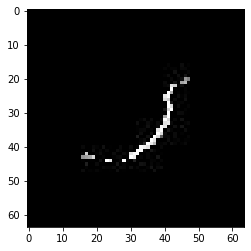

confidence for 14795 is 0.9699706


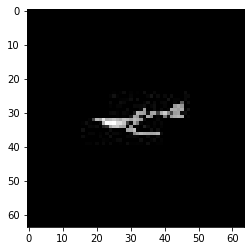

confidence for 14796 is 0.9703938


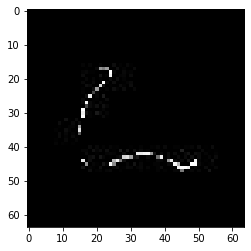

confidence for 14799 is 0.99989295


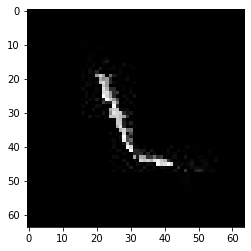

confidence for 14803 is 0.9496372


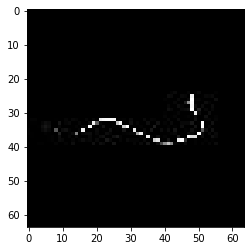

confidence for 14804 is 0.99887294


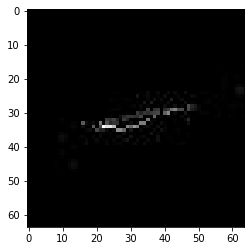

confidence for 14814 is 0.9892538


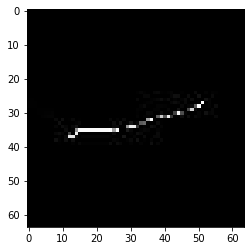

confidence for 14815 is 0.99892026


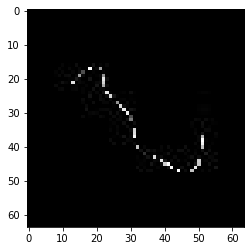

confidence for 14816 is 0.9893176


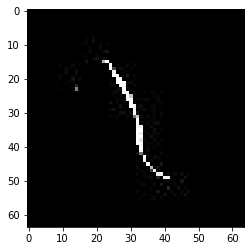

confidence for 14820 is 0.99668354


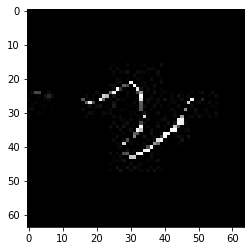

confidence for 14822 is 0.8737349


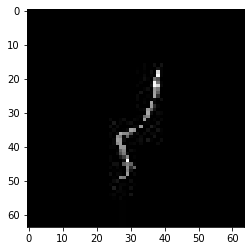

confidence for 14823 is 0.9999108


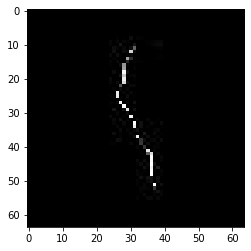

confidence for 14831 is 0.9996776


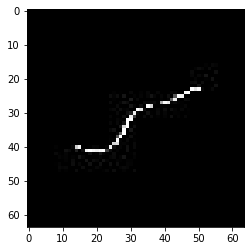

confidence for 14834 is 0.9752633


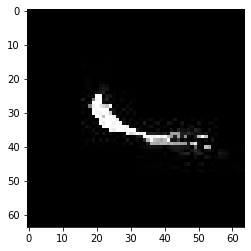

confidence for 14844 is 0.9456578


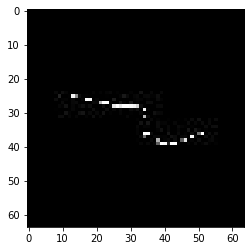

confidence for 14854 is 0.99880624


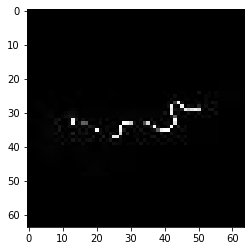

confidence for 14859 is 0.99737495


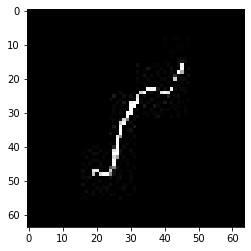

confidence for 14862 is 0.9983403


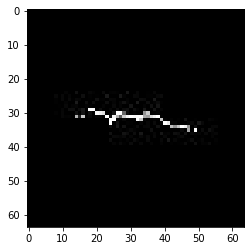

confidence for 14863 is 0.8508837


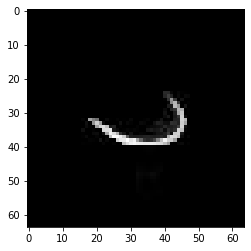

confidence for 14864 is 0.9991697


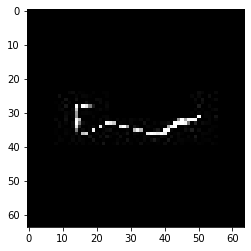

confidence for 14867 is 0.999741


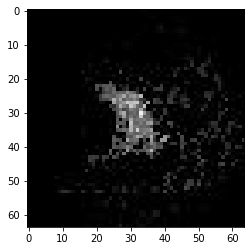

confidence for 14871 is 0.87784153


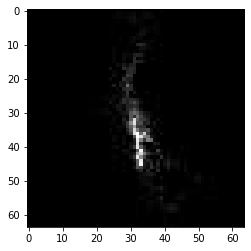

confidence for 14873 is 0.9728561


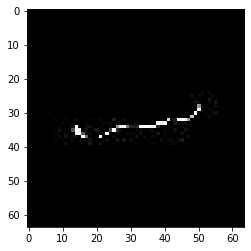

confidence for 14876 is 0.99905854


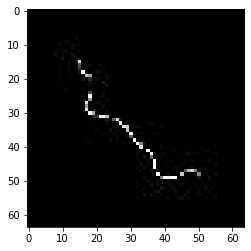

confidence for 14881 is 0.9735724


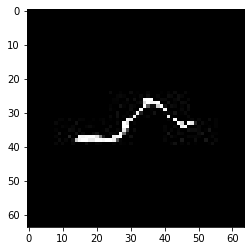

confidence for 14882 is 0.95493335


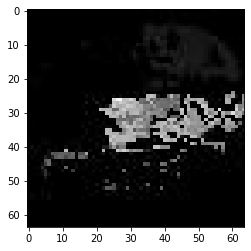

confidence for 14883 is 0.9783776


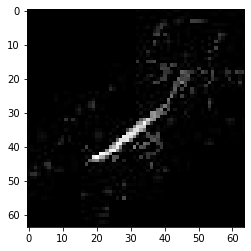

confidence for 14886 is 0.97384995


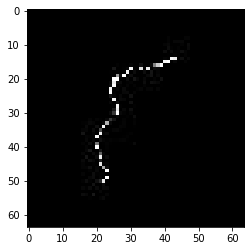

confidence for 14889 is 0.8766789


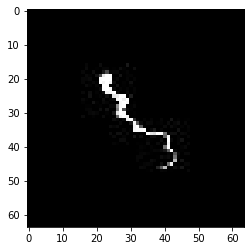

confidence for 14891 is 0.99088764


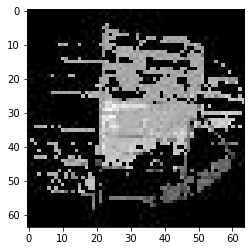

confidence for 14892 is 0.9760247


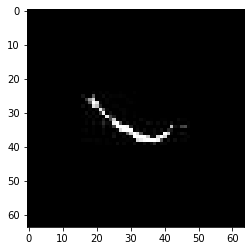

confidence for 14894 is 0.9405789


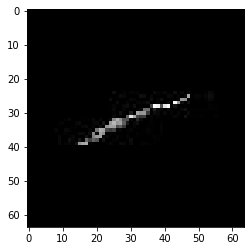

confidence for 14896 is 0.9901301


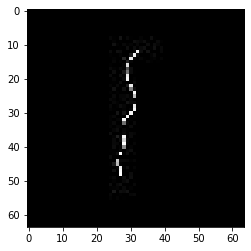

confidence for 14901 is 0.9860483


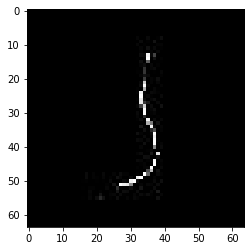

confidence for 14905 is 0.9901579


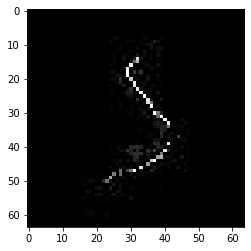

confidence for 14906 is 0.9226647


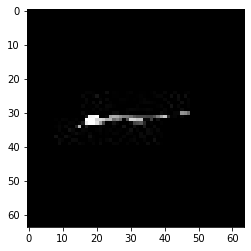

confidence for 14908 is 0.8575906


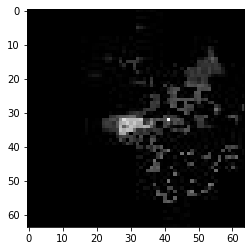

confidence for 14909 is 0.9866252


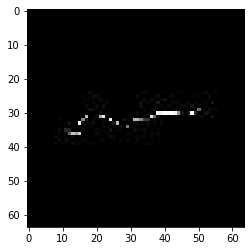

confidence for 14916 is 0.99855644


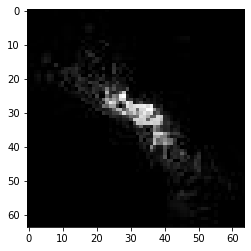

confidence for 14919 is 0.8352897


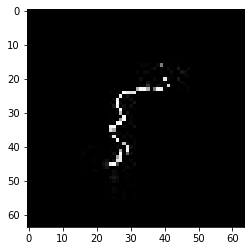

confidence for 14921 is 0.9998403


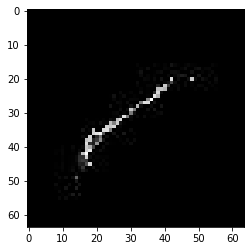

confidence for 14922 is 0.9999535


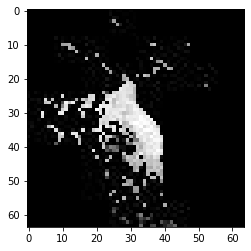

confidence for 14923 is 0.9903253


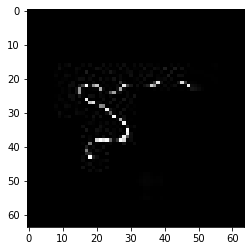

confidence for 14928 is 0.999658


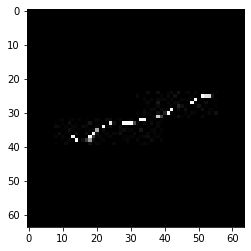

confidence for 14929 is 0.95829254


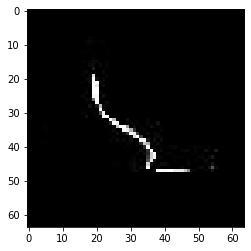

confidence for 14933 is 0.96860975


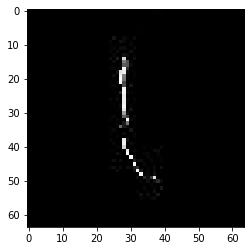

confidence for 14934 is 0.8461363


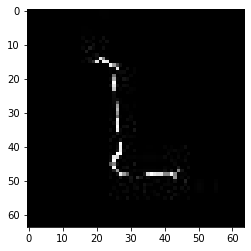

confidence for 14935 is 0.89315695


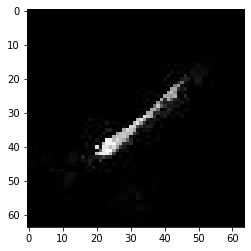

confidence for 14951 is 0.82249516


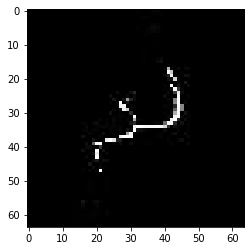

confidence for 14959 is 0.9703283


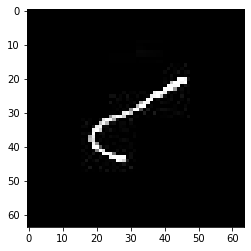

confidence for 14963 is 1.0


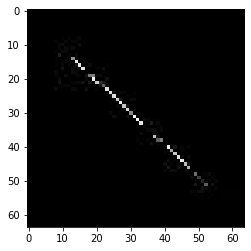

confidence for 14965 is 0.99998933


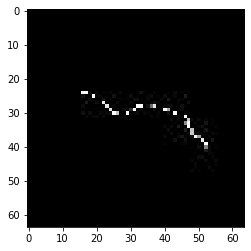

confidence for 14967 is 0.97482157


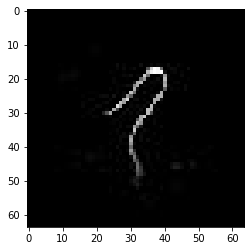

confidence for 14968 is 0.9999072


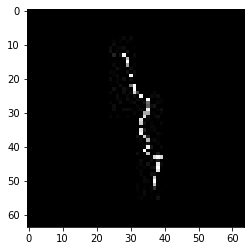

confidence for 14970 is 0.9776334


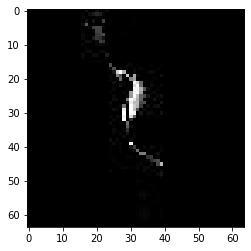

confidence for 14973 is 0.9989001


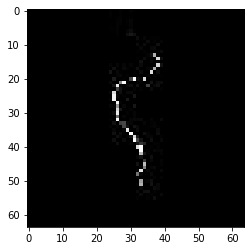

confidence for 14975 is 0.98584056


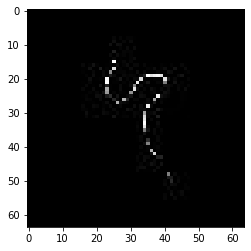

confidence for 14981 is 0.9997358


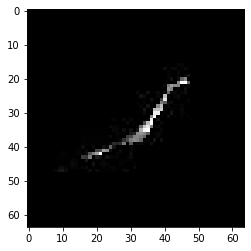

confidence for 14982 is 0.99450254


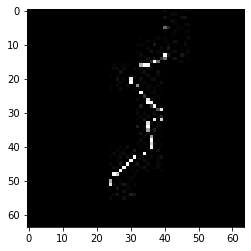

confidence for 14983 is 0.9989526


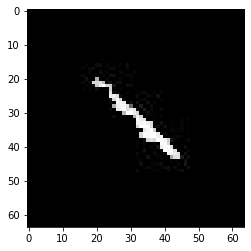

confidence for 14985 is 0.99934393


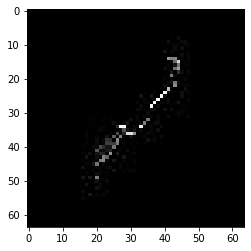

confidence for 14993 is 0.90728265


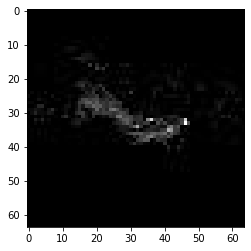

confidence for 14996 is 0.8769847


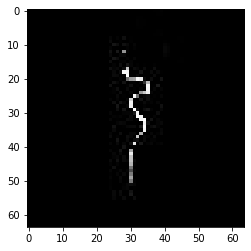

confidence for 14999 is 0.9971387


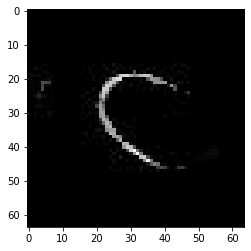

confidence for 15003 is 0.98959476


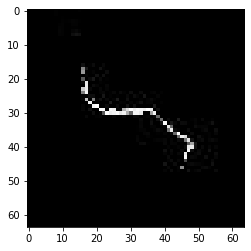

confidence for 15004 is 0.9999994


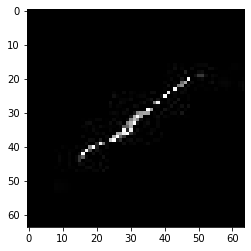

confidence for 15009 is 0.8958974


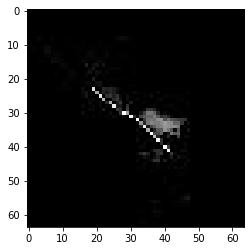

confidence for 15014 is 0.97474486


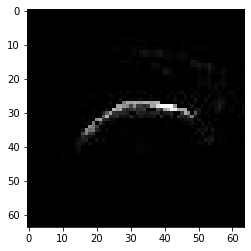

confidence for 15018 is 0.9966664


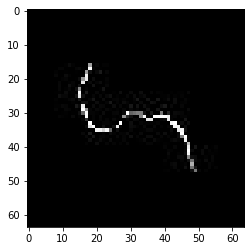

confidence for 15041 is 0.9983581


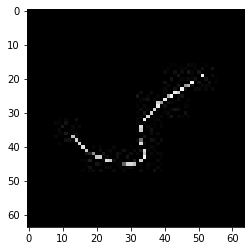

confidence for 15042 is 0.99961096


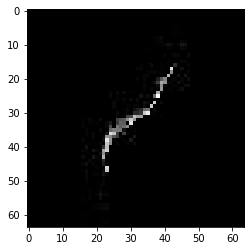

confidence for 15053 is 0.9991265


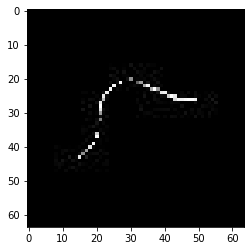

confidence for 15068 is 0.93090135


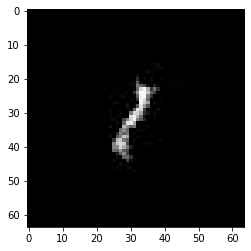

confidence for 15070 is 0.97228056


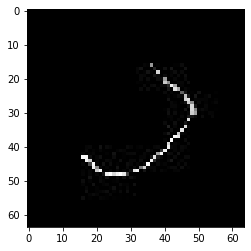

confidence for 15073 is 0.9999512


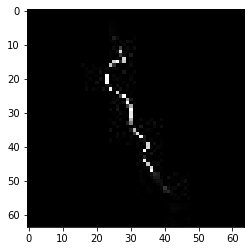

confidence for 15077 is 0.8318255


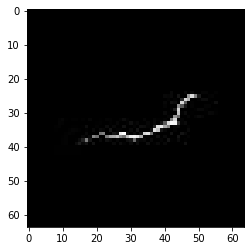

confidence for 15081 is 0.99008095


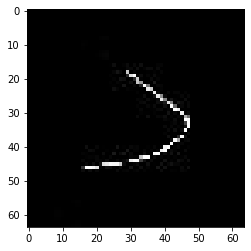

confidence for 15086 is 0.99819314


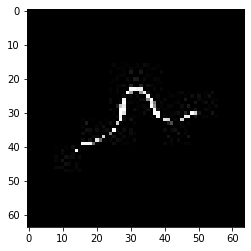

confidence for 15087 is 0.9999967


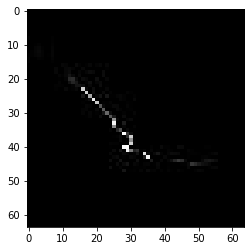

confidence for 15090 is 0.9663976


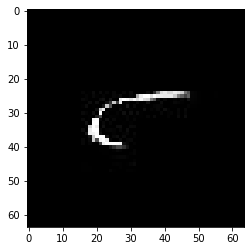

confidence for 15092 is 0.9999866


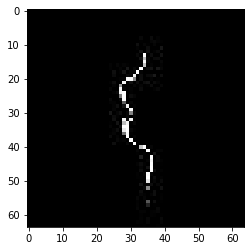

confidence for 15096 is 0.99937755


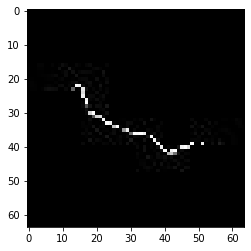

confidence for 15104 is 0.99992543


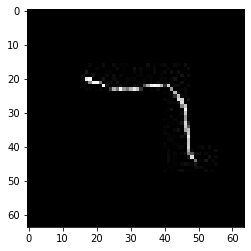

confidence for 15106 is 0.90870535


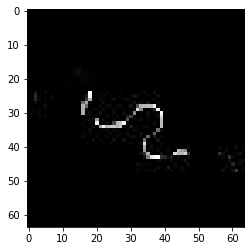

confidence for 15108 is 0.9996116


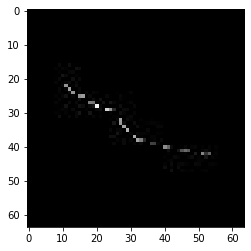

confidence for 15112 is 0.99978995


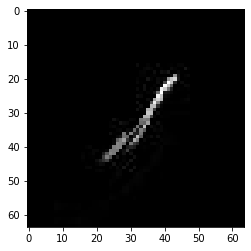

confidence for 15119 is 0.9898799


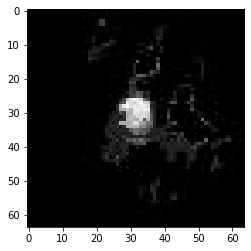

confidence for 15124 is 0.9999314


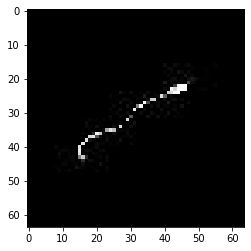

confidence for 15125 is 0.99671227


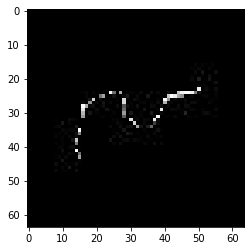

confidence for 15126 is 0.9747662


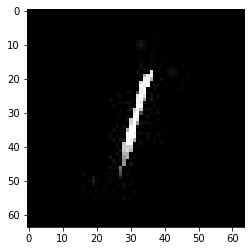

confidence for 15128 is 0.9999479


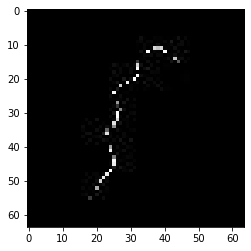

confidence for 15130 is 0.99998087


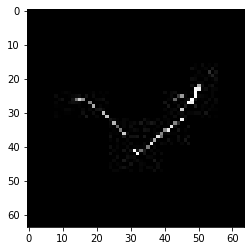

confidence for 15131 is 0.99963766


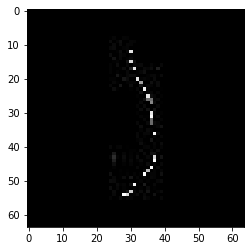

confidence for 15134 is 0.9733517


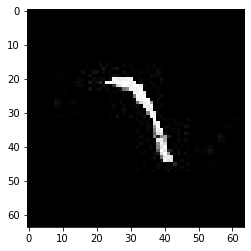

confidence for 15135 is 0.9600612


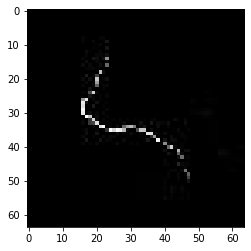

confidence for 15137 is 0.9846867


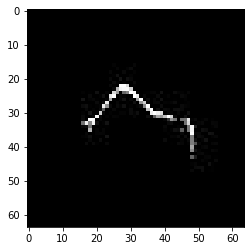

confidence for 15143 is 0.999717


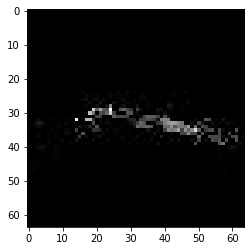

confidence for 15158 is 0.9929626


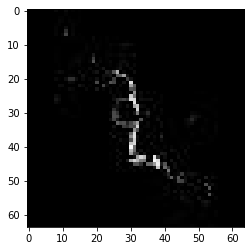

confidence for 15159 is 0.97811353


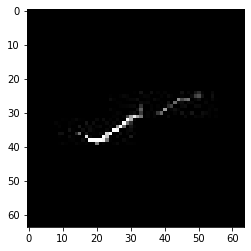

confidence for 15164 is 0.9999983


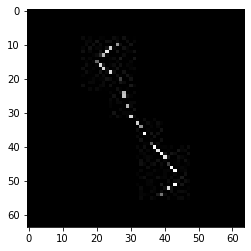

confidence for 15166 is 0.89741415


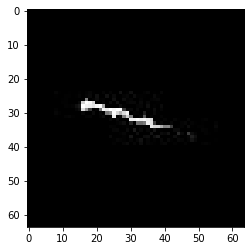

confidence for 15173 is 0.9896996


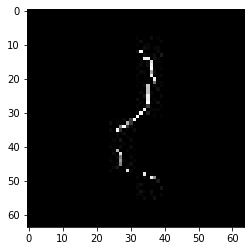

confidence for 15176 is 0.99995875


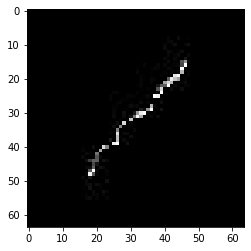

confidence for 15179 is 0.9973133


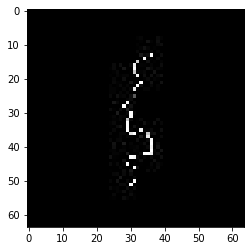

confidence for 15182 is 0.9934432


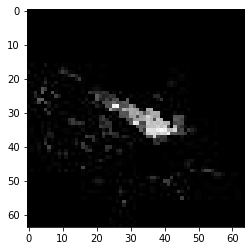

confidence for 15185 is 0.9999871


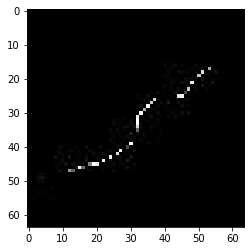

confidence for 15193 is 0.999994


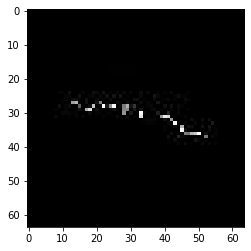

confidence for 15200 is 0.98599994


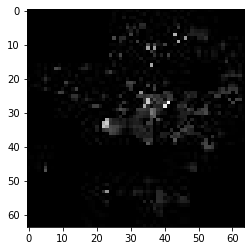

confidence for 15204 is 0.9994493


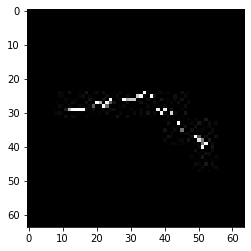

confidence for 15209 is 0.9995491


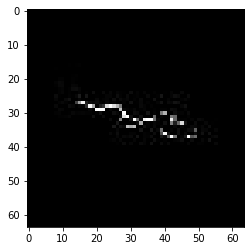

confidence for 15221 is 1.0


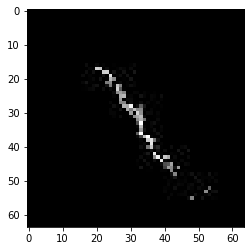

confidence for 15222 is 0.999822


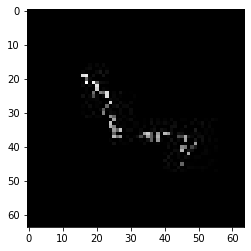

confidence for 15231 is 0.9953355


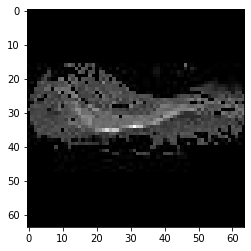

confidence for 15232 is 0.99156624


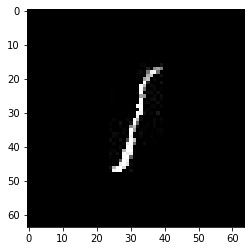

confidence for 15238 is 0.9955017


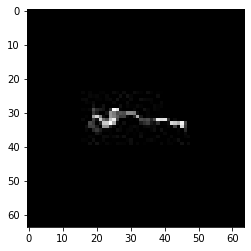

confidence for 15247 is 0.99355936


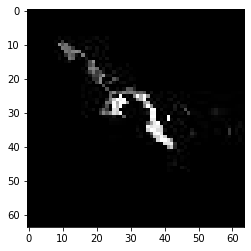

confidence for 15252 is 0.99966556


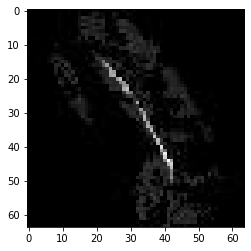

confidence for 15272 is 0.9806893


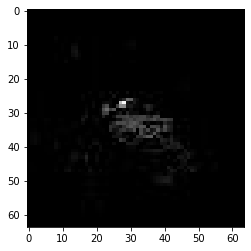

confidence for 15276 is 0.99834865


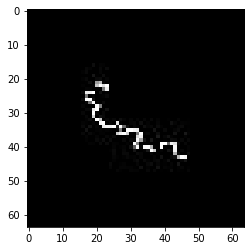

confidence for 15278 is 0.9963993


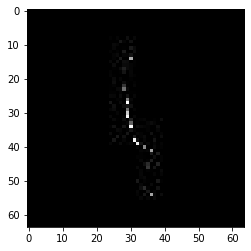

confidence for 15284 is 0.99999994


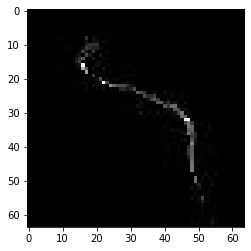

confidence for 15291 is 0.99999994


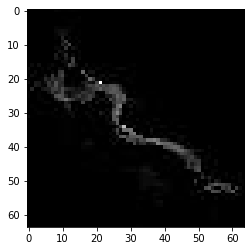

confidence for 15296 is 0.9972278


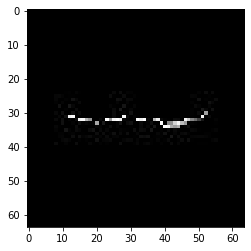

confidence for 15299 is 0.9169919


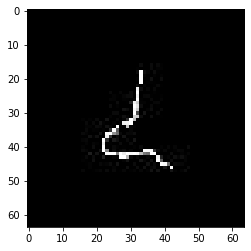

confidence for 15301 is 0.99943715


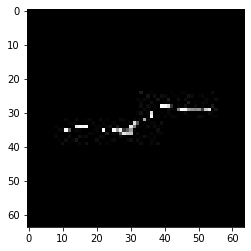

confidence for 15302 is 0.9996236


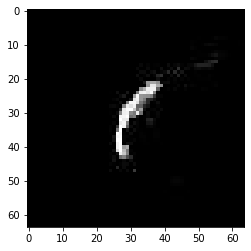

confidence for 15304 is 0.9998447


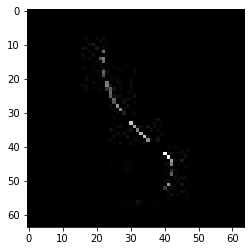

confidence for 15306 is 0.8215213


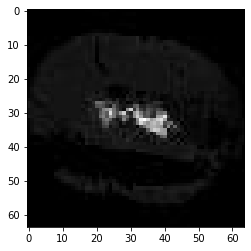

confidence for 15320 is 0.9804299


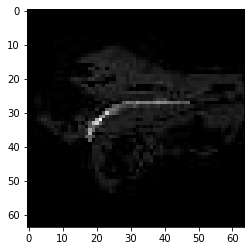

confidence for 15346 is 0.8960815


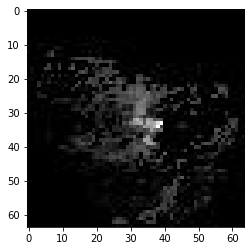

confidence for 15355 is 0.9998265


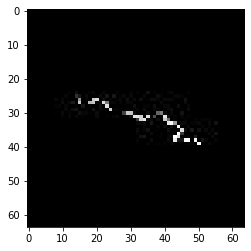

confidence for 15360 is 0.9959996


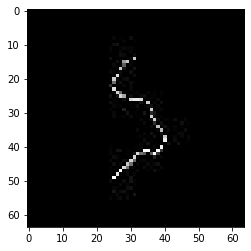

confidence for 15364 is 0.9051672


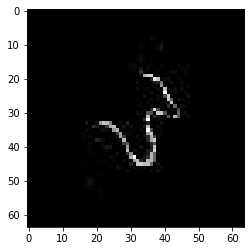

confidence for 15383 is 0.93450034


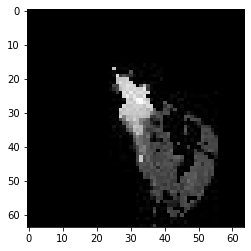

confidence for 15384 is 0.9999822


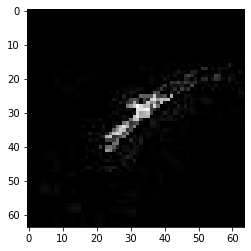

confidence for 15389 is 0.99805355


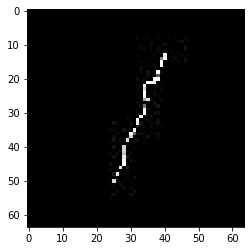

confidence for 15394 is 0.9999997


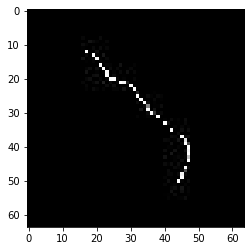

confidence for 15396 is 0.9812396


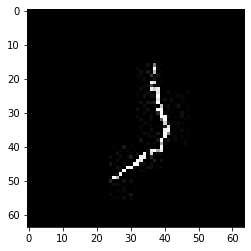

confidence for 15404 is 0.99896604


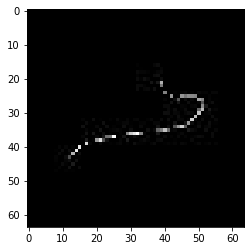

confidence for 15410 is 0.9877714


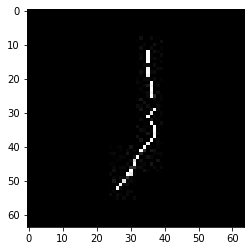

confidence for 15413 is 0.95947826


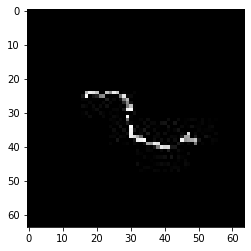

confidence for 15418 is 0.9999994


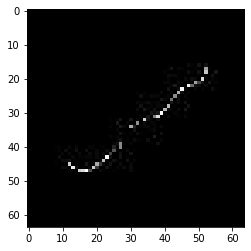

confidence for 15419 is 0.9281592


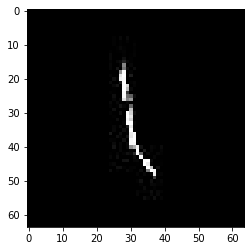

confidence for 15426 is 0.9419169


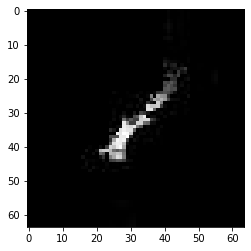

confidence for 15427 is 0.9442613


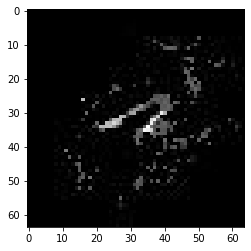

confidence for 15428 is 0.8835344


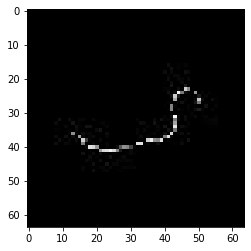

confidence for 15435 is 0.9960537


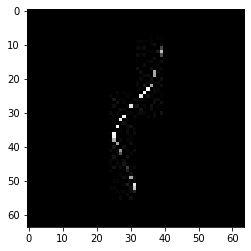

confidence for 15445 is 0.9977873


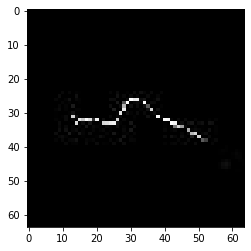

confidence for 15446 is 0.9991908


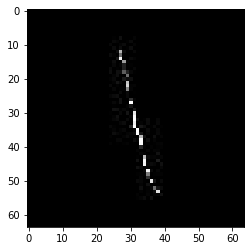

confidence for 15455 is 0.8537232


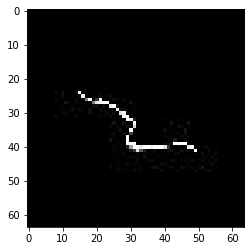

confidence for 15457 is 0.9999931


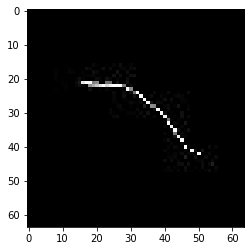

confidence for 15463 is 0.99992687


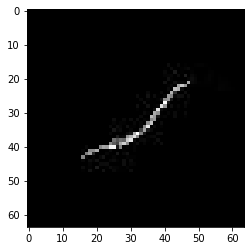

confidence for 15464 is 0.99999833


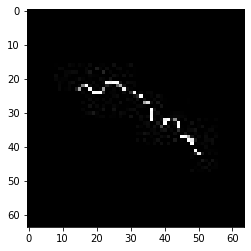

confidence for 15469 is 0.88981825


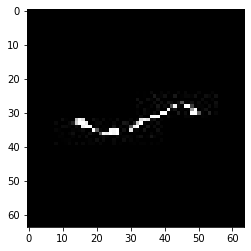

confidence for 15483 is 0.9999888


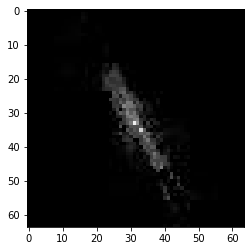

confidence for 15489 is 0.86167204


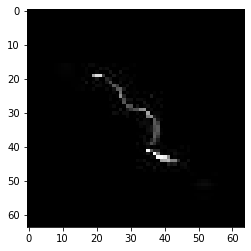

confidence for 15493 is 0.8173985


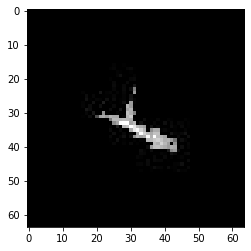

confidence for 15509 is 0.9938471


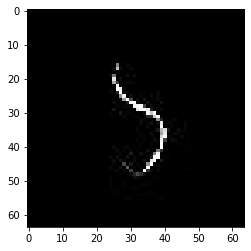

confidence for 15536 is 0.95446813


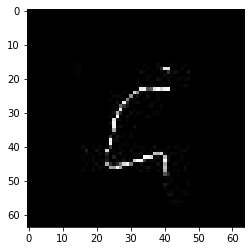

confidence for 15540 is 0.9851846


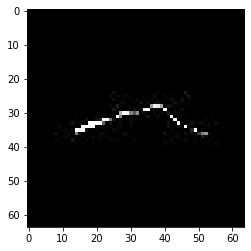

confidence for 15543 is 0.9128708


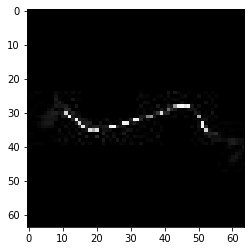

confidence for 15550 is 0.9988156


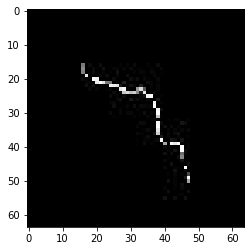

confidence for 15551 is 0.9998327


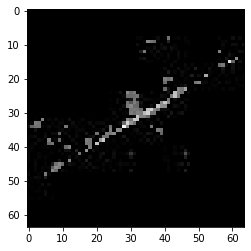

confidence for 15571 is 0.9989938


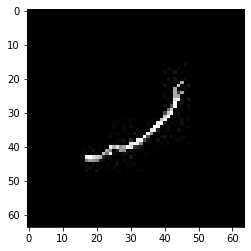

confidence for 15579 is 0.987385


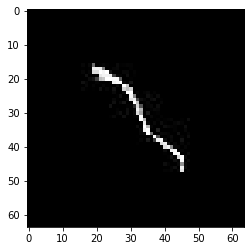

confidence for 15591 is 0.9822114


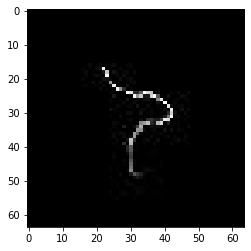

confidence for 15608 is 0.99998426


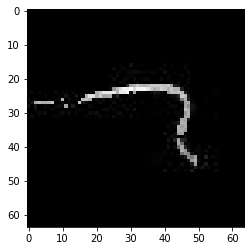

confidence for 15610 is 0.99999654


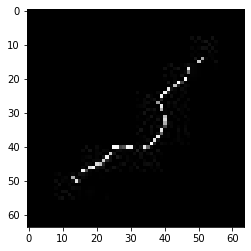

confidence for 15617 is 0.83269674


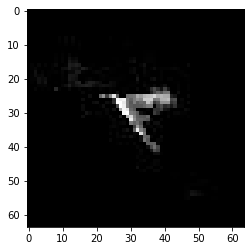

confidence for 15619 is 0.99994516


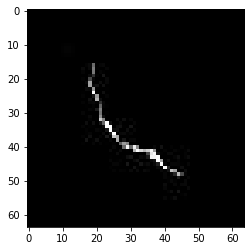

confidence for 15623 is 0.9930185


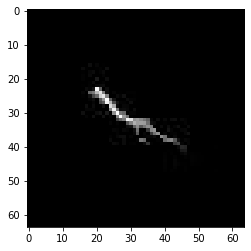

confidence for 15627 is 0.99959433


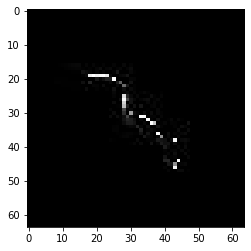

confidence for 15629 is 0.99930394


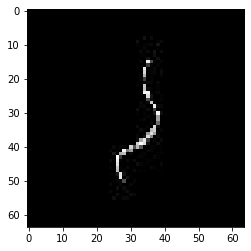

confidence for 15636 is 0.9928318


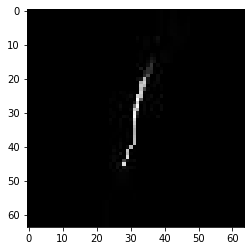

confidence for 15637 is 0.9981159


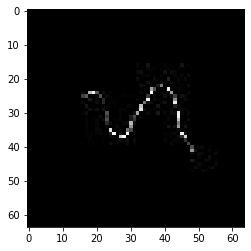

confidence for 15646 is 0.99999124


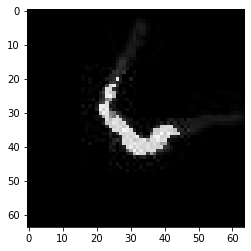

confidence for 15648 is 0.9831751


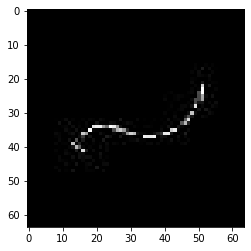

confidence for 15650 is 0.8839176


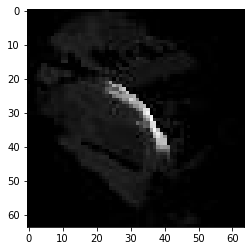

confidence for 15657 is 0.9999947


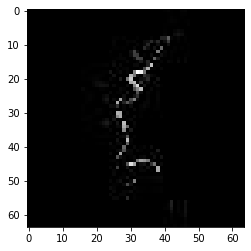

confidence for 15659 is 0.9999799


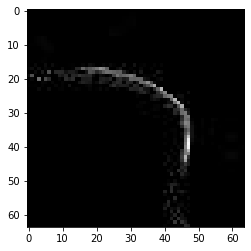

confidence for 15660 is 0.98225087


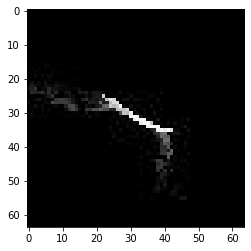

confidence for 15661 is 0.88849086


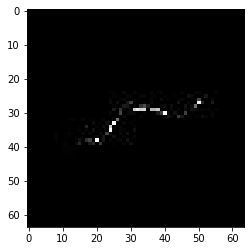

confidence for 15665 is 0.9176425


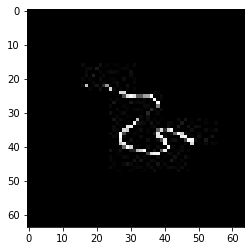

confidence for 15668 is 0.99836594


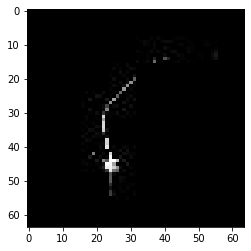

confidence for 15672 is 0.9947307


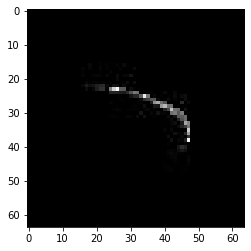

confidence for 15676 is 0.9842529


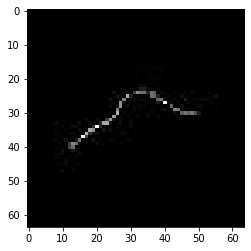

confidence for 15696 is 0.99307597


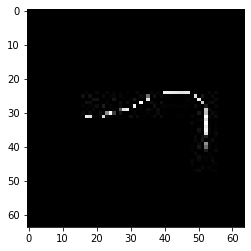

confidence for 15701 is 0.98648465


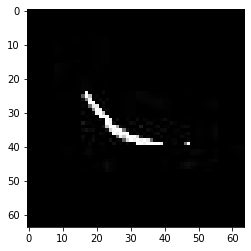

confidence for 15703 is 0.81390876


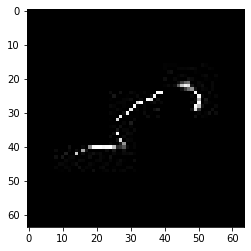

confidence for 15709 is 0.99465185


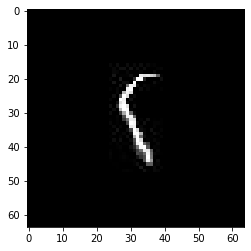

confidence for 15713 is 0.8277896


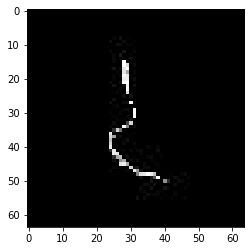

confidence for 15718 is 0.96738565


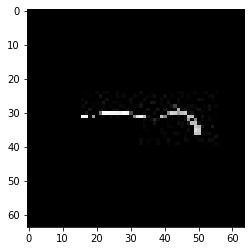

confidence for 15720 is 0.9971349


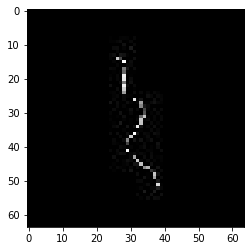

confidence for 15723 is 0.99998367


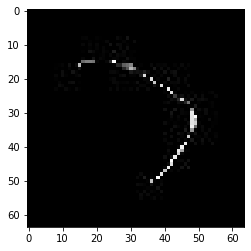

confidence for 15726 is 0.9941694


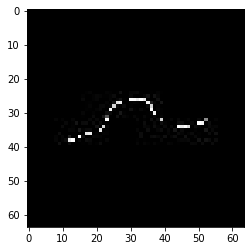

confidence for 15727 is 0.99661255


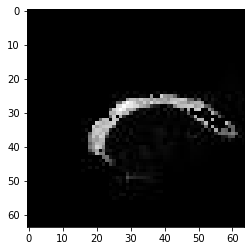

confidence for 15734 is 0.9986481


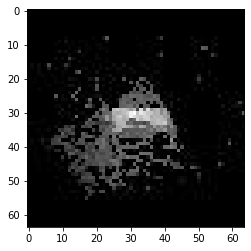

confidence for 15735 is 0.95738256


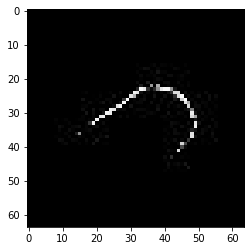

confidence for 15740 is 0.9999966


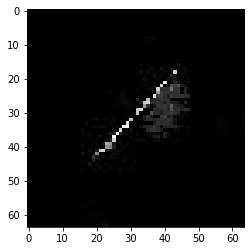

confidence for 15742 is 0.9891006


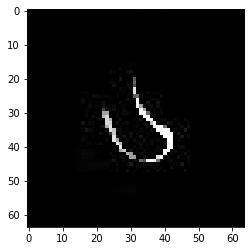

confidence for 15745 is 0.98701537


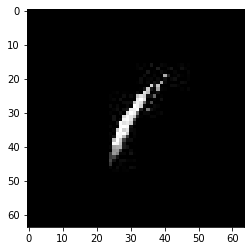

confidence for 15748 is 0.99574083


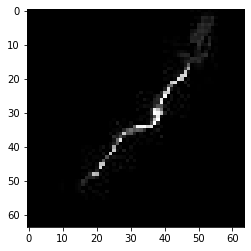

confidence for 15750 is 0.9726253


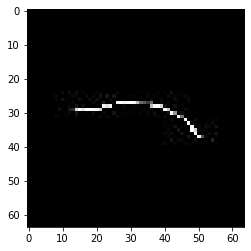

confidence for 15752 is 0.9982655


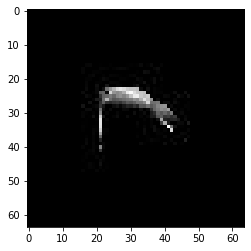

confidence for 15759 is 0.99171287


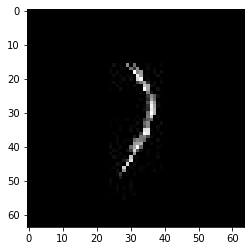

confidence for 15760 is 0.9999881


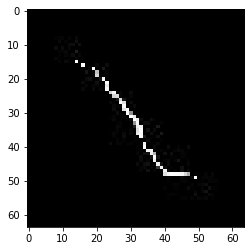

confidence for 15764 is 0.9715533


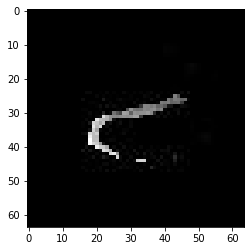

confidence for 15767 is 0.99639654


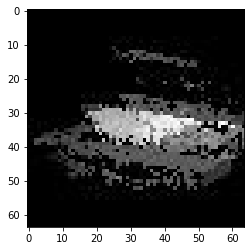

confidence for 15772 is 0.99999994


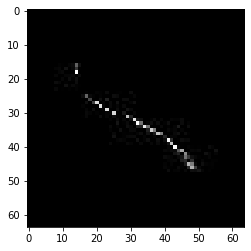

confidence for 15774 is 0.9848859


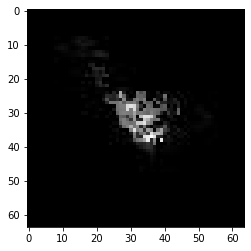

confidence for 15776 is 0.9863179


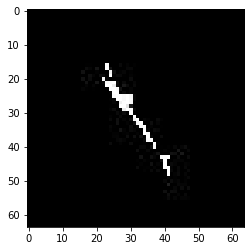

confidence for 15787 is 0.81017005


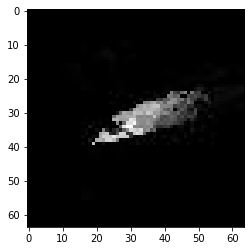

confidence for 15789 is 0.9999991


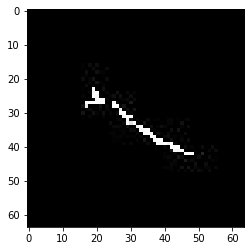

confidence for 15792 is 0.9845923


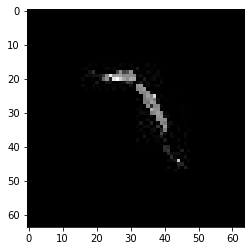

confidence for 15795 is 0.9574746


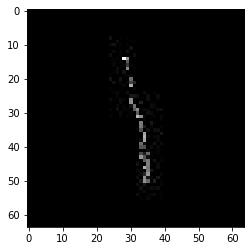

confidence for 15796 is 0.9993822


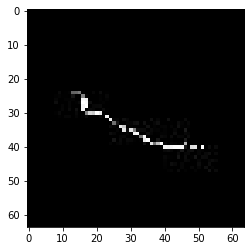

confidence for 15802 is 0.99997914


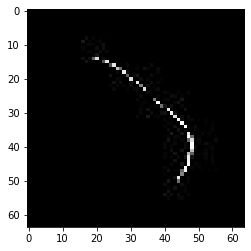

confidence for 15803 is 0.99700093


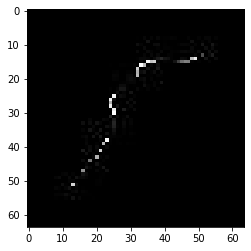

confidence for 15808 is 0.99952286


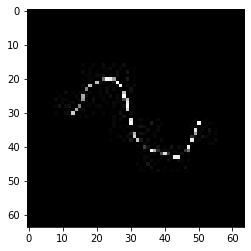

confidence for 15819 is 0.9992887


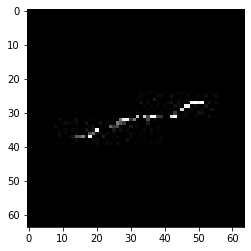

confidence for 15825 is 0.9963326


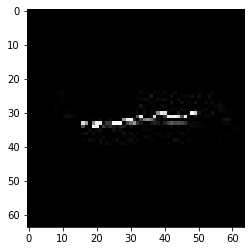

confidence for 15829 is 0.98319554


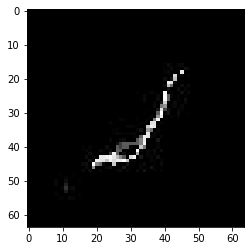

confidence for 15833 is 0.99999994


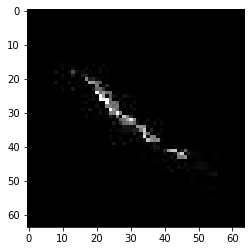

confidence for 15837 is 0.8766186


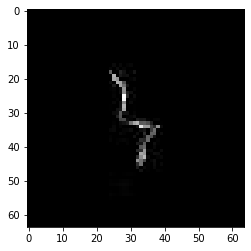

confidence for 15846 is 0.95973194


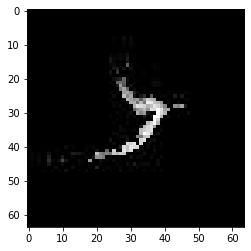

confidence for 15856 is 0.98831064


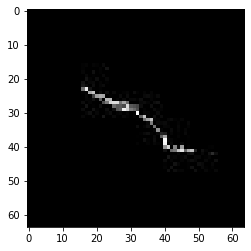

confidence for 15868 is 0.99999964


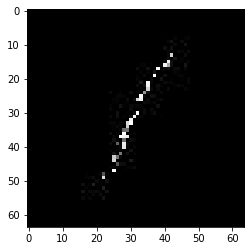

confidence for 15872 is 0.995764


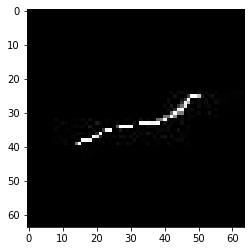

confidence for 15873 is 0.9630929


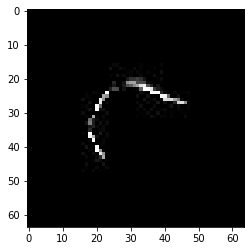

confidence for 15875 is 0.9815186


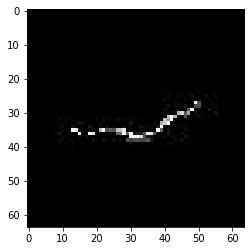

confidence for 15880 is 0.98346484


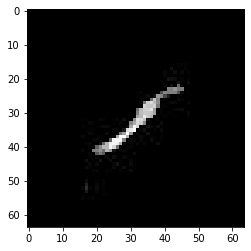

confidence for 15885 is 0.99993896


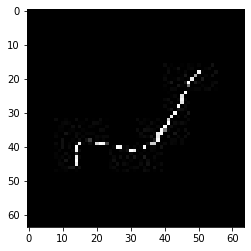

confidence for 15896 is 0.99999976


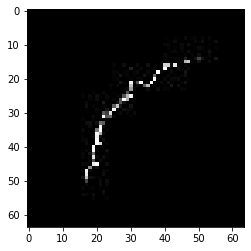

confidence for 15898 is 0.923912


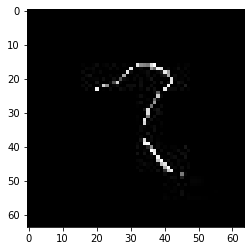

confidence for 15901 is 0.9999996


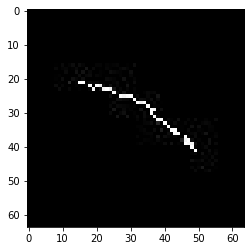

confidence for 15904 is 0.91771334


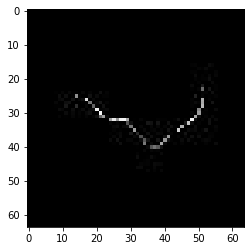

confidence for 15909 is 0.9994691


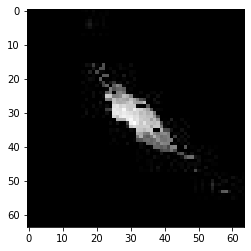

confidence for 15917 is 0.973557


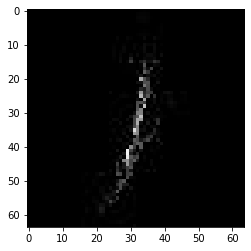

confidence for 15931 is 0.95255655


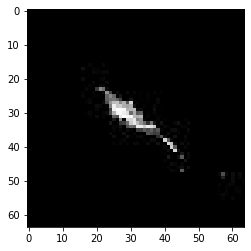

confidence for 15934 is 0.9990251


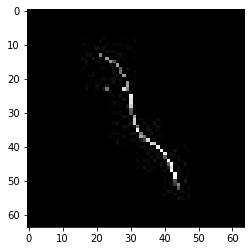

confidence for 15946 is 0.832388


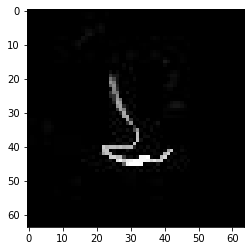

confidence for 15952 is 0.99954134


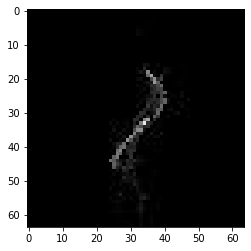

confidence for 15954 is 0.9999723


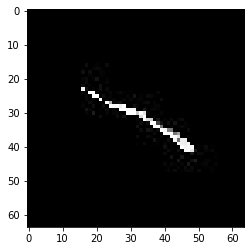

confidence for 15967 is 0.99242884


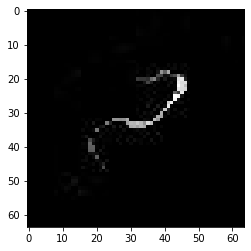

confidence for 15970 is 0.982701


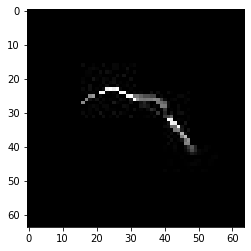

confidence for 15980 is 0.9493108


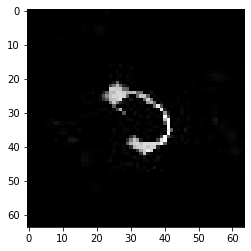

confidence for 15984 is 0.9999688


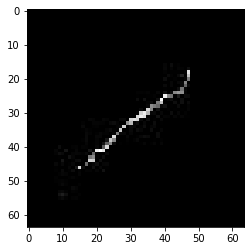

confidence for 15986 is 0.910947


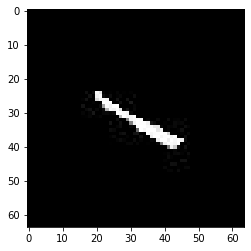

confidence for 15990 is 0.9080834


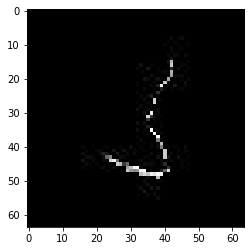

confidence for 15996 is 0.8870831


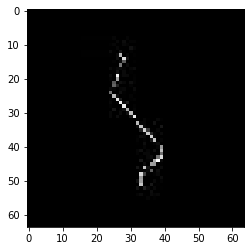

confidence for 15997 is 0.9677237


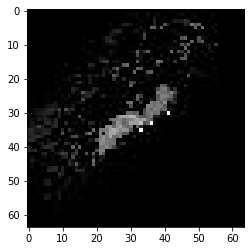

confidence for 16001 is 0.9057307


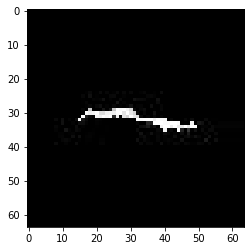

confidence for 16017 is 0.98620623


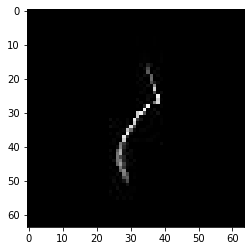

confidence for 16034 is 0.97087544


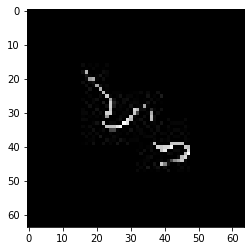

confidence for 16038 is 0.9685172


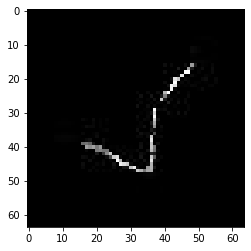

confidence for 16040 is 0.9443995


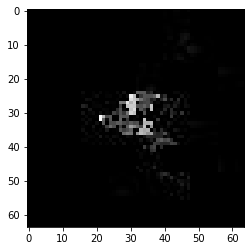

confidence for 16042 is 0.99872303


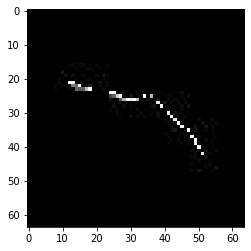

confidence for 16047 is 0.8470238


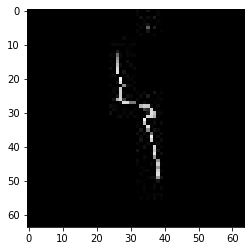

confidence for 16052 is 0.9993388


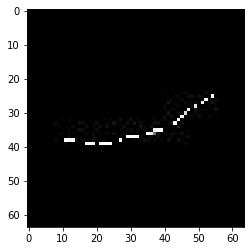

confidence for 16054 is 0.99999714


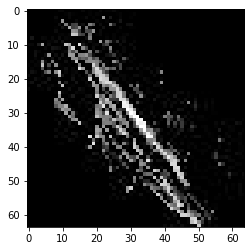

confidence for 16059 is 0.93069685


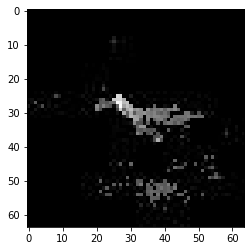

confidence for 16060 is 1.0


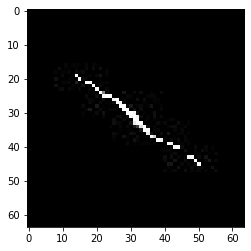

confidence for 16061 is 0.9999924


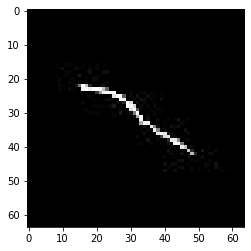

confidence for 16065 is 0.99994755


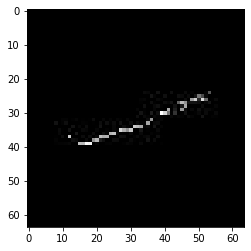

confidence for 16066 is 0.9636165


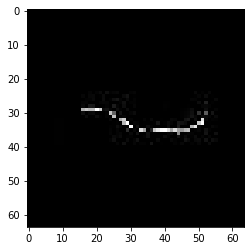

confidence for 16072 is 0.9858902


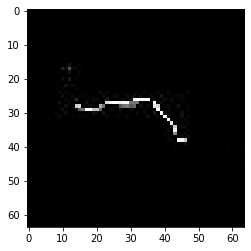

confidence for 16073 is 0.99861246


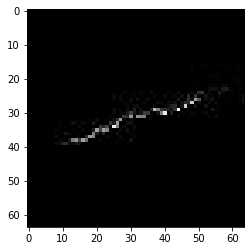

confidence for 16084 is 0.99983096


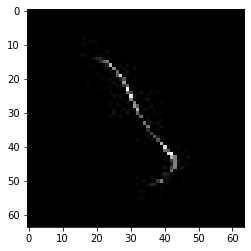

confidence for 16087 is 0.8398853


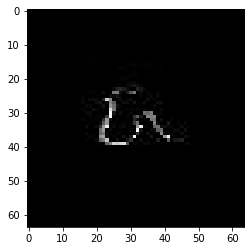

confidence for 16091 is 0.9955967


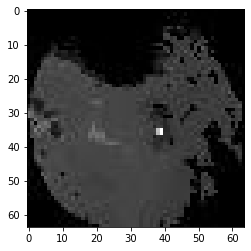

confidence for 16095 is 0.9633832


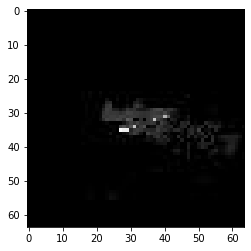

confidence for 16104 is 0.9793744


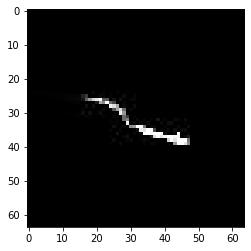

confidence for 16105 is 0.87564486


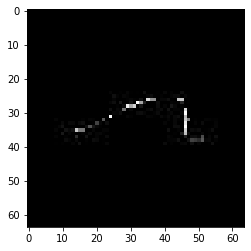

confidence for 16120 is 0.9999978


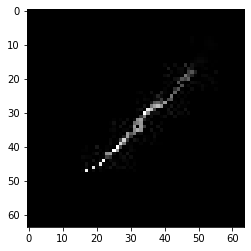

confidence for 16122 is 0.9074374


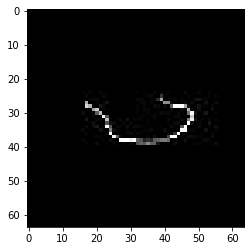

confidence for 16125 is 0.99217886


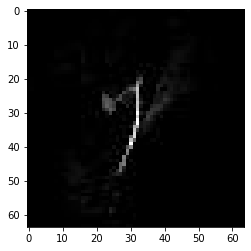

confidence for 16128 is 0.99779814


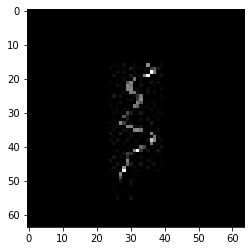

confidence for 16135 is 0.99698544


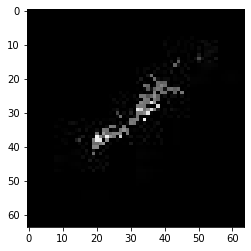

confidence for 16141 is 0.8659905


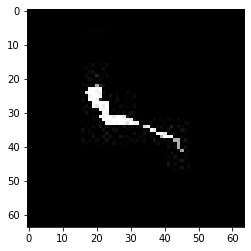

confidence for 16147 is 0.9749073


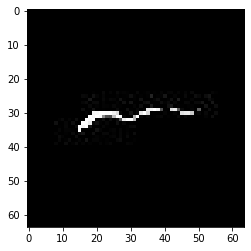

confidence for 16150 is 0.9922827


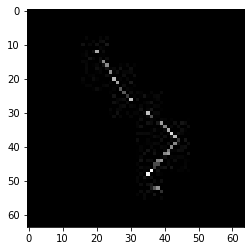

confidence for 16168 is 0.99922633


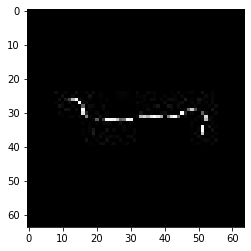

confidence for 16171 is 0.97268605


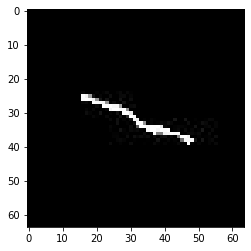

confidence for 16172 is 0.99420595


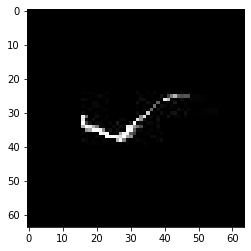

confidence for 16174 is 0.999899


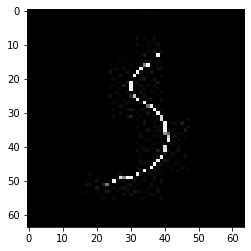

confidence for 16176 is 0.8747546


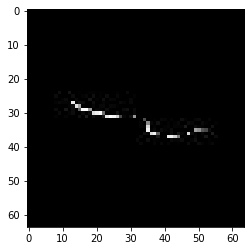

confidence for 16182 is 0.9712175


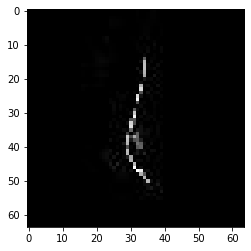

confidence for 16197 is 0.8502682


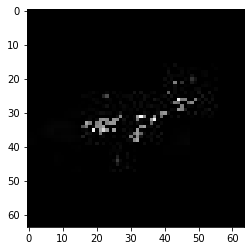

confidence for 16204 is 0.8774415


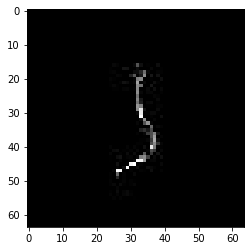

confidence for 16205 is 0.9999242


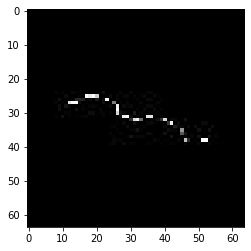

confidence for 16208 is 0.8093318


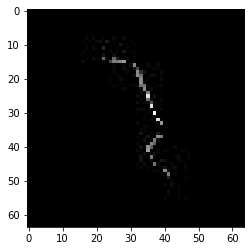

confidence for 16211 is 0.9984228


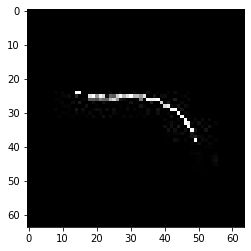

confidence for 16212 is 0.98891205


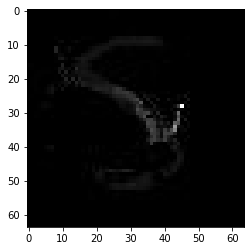

confidence for 16224 is 0.995577


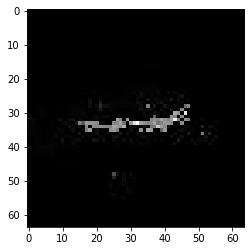

confidence for 16227 is 0.82368773


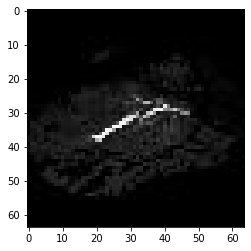

confidence for 16235 is 0.9984919


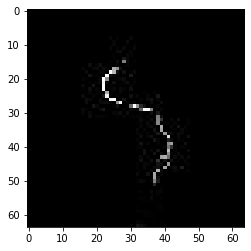

confidence for 16243 is 0.9980552


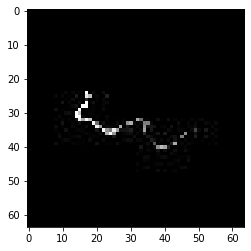

confidence for 16249 is 0.9911767


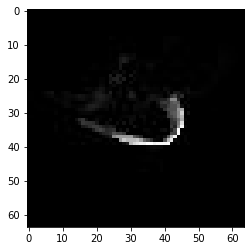

confidence for 16259 is 0.9986915


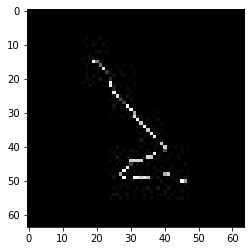

confidence for 16261 is 0.99959725


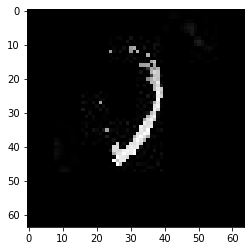

confidence for 16272 is 0.9235721


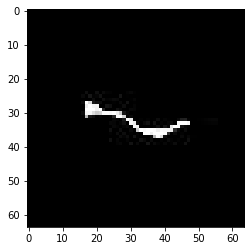

confidence for 16278 is 0.87655073


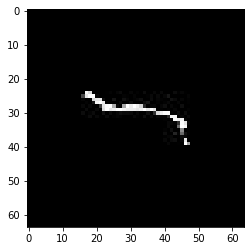

confidence for 16288 is 0.839546


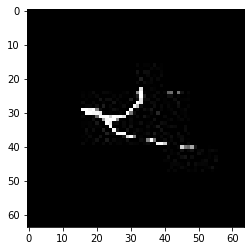

confidence for 16289 is 0.98398167


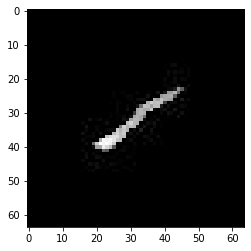

confidence for 16302 is 0.97743213


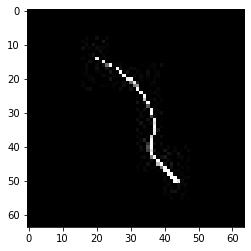

confidence for 16303 is 0.9998541


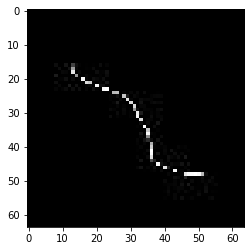

confidence for 16308 is 0.811847


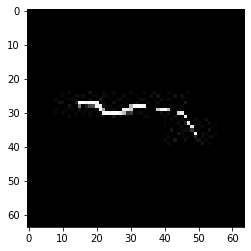

confidence for 16326 is 0.8730273


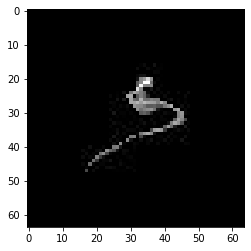

confidence for 16333 is 0.80199796


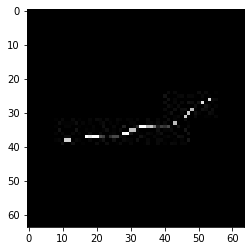

confidence for 16337 is 0.96637285


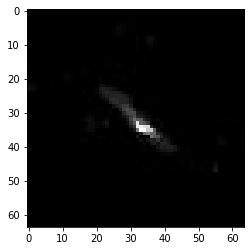

confidence for 16346 is 0.99362564


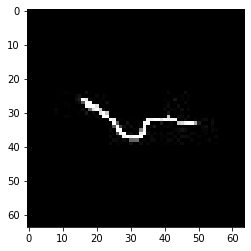

confidence for 16362 is 0.99531823


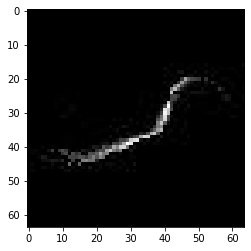

confidence for 16377 is 0.99736756


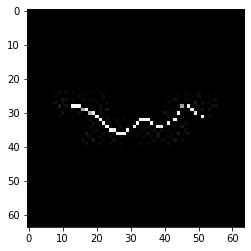

confidence for 16378 is 0.9843151


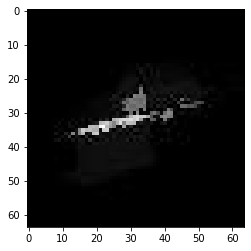

confidence for 16383 is 0.980866


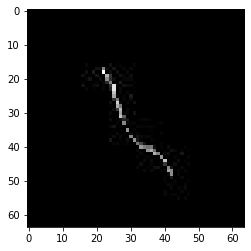

confidence for 16392 is 0.97762


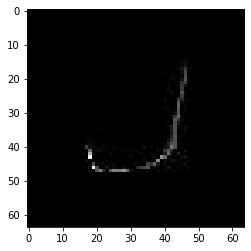

confidence for 16393 is 0.9731472


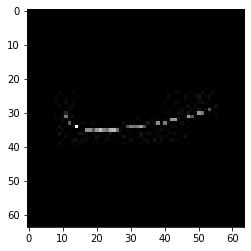

confidence for 16400 is 0.9216779


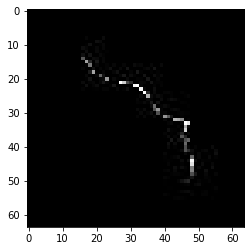

confidence for 16405 is 0.92995


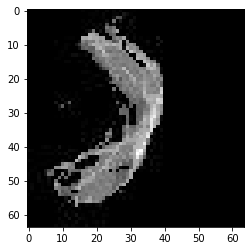

confidence for 16409 is 0.99998426


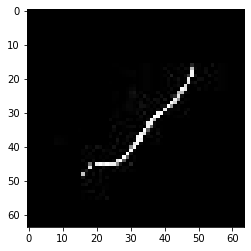

confidence for 16412 is 0.99930716


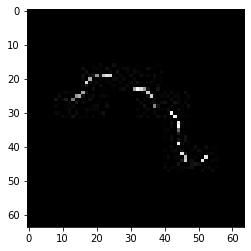

confidence for 16424 is 0.969077


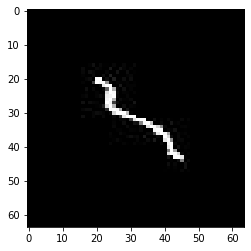

confidence for 16442 is 0.87387806


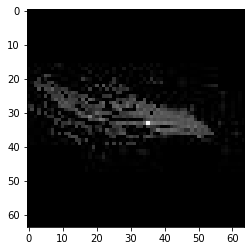

confidence for 16492 is 0.99913


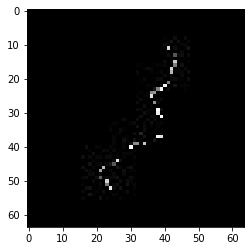

confidence for 16499 is 0.9882501


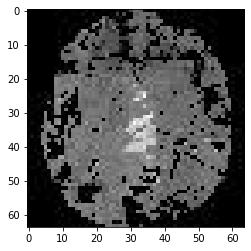

confidence for 16502 is 0.96656567


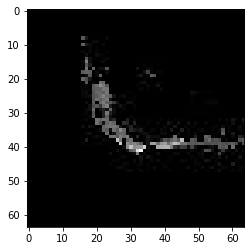

confidence for 16504 is 0.99855685


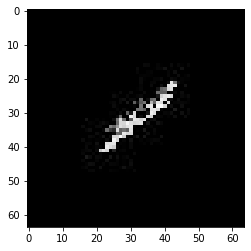

confidence for 16516 is 0.9446721


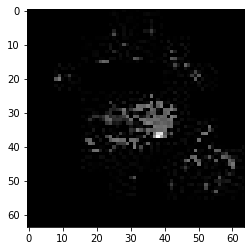

confidence for 16521 is 0.8404166


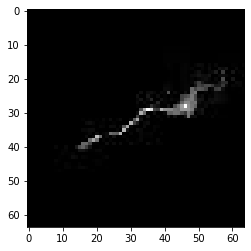

confidence for 16535 is 0.80493855


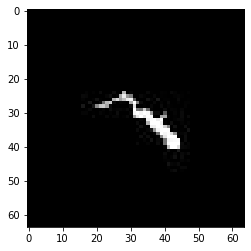

confidence for 16574 is 0.9432842


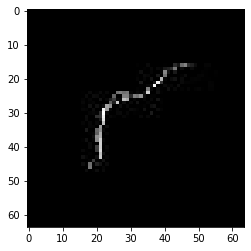

confidence for 16577 is 0.8779252


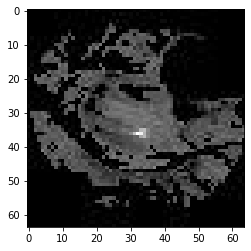

confidence for 16590 is 0.99750674


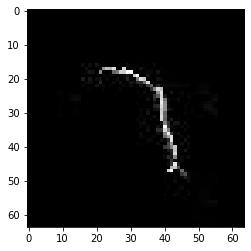

confidence for 16593 is 0.9974569


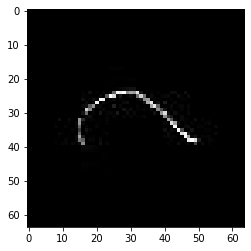

confidence for 16597 is 0.9882742


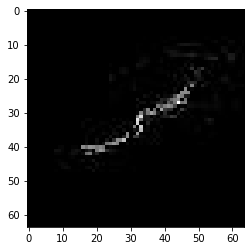

confidence for 16604 is 0.9524351


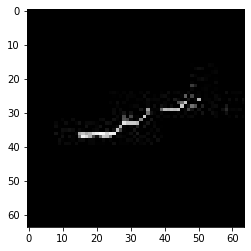

confidence for 16611 is 0.98295426


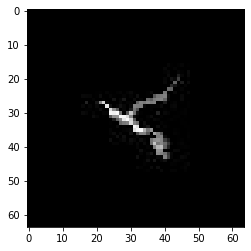

confidence for 16613 is 0.9998949


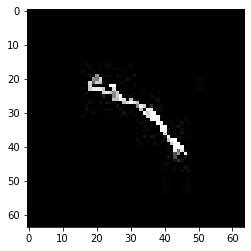

confidence for 16636 is 0.94470376


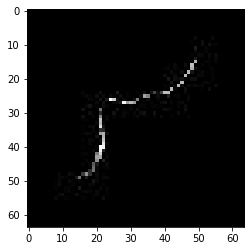

confidence for 16637 is 0.9996346


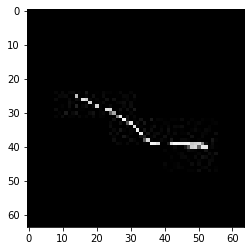

confidence for 16640 is 0.97680414


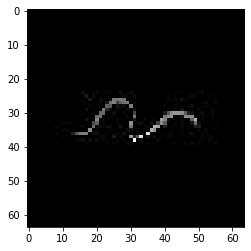

confidence for 16641 is 0.99612117


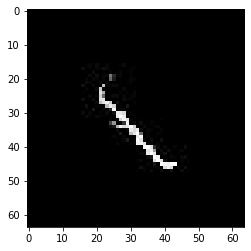

confidence for 16642 is 0.9276794


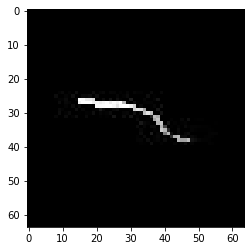

confidence for 16645 is 0.91868985


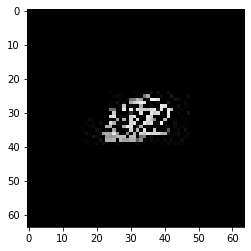

confidence for 16651 is 0.8599429


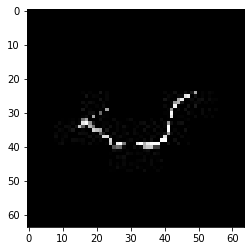

confidence for 16659 is 0.9552618


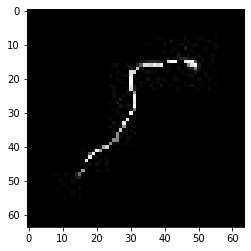

confidence for 16665 is 0.8164765


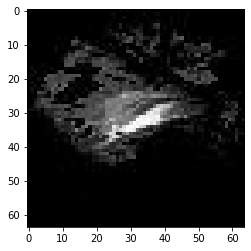

confidence for 16668 is 0.9991793


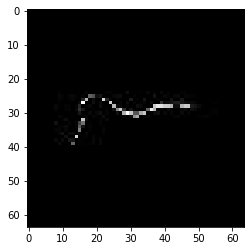

confidence for 16674 is 0.9865247


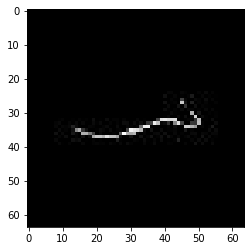

confidence for 16678 is 0.9996348


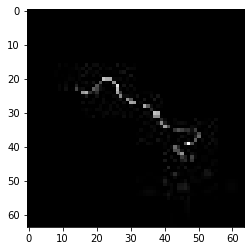

confidence for 16704 is 0.9999044


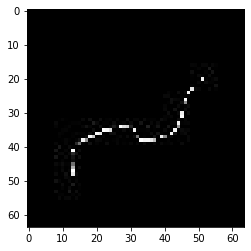

confidence for 16705 is 0.9999997


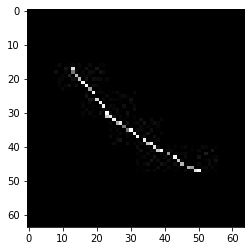

confidence for 16708 is 0.8883881


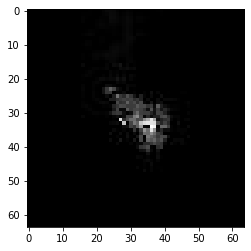

confidence for 16713 is 0.9581128


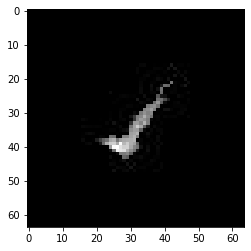

confidence for 16715 is 0.99999344


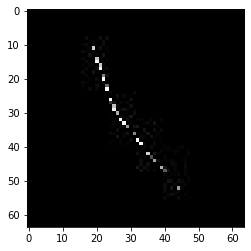

confidence for 16729 is 0.9995831


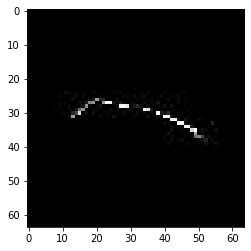

confidence for 16745 is 0.9844288


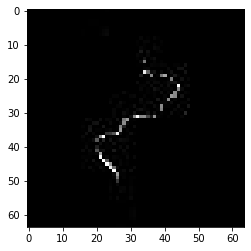

confidence for 16746 is 1.0


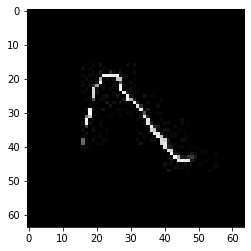

confidence for 16764 is 0.9942643


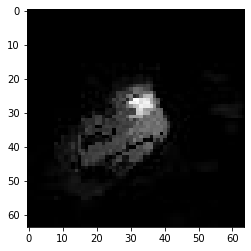

confidence for 16767 is 0.9490756


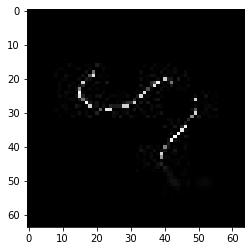

confidence for 16775 is 0.90695184


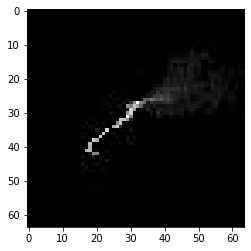

confidence for 16779 is 0.99807316


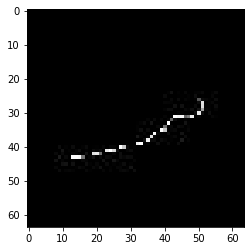

confidence for 16783 is 0.8447368


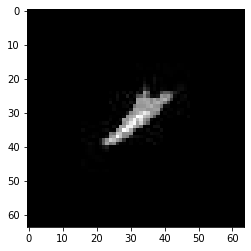

confidence for 16787 is 0.89908695


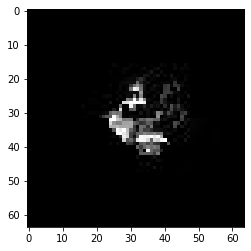

confidence for 16794 is 0.9999997


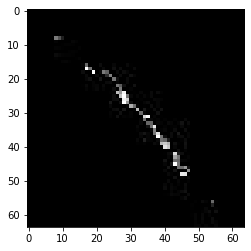

confidence for 16797 is 0.961468


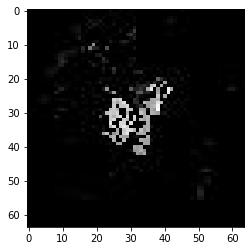

confidence for 16798 is 0.9969366


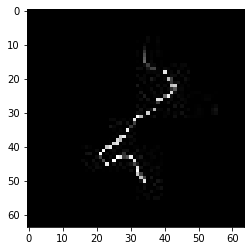

confidence for 16824 is 0.9860851


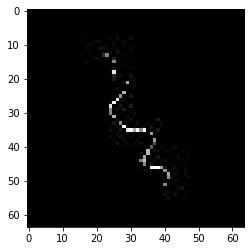

confidence for 16832 is 0.98926884


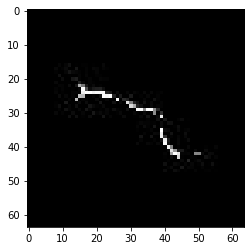

confidence for 16842 is 0.9496147


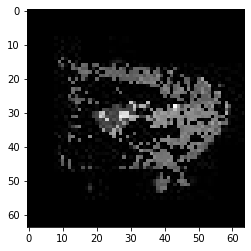

confidence for 16855 is 0.9581696


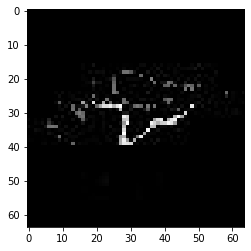

confidence for 16865 is 0.99212235


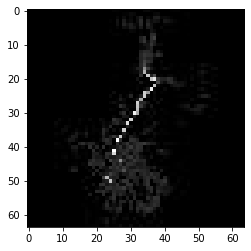

confidence for 16867 is 0.99156135


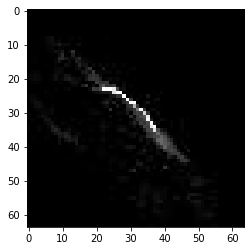

confidence for 16871 is 0.8299865


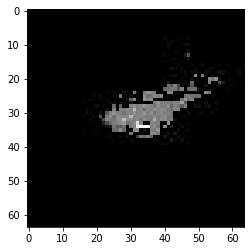

confidence for 16877 is 0.99996257


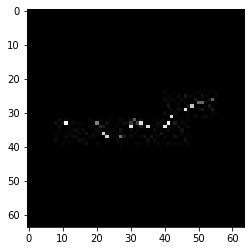

confidence for 16880 is 0.8226537


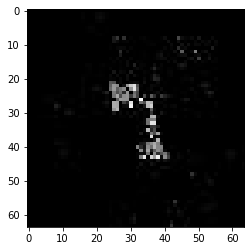

confidence for 16884 is 0.991971


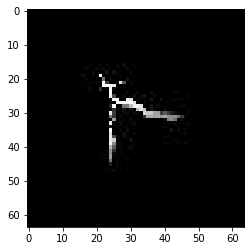

confidence for 16891 is 0.99985236


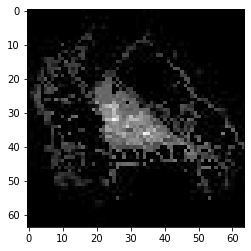

confidence for 16907 is 0.92660534


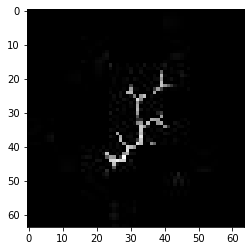

confidence for 16908 is 0.9930697


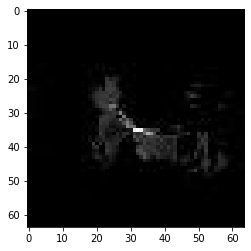

confidence for 16924 is 0.96417964


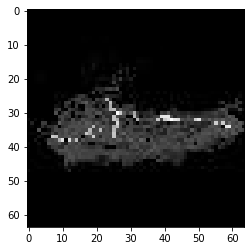

confidence for 16927 is 0.975622


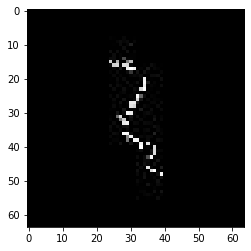

confidence for 16928 is 0.9325524


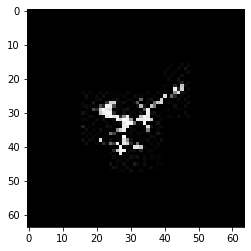

confidence for 16931 is 0.9371208


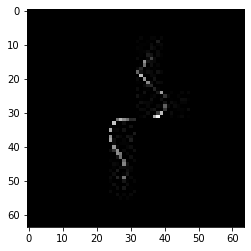

confidence for 16938 is 0.8859879


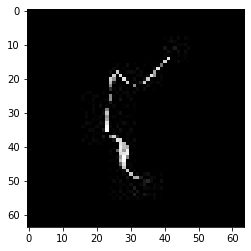

confidence for 16943 is 0.9998458


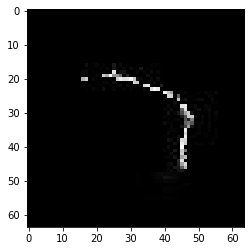

confidence for 16948 is 0.9991052


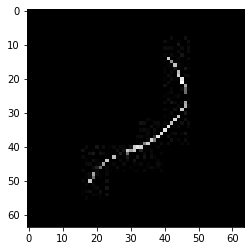

confidence for 16954 is 0.9998974


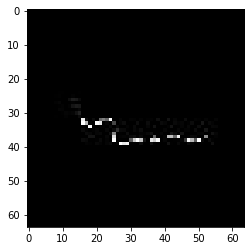

confidence for 16956 is 0.99821734


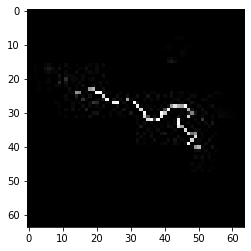

confidence for 16970 is 0.91805387


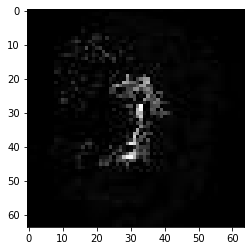

confidence for 16975 is 0.99847215


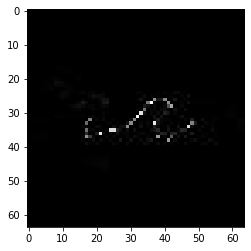

confidence for 16976 is 0.9685122


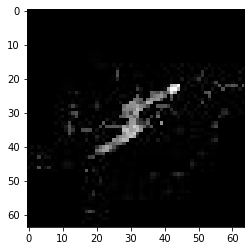

confidence for 16977 is 0.9995351


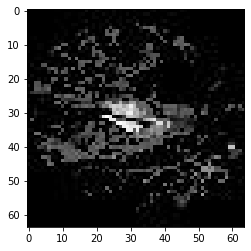

confidence for 16988 is 0.9998237


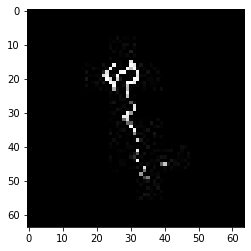

confidence for 16996 is 0.9857689


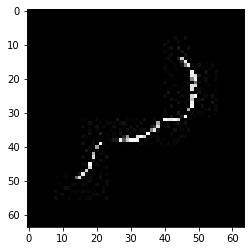

confidence for 17003 is 0.99605846


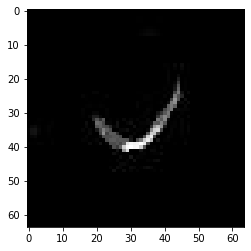

confidence for 17008 is 0.99379516


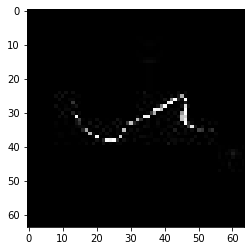

confidence for 17010 is 0.99711406


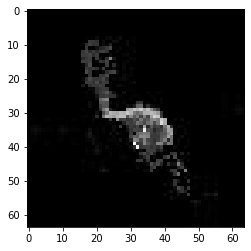

confidence for 17012 is 0.98504966


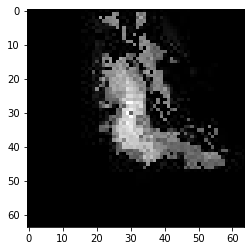

confidence for 17016 is 0.9799497


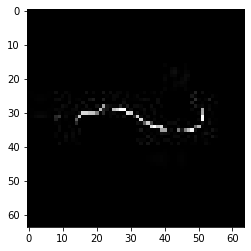

confidence for 17033 is 0.9977512


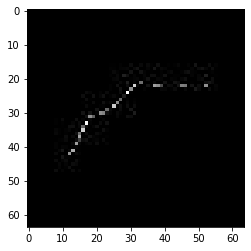

confidence for 17044 is 0.8427386


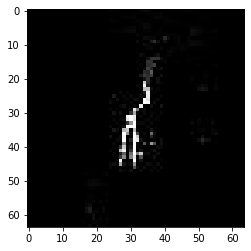

confidence for 17051 is 0.9999926


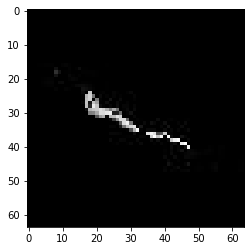

confidence for 17056 is 0.99928427


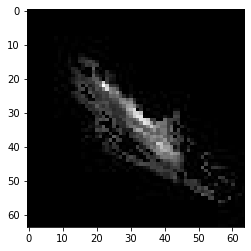

confidence for 17061 is 0.9927281


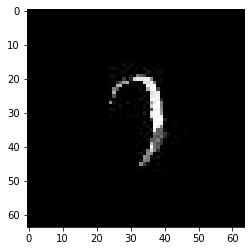

confidence for 17063 is 0.99999994


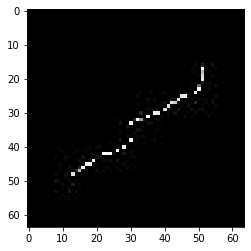

confidence for 17065 is 0.9697127


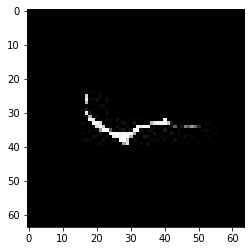

confidence for 17069 is 0.8436


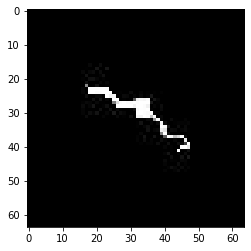

confidence for 17073 is 0.81589603


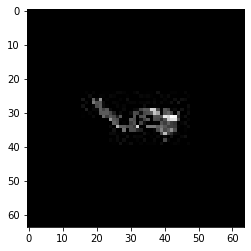

confidence for 17076 is 0.9995821


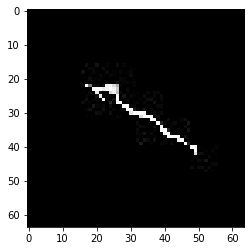

confidence for 17077 is 0.93506366


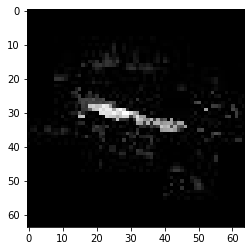

confidence for 17087 is 0.9965143


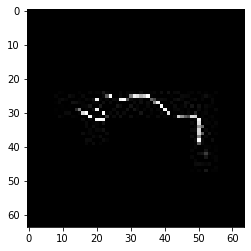

confidence for 17089 is 0.86266303


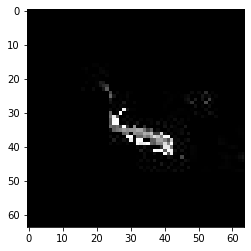

confidence for 17093 is 0.99599016


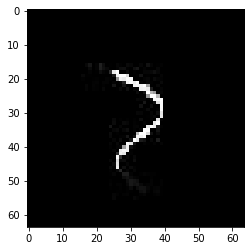

confidence for 17097 is 0.9999992


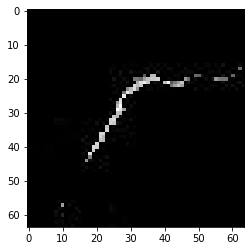

confidence for 17104 is 0.9999984


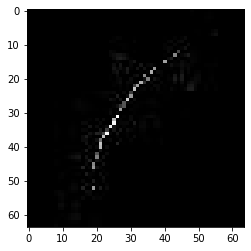

confidence for 17110 is 0.99761015


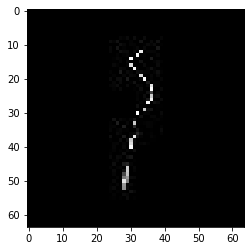

confidence for 17118 is 0.9950683


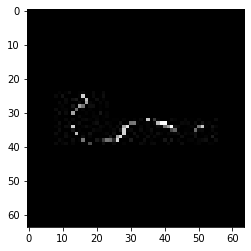

confidence for 17119 is 0.9999999


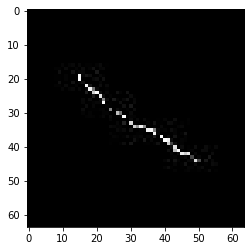

confidence for 17120 is 0.9971753


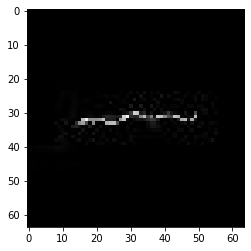

confidence for 17125 is 0.9979154


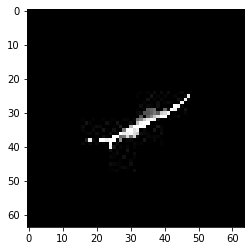

confidence for 17127 is 0.9999991


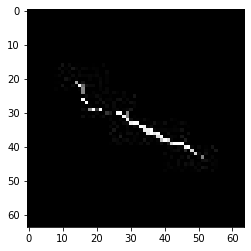

confidence for 17139 is 0.96230555


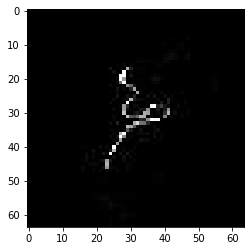

confidence for 17159 is 0.9991077


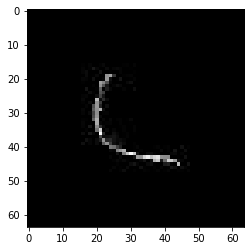

confidence for 17161 is 0.952068


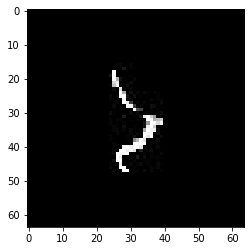

confidence for 17162 is 0.9836134


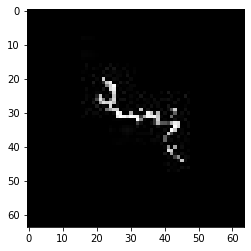

confidence for 17165 is 0.88485104


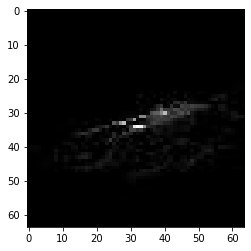

confidence for 17172 is 0.9007183


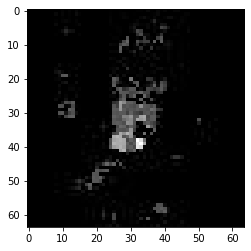

confidence for 17176 is 0.9442


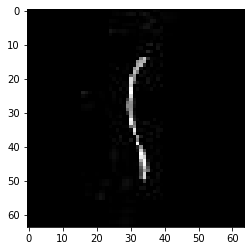

confidence for 17177 is 0.99995524


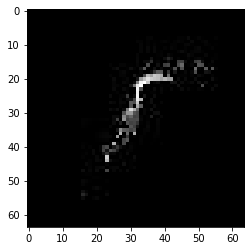

confidence for 17179 is 0.90397286


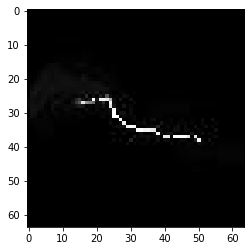

confidence for 17200 is 0.872786


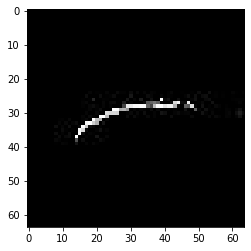

confidence for 17202 is 0.997923


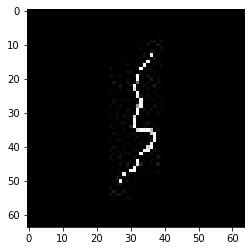

confidence for 17203 is 0.97468495


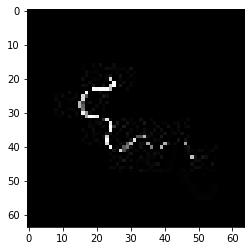

confidence for 17210 is 0.8199806


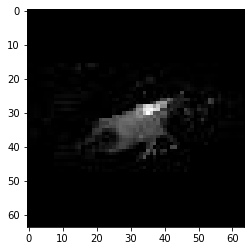

confidence for 17219 is 0.913381


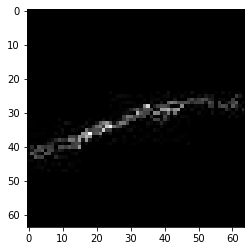

confidence for 17224 is 0.98085153


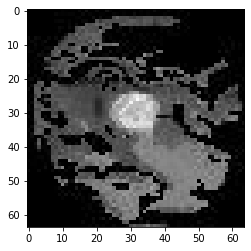

confidence for 17236 is 0.87296396


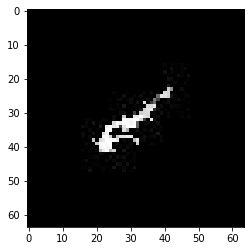

confidence for 17237 is 0.9998917


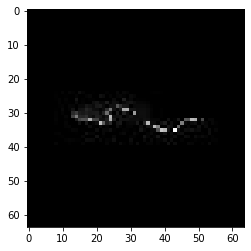

confidence for 17238 is 0.9559552


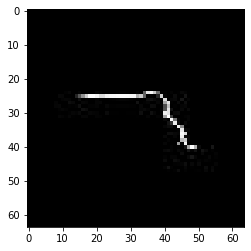

confidence for 17240 is 0.9431912


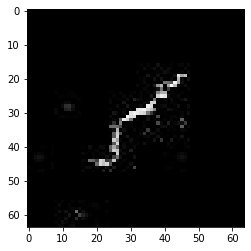

confidence for 17245 is 0.999624


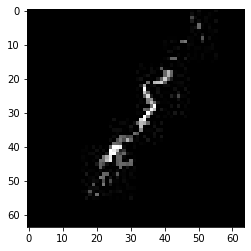

confidence for 17246 is 0.9724214


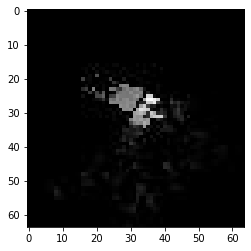

confidence for 17254 is 0.9376627


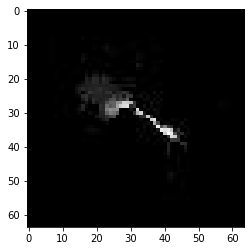

confidence for 17256 is 0.99656194


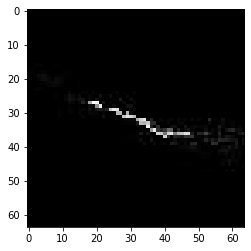

confidence for 17270 is 0.9701847


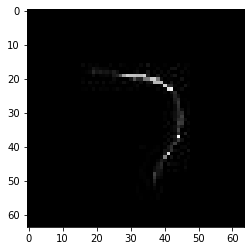

confidence for 17272 is 0.9968949


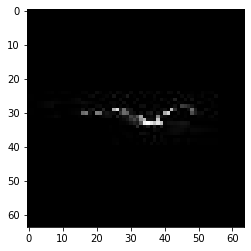

confidence for 17279 is 0.9990815


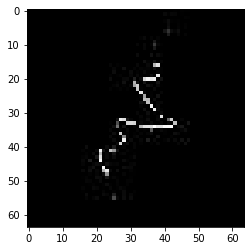

confidence for 17285 is 0.9856865


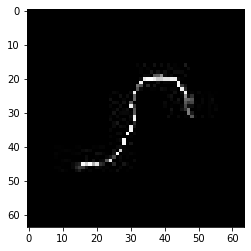

confidence for 17290 is 0.9999992


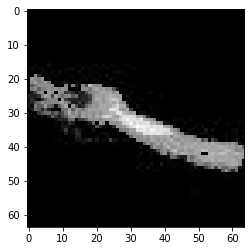

confidence for 17293 is 0.9996371


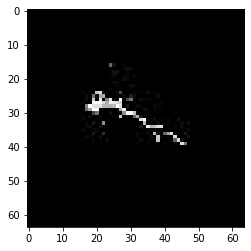

confidence for 17298 is 0.9973293


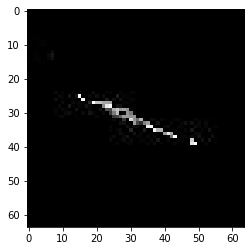

confidence for 17303 is 0.9999179


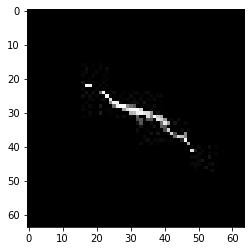

confidence for 17304 is 0.9995594


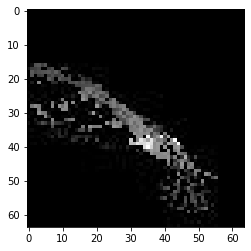

confidence for 17307 is 0.9990042


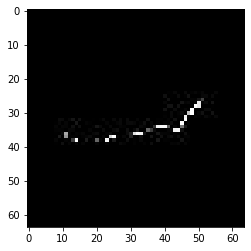

confidence for 17311 is 0.99999166


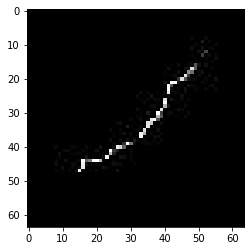

confidence for 17312 is 0.99911356


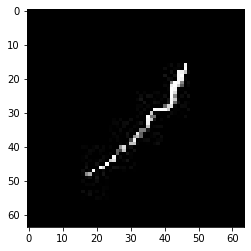

confidence for 17323 is 0.9672977


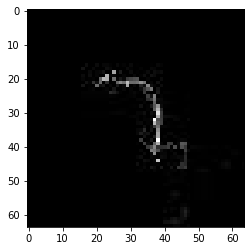

confidence for 17326 is 0.96778


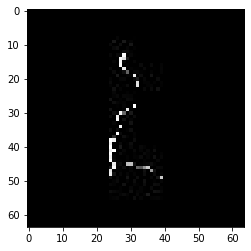

confidence for 17328 is 0.9969955


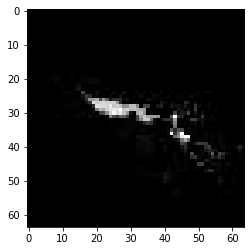

confidence for 17332 is 0.9959792


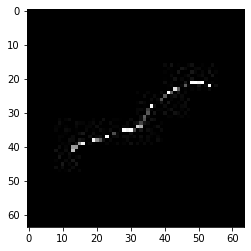

confidence for 17342 is 0.9997017


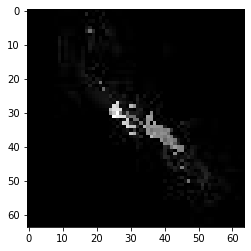

confidence for 17343 is 0.99968064


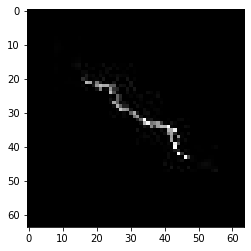

confidence for 17345 is 0.9810932


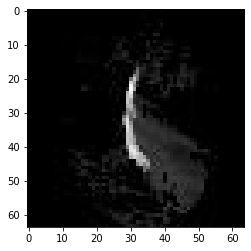

confidence for 17350 is 0.9833295


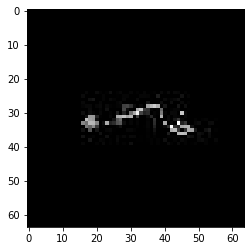

confidence for 17355 is 0.89305633


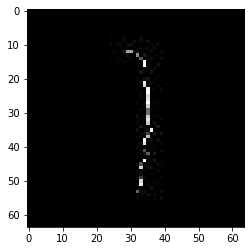

confidence for 17375 is 0.99095553


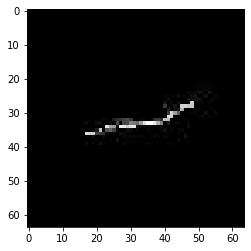

confidence for 17377 is 0.9999777


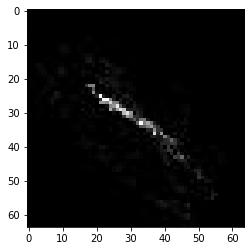

confidence for 17379 is 0.99572086


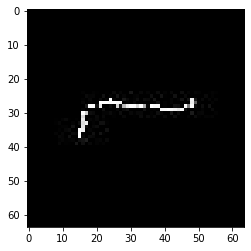

confidence for 17380 is 0.9768948


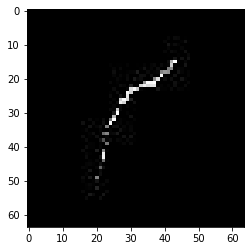

confidence for 17382 is 0.996873


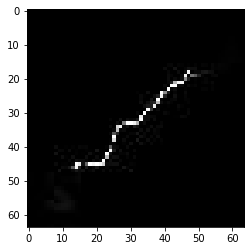

confidence for 17389 is 0.99715763


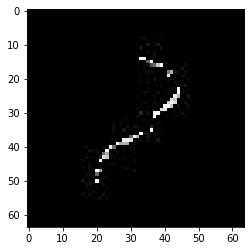

confidence for 17392 is 0.9991406


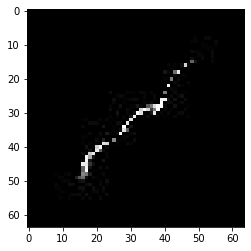

confidence for 17404 is 0.9558287


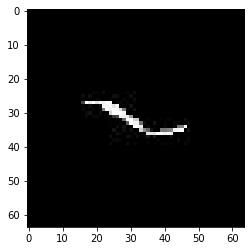

confidence for 17406 is 0.99999547


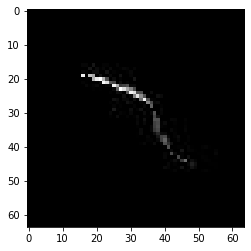

confidence for 17410 is 0.91511714


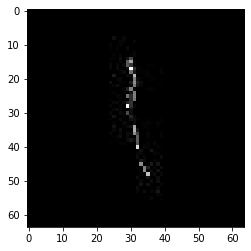

confidence for 17412 is 0.9979883


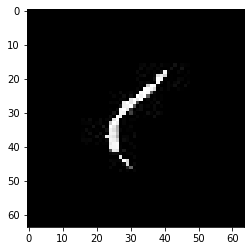

confidence for 17414 is 1.0


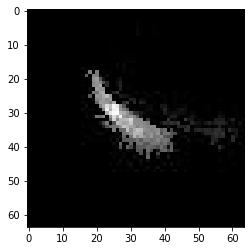

confidence for 17419 is 0.99750036


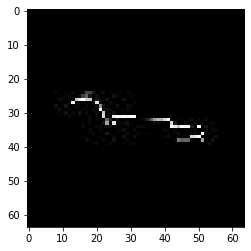

confidence for 17422 is 1.0


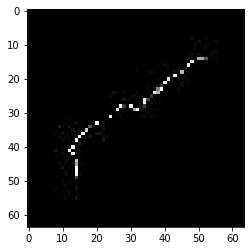

confidence for 17427 is 0.92687714


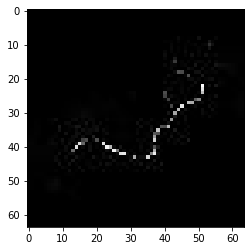

confidence for 17429 is 0.99554706


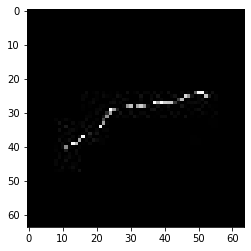

confidence for 17441 is 0.99968976


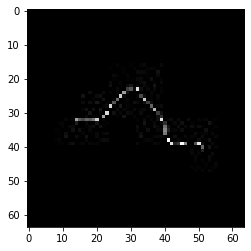

confidence for 17442 is 0.9999892


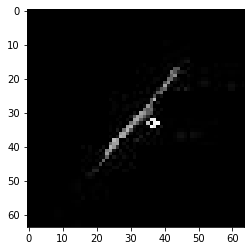

confidence for 17457 is 0.99676317


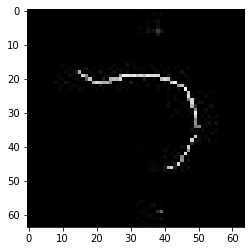

confidence for 17462 is 0.8977198


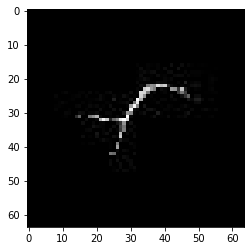

confidence for 17470 is 0.99996936


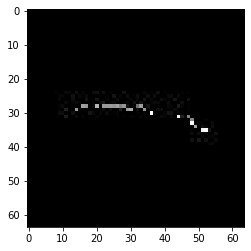

confidence for 17471 is 0.9999345


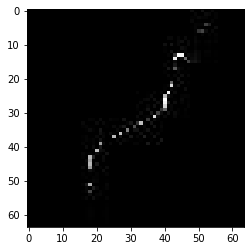

confidence for 17475 is 0.96020895


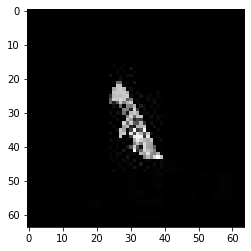

confidence for 17477 is 0.9854398


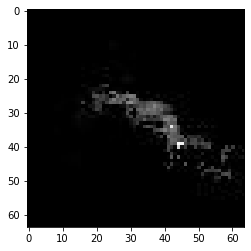

confidence for 17478 is 0.9241774


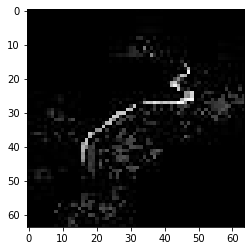

confidence for 17483 is 0.9958184


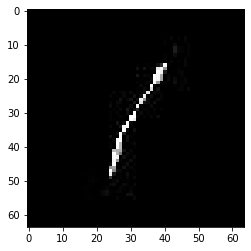

confidence for 17484 is 0.9999892


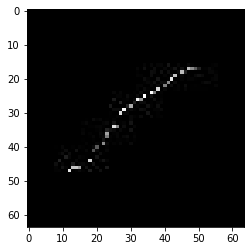

confidence for 17485 is 0.80362725


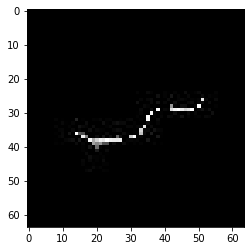

confidence for 17486 is 0.99488556


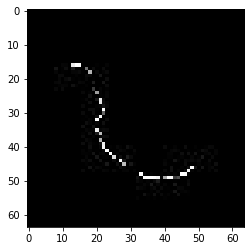

confidence for 17496 is 0.9999326


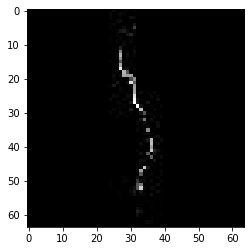

confidence for 17497 is 0.9850996


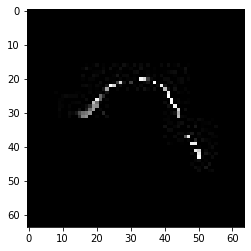

confidence for 17508 is 0.9999628


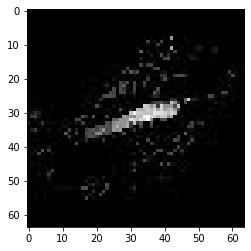

confidence for 17514 is 0.8385038


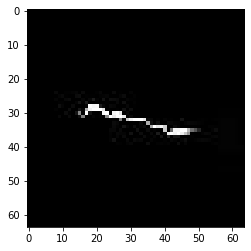

confidence for 17515 is 0.95285076


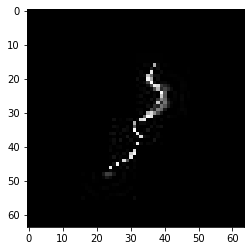

confidence for 17525 is 0.99991137


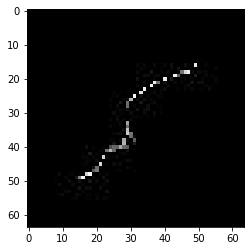

confidence for 17531 is 0.9621686


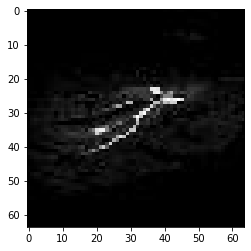

confidence for 17536 is 0.9921437


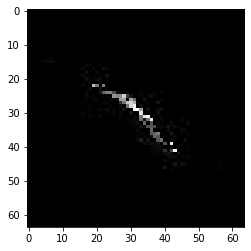

confidence for 17537 is 0.9964586


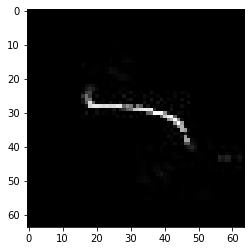

confidence for 17538 is 0.9999848


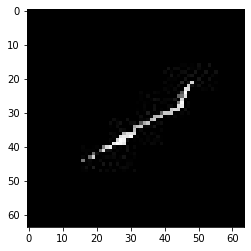

confidence for 17544 is 0.9803837


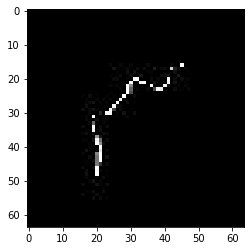

confidence for 17545 is 0.9996483


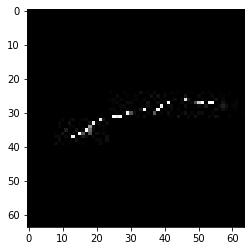

confidence for 17551 is 0.9093485


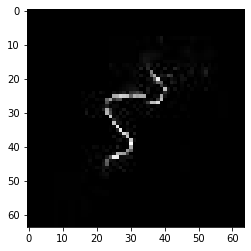

confidence for 17558 is 0.99799275


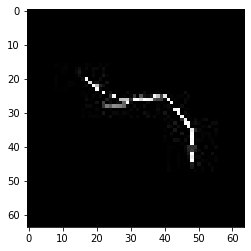

confidence for 17562 is 0.8932412


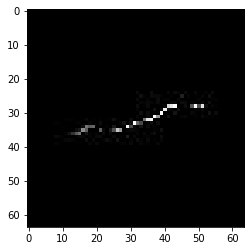

confidence for 17564 is 0.9999089


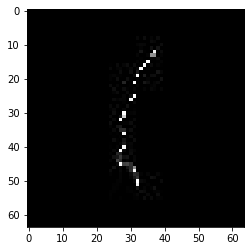

confidence for 17565 is 0.9998853


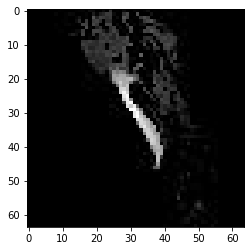

confidence for 17570 is 0.89351594


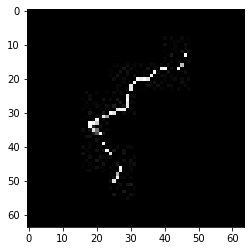

confidence for 17574 is 0.96594113


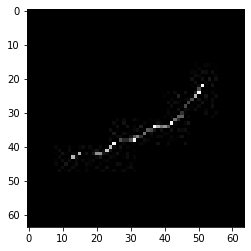

confidence for 17576 is 0.9558941


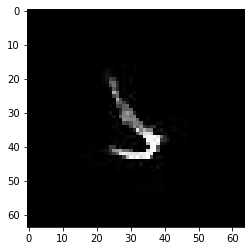

confidence for 17580 is 0.9971794


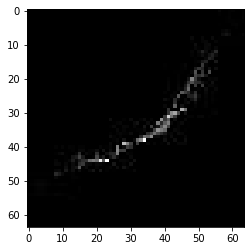

confidence for 17582 is 0.8217715


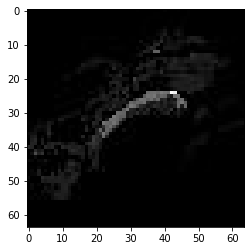

confidence for 17595 is 0.98610526


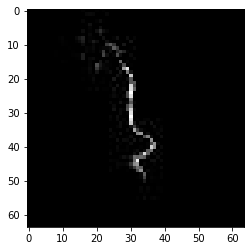

confidence for 17596 is 0.9198974


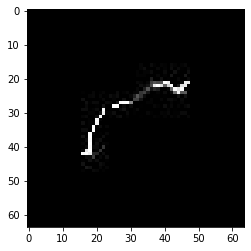

confidence for 17598 is 0.9999134


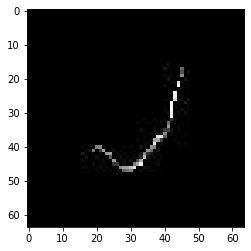

confidence for 17603 is 0.8688425


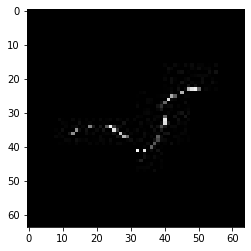

confidence for 17612 is 0.975015


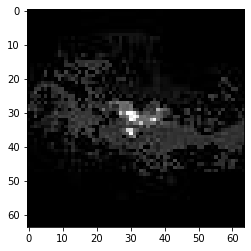

confidence for 17617 is 0.9999227


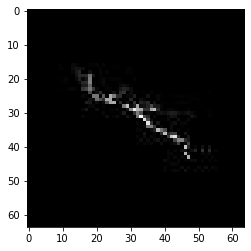

confidence for 17618 is 0.95528305


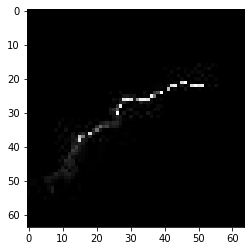

confidence for 17623 is 0.99857956


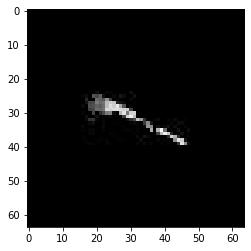

confidence for 17636 is 0.8859832


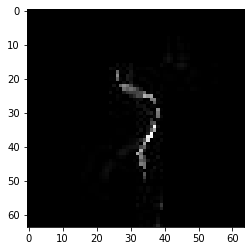

confidence for 17638 is 0.834339


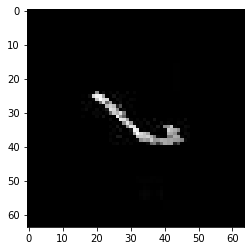

confidence for 17642 is 0.9998479


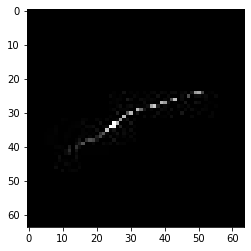

confidence for 17647 is 0.99465376


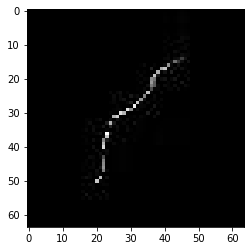

confidence for 17651 is 0.98794115


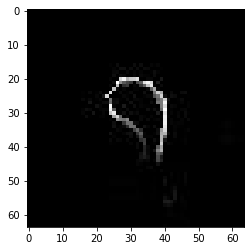

confidence for 17653 is 0.9907165


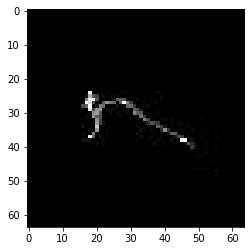

confidence for 17656 is 0.99851006


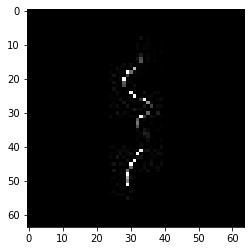

confidence for 17661 is 0.83741516


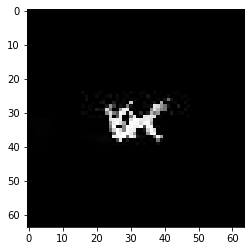

confidence for 17663 is 0.8009314


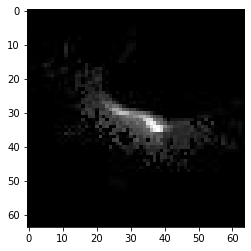

confidence for 17664 is 0.87791544


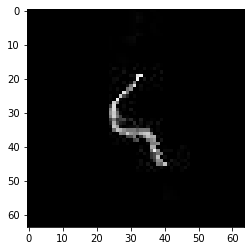

confidence for 17667 is 0.9994553


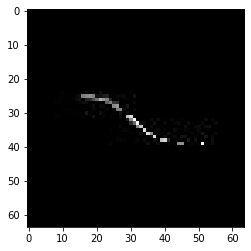

confidence for 17668 is 0.9899438


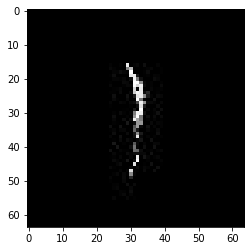

confidence for 17676 is 0.9998534


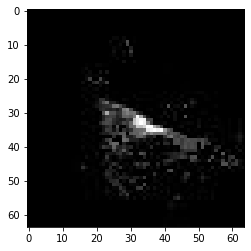

confidence for 17682 is 0.99999934


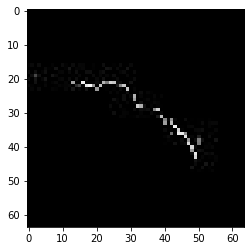

confidence for 17691 is 0.9999917


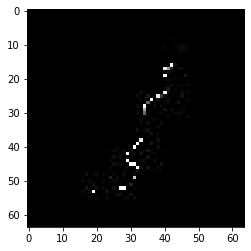

confidence for 17698 is 0.94334614


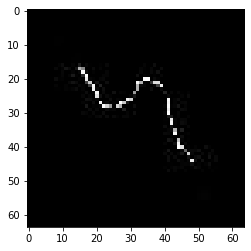

confidence for 17699 is 0.98335654


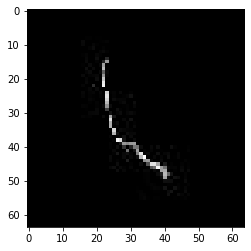

confidence for 17703 is 0.9900835


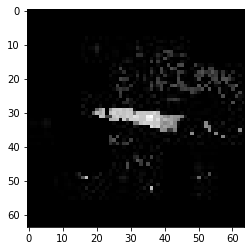

confidence for 17704 is 0.99356496


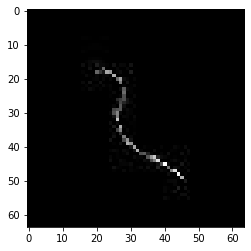

confidence for 17705 is 0.8065385


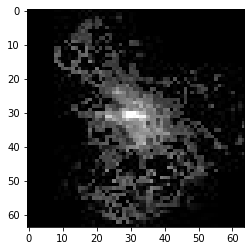

confidence for 17710 is 0.8650658


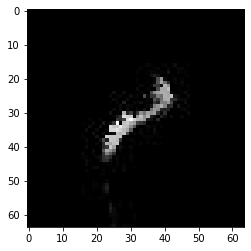

confidence for 17714 is 0.9941732


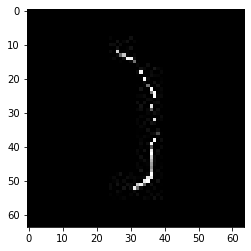

confidence for 17721 is 1.0


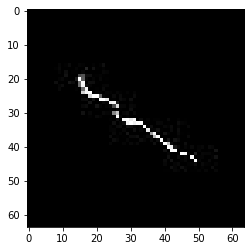

confidence for 17733 is 0.9998323


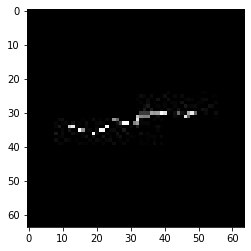

confidence for 17743 is 0.9890257


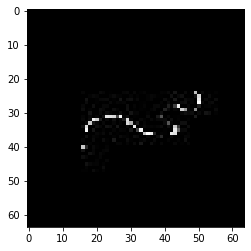

confidence for 17750 is 0.9369473


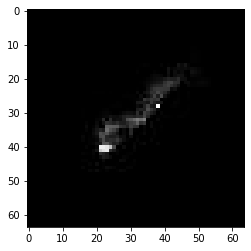

confidence for 17759 is 0.82173705


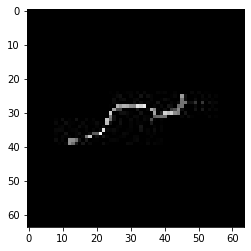

confidence for 17764 is 0.98196507


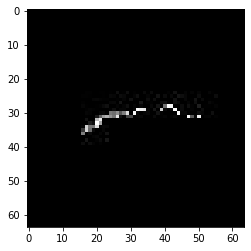

confidence for 17765 is 0.9999976


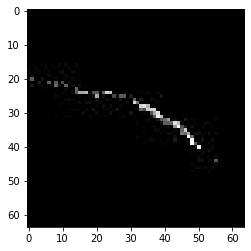

confidence for 17770 is 0.9999962


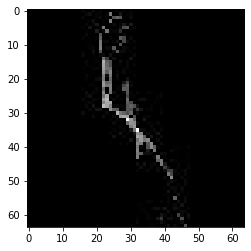

confidence for 17771 is 0.98589605


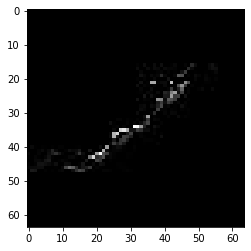

confidence for 17772 is 0.94175166


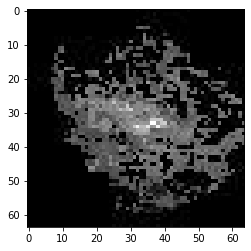

confidence for 17773 is 0.97151965


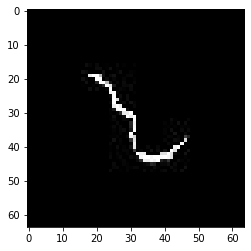

confidence for 17775 is 0.8468985


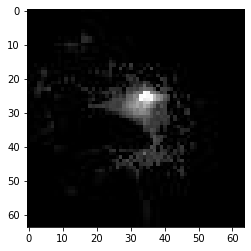

confidence for 17802 is 0.90036327


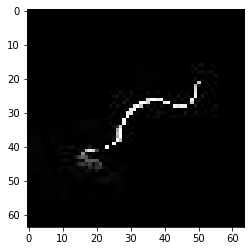

confidence for 17818 is 0.9477935


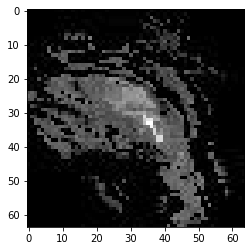

confidence for 17828 is 0.99985087


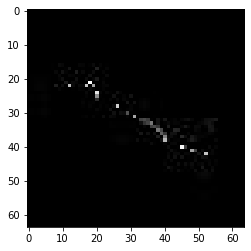

confidence for 17847 is 1.0


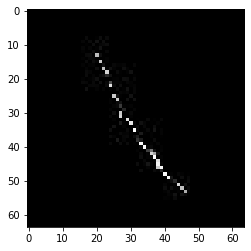

confidence for 17850 is 0.8889791


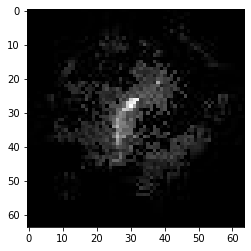

confidence for 17852 is 0.8514821


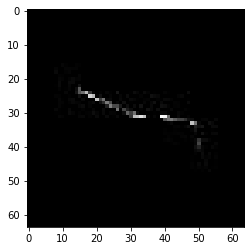

confidence for 17854 is 0.9219749


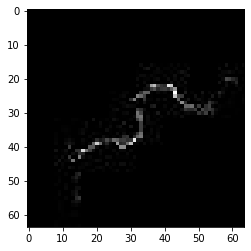

confidence for 17857 is 0.9999976


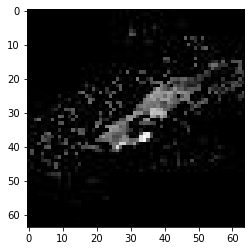

confidence for 17866 is 0.8756008


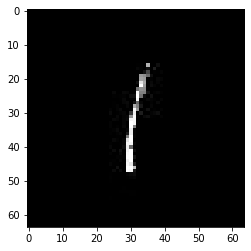

confidence for 17869 is 0.99965495


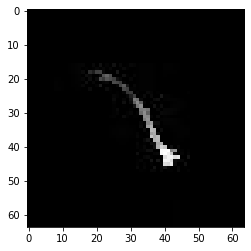

confidence for 17873 is 0.9968838


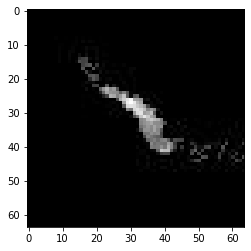

confidence for 17887 is 0.99539715


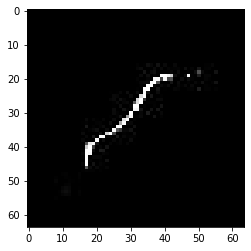

confidence for 17889 is 0.9957253


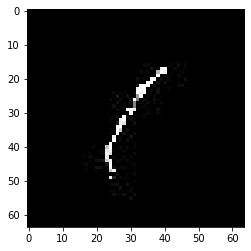

confidence for 17890 is 1.0


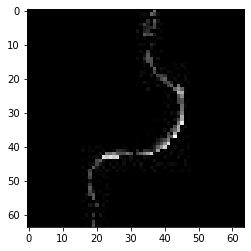

confidence for 17904 is 0.9872102


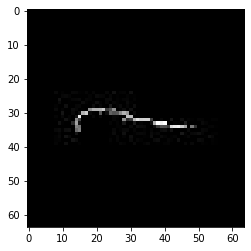

confidence for 17905 is 0.99999976


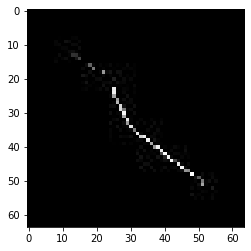

confidence for 17926 is 0.99989283


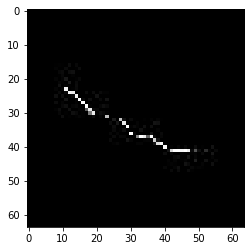

confidence for 17932 is 0.9615039


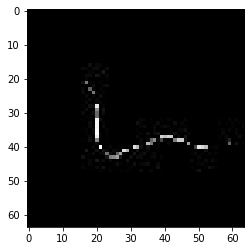

confidence for 17959 is 0.99559265


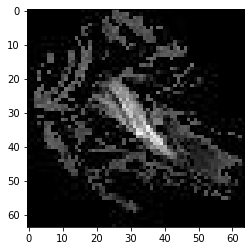

confidence for 17961 is 0.8837649


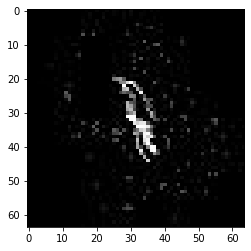

confidence for 17962 is 0.84925455


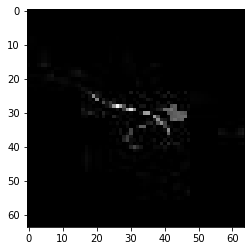

confidence for 17963 is 0.8851742


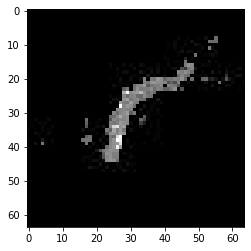

confidence for 17973 is 0.8487552


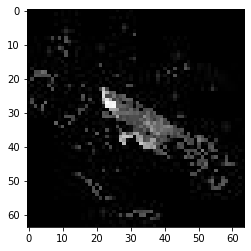

confidence for 17980 is 0.9996303


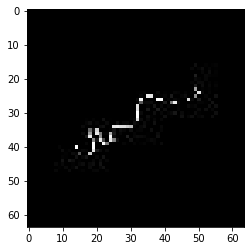

confidence for 17986 is 0.98558414


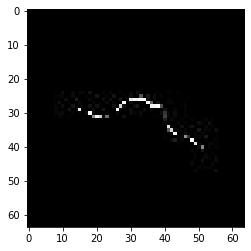

confidence for 17991 is 0.9999259


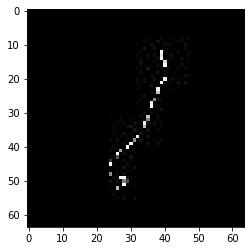

confidence for 17997 is 0.9954175


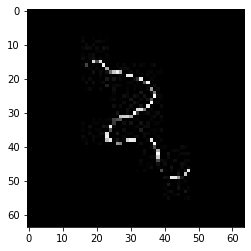

confidence for 18006 is 0.99274707


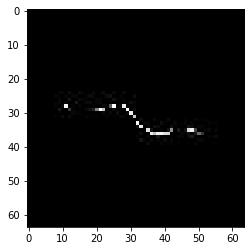

confidence for 18009 is 0.96926343


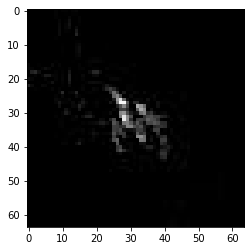

confidence for 18010 is 0.98289824


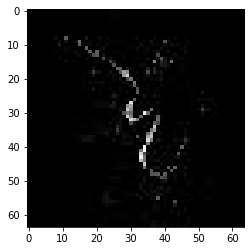

confidence for 18012 is 0.9399929


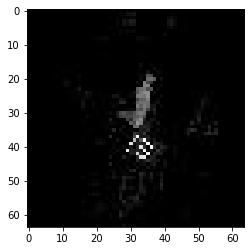

confidence for 18015 is 0.97522295


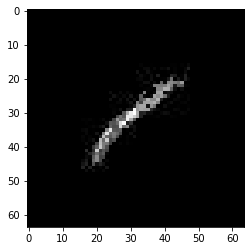

confidence for 18029 is 0.84222454


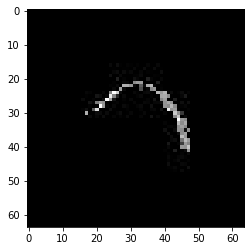

confidence for 18035 is 0.99998754


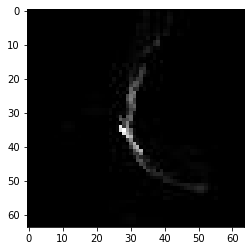

confidence for 18051 is 0.9994345


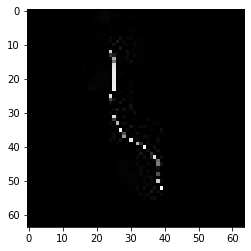

confidence for 18052 is 0.93248713


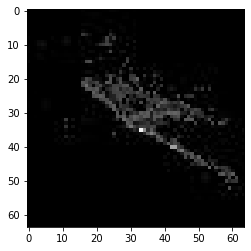

confidence for 18058 is 0.83406746


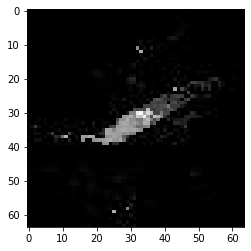

confidence for 18070 is 0.9936656


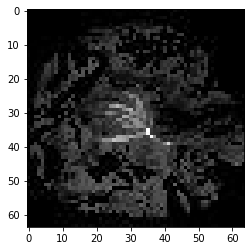

confidence for 18088 is 0.99413395


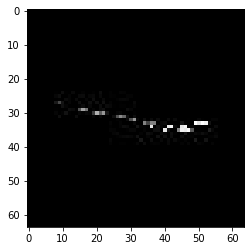

confidence for 18089 is 1.0


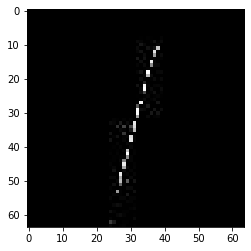

confidence for 18096 is 0.9999999


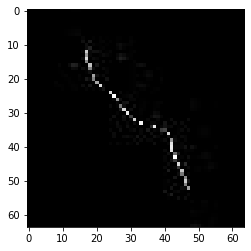

confidence for 18106 is 0.9932357


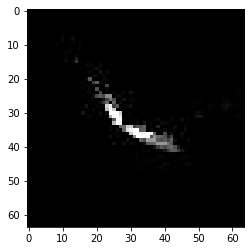

confidence for 18116 is 0.8750446


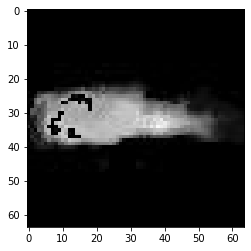

confidence for 18120 is 0.8126541


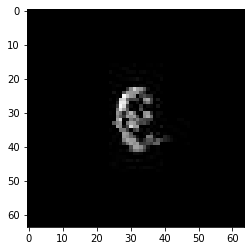

confidence for 18123 is 0.9934157


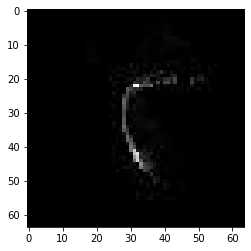

confidence for 18124 is 0.9871794


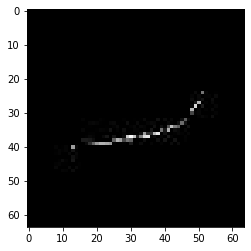

confidence for 18132 is 0.99989116


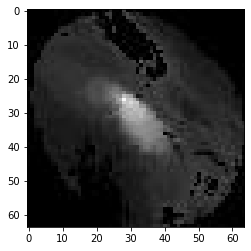

confidence for 18144 is 0.9996756


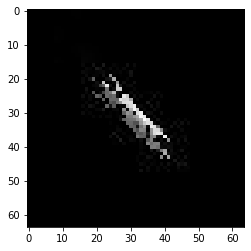

confidence for 18150 is 0.997919


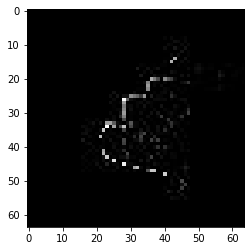

confidence for 18151 is 0.97855824


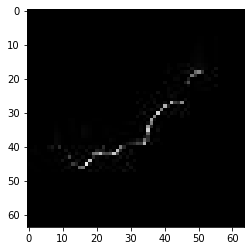

confidence for 18152 is 0.99111575


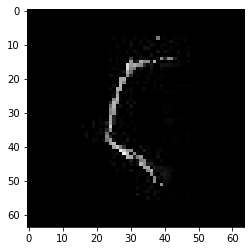

confidence for 18168 is 0.99914116


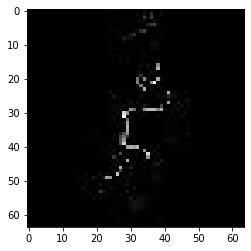

confidence for 18172 is 0.9959349


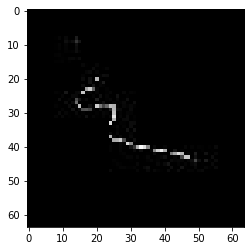

confidence for 18174 is 0.9639773


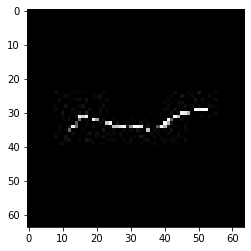

confidence for 18181 is 0.99428475


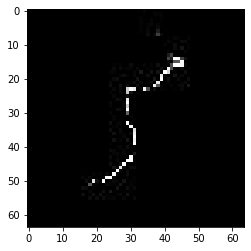

confidence for 18185 is 0.81524104


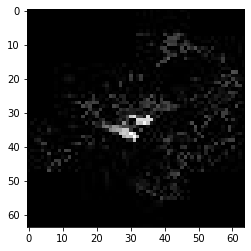

confidence for 18191 is 0.99596226


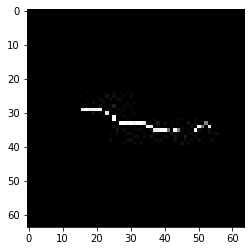

confidence for 18198 is 0.8831319


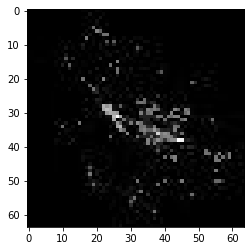

confidence for 18200 is 0.99980915


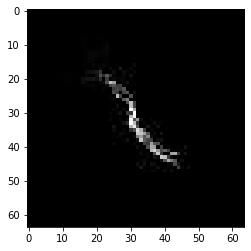

confidence for 18203 is 0.8013619


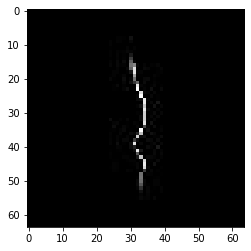

confidence for 18204 is 0.9874976


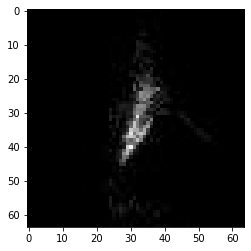

confidence for 18215 is 0.96731704


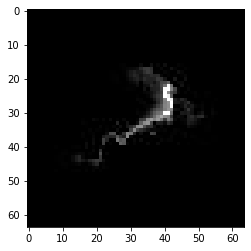

confidence for 18219 is 0.8510496


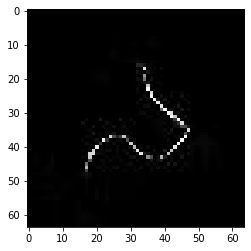

confidence for 18221 is 0.988576


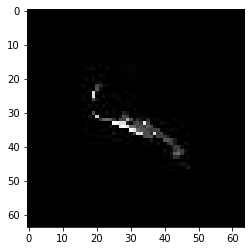

confidence for 18223 is 0.9999941


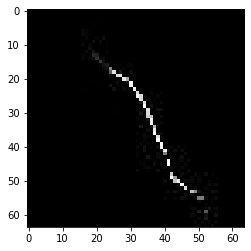

confidence for 18240 is 0.9843505


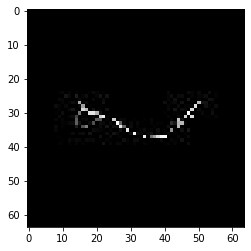

confidence for 18242 is 0.9962271


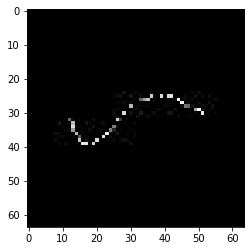

confidence for 18247 is 0.9999973


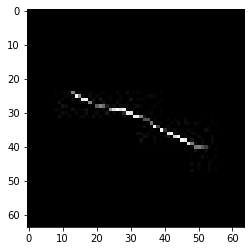

confidence for 18260 is 0.8555312


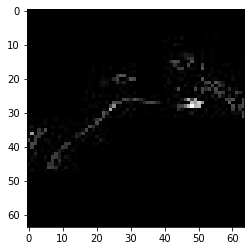

confidence for 18261 is 0.8548791


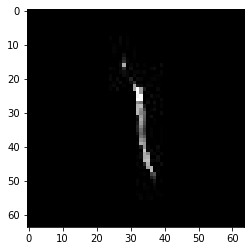

confidence for 18265 is 0.9243331


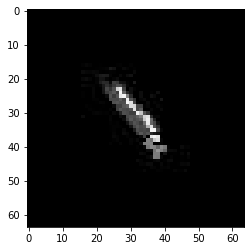

confidence for 18272 is 0.9999777


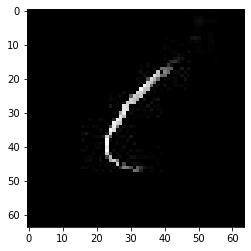

confidence for 18279 is 0.9126254


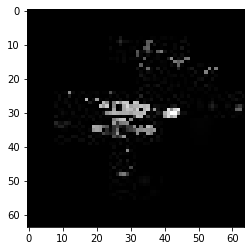

confidence for 18282 is 0.98755956


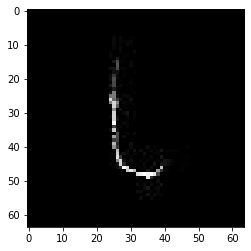

confidence for 18284 is 0.9999039


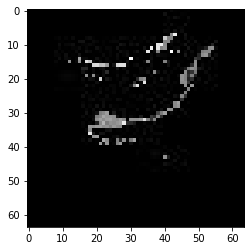

confidence for 18323 is 0.9763311


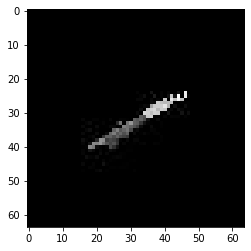

confidence for 18325 is 0.99092615


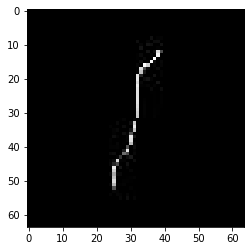

confidence for 18328 is 0.9440886


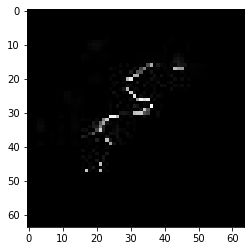

confidence for 18329 is 0.99845314


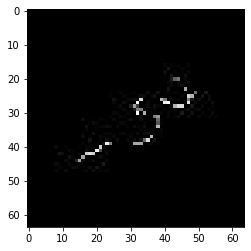

confidence for 18338 is 0.909568


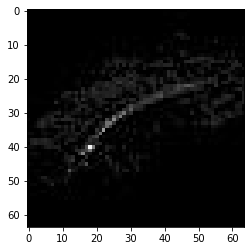

confidence for 18341 is 0.90516657


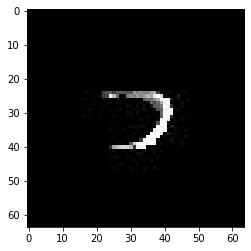

confidence for 18358 is 0.9999456


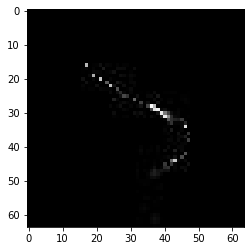

confidence for 18359 is 0.9413855


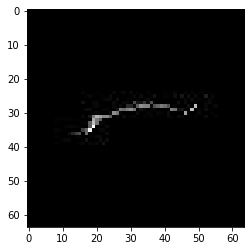

confidence for 18361 is 0.9999974


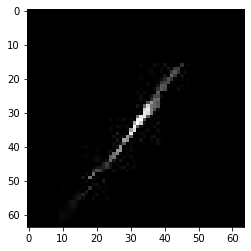

confidence for 18368 is 0.99995995


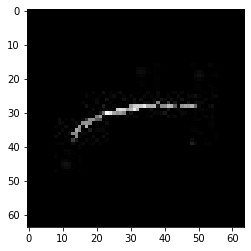

confidence for 18373 is 0.9996721


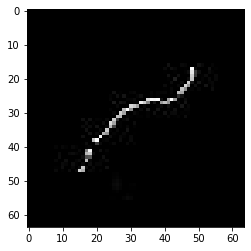

confidence for 18377 is 0.98942024


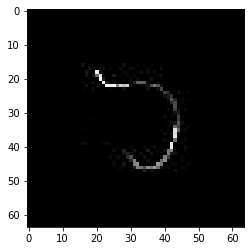

confidence for 18384 is 0.966251


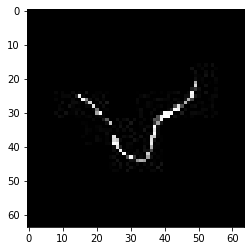

confidence for 18389 is 0.9499596


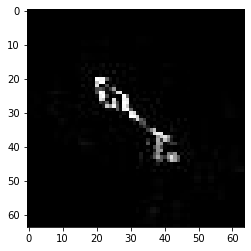

confidence for 18397 is 0.98858255


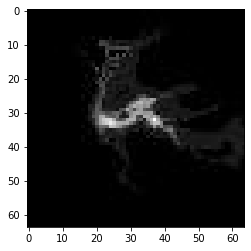

confidence for 18406 is 0.9951838


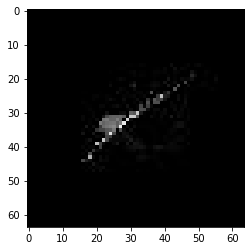

confidence for 18411 is 0.9999283


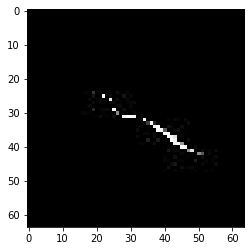

confidence for 18413 is 0.9983875


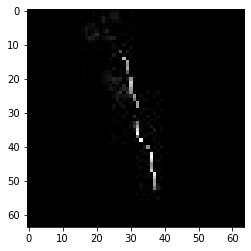

confidence for 18416 is 0.99999964


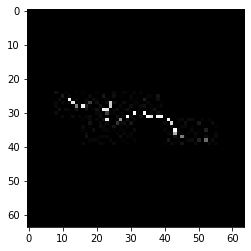

confidence for 18417 is 0.99402493


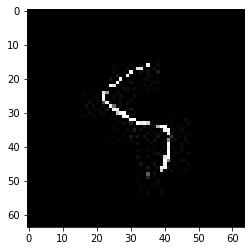

confidence for 18425 is 0.895797


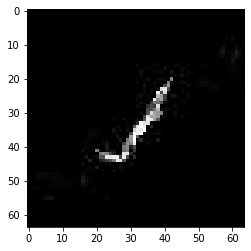

confidence for 18429 is 0.9996261


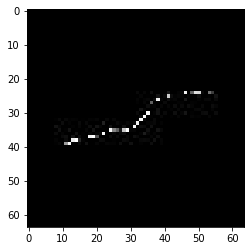

confidence for 18445 is 0.9579513


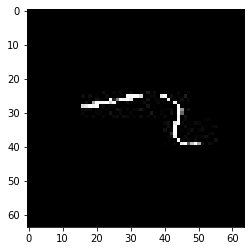

confidence for 18446 is 0.9860049


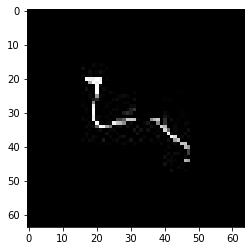

confidence for 18464 is 0.99997705


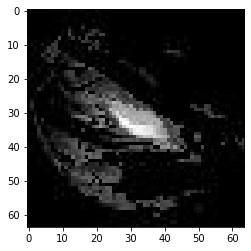

confidence for 18466 is 0.9968732


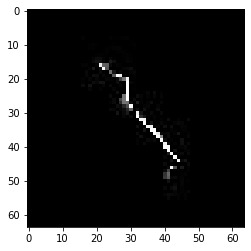

confidence for 18471 is 0.9806129


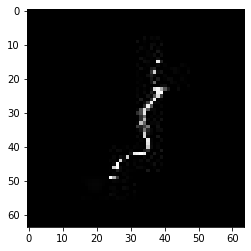

confidence for 18474 is 0.99999803


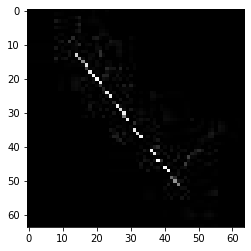

confidence for 18493 is 0.9846544


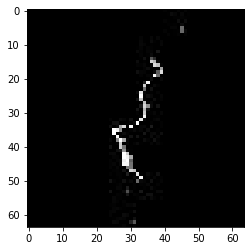

confidence for 18497 is 0.94957465


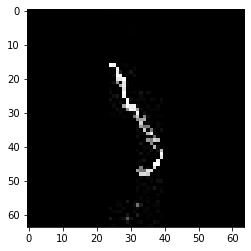

confidence for 18554 is 0.9909883


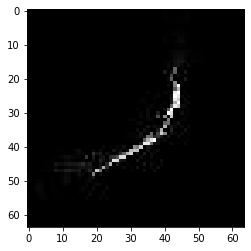

confidence for 18555 is 0.9740744


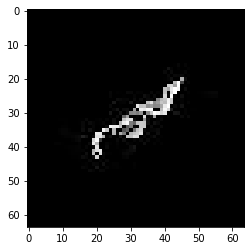

confidence for 18559 is 0.98462325


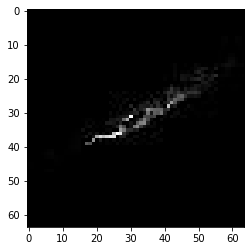

confidence for 18583 is 0.9792267


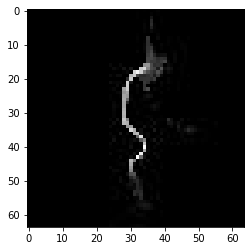

confidence for 18586 is 0.99991626


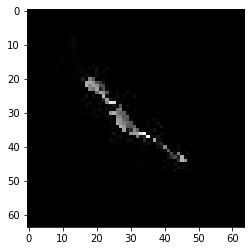

confidence for 18595 is 0.9171554


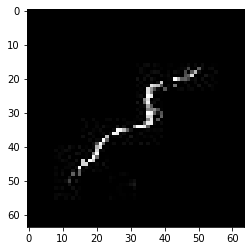

confidence for 18598 is 0.99956685


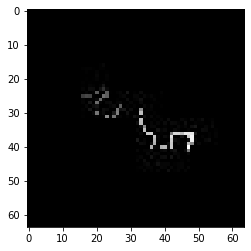

confidence for 18605 is 0.9990259


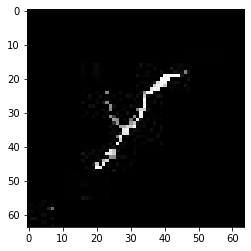

confidence for 18617 is 0.97011817


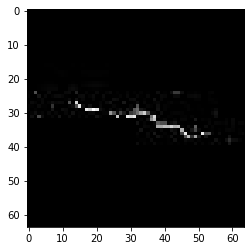

confidence for 18621 is 0.9992967


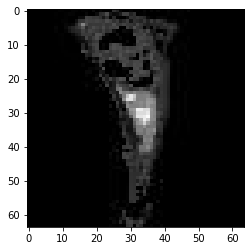

confidence for 18626 is 0.99995285


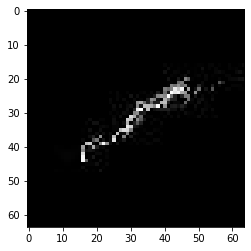

confidence for 18633 is 0.97302794


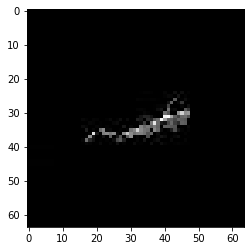

confidence for 18635 is 1.0


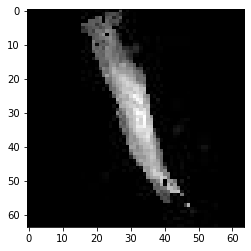

confidence for 18641 is 0.99999994


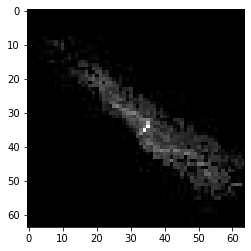

confidence for 18647 is 0.84426594


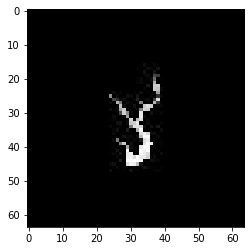

confidence for 18673 is 0.93290675


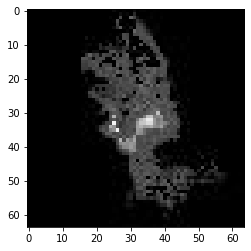

confidence for 18676 is 0.8186894


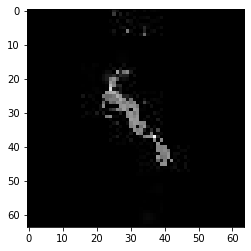

confidence for 18691 is 0.9909325


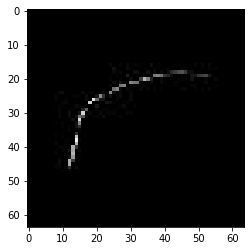

confidence for 18694 is 0.98321384


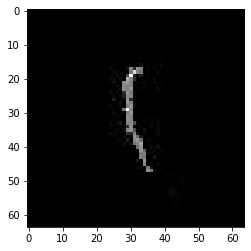

confidence for 18697 is 0.9964006


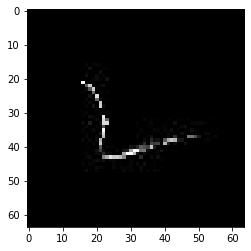

confidence for 18700 is 0.9967622


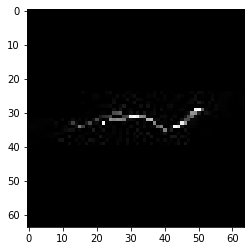

confidence for 18706 is 0.98569155


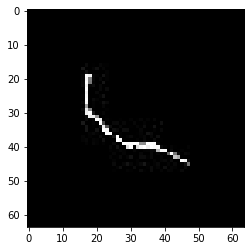

confidence for 18712 is 0.99987835


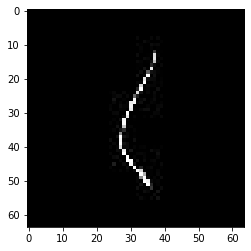

confidence for 18715 is 0.99478835


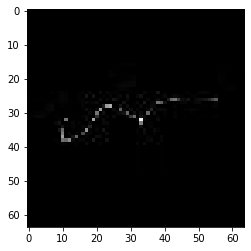

confidence for 18719 is 0.9889444


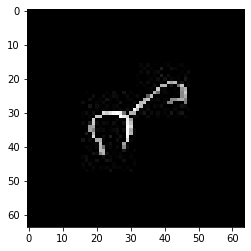

confidence for 18720 is 0.9434409


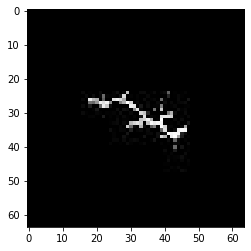

confidence for 18733 is 0.9988138


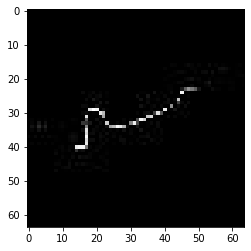

confidence for 18735 is 0.998059


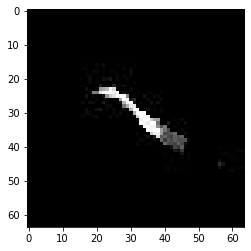

confidence for 18739 is 0.92117876


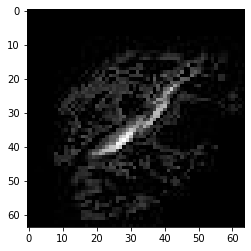

confidence for 18740 is 0.95653677


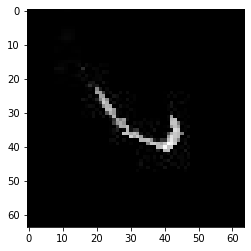

confidence for 18759 is 0.8978564


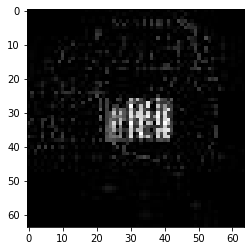

confidence for 18761 is 0.99871933


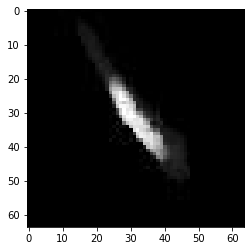

confidence for 18764 is 0.9909961


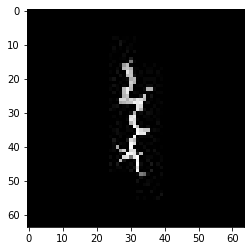

confidence for 18779 is 0.9893952


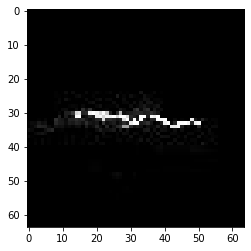

confidence for 18784 is 0.99164104


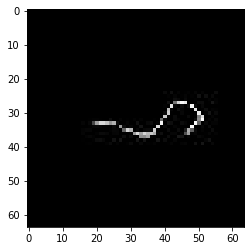

confidence for 18792 is 0.9999775


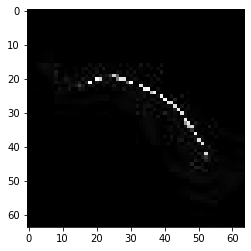

confidence for 18795 is 0.99893236


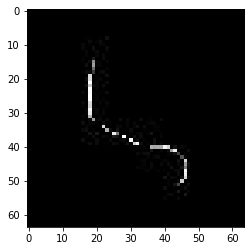

confidence for 18796 is 0.9644711


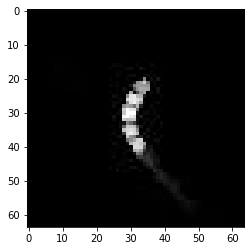

confidence for 18809 is 0.9855902


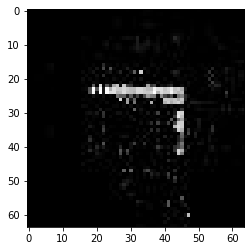

confidence for 18812 is 0.9679882


confidence for 18821 is 0.9933788


confidence for 18825 is 0.85882586


confidence for 18828 is 0.91939455


confidence for 18831 is 0.875052


confidence for 18832 is 0.8173933


confidence for 18840 is 0.99997175


confidence for 18842 is 0.8004899


confidence for 18855 is 0.83912724


confidence for 18856 is 0.99909544


confidence for 18857 is 0.9887079


confidence for 18860 is 0.9999995


confidence for 18873 is 0.9607349


confidence for 18874 is 0.99981624


confidence for 18882 is 0.9981979


confidence for 18885 is 0.9774794


confidence for 18891 is 0.8633545


confidence for 18892 is 0.99997115


confidence for 18896 is 0.9942121


confidence for 18898 is 0.9986637


confidence for 18901 is 1.0


confidence for 18903 is 0.9865674


confidence for 18913 is 0.83232856


confidence for 18916 is 0.9978882


confidence for 18919 is 0.99997383


confidence for 18923 is 1.0


confidence for 18933 is 0.9700361


confidence for 18934 is 0.8324906


confidence for 18956 is 0.9964841


confidence for 18968 is 0.95702475


confidence for 18973 is 0.9122205


confidence for 18988 is 0.9540305


confidence for 18995 is 0.95105404


confidence for 19010 is 0.9911194


confidence for 19012 is 0.97246397


confidence for 19014 is 0.9766215


confidence for 19015 is 0.9981999


confidence for 19017 is 0.99738985


confidence for 19018 is 0.923329


confidence for 19023 is 0.99610925


confidence for 19025 is 0.98468745


confidence for 19026 is 0.94577694


confidence for 19030 is 0.9931837


confidence for 19044 is 0.8026693


confidence for 19047 is 0.83033764


confidence for 19050 is 0.9557573


confidence for 19054 is 0.999216


confidence for 19056 is 0.82939255


confidence for 19065 is 0.99831945


confidence for 19066 is 0.9995759


confidence for 19068 is 0.99399275


confidence for 19070 is 0.99705434


confidence for 19071 is 0.99553096


confidence for 19091 is 0.9907873


confidence for 19093 is 0.9731293


confidence for 19099 is 0.99508154


confidence for 19108 is 0.9990023


confidence for 19111 is 0.9999846


confidence for 19140 is 0.9999546


confidence for 19151 is 0.8110008


confidence for 19159 is 0.91039056


confidence for 19168 is 0.84207356


confidence for 19183 is 0.9999485


confidence for 19191 is 0.9997664


confidence for 19201 is 0.9997868


confidence for 19208 is 0.9989069


confidence for 19218 is 0.826412


confidence for 19227 is 0.94801307


confidence for 19230 is 0.9512299


confidence for 19233 is 0.92060614


confidence for 19242 is 0.8964023


confidence for 19243 is 0.99601734


confidence for 19244 is 0.9990204


confidence for 19252 is 0.9998128


confidence for 19258 is 0.94786376


confidence for 19259 is 0.8477166


confidence for 19264 is 0.9972566


confidence for 19274 is 0.89587456


confidence for 19280 is 0.80266804


confidence for 19282 is 0.8259622


confidence for 19283 is 0.99888664


confidence for 19291 is 0.9810774


confidence for 19293 is 0.9960924


confidence for 19295 is 0.97377944


confidence for 19297 is 0.9968888


confidence for 19301 is 0.99997836


confidence for 19304 is 0.88054085


confidence for 19307 is 0.8709866


confidence for 19315 is 0.99969155


confidence for 19329 is 0.99517816


confidence for 19334 is 0.8177367


confidence for 19336 is 0.9995615


confidence for 19343 is 0.9871515


confidence for 19350 is 0.9937145


confidence for 19351 is 0.9158991


confidence for 19355 is 0.9831212


confidence for 19361 is 0.999899


confidence for 19366 is 0.94298375


confidence for 19372 is 0.99728596


confidence for 19381 is 0.8287019


confidence for 19385 is 0.93325263


confidence for 19414 is 0.9999974


confidence for 19416 is 0.92724854


confidence for 19428 is 0.999611


confidence for 19431 is 0.9999999


confidence for 19435 is 0.97294545


confidence for 19448 is 0.80533457


confidence for 19458 is 0.89234656


confidence for 19459 is 0.9711704


confidence for 19463 is 0.9943327


confidence for 19507 is 0.9999997


confidence for 19514 is 0.8791825


confidence for 19522 is 0.97270185


confidence for 19546 is 0.9920007


confidence for 19548 is 0.99521065


confidence for 19549 is 0.9991453


confidence for 19556 is 0.97239125


confidence for 19580 is 0.9071062


confidence for 19587 is 0.96116817


confidence for 19598 is 0.9608171


confidence for 19612 is 0.99897236


confidence for 19617 is 0.9528743


confidence for 19619 is 0.97078586


confidence for 19624 is 0.9993971


confidence for 19637 is 0.92672616


confidence for 19643 is 0.9997981


confidence for 19647 is 0.99956006


confidence for 19662 is 0.9702883


confidence for 19682 is 0.99999994


confidence for 19684 is 0.9667708


confidence for 19689 is 0.97168696


confidence for 19692 is 0.9907613


confidence for 19694 is 0.92035866


confidence for 19698 is 0.98434234


confidence for 19701 is 0.8068409


confidence for 19705 is 0.8286564


confidence for 19708 is 0.999337


confidence for 19711 is 0.83050513


confidence for 19719 is 0.99873215


confidence for 19723 is 0.9923989


confidence for 19726 is 0.97178656


confidence for 19734 is 0.87990516


confidence for 19747 is 0.910054


confidence for 19756 is 0.9991176


confidence for 19758 is 1.0


confidence for 19766 is 0.9987567


confidence for 19775 is 0.9999988


confidence for 19777 is 0.99999994


confidence for 19792 is 0.9293167


confidence for 19798 is 0.95075154


confidence for 19823 is 0.9950197


confidence for 19834 is 1.0


confidence for 19843 is 0.92713606


confidence for 19865 is 0.9961402


confidence for 19867 is 1.0


confidence for 19870 is 0.9980604


confidence for 19872 is 0.9310613


confidence for 19878 is 0.9120748


confidence for 19879 is 0.9387635


confidence for 19888 is 0.929085


confidence for 19896 is 0.9561503


confidence for 19903 is 0.99719244


confidence for 19908 is 0.99972767


confidence for 19919 is 0.9676787


confidence for 19934 is 0.9835038


confidence for 19951 is 0.9992461


confidence for 19955 is 0.9357658


confidence for 19956 is 0.9999969


confidence for 19961 is 0.9332521


confidence for 19964 is 0.9995888


confidence for 19965 is 0.99999994


confidence for 19966 is 0.99950796


confidence for 19970 is 0.9826035


confidence for 19978 is 0.99998695


confidence for 19994 is 0.9999992


confidence for 20004 is 0.99935347


confidence for 20007 is 0.96194726


confidence for 20020 is 0.8957461


confidence for 20025 is 0.99977726


confidence for 20030 is 0.980421


confidence for 20041 is 0.9322488


confidence for 20062 is 0.999717


confidence for 20071 is 0.9953673


confidence for 20078 is 0.99999964


confidence for 20089 is 0.976405


confidence for 20092 is 1.0


confidence for 20097 is 0.9604781


confidence for 20101 is 0.9017756


confidence for 20105 is 0.9999957


confidence for 20111 is 0.9999761


confidence for 20126 is 0.99998325


confidence for 20139 is 0.9934327


confidence for 20150 is 0.99994576


confidence for 20163 is 0.98175025


confidence for 20165 is 0.99999416


confidence for 20176 is 0.9643057


confidence for 20179 is 0.95267284


confidence for 20196 is 0.9998747


confidence for 20225 is 0.93528515


confidence for 20226 is 0.880601


confidence for 20238 is 0.9946911


confidence for 20244 is 0.9925092


confidence for 20252 is 0.87609243


confidence for 20265 is 0.9986053


confidence for 20272 is 0.98818815


confidence for 20281 is 0.994459


confidence for 20302 is 0.99928343


confidence for 20322 is 0.99960774


confidence for 20337 is 0.9999994


confidence for 20340 is 0.93504184


confidence for 20352 is 0.9976903


confidence for 20354 is 0.96544254


confidence for 20361 is 0.86766183


confidence for 20363 is 0.99882627


confidence for 20366 is 0.92296076


confidence for 20367 is 0.9698321


confidence for 20368 is 0.9999318


confidence for 20372 is 0.85870403


confidence for 20384 is 0.98978543


confidence for 20391 is 0.93770164


confidence for 20399 is 0.9996725


confidence for 20402 is 0.9541568


confidence for 20403 is 0.91459405


confidence for 20409 is 0.93811744


confidence for 20415 is 0.9986833


confidence for 20428 is 0.99863654


confidence for 20446 is 0.9976214


confidence for 20452 is 0.98564124


confidence for 20466 is 0.9996261


confidence for 20476 is 0.83600396


confidence for 20480 is 0.9744972


confidence for 20482 is 0.9815358


confidence for 20524 is 0.99997956


confidence for 20527 is 0.8869948


confidence for 20531 is 0.9999872


confidence for 20535 is 0.98457503


confidence for 20537 is 0.9918376


confidence for 20552 is 0.94964886


confidence for 20559 is 0.8556677


confidence for 20604 is 0.9907126


confidence for 20606 is 0.99464864


confidence for 20610 is 1.0


confidence for 20623 is 0.9440019


confidence for 20624 is 0.86763865


confidence for 20628 is 0.993854


confidence for 20630 is 0.942985


confidence for 20634 is 0.90684944


confidence for 20637 is 0.9313603


confidence for 20639 is 0.8362077


confidence for 20645 is 0.99730206


confidence for 20651 is 0.9754968


confidence for 20658 is 0.99996775


confidence for 20660 is 0.9779892


confidence for 20664 is 0.99925566


confidence for 20671 is 0.9992053


confidence for 20674 is 0.9996812


confidence for 20675 is 0.9609326


confidence for 20677 is 0.8225662


confidence for 20678 is 0.9739199


confidence for 20680 is 0.98066294


confidence for 20681 is 0.9916541


confidence for 20690 is 0.9631898


confidence for 20701 is 0.99999374


confidence for 20702 is 0.9970856


confidence for 20704 is 0.9922165


confidence for 20705 is 0.99133825


confidence for 20707 is 0.9999998


confidence for 20710 is 0.99999356


confidence for 20713 is 0.99408644


confidence for 20714 is 0.9423612


confidence for 20718 is 0.999558


confidence for 20725 is 0.9896998


confidence for 20728 is 0.9958462


confidence for 20730 is 0.99645776


confidence for 20731 is 0.99930155


confidence for 20732 is 0.98033345


confidence for 20736 is 0.9252709


confidence for 20741 is 0.98695415


confidence for 20743 is 0.84018546


confidence for 20748 is 0.999935


confidence for 20749 is 0.99326164


confidence for 20752 is 0.99991447


confidence for 20754 is 0.9931524


confidence for 20755 is 0.99479514


confidence for 20756 is 0.9981542


confidence for 20760 is 0.80420446


confidence for 20761 is 0.998794


confidence for 20767 is 0.97663325


confidence for 20775 is 0.9999191


confidence for 20777 is 0.9999995


confidence for 20778 is 0.98436004


confidence for 20781 is 0.91544205


confidence for 20785 is 0.9608349


confidence for 20796 is 0.99888515


confidence for 20800 is 0.95292485


confidence for 20803 is 0.97608924


confidence for 20805 is 0.99838984


confidence for 20808 is 0.98792386


confidence for 20810 is 0.8328326


confidence for 20812 is 0.99971807


confidence for 20814 is 0.9845768


confidence for 20817 is 0.9458847


confidence for 20819 is 0.97806466


confidence for 20820 is 0.96005523


confidence for 20828 is 0.9999757


confidence for 20864 is 0.9881634


confidence for 20869 is 0.97750723


confidence for 20875 is 0.98970705


confidence for 20878 is 0.9999999


confidence for 20882 is 0.83783174


confidence for 20887 is 0.99679327


confidence for 20891 is 0.9836532


confidence for 20892 is 0.9775563


confidence for 20898 is 0.99546117


confidence for 20901 is 1.0


confidence for 20904 is 0.99994814


confidence for 20914 is 0.9817265


confidence for 20916 is 0.99426955


confidence for 20917 is 0.99698555


confidence for 20927 is 0.86359394


confidence for 20932 is 0.98393446


confidence for 20937 is 0.9325348


confidence for 20941 is 0.9235789


confidence for 20950 is 0.99959874


confidence for 20954 is 0.9036828


confidence for 20955 is 0.99999964


confidence for 20962 is 0.9353793


confidence for 20971 is 0.9042443


confidence for 20977 is 0.961255


confidence for 20981 is 0.84902936


confidence for 20983 is 0.9310003


confidence for 20984 is 0.9998875


confidence for 20986 is 0.98893636


confidence for 20991 is 0.97701967


confidence for 20993 is 0.93010205


confidence for 20994 is 0.9727694


confidence for 20999 is 0.99986565


confidence for 21004 is 0.9862546


confidence for 21013 is 0.99986255


confidence for 21019 is 0.98706204


confidence for 21030 is 0.90629834


confidence for 21032 is 0.96666723


confidence for 21040 is 0.9999948


confidence for 21048 is 0.84330493


confidence for 21053 is 0.9837083


confidence for 21057 is 0.8907977


confidence for 21064 is 0.999984


confidence for 21068 is 0.94438744


confidence for 21071 is 0.89562976


confidence for 21092 is 0.9433112


confidence for 21098 is 0.9998607


confidence for 21104 is 0.9999991


confidence for 21115 is 0.9877742


confidence for 21135 is 0.92186964


confidence for 21136 is 0.9958478


confidence for 21140 is 0.9648596


confidence for 21145 is 0.9999946


confidence for 21149 is 0.83881897


confidence for 21150 is 0.99970436


confidence for 21154 is 0.9560464


confidence for 21161 is 0.9989949


confidence for 21165 is 0.9350639


confidence for 21166 is 0.9892755


confidence for 21168 is 0.9989294


confidence for 21176 is 0.9968863


confidence for 21193 is 0.9995143


confidence for 21197 is 0.9996442


confidence for 21198 is 0.9881462


confidence for 21199 is 0.8382943


confidence for 21201 is 0.99998903


confidence for 21202 is 0.9999964


confidence for 21209 is 0.99804664


confidence for 21212 is 0.9625047


confidence for 21221 is 0.990021


confidence for 21225 is 0.99962103


confidence for 21233 is 0.9980736


confidence for 21235 is 0.9904548


confidence for 21237 is 0.99219984


confidence for 21246 is 0.9880439


confidence for 21255 is 0.9935875


confidence for 21256 is 0.9783682


confidence for 21257 is 0.9113305


confidence for 21258 is 0.9970871


confidence for 21267 is 1.0


confidence for 21278 is 0.9936358


confidence for 21284 is 0.99105537


confidence for 21294 is 0.83253145


confidence for 21299 is 0.81003535


confidence for 21304 is 0.9753558


confidence for 21313 is 0.96648395


confidence for 21317 is 0.9981214


confidence for 21318 is 0.9486709


confidence for 21321 is 0.9983224


confidence for 21332 is 0.84802926


confidence for 21333 is 0.9998739


confidence for 21337 is 0.87801737


confidence for 21353 is 0.87255794


confidence for 21359 is 0.8649859


confidence for 21377 is 0.99945074


confidence for 21388 is 0.9954031


confidence for 21411 is 0.98705214


confidence for 21416 is 0.9410627


confidence for 21423 is 0.8730509


confidence for 21424 is 0.97617966


confidence for 21453 is 0.99395317


confidence for 21455 is 0.8310431


confidence for 21459 is 0.8472181


confidence for 21460 is 0.85716057


confidence for 21475 is 1.0


confidence for 21477 is 0.89881325


confidence for 21486 is 0.84773993


confidence for 21495 is 0.9813741


confidence for 21498 is 0.95074016


confidence for 21500 is 0.99960923


confidence for 21516 is 0.80199355


confidence for 21527 is 0.93148625


confidence for 21535 is 0.9711312


confidence for 21536 is 0.9799255


confidence for 21540 is 0.99919754


confidence for 21542 is 0.974035


confidence for 21551 is 0.9246441


confidence for 21554 is 0.97997797


confidence for 21555 is 0.9996102


confidence for 21566 is 0.93432117


confidence for 21581 is 0.99969167


confidence for 21587 is 0.9995709


confidence for 21593 is 0.86269647


confidence for 21603 is 0.99808824


confidence for 21610 is 0.9970453


confidence for 21617 is 0.83317024


confidence for 21629 is 0.9999997


confidence for 21630 is 0.99735093


confidence for 21638 is 0.99982536


confidence for 21640 is 0.9999673


confidence for 21648 is 0.8115846


confidence for 21653 is 0.9873732


confidence for 21656 is 0.8680819


confidence for 21665 is 1.0


confidence for 21666 is 0.803179


confidence for 21668 is 0.9966968


confidence for 21670 is 0.8597283


confidence for 21684 is 0.94995433


confidence for 21685 is 0.9824146


confidence for 21694 is 0.9834583


confidence for 21697 is 0.9332443


confidence for 21700 is 0.9964634


confidence for 21703 is 0.98608005


confidence for 21709 is 0.9999716


confidence for 21718 is 0.9939648


confidence for 21720 is 0.9989817


confidence for 21735 is 0.9040759


confidence for 21745 is 0.9578321


confidence for 21747 is 0.99910444


confidence for 21756 is 0.88597685


confidence for 21772 is 0.9444849


confidence for 21779 is 0.9997599


confidence for 21782 is 0.9917816


confidence for 21791 is 0.81857085


confidence for 21801 is 0.99715245


confidence for 21810 is 0.9952765


confidence for 21825 is 0.999959


confidence for 21827 is 0.99999976


confidence for 21828 is 0.994728


confidence for 21830 is 0.94363576


confidence for 21835 is 0.82888776


confidence for 21846 is 0.9999988


confidence for 21848 is 0.8852938


confidence for 21856 is 0.8116723


confidence for 21857 is 0.99399364


confidence for 21860 is 0.99750257


confidence for 21869 is 0.8931975


confidence for 21881 is 0.99997044


confidence for 21885 is 0.98852926


confidence for 21890 is 0.8813179


confidence for 21896 is 0.99985385


confidence for 21897 is 0.99943805


confidence for 21900 is 0.92335004


confidence for 21902 is 0.9948374


confidence for 21909 is 0.9234662


confidence for 21915 is 0.9996936


confidence for 21916 is 0.8183828


confidence for 21919 is 0.9278205


confidence for 21926 is 0.9967058


confidence for 21927 is 0.99595726


confidence for 21930 is 0.9857352


confidence for 21932 is 0.98263663


confidence for 21937 is 0.9834453


confidence for 21940 is 0.9571719


confidence for 21941 is 0.99982035


confidence for 21949 is 0.99575317


confidence for 21968 is 0.9492669


confidence for 21971 is 0.99998534


confidence for 21974 is 0.99456865


confidence for 21978 is 0.99701065


confidence for 21984 is 0.99991035


confidence for 21987 is 0.88197833


confidence for 21995 is 1.0


confidence for 21997 is 0.9997424


confidence for 22004 is 0.9988958


confidence for 22006 is 0.99992585


confidence for 22015 is 0.94690084


confidence for 22017 is 0.9223235


confidence for 22020 is 0.9920967


confidence for 22021 is 0.9999797


confidence for 22042 is 0.9999411


confidence for 22046 is 0.8150175


confidence for 22057 is 0.9958713


confidence for 22062 is 0.98576415


confidence for 22072 is 0.946108


confidence for 22086 is 0.9645456


confidence for 22088 is 0.86992717


confidence for 22089 is 0.9564071


confidence for 22101 is 0.9084147


confidence for 22108 is 0.99884325


confidence for 22116 is 0.90331525


confidence for 22119 is 0.8415225


confidence for 22128 is 1.0


confidence for 22145 is 0.85403574


confidence for 22149 is 0.9999996


confidence for 22156 is 0.91605496


confidence for 22157 is 1.0


confidence for 22158 is 0.99976474


confidence for 22160 is 0.9982613


confidence for 22164 is 0.9993241


confidence for 22172 is 0.9177049


confidence for 22176 is 0.9997227


confidence for 22191 is 0.99657327


confidence for 22196 is 0.93579006


confidence for 22216 is 0.99281925


confidence for 22221 is 0.9977293


confidence for 22223 is 0.9893526


confidence for 22225 is 0.99342906


confidence for 22228 is 0.9999986


confidence for 22242 is 0.86729807


confidence for 22255 is 0.9470961


confidence for 22256 is 0.9247173


confidence for 22261 is 0.99468046


confidence for 22262 is 0.9982033


confidence for 22273 is 0.98115873


confidence for 22276 is 0.9979052


confidence for 22280 is 0.990898


confidence for 22281 is 0.8955998


confidence for 22282 is 0.999536


confidence for 22284 is 0.9998733


confidence for 22285 is 0.9998057


confidence for 22295 is 0.9994129


confidence for 22308 is 0.95613134


confidence for 22316 is 0.8053891


confidence for 22317 is 0.8788846


confidence for 22319 is 0.9766573


confidence for 22322 is 0.9999969


confidence for 22323 is 0.81982225


confidence for 22325 is 0.8046042


confidence for 22331 is 0.8337237


confidence for 22361 is 0.9883144


confidence for 22365 is 0.98934525


confidence for 22375 is 0.9806289


confidence for 22392 is 0.9710581


confidence for 22402 is 0.9921636


confidence for 22415 is 0.8313616


confidence for 22421 is 0.95792913


confidence for 22424 is 0.9999998


confidence for 22427 is 0.99993426


confidence for 22443 is 0.97581613


confidence for 22446 is 0.99388486


confidence for 22449 is 0.8952416


confidence for 22473 is 0.9773707


confidence for 22476 is 0.9746806


confidence for 22478 is 0.9118905


confidence for 22488 is 0.9877259


confidence for 22489 is 0.974043


confidence for 22503 is 0.95442533


confidence for 22517 is 0.99996763


confidence for 22529 is 0.9073254


confidence for 22531 is 0.9242847


confidence for 22538 is 0.99959797


confidence for 22547 is 0.8700191


confidence for 22553 is 0.99995273


confidence for 22563 is 0.99739325


confidence for 22583 is 0.9979235


confidence for 22589 is 1.0


confidence for 22598 is 0.8406563


confidence for 22601 is 0.99986386


confidence for 22603 is 0.9999374


confidence for 22608 is 0.9364416


confidence for 22610 is 0.9616241


confidence for 22613 is 0.98616725


confidence for 22634 is 0.9706624


confidence for 22635 is 0.98292816


confidence for 22640 is 0.9999883


confidence for 22643 is 0.998006


confidence for 22644 is 0.9978871


confidence for 22647 is 0.9879425


confidence for 22648 is 0.9833227


confidence for 22659 is 0.9999999


confidence for 22669 is 0.9691414


confidence for 22677 is 0.908979


confidence for 22680 is 0.9986415


confidence for 22690 is 0.9998913


confidence for 22693 is 0.8960246


confidence for 22696 is 0.96823204


confidence for 22713 is 0.9997125


confidence for 22714 is 0.98237956


confidence for 22716 is 0.8031405


confidence for 22733 is 0.99338806


confidence for 22734 is 0.9461532


confidence for 22762 is 1.0


confidence for 22768 is 0.97075087


confidence for 22772 is 0.9992225


confidence for 22782 is 0.88990307


confidence for 22785 is 0.9280269


confidence for 22794 is 0.90589595


confidence for 22795 is 0.9472287


confidence for 22801 is 0.9993754


confidence for 22803 is 0.9996195


confidence for 22805 is 0.99404174


confidence for 22809 is 0.95594245


confidence for 22812 is 0.98366886


confidence for 22820 is 0.99877465


confidence for 22823 is 0.990454


confidence for 22824 is 0.99999785


confidence for 22835 is 0.9992039


confidence for 22873 is 0.8410983


confidence for 22874 is 0.87412447


confidence for 22880 is 0.9951925


confidence for 22889 is 0.90282583


confidence for 22897 is 0.9971596


confidence for 22898 is 0.94213825


confidence for 22899 is 0.99096483


confidence for 22902 is 0.9995352


confidence for 22910 is 0.9997004


confidence for 22912 is 0.9998261


confidence for 22917 is 0.842726


confidence for 22935 is 0.95938873


confidence for 22937 is 0.98261815


confidence for 22957 is 0.99830705


confidence for 22960 is 0.86642146


confidence for 22977 is 0.98793447


confidence for 22978 is 0.93238056


confidence for 22986 is 0.9999002


confidence for 22990 is 0.9996041


confidence for 22991 is 0.99852556


confidence for 22996 is 1.0


confidence for 22997 is 0.99953765


confidence for 23006 is 0.99995583


confidence for 23007 is 0.8006556


confidence for 23028 is 0.80295926


confidence for 23031 is 0.98217


confidence for 23040 is 0.89633787


confidence for 23044 is 0.9928438


confidence for 23045 is 0.99921244


confidence for 23049 is 0.904883


confidence for 23058 is 0.82615155


confidence for 23064 is 0.99846953


confidence for 23069 is 0.96890527


confidence for 23077 is 0.8429271


confidence for 23078 is 0.87204814


confidence for 23086 is 0.9991787


confidence for 23089 is 0.90292865


confidence for 23092 is 0.97100097


confidence for 23102 is 0.99999994


confidence for 23104 is 0.94733775


confidence for 23114 is 0.9998921


confidence for 23115 is 0.99998176


confidence for 23131 is 0.99897134


confidence for 23135 is 0.9980746


confidence for 23145 is 0.99084204


confidence for 23150 is 0.9999987


confidence for 23155 is 0.99723196


confidence for 23156 is 0.9068043


confidence for 23160 is 0.9964816


confidence for 23166 is 0.99954516


confidence for 23171 is 0.98552054


confidence for 23174 is 0.8724663


confidence for 23176 is 0.9913509


confidence for 23183 is 0.99723613


confidence for 23191 is 0.9443057


confidence for 23193 is 0.9999892


confidence for 23199 is 0.9981197


confidence for 23206 is 0.999497


confidence for 23210 is 0.9779315


confidence for 23219 is 0.9774909


confidence for 23222 is 0.99999976


confidence for 23224 is 0.95800686


confidence for 23232 is 0.8088166


confidence for 23234 is 0.99849236


confidence for 23263 is 0.8459757


confidence for 23266 is 0.8244671


confidence for 23271 is 0.9621429


confidence for 23279 is 0.99999994


confidence for 23282 is 0.9962737


confidence for 23292 is 0.9975514


confidence for 23305 is 1.0


confidence for 23320 is 0.99710566


confidence for 23326 is 0.99999815


confidence for 23334 is 0.9925586


confidence for 23338 is 0.99996084


confidence for 23342 is 1.0


confidence for 23343 is 0.984735


confidence for 23349 is 0.95695037


confidence for 23351 is 0.9999988


confidence for 23352 is 0.9848551


confidence for 23353 is 0.9973779


confidence for 23363 is 0.99967647


confidence for 23372 is 0.9998553


confidence for 23373 is 0.99107295


confidence for 23382 is 0.93606436


confidence for 23392 is 0.998558


confidence for 23399 is 0.9656806


confidence for 23400 is 0.93614864


confidence for 23401 is 0.9281822


confidence for 23413 is 0.9964833


confidence for 23428 is 0.9993063


confidence for 23429 is 0.9998764


confidence for 23431 is 0.97533005


confidence for 23434 is 0.9753591


confidence for 23435 is 0.9976403


confidence for 23438 is 0.98306483


confidence for 23441 is 0.97734


confidence for 23447 is 0.99999946


confidence for 23448 is 1.0


confidence for 23449 is 0.9767476


confidence for 23450 is 0.9800681


confidence for 23453 is 0.99689


confidence for 23455 is 0.9776776


confidence for 23462 is 0.9997548


confidence for 23470 is 0.85789263


confidence for 23471 is 0.96556664


confidence for 23482 is 0.9999808


confidence for 23487 is 0.8543546


confidence for 23492 is 0.8070983


confidence for 23496 is 0.9998185


confidence for 23497 is 0.99624914


confidence for 23513 is 0.9995916


confidence for 23517 is 0.99954665


confidence for 23519 is 0.9988554


confidence for 23521 is 0.8317623


confidence for 23525 is 0.9989816


confidence for 23531 is 0.93714625


confidence for 23553 is 0.81227905


confidence for 23556 is 0.98611844


confidence for 23559 is 0.9996314


confidence for 23565 is 0.98160875


confidence for 23568 is 0.99489886


confidence for 23571 is 0.98749185


confidence for 23572 is 0.90701467


confidence for 23577 is 0.84947175


confidence for 23580 is 0.99856377


confidence for 23594 is 0.999542


confidence for 23598 is 0.8684137


confidence for 23599 is 0.81899554


confidence for 23607 is 0.8937889


confidence for 23612 is 0.8553406


confidence for 23614 is 0.8538195


confidence for 23619 is 0.94556344


confidence for 23625 is 0.99999976


confidence for 23631 is 0.94613606


confidence for 23634 is 0.99999857


confidence for 23635 is 0.9999991


confidence for 23638 is 0.98806643


confidence for 23652 is 0.99991244


confidence for 23683 is 0.92959625


confidence for 23687 is 0.9953442


confidence for 23689 is 0.97219056


confidence for 23695 is 1.0


confidence for 23697 is 0.99704665


confidence for 23700 is 0.99897844


confidence for 23706 is 0.99518853


confidence for 23707 is 0.94692904


confidence for 23709 is 0.95112145


confidence for 23715 is 0.9997608


confidence for 23716 is 0.99937886


confidence for 23720 is 0.989676


confidence for 23724 is 0.8954157


confidence for 23725 is 0.9968224


confidence for 23735 is 0.8047898


confidence for 23747 is 0.85458195


confidence for 23748 is 0.92547953


confidence for 23749 is 0.9872126


confidence for 23750 is 0.9939878


confidence for 23756 is 0.9199722


confidence for 23766 is 0.9087602


confidence for 23767 is 0.9994251


confidence for 23770 is 0.99719393


confidence for 23773 is 0.9954815


confidence for 23775 is 0.9988293


confidence for 23782 is 0.8450992


confidence for 23787 is 0.94348174


confidence for 23796 is 0.96684605


confidence for 23801 is 0.97275245


confidence for 23803 is 0.9998834


confidence for 23813 is 0.98508185


confidence for 23819 is 0.9995604


confidence for 23826 is 0.8411761


confidence for 23828 is 0.8095198


confidence for 23836 is 0.98325074


confidence for 23839 is 0.98387724


confidence for 23842 is 0.9924026


confidence for 23849 is 0.94349045


confidence for 23853 is 0.8775427


confidence for 23869 is 0.9992044


confidence for 23872 is 0.8998293


confidence for 23873 is 0.9960649


confidence for 23874 is 0.99993193


confidence for 23879 is 0.85063


confidence for 23882 is 0.99997455


confidence for 23884 is 0.9967547


confidence for 23895 is 0.86371607


confidence for 23898 is 0.99650854


confidence for 23902 is 0.95364916


confidence for 23903 is 0.9999997


confidence for 23905 is 0.9433616


confidence for 23906 is 0.9999655


confidence for 23915 is 0.99999976


confidence for 23916 is 0.80985254


confidence for 23918 is 0.9008308


confidence for 23919 is 0.8866431


confidence for 23922 is 0.9860815


confidence for 23926 is 0.9601126


confidence for 23932 is 0.9983387


confidence for 23944 is 0.9883766


confidence for 23945 is 0.9999992


confidence for 23947 is 0.9979859


confidence for 23950 is 0.999999


confidence for 23954 is 0.87398815


confidence for 23961 is 0.9191667


confidence for 23966 is 0.997073


confidence for 23967 is 0.9761384


confidence for 23969 is 0.8438558


confidence for 23971 is 0.9993367


confidence for 23975 is 0.9905379


confidence for 23987 is 0.969664


confidence for 23994 is 0.98620206


confidence for 23997 is 0.9715725


confidence for 24001 is 0.88827056


confidence for 24004 is 0.98211277


confidence for 24009 is 0.99999887


confidence for 24017 is 0.9999793


confidence for 24022 is 1.0


confidence for 24025 is 0.9821365


confidence for 24033 is 0.9705025


confidence for 24036 is 0.9999235


confidence for 24038 is 0.95996714


confidence for 24041 is 0.98164433


confidence for 24049 is 0.90390843


confidence for 24051 is 1.0


confidence for 24057 is 0.997204


confidence for 24061 is 0.8018949


confidence for 24062 is 0.9380792


confidence for 24064 is 0.92533016


confidence for 24067 is 0.9994467


confidence for 24073 is 0.84806544


confidence for 24084 is 0.9928843


confidence for 24095 is 0.9616097


confidence for 24099 is 0.99943745


confidence for 24102 is 0.9998588


confidence for 24103 is 0.97998554


confidence for 24106 is 0.9831326


confidence for 24112 is 0.9911688


confidence for 24114 is 0.9999429


confidence for 24122 is 0.9983497


confidence for 24131 is 0.99979466


confidence for 24141 is 0.98573196


confidence for 24155 is 0.9379932


confidence for 24160 is 0.9799368


confidence for 24170 is 0.99833316


confidence for 24171 is 0.98175895


confidence for 24174 is 0.96240026


confidence for 24181 is 0.9999841


confidence for 24182 is 0.9733491


confidence for 24192 is 0.93814594


confidence for 24197 is 0.97748333


confidence for 24199 is 0.99921227


confidence for 24202 is 0.97403044


confidence for 24204 is 0.99980026


confidence for 24217 is 0.9989084


confidence for 24218 is 0.9999598


confidence for 24222 is 0.8930729


confidence for 24233 is 0.9782682


confidence for 24237 is 0.8191642


confidence for 24240 is 0.9578513


confidence for 24241 is 0.99326533


confidence for 24257 is 0.99205905


confidence for 24259 is 0.9047487


confidence for 24260 is 0.9194568


confidence for 24262 is 0.9970991


confidence for 24268 is 0.8025548


confidence for 24269 is 0.9638942


confidence for 24287 is 0.93363273


confidence for 24291 is 1.0


confidence for 24301 is 0.9007469


confidence for 24302 is 0.9950717


confidence for 24303 is 0.88035166


confidence for 24311 is 0.9830379


confidence for 24314 is 0.9889201


confidence for 24316 is 0.9948456


confidence for 24319 is 0.9999997


confidence for 24322 is 0.9994


confidence for 24323 is 0.9920424


confidence for 24326 is 1.0


confidence for 24328 is 0.95331854


confidence for 24330 is 0.9931709


confidence for 24332 is 0.9912413


confidence for 24335 is 0.9627135


confidence for 24340 is 0.99351776


confidence for 24348 is 0.841873


confidence for 24350 is 0.95514715


confidence for 24357 is 0.9999899


confidence for 24361 is 0.9995491


confidence for 24364 is 0.9938952


confidence for 24390 is 0.9977808


confidence for 24406 is 0.99999046


confidence for 24407 is 0.9498205


confidence for 24408 is 0.9999999


confidence for 24417 is 0.9831761


confidence for 24418 is 0.9981236


confidence for 24419 is 0.96758544


confidence for 24424 is 0.9414715


confidence for 24425 is 0.9467725


confidence for 24432 is 0.9720125


confidence for 24439 is 0.99976134


confidence for 24442 is 0.9998912


confidence for 24443 is 0.99985


confidence for 24446 is 0.9843712


confidence for 24456 is 0.93619514


confidence for 24461 is 0.99798495


confidence for 24467 is 0.99997735


confidence for 24483 is 0.9999944


confidence for 24492 is 0.98996764


confidence for 24493 is 0.99832934


confidence for 24494 is 0.9997345


confidence for 24497 is 0.9981719


confidence for 24498 is 0.9798637


confidence for 24510 is 0.9933246


confidence for 24530 is 0.9997833


confidence for 24561 is 0.8352597


confidence for 24566 is 0.9788627


confidence for 24574 is 0.9042559


confidence for 24576 is 0.9517192


confidence for 24578 is 0.9078043


confidence for 24579 is 0.99998254


confidence for 24580 is 0.99999905


confidence for 24587 is 0.9767884


confidence for 24591 is 0.99872744


confidence for 24593 is 0.99705976


confidence for 24596 is 0.83304286


confidence for 24598 is 0.9154675


confidence for 24601 is 0.96828514


confidence for 24614 is 0.998973


confidence for 24622 is 0.98963535


confidence for 24624 is 0.9990312


confidence for 24630 is 0.875415


confidence for 24632 is 0.9982693


confidence for 24649 is 0.9809475


confidence for 24652 is 0.9329316


confidence for 24658 is 0.99585325


confidence for 24667 is 0.80534434


confidence for 24669 is 0.9985264


confidence for 24679 is 0.9947478


confidence for 24682 is 0.99732965


confidence for 24684 is 0.89401126


confidence for 24685 is 0.9901921


confidence for 24689 is 0.9999862


confidence for 24690 is 0.9899424


confidence for 24699 is 0.8300611


confidence for 24706 is 0.99950546


confidence for 24722 is 0.9253827


confidence for 24725 is 0.9999622


confidence for 24731 is 0.9835063


confidence for 24735 is 0.9032523


confidence for 24736 is 0.9087973


confidence for 24740 is 0.933914


confidence for 24748 is 0.938408


confidence for 24753 is 0.9446715


confidence for 24755 is 0.9922926


confidence for 24764 is 0.8529115


confidence for 24765 is 0.95135134


confidence for 24773 is 0.98350024


confidence for 24775 is 0.9817848


confidence for 24779 is 0.9870514


confidence for 24780 is 1.0


confidence for 24782 is 1.0


confidence for 24783 is 0.999409


confidence for 24786 is 0.9998165


confidence for 24807 is 0.9504693


confidence for 24818 is 0.99979824


confidence for 24819 is 0.8406135


confidence for 24821 is 0.92534167


confidence for 24822 is 0.96890676


confidence for 24827 is 0.99999285


confidence for 24828 is 0.9999351


confidence for 24829 is 0.9902987


confidence for 24830 is 0.9914585


confidence for 24840 is 0.9902993


confidence for 24847 is 0.9963004


confidence for 24850 is 0.99906033


confidence for 24864 is 0.8549472


confidence for 24865 is 0.9941888


confidence for 24870 is 0.99961895


confidence for 24875 is 0.99998206


confidence for 24880 is 0.9999397


confidence for 24885 is 0.931092


confidence for 24889 is 0.99569714


confidence for 24900 is 0.9900017


confidence for 24905 is 0.9993435


confidence for 24909 is 0.97074574


confidence for 24918 is 0.8598472


confidence for 24933 is 0.9758224


confidence for 24934 is 0.8500937


confidence for 24938 is 0.9876979


confidence for 24943 is 0.9358472


confidence for 24945 is 0.997886


confidence for 24949 is 0.9991126


confidence for 24951 is 1.0


confidence for 24956 is 0.9313949


confidence for 24960 is 0.9983904


confidence for 24972 is 0.9011429


confidence for 24984 is 0.8189377


confidence for 24989 is 0.9243877


COMPLETE


In [7]:
for i in rivers:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    plt.imshow(img)
    print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
    plt.show()
    img.save("../data/resnet50v2_predicted_threshold"+str(int(threshold*100))+"/river/"+str(i[0])+"-"+str(int(100*i[1][0]))+".jpeg", "JPEG")
    
for i in other:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    img.save("../data/resnet50v2_predicted_threshold"+str(int(threshold*100))+"/other/"+str(i[0])+"-"+str(int(100*i[1][0]))+".jpeg", "JPEG")

print("COMPLETE")